# 1. Define genetic algorithm suite

In [1]:
from sklearn.gaussian_process.kernels import RBF, ConstantKernel

from src.prediction.gpr_model_trainer import GPRModelTrainer
from src.prediction.etr_model_trainer import EtrModelTrainer

from src.ga.chromosome.vent_hole import VentHole

from src.ga.gene.shape.shape_variations import (
    double_parabolic_params,
    ray_params,
    circle_params,
    donut_params,
    hole_params,
    trapezoid_params,
    triangle_params,
    wing_params,
)
from src.ga.gene.pattern.pattern_variations import (
    circular_params,
    corn_params,
    grid_params,
)

from src.ga.ga_pipeline import GAPipeline

from src.ga.p1_initialize.init_vent import VentInitializer
from src.ga.p2_fitness.vent_fitness import Criterion, VentFitnessCalculator
from src.ga.p3_select.behaviors import (
    TournamentSelectionFilter,
    ElitismSelectionFilter,
    RouletteWheelSelectionFilter,
)
from src.ga.p4_crossover.behaviors import (
    OnePointCrossover,
    TwoPointCrossover,
    UniformCrossover,
)

# ----------------- Define the GA CONSTANTS -----------------
# 1. Define the criteria weights, w1, w2, w3
CRITERIA_WEIGHT = (1.4, 1, 0.4)

# 2. Define the criteria with direction, min, and max values
DRAG_CRITERION: Criterion = ("lower", 0.2, 0.3)  # Lower is better, range 0.2 to 0.3
DRAG_STD_CRITERION: Criterion = ("lower", 0, 0.05)  # Lower is better, range 0 to 0.05

AVG_TEMP_CRITERION: Criterion = (
    "lower",
    250,
    450,
)  # Lower is better, range 250K to 400K
AVG_TEMP_STD_CRITERION: Criterion = ("lower", 0, 10)  # Lower is better, range 0K to 10K

MAX_TEMP_CRITERION: Criterion = (
    "lower",
    300,
    500,
)  # Lower is better, range 300K to 500K
MAX_TEMP_STD_CRITERION: Criterion = ("lower", 0, 10)  # Lower is better, range 0K to 10K

# 3. Define the grid parameters
GRID_SCALE = 1
# Scaling factor

GRID_RESOLUTION = 2
# Grid resolution

GRID_WIDTH = 100
# Grid width, ~= canvas size

GRID_BOUND = (
    (-GRID_WIDTH / 2, GRID_WIDTH / 2),
    (-GRID_WIDTH / 2, GRID_WIDTH / 2),
)
# ----------------- Define the GA MODELS -----------------

gpr_kernel = ConstantKernel(1.0, (1e-2, 1e2)) * RBF(1.0, (1e-2, 1e2))
gpr_model_trainer = GPRModelTrainer(
    gpr_kernel=gpr_kernel,
    gpr_drag_config=(10, 1e-5),
    gpr_max_temp_config=(10, 1e-3),
    gpr_avg_temp_config=(10, 1e-3),
    grid_bound=GRID_BOUND,
    grid_bound_width=GRID_WIDTH,
    grid_resolution=GRID_RESOLUTION,
    grid_scale=GRID_SCALE,
    desired_variance=0.9,
)

etr_model_trainer = EtrModelTrainer(
    etr_drag_config=(100, 42),
    etr_max_temp_config=(100, 42),
    etr_avg_temp_config=(100, 42),
    grid_bound=GRID_BOUND,
    grid_bound_width=GRID_WIDTH,
    grid_resolution=GRID_RESOLUTION,
    grid_scale=GRID_SCALE,
    desired_variance=0.9,
)

# ----------------- Define the GA PIPELINES -----------------
suite = GAPipeline[VentHole](
    suite_name="exp/tournament/config",
    suite_max_count=100,
    suite_min_population=20,
    suite_min_chromosome=40,
    crossover_behavior=TwoPointCrossover(),
    selector_behavior=RouletteWheelSelectionFilter(roulette_pointer_count=4),
    fitness_calculator=VentFitnessCalculator(
        model_trainer_tuple=(
            gpr_model_trainer,
            etr_model_trainer,
            etr_model_trainer,
        ),
        criteria_weight_list=CRITERIA_WEIGHT,
        drag_criterion=DRAG_CRITERION,
        drag_std_criterion=DRAG_STD_CRITERION,
        avg_temp_criterion=AVG_TEMP_CRITERION,
        avg_temp_std_criterion=AVG_TEMP_STD_CRITERION,
        max_temp_criterion=MAX_TEMP_CRITERION,
        max_temp_std_criterion=MAX_TEMP_STD_CRITERION,
    ),
    immediate_exit_condition=lambda x: x[0] >= 0.85 and x[1] >= 0.85,
    mutation_probability=0.02,
    population_initializer=VentInitializer(
        population_size=1000,
        grid_scale=GRID_SCALE,
        grid_resolution=GRID_RESOLUTION,
        pattern_bound=GRID_BOUND,
        pattern_gene_pool=[circular_params, corn_params, grid_params],
        shape_gene_pool=[
            double_parabolic_params,
            ray_params,
            circle_params,
            donut_params,
            hole_params,
            trapezoid_params,
            triangle_params,
            wing_params,
        ],
    ),
)

[Storage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/gene_parameters.json
[Storage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/gene_parameters.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/shape_gene_pdf.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/shape_gene_pdf.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/shape_gene_pdf.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/pattern_gene_pdf.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/pattern_gene_pdf.json
[StochasticStorage]: JSON data loaded from c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/pattern_gene_pdf.j

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\gaussian_process\kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.01. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\gaussian_process\kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\gaussian_process\kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\gaussian_process\kernels.py:430: C

-----------------------------------------------
| [ModelTrainer]: Training set found, loading |
-----------------------------------------------
----------------------------------------------------
| [ModelTrainer]: PCA optimal founding initialized |
----------------------------------------------------
--------------------------------------------------------------------------------
| [ModelTrainer]: Optimal feature count founded: 151 for desired variance: 0.9 |
--------------------------------------------------------------------------------
-----------------------------------------------
| [ModelTrainer]: Training set found, loading |
-----------------------------------------------
-----------------------------------------------
| [ModelTrainer]: Training set found, loading |
-----------------------------------------------
----------------------------------------------------
| [ModelTrainer]: PCA optimal founding initialized |
----------------------------------------------------
-------

# 2. Run genetic algorithm

매번 run을 실행할 때마다, 개체 수, 격자 해상도 등에 따라 다르지만, **수행 시간이 길 수 있습니다.**

In [2]:
suite.run()

----------------------------------------------------------------------------------------------------
>> GA started
----------------------------------------------------------------------------------------------------
Suite_name: exp/tournament/config
Suite_max_count: 100
Suite_min_population: 20
Suite_min_chromosome: 40
Immediate_exit: False
Generation: 0
Initial_population: 1000
Population_count: 0
Unique_population_count: 0
Mutation_count: 0
Mutation_probability: 0.02
Fitness_calculator: GPR
Selector_behavior: RouletteWheelSelection
Crossover_behavior: TwoPoint Crossover
Population_initializer: VentInitializer
----------------------------------------------------------------------------------------------------
[StochasticStorage]: JSON data saved to c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/exp/tournament/config/fitness_evolution.json
[StochasticStorage]: JSON data saved to c:\Users\eaton\Desktop\Capstone_Simulation\capstone_1_er1\store/exp/tournament/config/biase

c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


ValueError: cannot convert float NaN to integer

# 3. Plot fitness result

- `biased_fitness`: 가중치가 적용된 fitness, $w1 * p1 + w2 * p2+ ...$
- `fitness`: 가중치 없이 계산된 fitness, $p1 + p2 + ...$

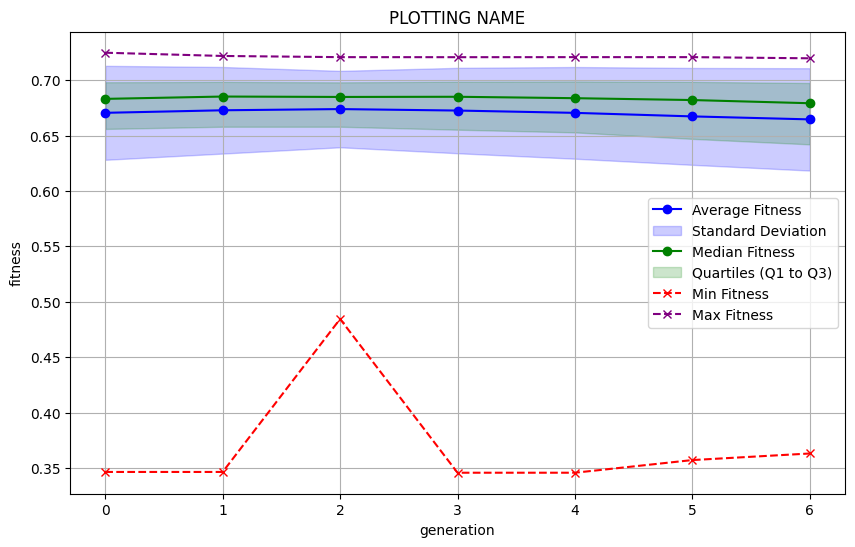

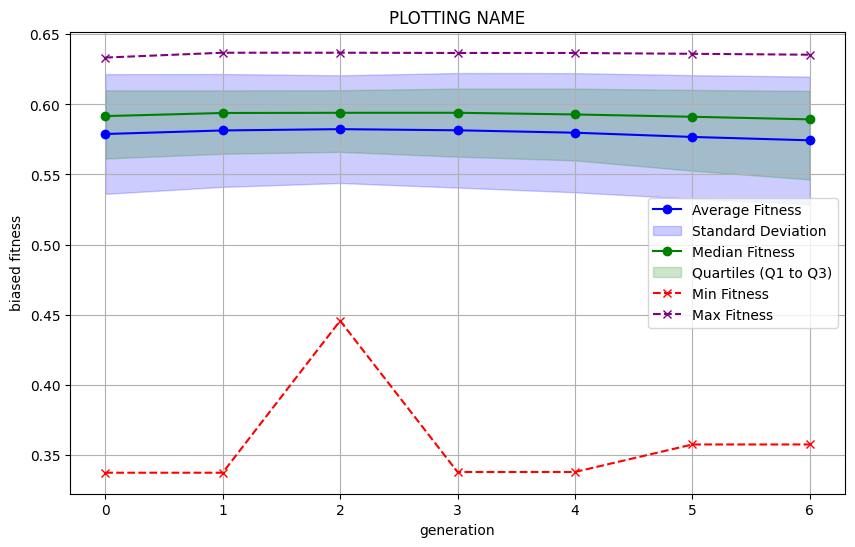

In [3]:
suite.evolution_storage.plot_fitness(
    storage="fitness",
    title="PLOTTING NAME",
    xlabel="generation",
    ylabel="fitness",
)
suite.evolution_storage.plot_fitness(
    storage="biased_fitness",
    title="PLOTTING NAME",
    xlabel="generation",
    ylabel="biased fitness",
)

# 4. Analyze final population(unique)

1. population은 최종 선택된 개체만 남게 됩니다.
2. `population[i]`는 각 VentHole 유전자(Chromosome)이 도출됩니다.
3. `population[i].pattern_matrix` 에는 pattern에 격자화된 point vector가 존재합니다.
3. `population[i].gene_tuple` 을 통해 최종적인 유전자에 접근할 수 있습니다.


--------------------------------------------------
label: VentHole Chromosome_509: ['CircleShape_948', 'CornerTransformation_310']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


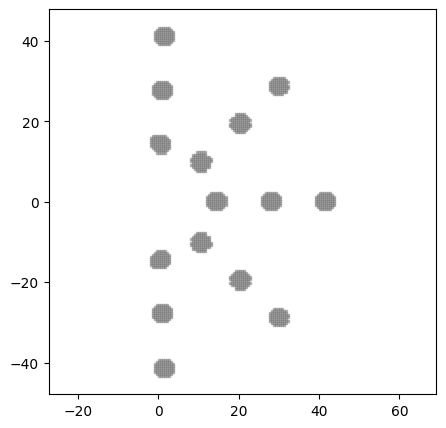

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_277', 'CircularStrictTransformation_991']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.556587748578083, phi: 0.5235987755982988, ]


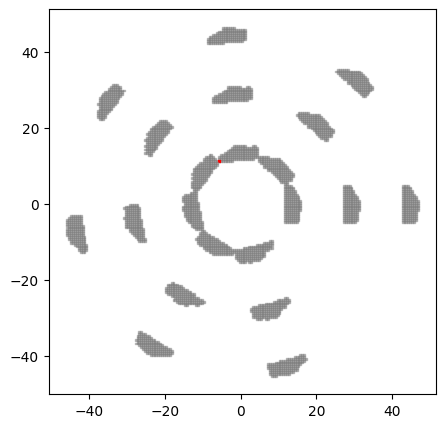

--------------------------------------------------
label: VentHole Chromosome_489: ['DonutShape_34', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.556587748578083, phi: 0.5235987755982988, ]


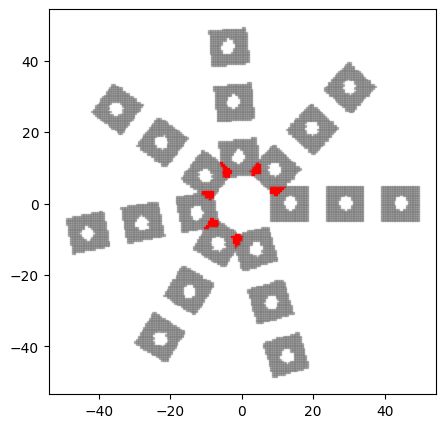

--------------------------------------------------
label: VentHole Chromosome_298: ['DonutShape_489', 'CircularStrictTransformation_120']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.807728062127912, phi: 0.5235987755982988, ]


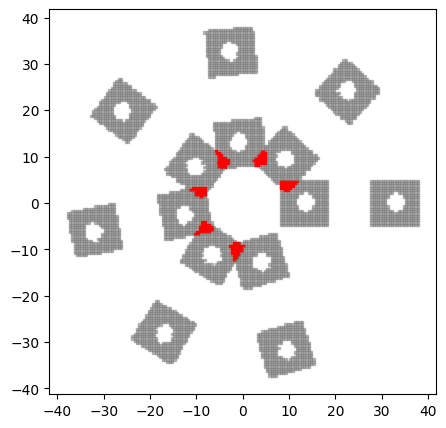

--------------------------------------------------
label: VentHole Chromosome_884: ['DonutShape_884', 'CircularStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.761051345084564, r_outer: 9.241956798635755, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


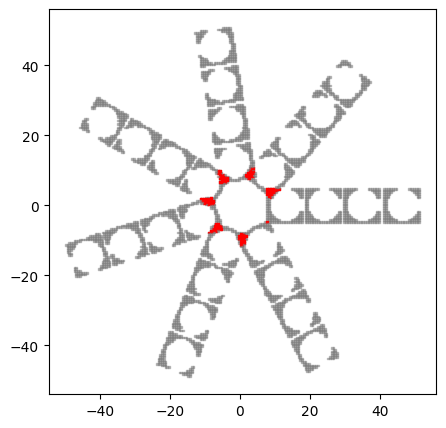

--------------------------------------------------
label: VentHole Chromosome_792: ['RayShape_574', 'GridStrictTransformation_109']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 8.473360805396354, dy: 4.999594967018924, ]


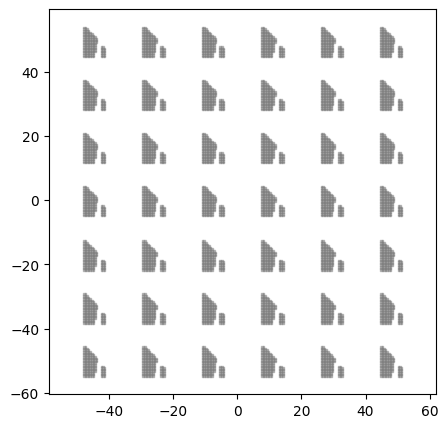

--------------------------------------------------
label: VentHole Chromosome_164: ['DoubleParabolicShape_164', 'CircularStrictTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.2661943750335705, upper_coefficient: 1.7218859482710167, lower_y-intercept: 2.983751818459124, upper_y-intercept_from_lower_y: 1.6457817518665636, lower_x_trans: 0.9999517746226037, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


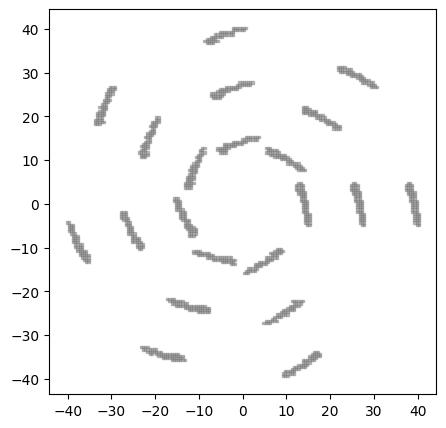

--------------------------------------------------
label: VentHole Chromosome_574: ['TriangleShape_823', 'CircularStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


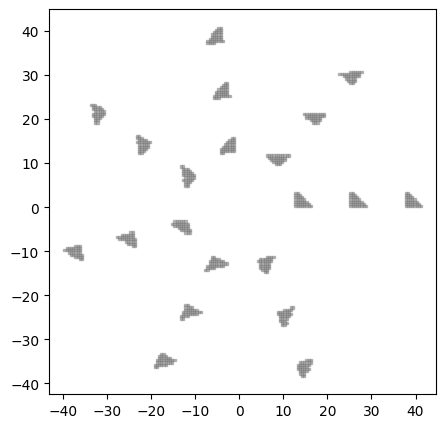

--------------------------------------------------
label: VentHole Chromosome_62: ['TriangleShape_574', 'CircularStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 10.361753423475667, dx: 8.780057641834707, phi: 0.5235987755982988, ]


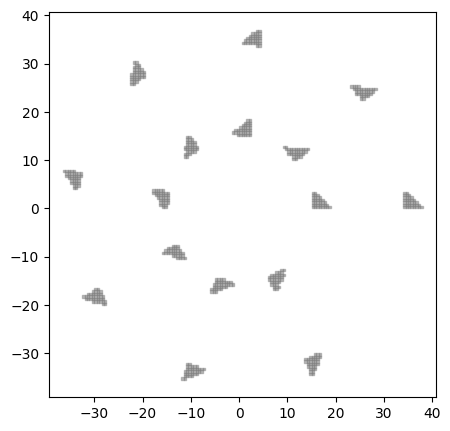

--------------------------------------------------
label: VentHole Chromosome_875: ['TriangleShape_824', 'CircularStrictTransformation_574']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


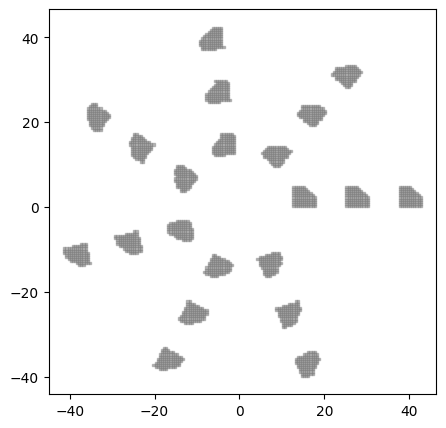

--------------------------------------------------
label: VentHole Chromosome_991: ['DonutShape_884', 'CircularStrictTransformation_875']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 9.795259919111736, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


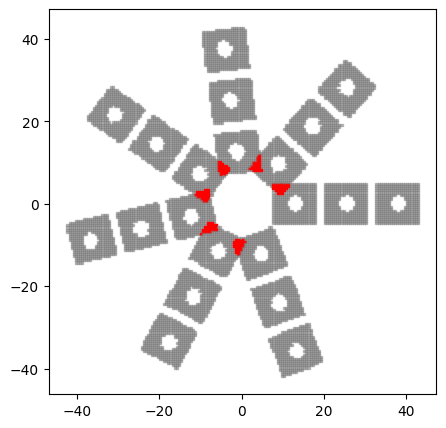

--------------------------------------------------
label: VentHole Chromosome_808: ['RayShape_540', 'CornerTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


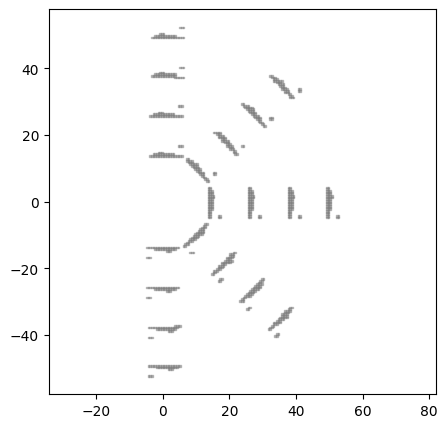

--------------------------------------------------
label: VentHole Chromosome_146: ['RayShape_808', 'GridStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 7.3234603630440285, dy: 4.625347881243773, ]


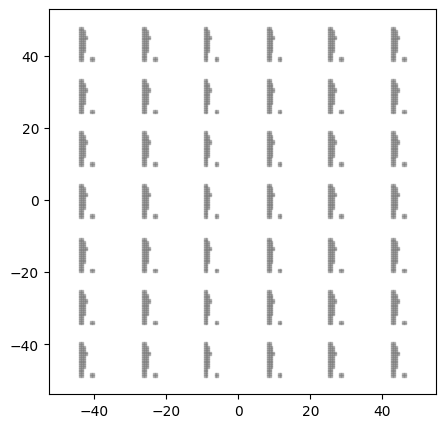

--------------------------------------------------
label: VentHole Chromosome_829: ['TrapezoidShape_829', 'CircularStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.930168809539807, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


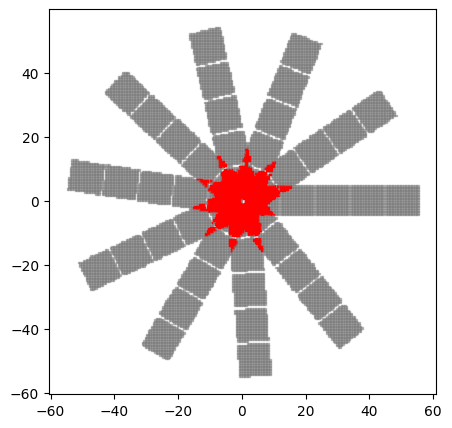

--------------------------------------------------
label: VentHole Chromosome_101: ['DonutShape_142', 'CircularStrictTransformation_829']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


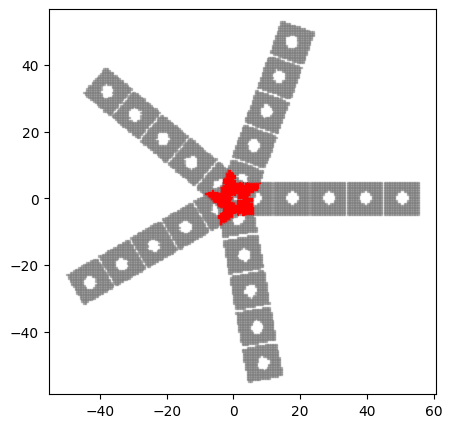

--------------------------------------------------
label: VentHole Chromosome_34: ['TriangleShape_62', 'CornerTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.6140788190176885, phi: 0.37379313265598324, rot_count: 6.0, ]


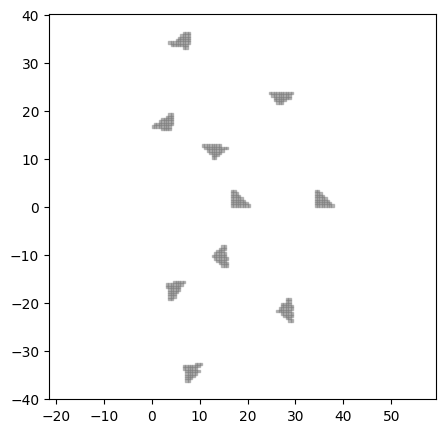

--------------------------------------------------
label: VentHole Chromosome_487: ['TriangleShape_34', 'CircularStrictTransformation_324']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


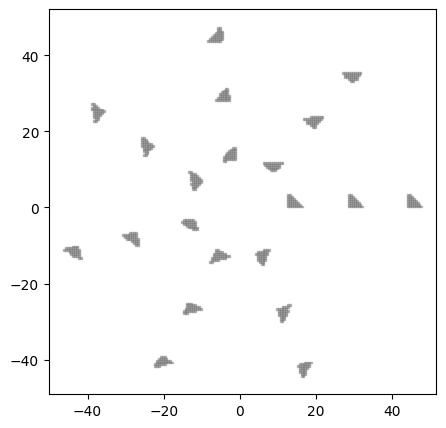

--------------------------------------------------
label: VentHole Chromosome_332: ['RayShape_792', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


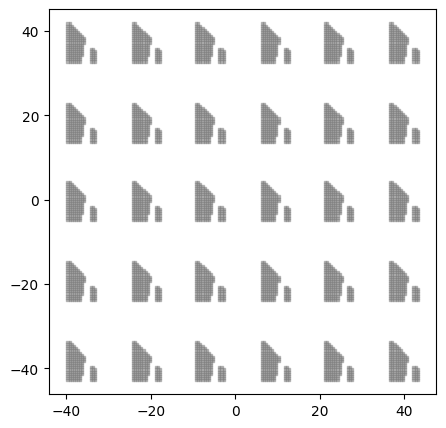

--------------------------------------------------
label: VentHole Chromosome_107: ['WingShape_529', 'GridStrictTransformation_332']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


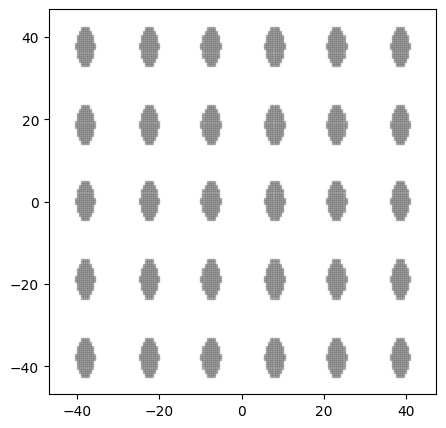

--------------------------------------------------
label: VentHole Chromosome_285: ['RayShape_713', 'GridStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.5053957586144247, nose_point: 1.1119489214540719, lower_coefficient: 3.712701426288192, lower_x-intercept: 2.9767626622629932, lower_y-intercept: 1.7646987033421309, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


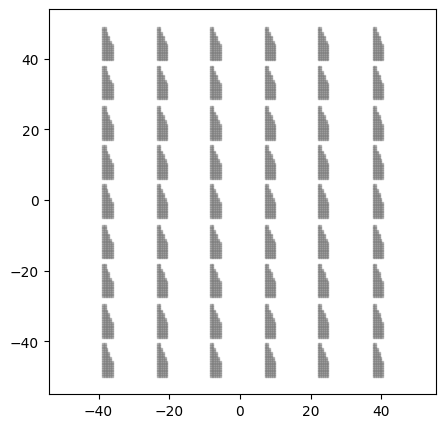

--------------------------------------------------
label: VentHole Chromosome_713: ['TriangleShape_191', 'GridStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


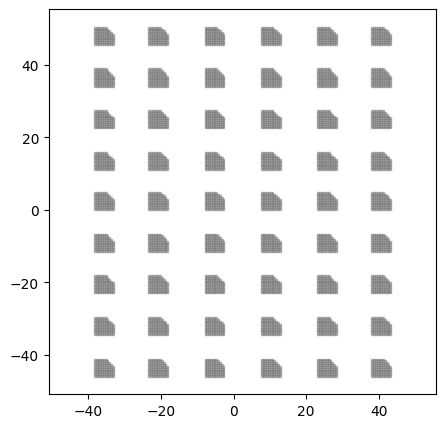

--------------------------------------------------
label: VentHole Chromosome_488: ['TriangleShape_713', 'GridStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ dx: 3.8209213763581897, dy: 8.794727031067021, ]


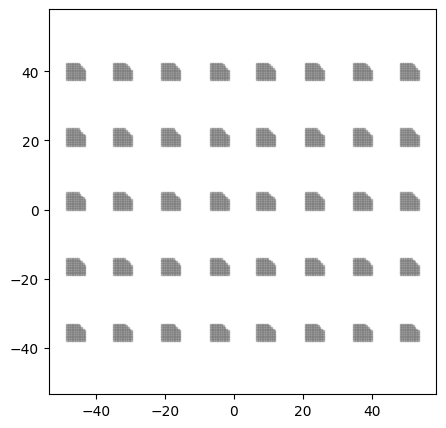

--------------------------------------------------
label: VentHole Chromosome_871: ['TrapezoidShape_871', 'CornerTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


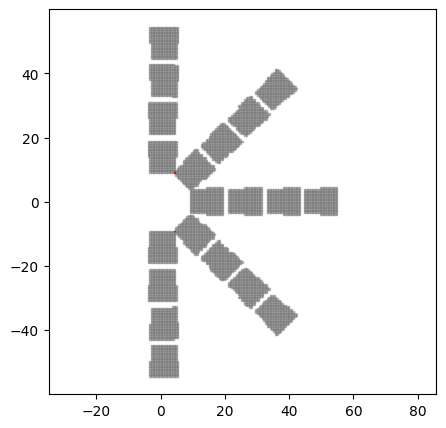

--------------------------------------------------
label: VentHole Chromosome_556: ['HoleShape_889', 'CornerTransformation_382']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.776942860477072, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


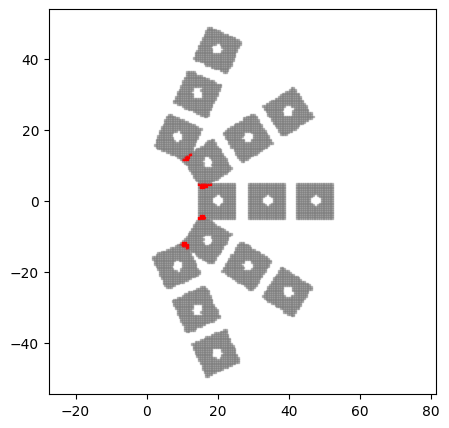

--------------------------------------------------
label: VentHole Chromosome_382: ['WingShape_365', 'GridStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 6.850813481976112, ]


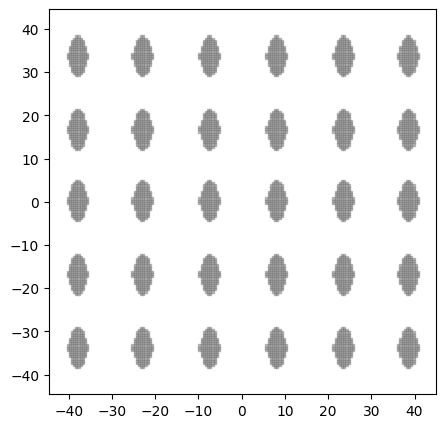

--------------------------------------------------
label: VentHole Chromosome_366: ['DoubleParabolicShape_398', 'GridStrictTransformation_382']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 6.850813481976112, ]


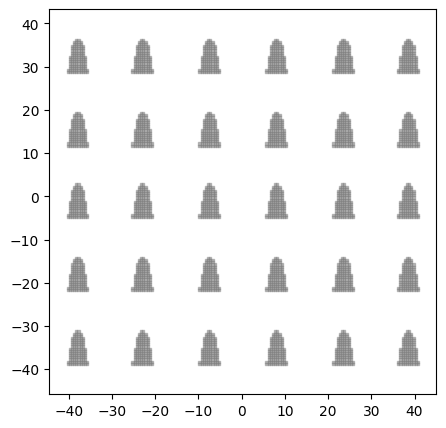

--------------------------------------------------
label: VentHole Chromosome_398: ['DoubleParabolicShape_366', 'CornerTransformation_509']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


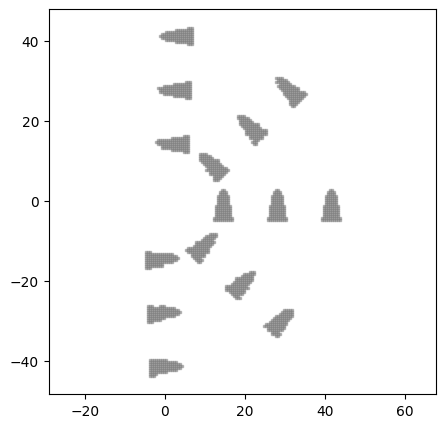

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_556', 'CornerTransformation_282']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 5.0, ]


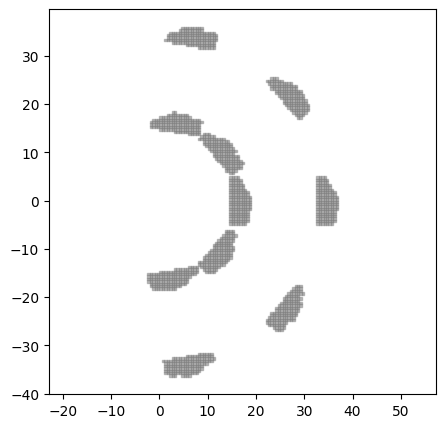

--------------------------------------------------
label: VentHole Chromosome_415: ['TriangleShape_415', 'CircularStrictTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.371250985532132, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.483321946706122, ]


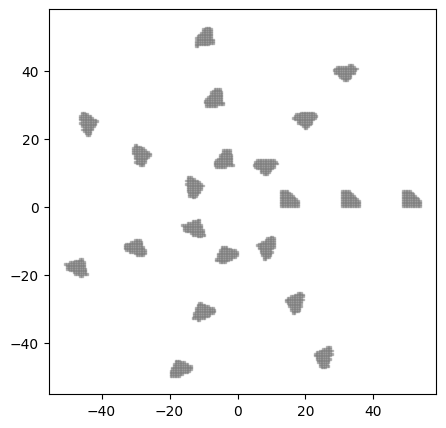

--------------------------------------------------
label: VentHole Chromosome_349: ['DonutShape_282', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 8.780235503775744, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.7853981633974483, ]


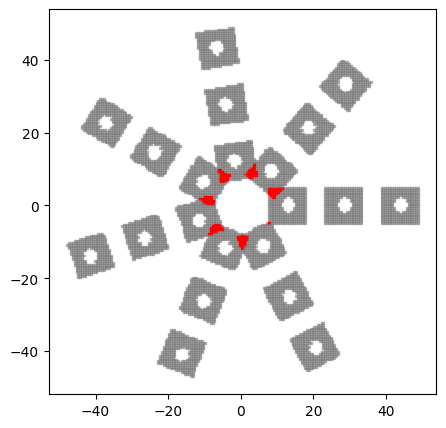

--------------------------------------------------
label: VentHole Chromosome_7: ['HoleShape_649', 'CircularStrictTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.7853981633974483, ]


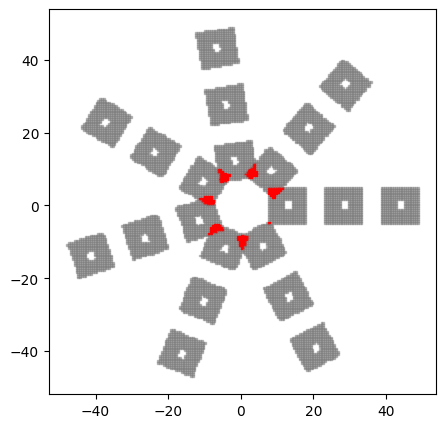

--------------------------------------------------
label: VentHole Chromosome_355: ['TriangleShape_488', 'GridStrictTransformation_264']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


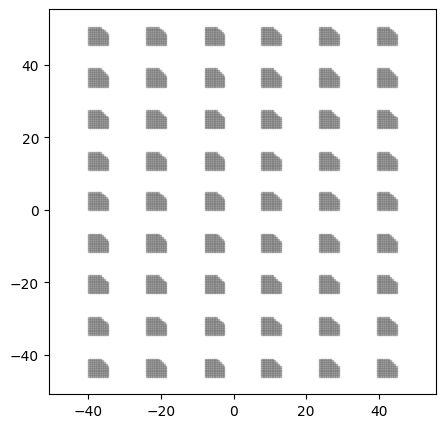

--------------------------------------------------
label: VentHole Chromosome_488: ['TriangleShape_355', 'CornerTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


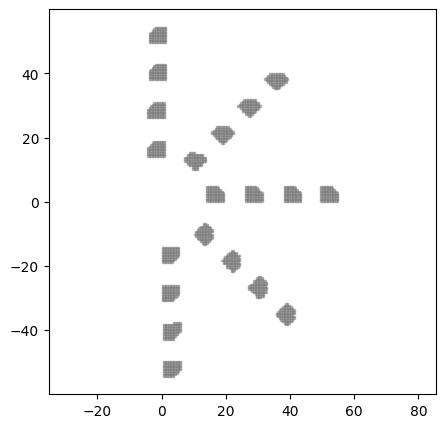

--------------------------------------------------
label: VentHole Chromosome_808: ['RayShape_89', 'CircularStrictTransformation_884']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.8257282907256152, nose_point: 2.3585973878335977, lower_coefficient: 2.9990207161788933, lower_x-intercept: 3.5039730262192608, lower_y-intercept: 1.2711383997652552, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


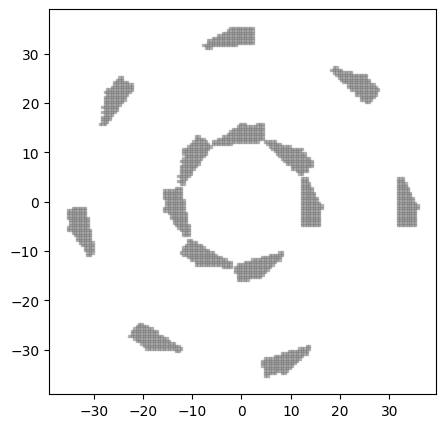

--------------------------------------------------
label: VentHole Chromosome_792: ['HoleShape_606', 'CircularStrictTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


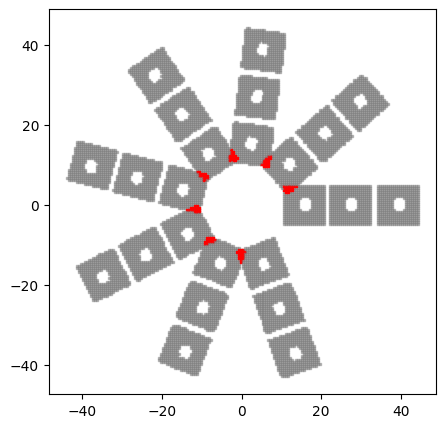

--------------------------------------------------
label: VentHole Chromosome_685: ['DonutShape_298', 'CircularStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


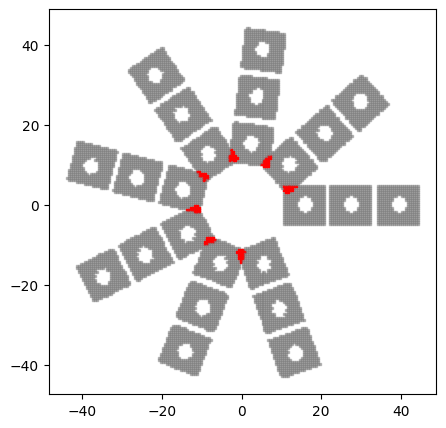

--------------------------------------------------
label: VentHole Chromosome_304: ['DonutShape_685', 'CircularStrictTransformation_86']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


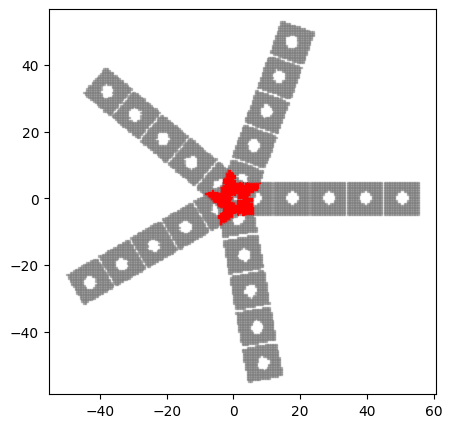

--------------------------------------------------
label: VentHole Chromosome_86: ['HoleShape_363', 'CircularStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


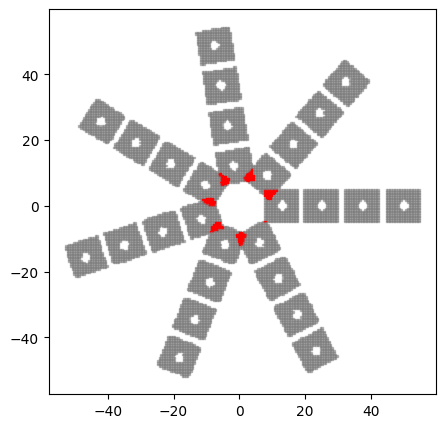

--------------------------------------------------
label: VentHole Chromosome_304: ['DonutShape_304', 'CornerTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


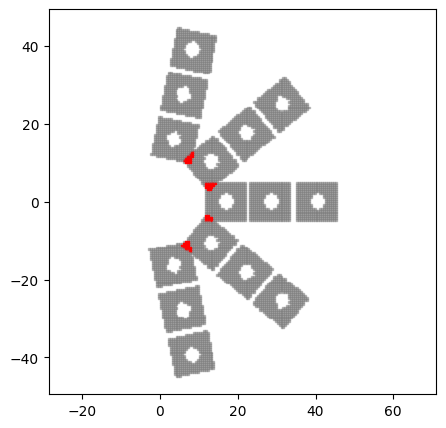

--------------------------------------------------
label: VentHole Chromosome_346: ['DonutShape_304', 'CircularStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.4487989505128276, ]


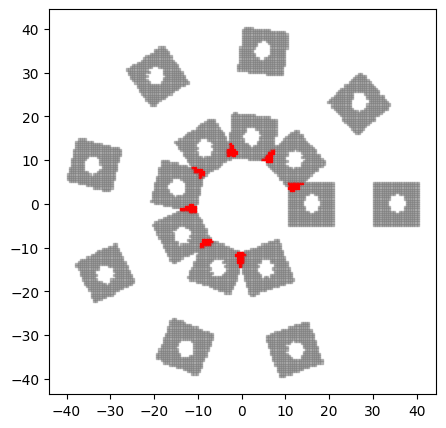

--------------------------------------------------
label: VentHole Chromosome_388: ['WingShape_107', 'CircularStrictTransformation_346']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.4487989505128276, ]


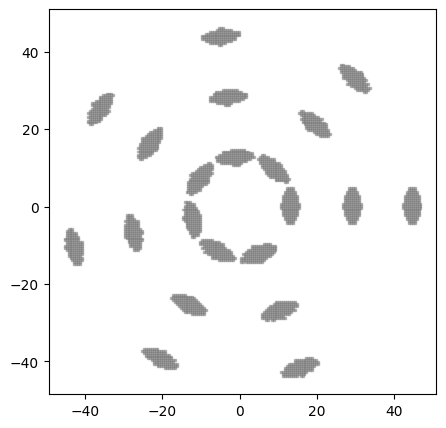

--------------------------------------------------
label: VentHole Chromosome_971: ['RayShape_146', 'CircularStrictTransformation_489']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


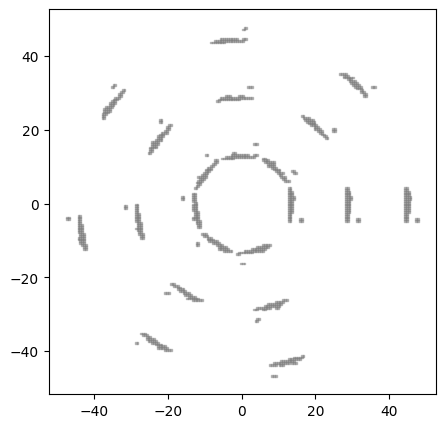

--------------------------------------------------
label: VentHole Chromosome_684: ['TriangleShape_875', 'GridStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


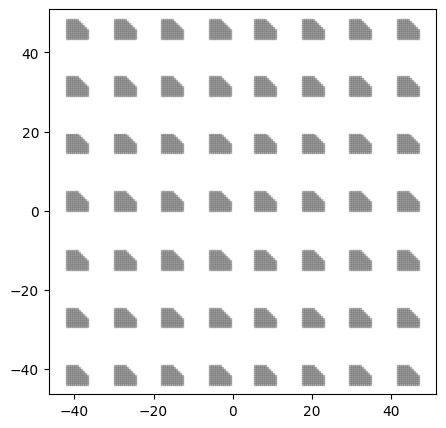

--------------------------------------------------
label: VentHole Chromosome_556: ['TriangleShape_487', 'GridStrictTransformation_468']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


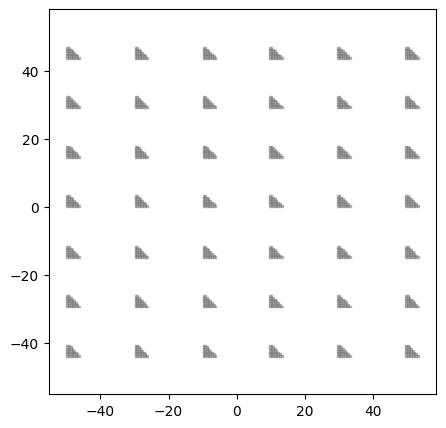

--------------------------------------------------
label: VentHole Chromosome_366: ['TriangleShape_556', 'GridStrictTransformation_684']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


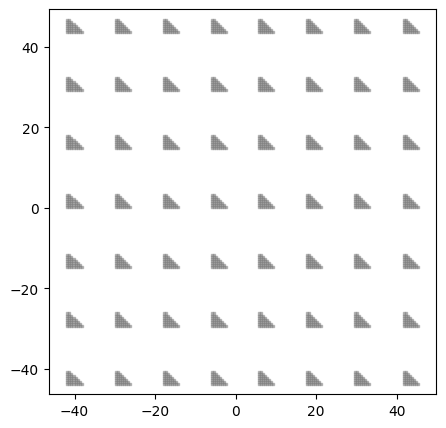

--------------------------------------------------
label: VentHole Chromosome_329: ['TriangleShape_33', 'GridStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


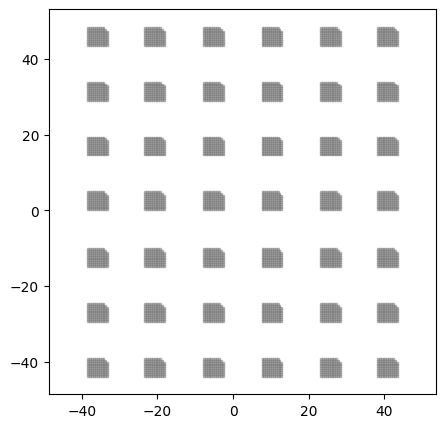

--------------------------------------------------
label: VentHole Chromosome_191: ['TriangleShape_329', 'CircularStrictTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.6283185307179586, ]


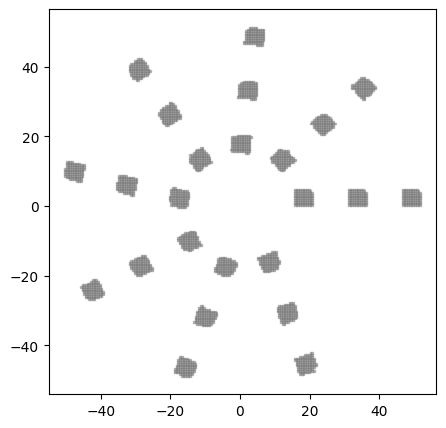

--------------------------------------------------
label: VentHole Chromosome_108: ['HoleShape_321', 'CircularStrictTransformation_740']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


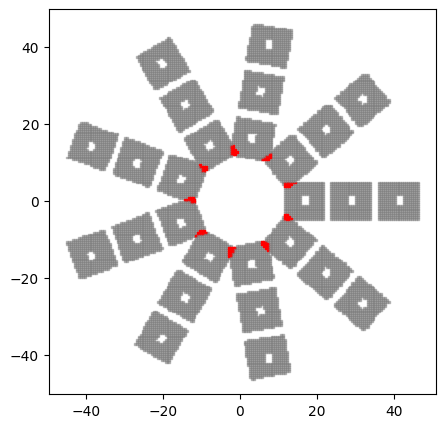

--------------------------------------------------
label: VentHole Chromosome_298: ['TrapezoidShape_871', 'GridStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


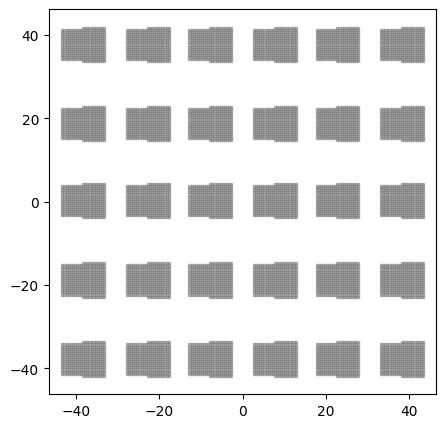

--------------------------------------------------
label: VentHole Chromosome_871: ['HoleShape_108', 'GridStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


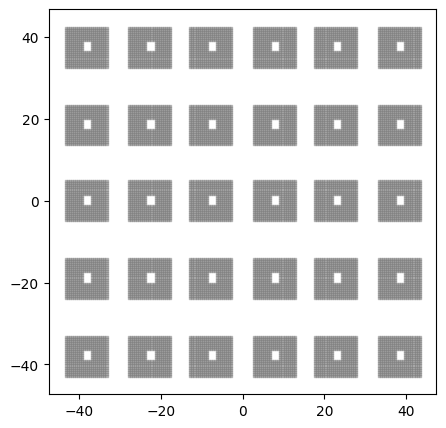

--------------------------------------------------
label: VentHole Chromosome_849: ['RayShape_556', 'CircularStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


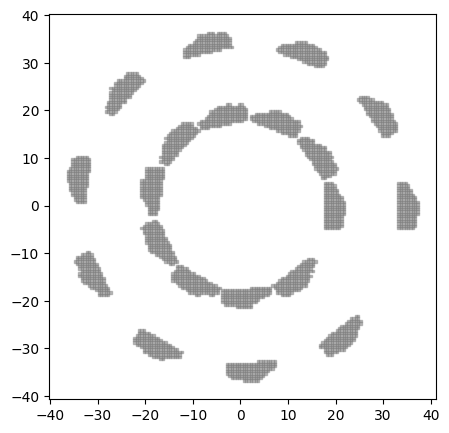

--------------------------------------------------
label: VentHole Chromosome_694: ['WingShape_751', 'CornerTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 2.79176786166162, phi: 0.4098912790616371, rot_count: 3.0, ]


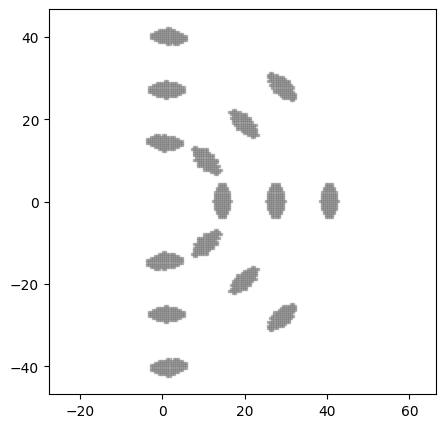

--------------------------------------------------
label: VentHole Chromosome_751: ['WingShape_694', 'GridStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


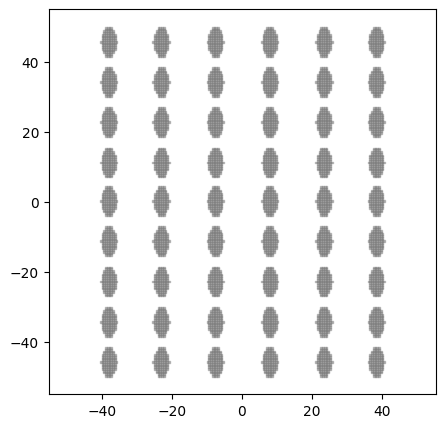

--------------------------------------------------
label: VentHole Chromosome_443: ['DoubleParabolicShape_729', 'GridStrictTransformation_751']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


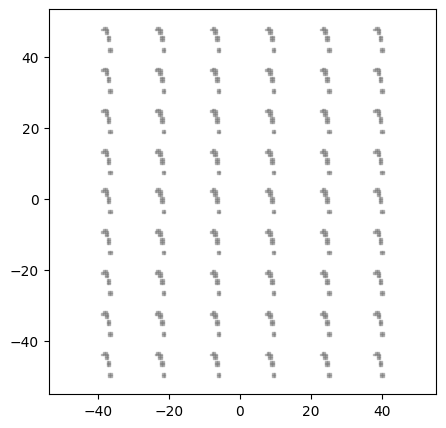

--------------------------------------------------
label: VentHole Chromosome_722: ['DonutShape_101', 'CircularStrictTransformation_722']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 8.780057641834707, phi: 0.6981317007977318, ]


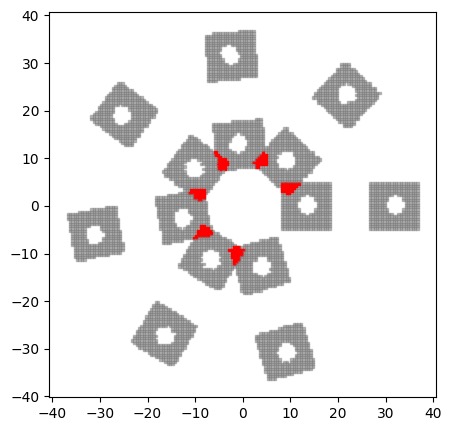

--------------------------------------------------
label: VentHole Chromosome_316: ['DonutShape_722', 'CornerTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


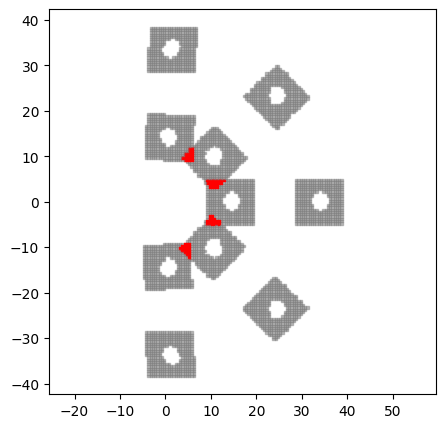

--------------------------------------------------
label: VentHole Chromosome_367: ['DonutShape_979', 'CircularStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


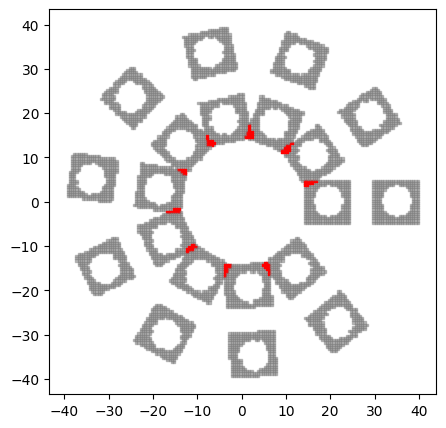

--------------------------------------------------
label: VentHole Chromosome_692: ['DoubleParabolicShape_398', 'GridStrictTransformation_107']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


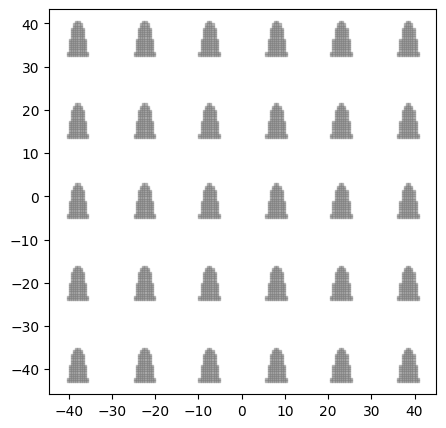

--------------------------------------------------
label: VentHole Chromosome_258: ['HoleShape_7', 'GridStrictTransformation_692']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


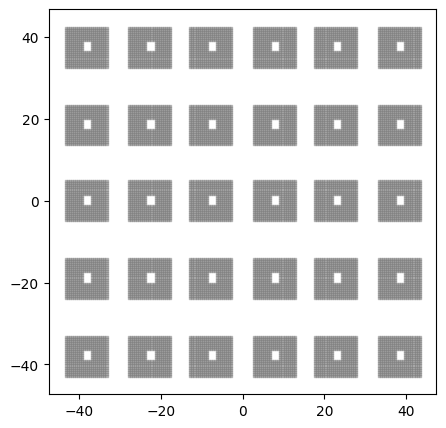

--------------------------------------------------
label: VentHole Chromosome_712: ['HoleShape_258', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


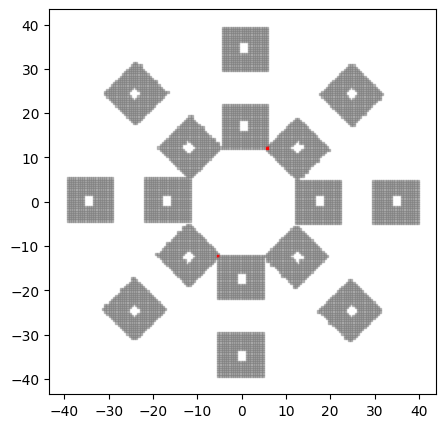

--------------------------------------------------
label: VentHole Chromosome_529: ['DoubleParabolicShape_783', 'CircularStrictTransformation_712']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


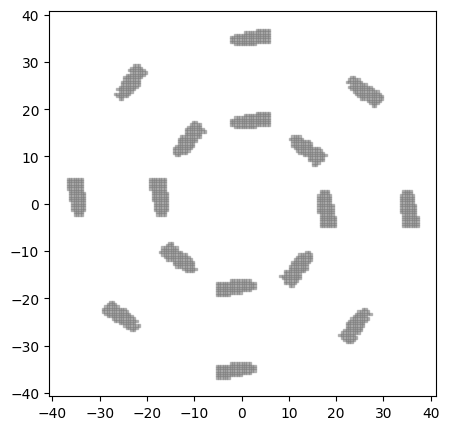

--------------------------------------------------
label: VentHole Chromosome_783: ['DoubleParabolicShape_529', 'GridStrictTransformation_791']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


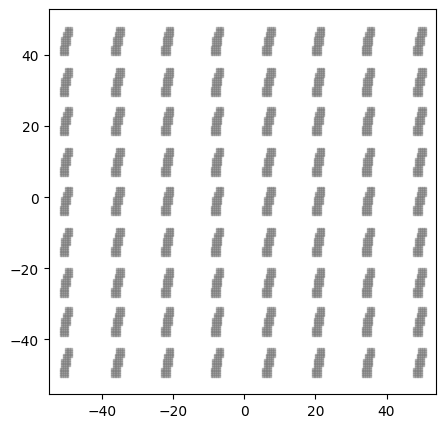

--------------------------------------------------
label: VentHole Chromosome_791: ['TrapezoidShape_630', 'GridStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


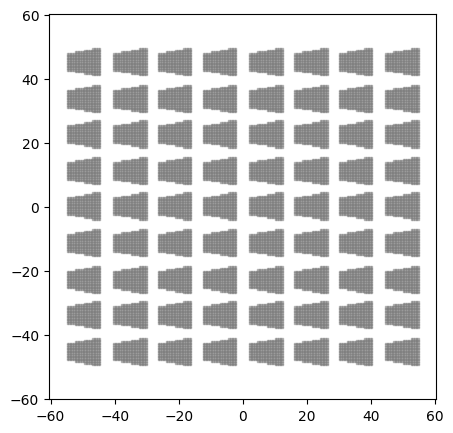

--------------------------------------------------
label: VentHole Chromosome_467: ['TrapezoidShape_791', 'CircularStrictTransformation_531']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


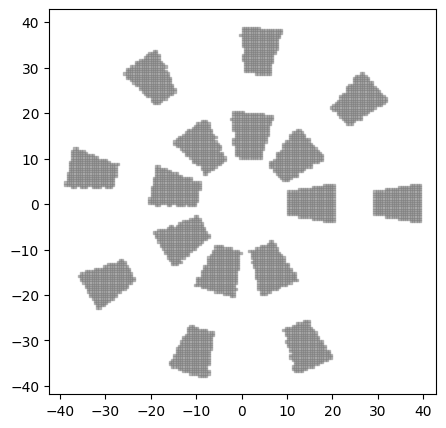

--------------------------------------------------
label: VentHole Chromosome_300: ['DoubleParabolicShape_488', 'CircularStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


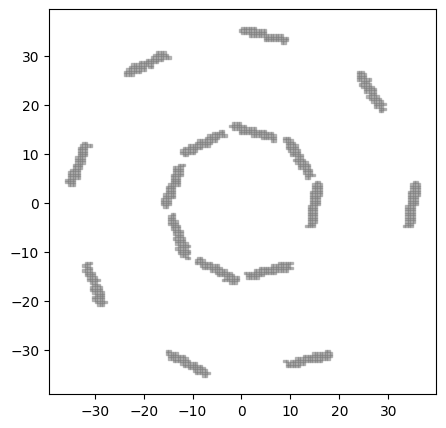

--------------------------------------------------
label: VentHole Chromosome_403: ['TriangleShape_16', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


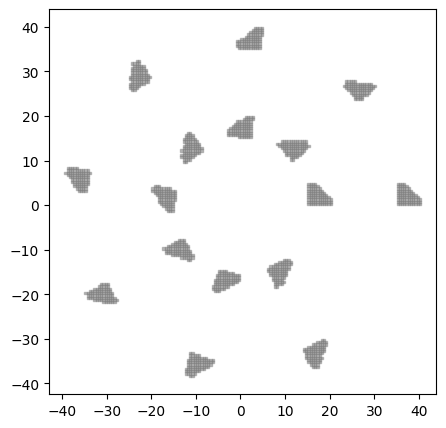

--------------------------------------------------
label: VentHole Chromosome_736: ['TriangleShape_403', 'CornerTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


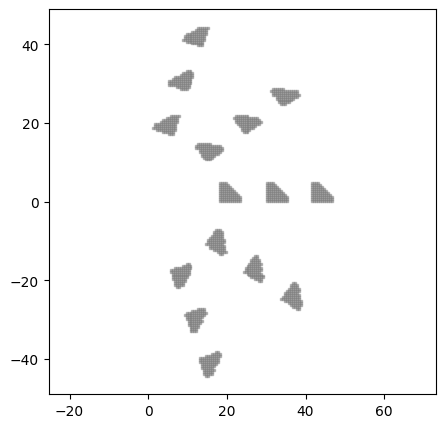

--------------------------------------------------
label: VentHole Chromosome_304: ['HoleShape_44', 'CornerTransformation_736']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.7190393992841844, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


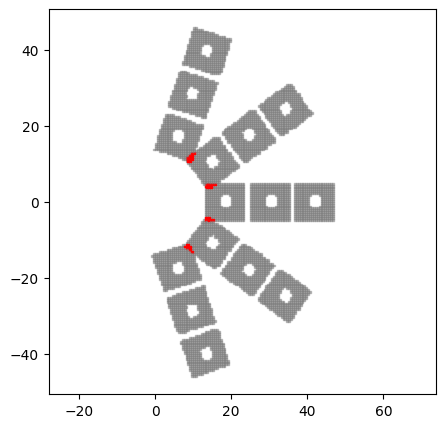

--------------------------------------------------
label: VentHole Chromosome_93: ['HoleShape_304', 'GridStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.7190393992841844, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


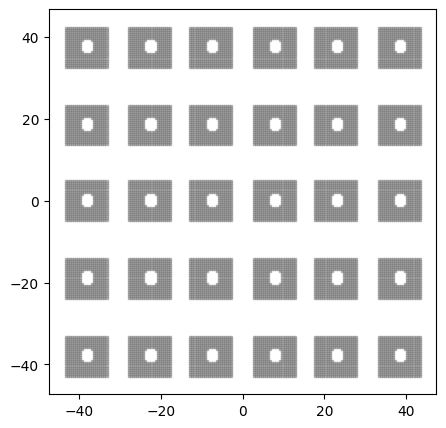

--------------------------------------------------
label: VentHole Chromosome_871: ['CircleShape_432', 'GridStrictTransformation_93']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


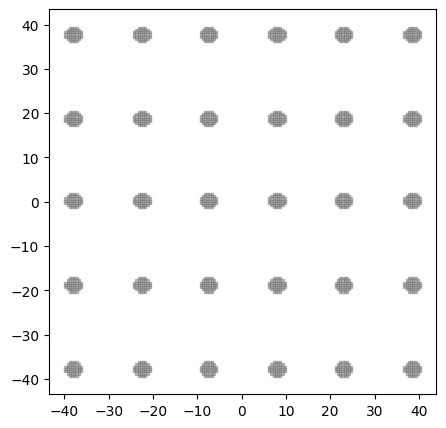

--------------------------------------------------
label: VentHole Chromosome_349: ['CircleShape_871', 'CircularStrictTransformation_971']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


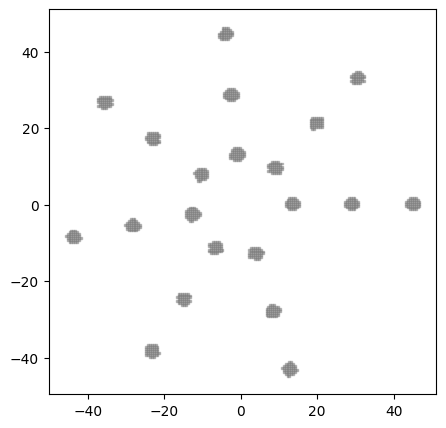

--------------------------------------------------
label: VentHole Chromosome_975: ['TrapezoidShape_991', 'CircularStrictTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


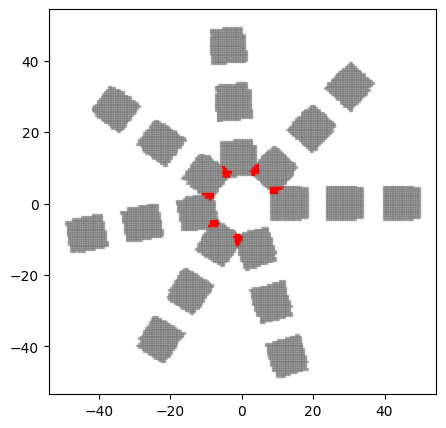

--------------------------------------------------
label: VentHole Chromosome_751: ['TrapezoidShape_975', 'CornerTransformation_824']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


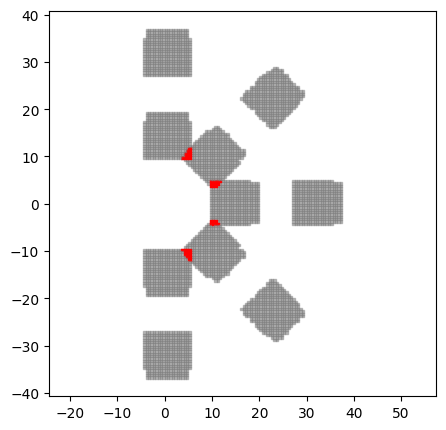

--------------------------------------------------
label: VentHole Chromosome_167: ['WingShape_808', 'GridStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


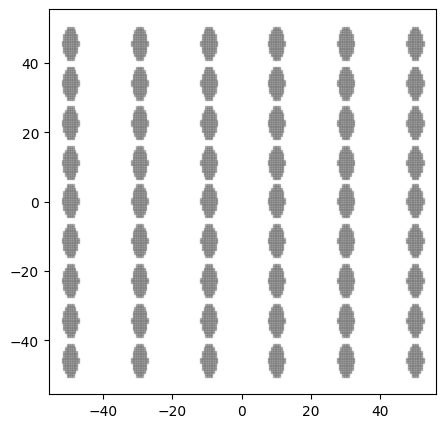

--------------------------------------------------
label: VentHole Chromosome_551: ['TriangleShape_363', 'CircularStrictTransformation_108']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


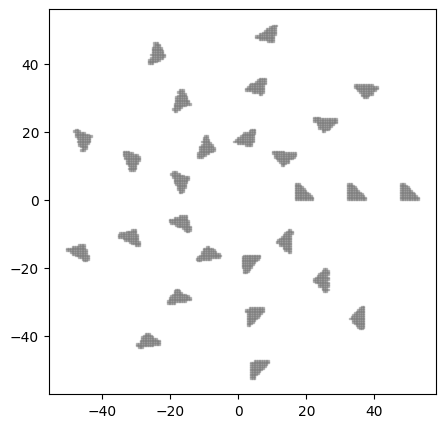

--------------------------------------------------
label: VentHole Chromosome_298: ['RayShape_849', 'CircularStrictTransformation_551']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


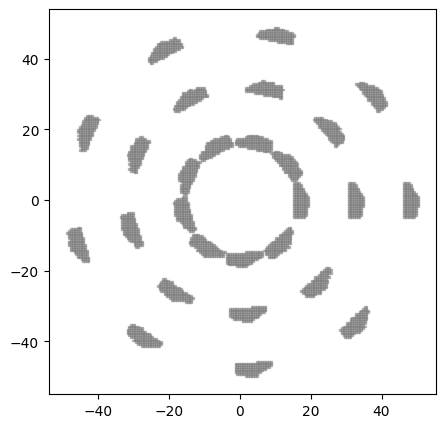

--------------------------------------------------
label: VentHole Chromosome_899: ['RayShape_298', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


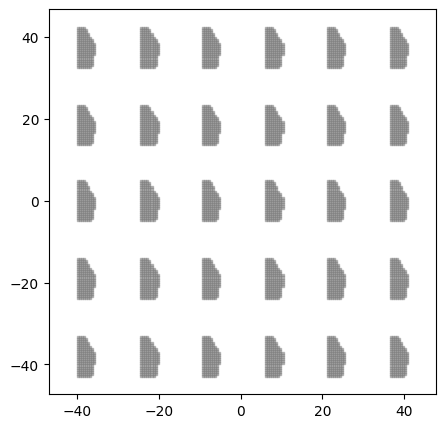

--------------------------------------------------
label: VentHole Chromosome_258: ['WingShape_751', 'GridStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


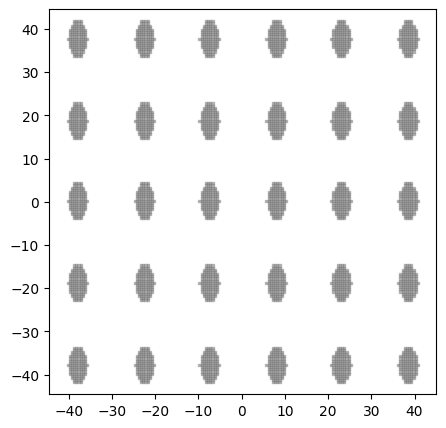

--------------------------------------------------
label: VentHole Chromosome_7: ['WingShape_258', 'CircularStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


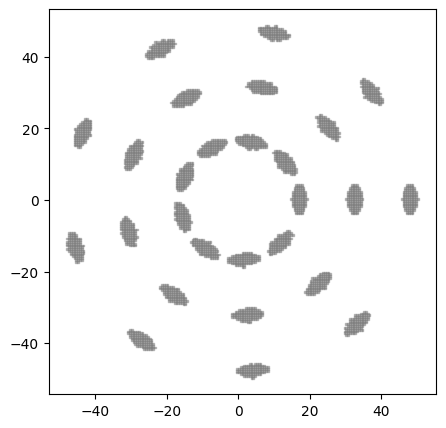

--------------------------------------------------
label: VentHole Chromosome_964: ['CircleShape_487', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


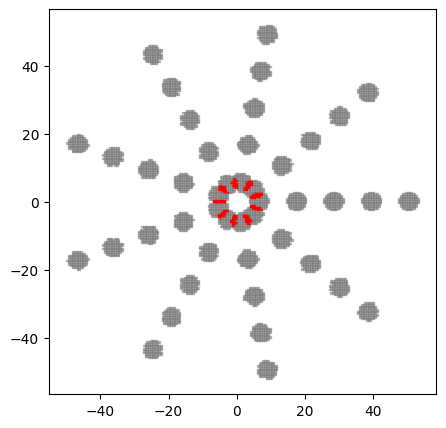

--------------------------------------------------
label: VentHole Chromosome_616: ['CircleShape_964', 'CircularStrictTransformation_126']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


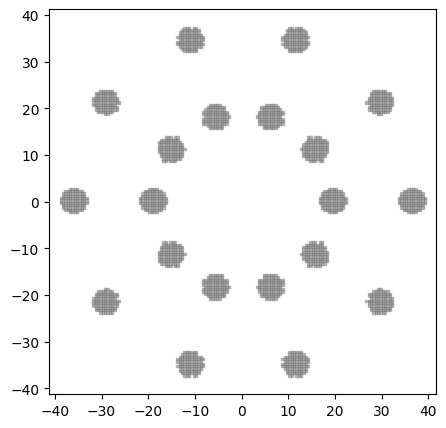

--------------------------------------------------
label: VentHole Chromosome_659: ['TrapezoidShape_659', 'CircularStrictTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


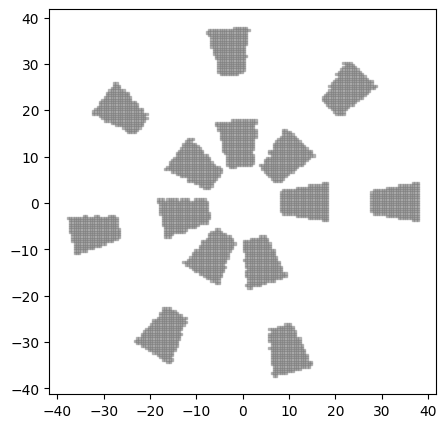

--------------------------------------------------
label: VentHole Chromosome_447: ['RayShape_285', 'CircularStrictTransformation_659']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.5053957586144247, nose_point: 1.1119489214540719, lower_coefficient: 3.712701426288192, lower_x-intercept: 2.9767626622629932, lower_y-intercept: 1.7646987033421309, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


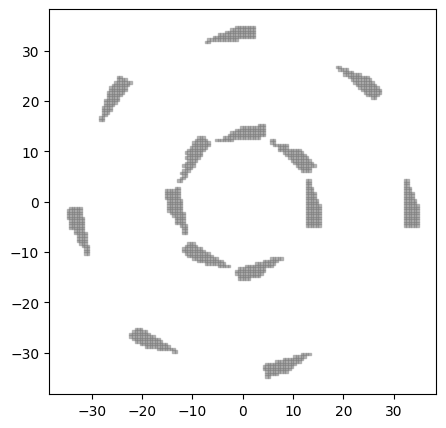

--------------------------------------------------
label: VentHole Chromosome_713: ['RayShape_447', 'CircularStrictTransformation_991']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.5053957586144247, nose_point: 1.1119489214540719, lower_coefficient: 3.712701426288192, lower_x-intercept: 2.9767626622629932, lower_y-intercept: 1.7646987033421309, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


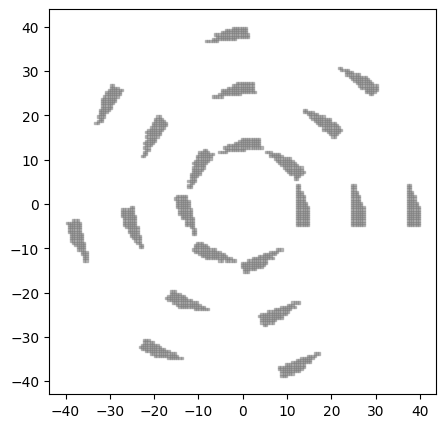

--------------------------------------------------
label: VentHole Chromosome_855: ['WingShape_167', 'GridStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


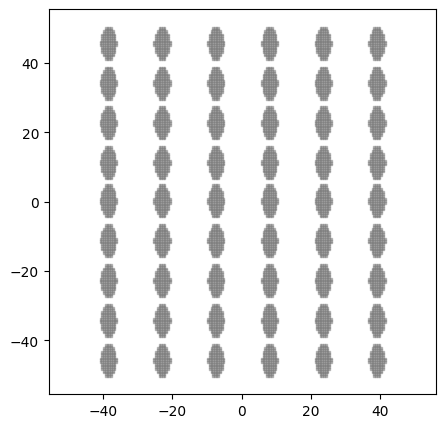

--------------------------------------------------
label: VentHole Chromosome_122: ['CircleShape_694', 'GridStrictTransformation_855']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


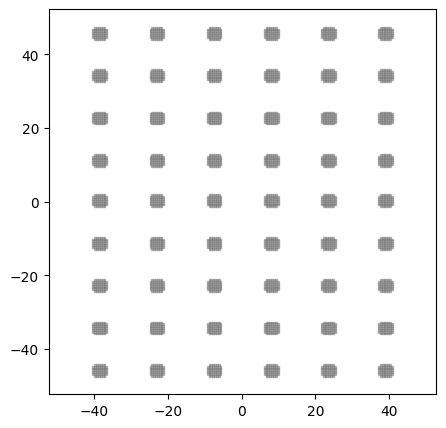

--------------------------------------------------
label: VentHole Chromosome_529: ['CircleShape_122', 'CircularStrictTransformation_462']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


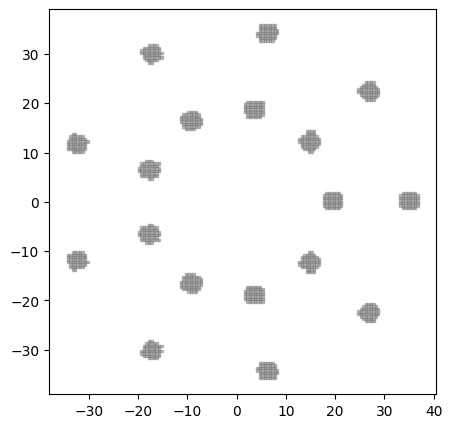

--------------------------------------------------
label: VentHole Chromosome_438: ['TrapezoidShape_7', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


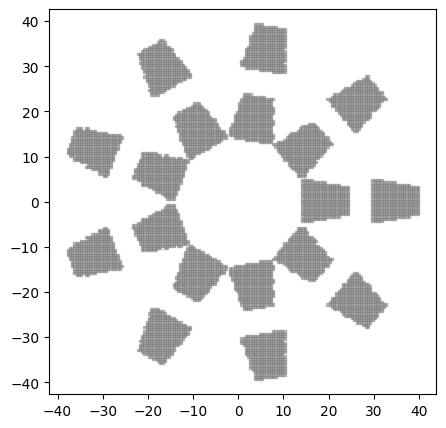

--------------------------------------------------
label: VentHole Chromosome_919: ['TrapezoidShape_438', 'GridStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


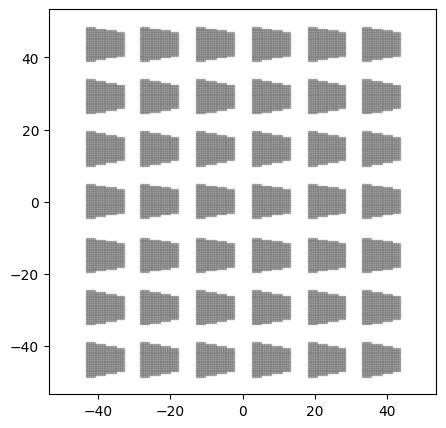

--------------------------------------------------
label: VentHole Chromosome_253: ['CircleShape_839', 'GridStrictTransformation_919']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.759517141611187, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


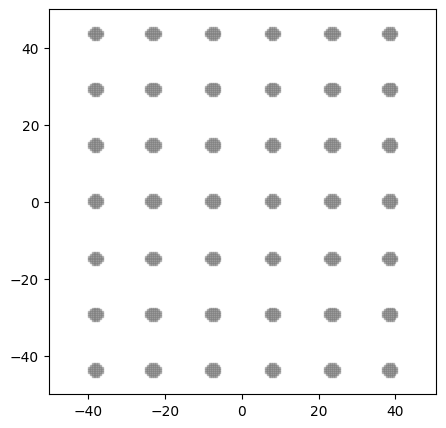

--------------------------------------------------
label: VentHole Chromosome_839: ['RayShape_808', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.8257282907256152, nose_point: 2.3585973878335977, lower_coefficient: 2.9990207161788933, lower_x-intercept: 3.5039730262192608, lower_y-intercept: 1.2711383997652552, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 2.3176269767576296, phi: 0.41887902047863906, ]


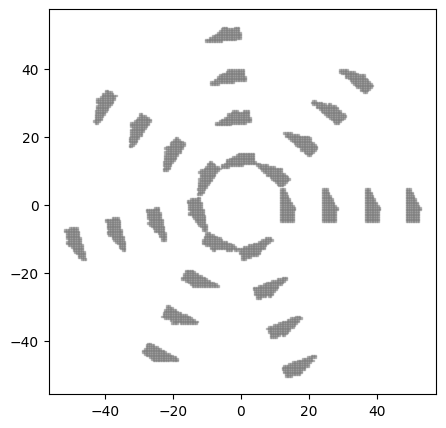

--------------------------------------------------
label: VentHole Chromosome_164: ['DoubleParabolicShape_304', 'CircularStrictTransformation_415']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.483321946706122, ]


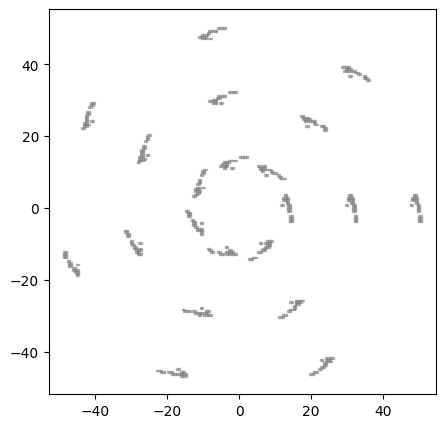

--------------------------------------------------
label: VentHole Chromosome_685: ['DoubleParabolicShape_164', 'CornerTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


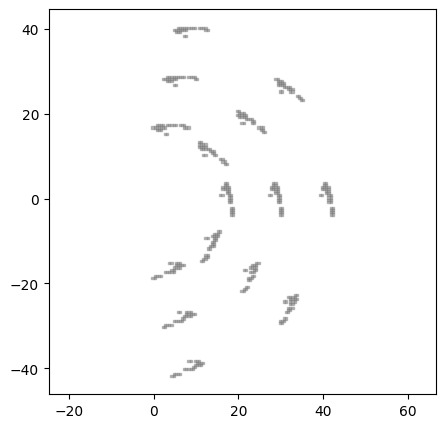

--------------------------------------------------
label: VentHole Chromosome_164: ['DonutShape_164', 'GridStrictTransformation_443']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.30142999997884, r_outer: 7.879177221925768, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


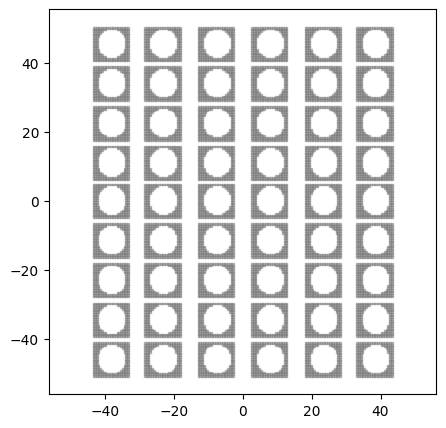

--------------------------------------------------
label: VentHole Chromosome_96: ['TrapezoidShape_529', 'GridStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.045318289883957, k2: 1.907833174810472, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


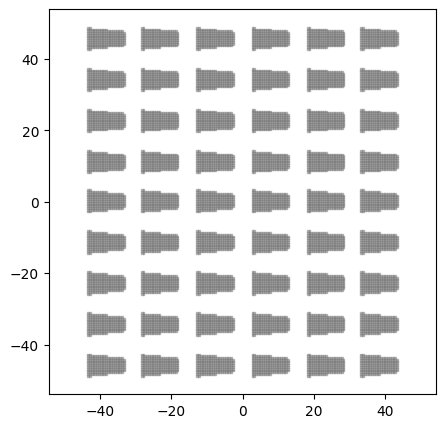

--------------------------------------------------
label: VentHole Chromosome_529: ['CircleShape_616', 'CornerTransformation_316']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


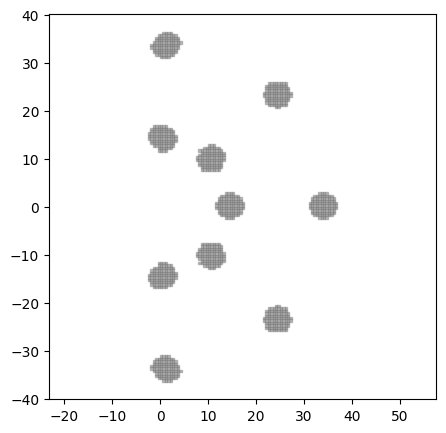

--------------------------------------------------
label: VentHole Chromosome_778: ['CircleShape_509', 'CornerTransformation_778']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.9150283484613553, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.8626394042569998, phi: 0.4782732026857485, rot_count: 6.0, ]


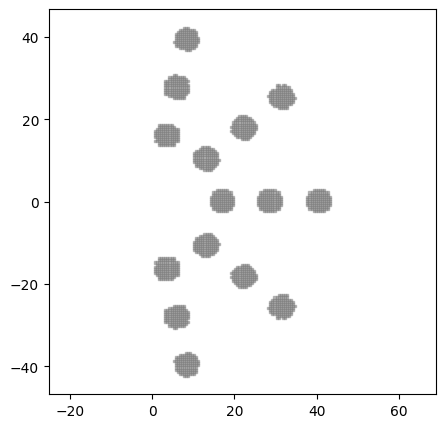

--------------------------------------------------
label: VentHole Chromosome_352: ['CircleShape_778', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.9150283484613553, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


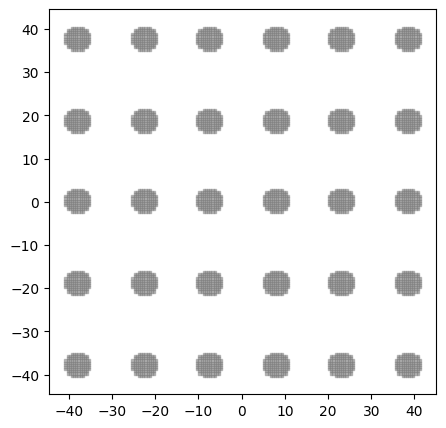

--------------------------------------------------
label: VentHole Chromosome_258: ['RayShape_258', 'CornerTransformation_614']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


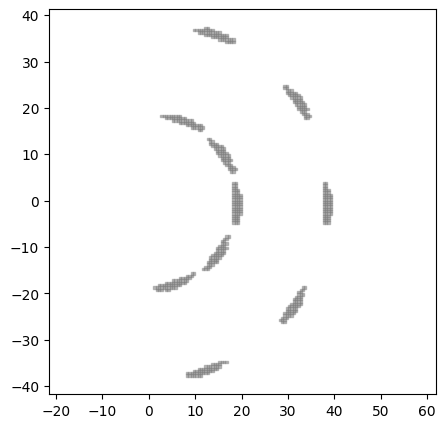

--------------------------------------------------
label: VentHole Chromosome_614: ['WingShape_855', 'CircularStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


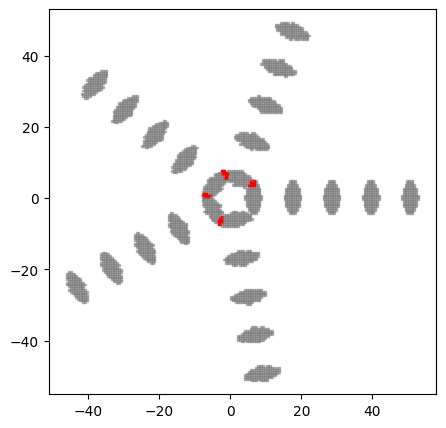

--------------------------------------------------
label: VentHole Chromosome_101: ['TriangleShape_164', 'CircularStrictTransformation_614']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


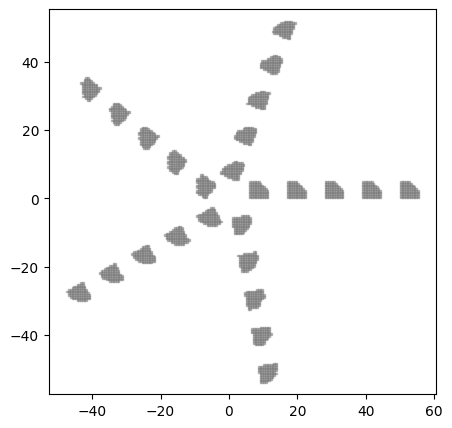

--------------------------------------------------
label: VentHole Chromosome_886: ['TriangleShape_101', 'CornerTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


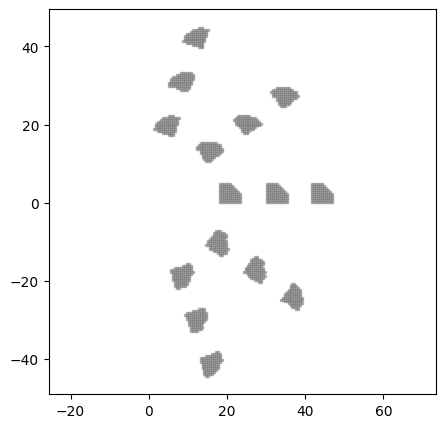

--------------------------------------------------
label: VentHole Chromosome_548: ['DoubleParabolicShape_164', 'CircularStrictTransformation_916']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.2661943750335705, upper_coefficient: 1.7218859482710167, lower_y-intercept: 2.983751818459124, upper_y-intercept_from_lower_y: 1.6457817518665636, lower_x_trans: 0.9999517746226037, ]
pattern parameter:
parameter_list: [ di: 9.311063645313213, dx: 2.152594314077721, phi: 0.4487989505128276, ]


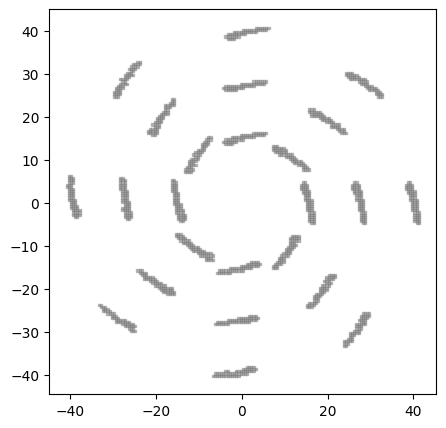

--------------------------------------------------
label: VentHole Chromosome_916: ['DonutShape_367', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


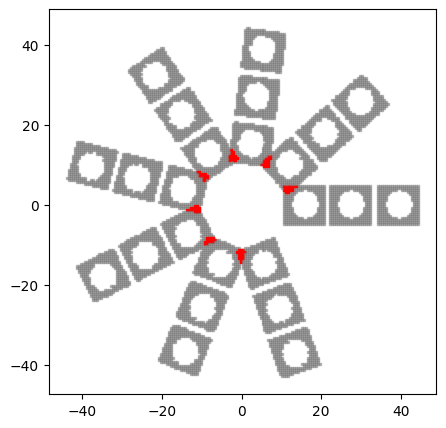

--------------------------------------------------
label: VentHole Chromosome_685: ['DoubleParabolicShape_685', 'CornerTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 2.79176786166162, phi: 0.4098912790616371, rot_count: 3.0, ]


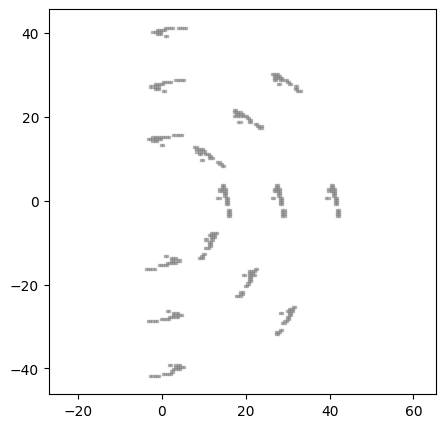

--------------------------------------------------
label: VentHole Chromosome_74: ['HoleShape_86', 'CornerTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 2.79176786166162, phi: 0.4098912790616371, rot_count: 3.0, ]


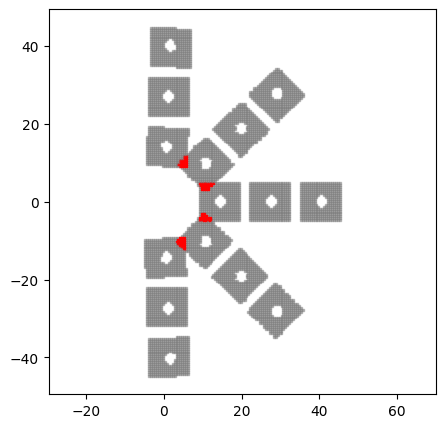

--------------------------------------------------
label: VentHole Chromosome_791: ['HoleShape_74', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


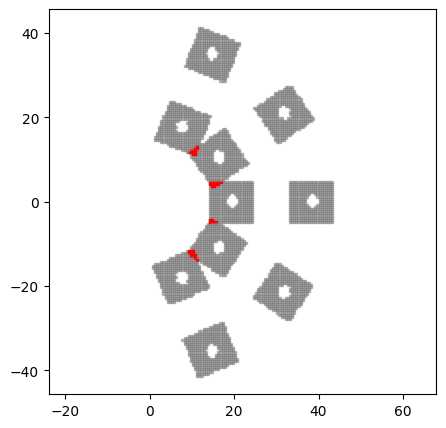

--------------------------------------------------
label: VentHole Chromosome_849: ['RayShape_791', 'CornerTransformation_791']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


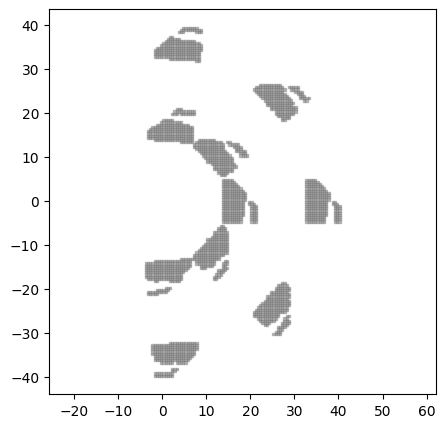

--------------------------------------------------
label: VentHole Chromosome_791: ['RayShape_849', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.089726461453527, dx: 7.500565927872639, phi: 0.7853981633974483, ]


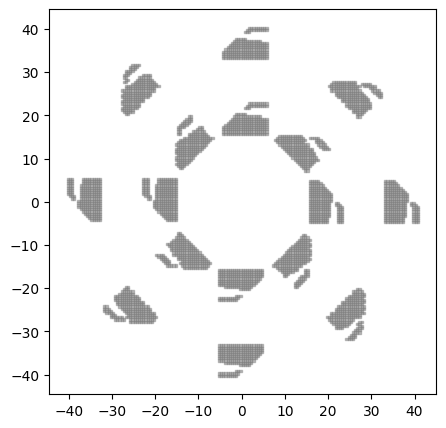

--------------------------------------------------
label: VentHole Chromosome_300: ['DonutShape_300', 'CircularStrictTransformation_916']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


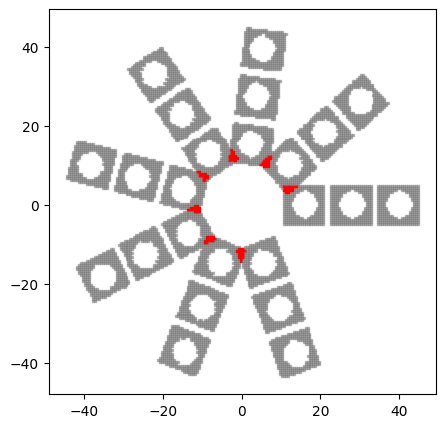

--------------------------------------------------
label: VentHole Chromosome_463: ['RayShape_258', 'CircularStrictTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


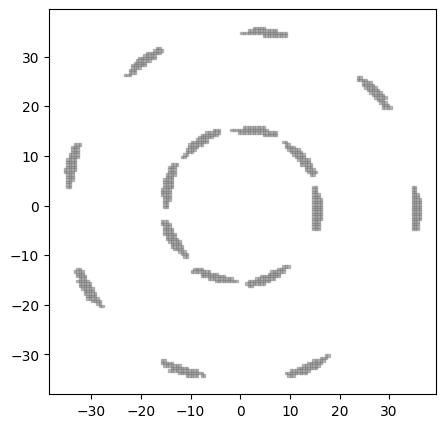

--------------------------------------------------
label: VentHole Chromosome_42: ['DoubleParabolicShape_42', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.863197303829144, upper_coefficient: 2.0833663276112597, lower_y-intercept: 2.825243246658168, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 1.4620855337477492, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


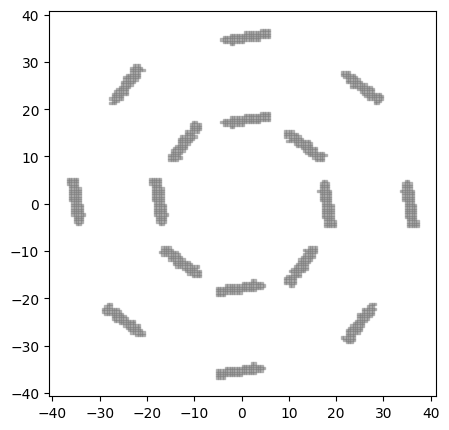

--------------------------------------------------
label: VentHole Chromosome_529: ['WingShape_614', 'CircularStrictTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


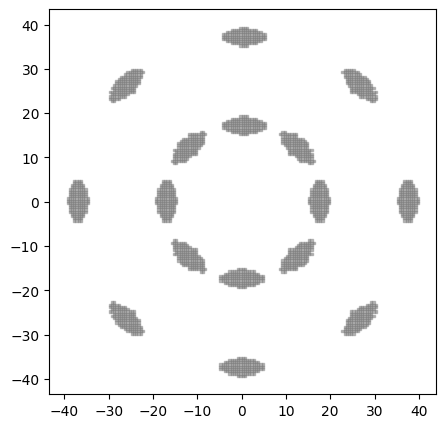

--------------------------------------------------
label: VentHole Chromosome_467: ['WingShape_529', 'GridStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


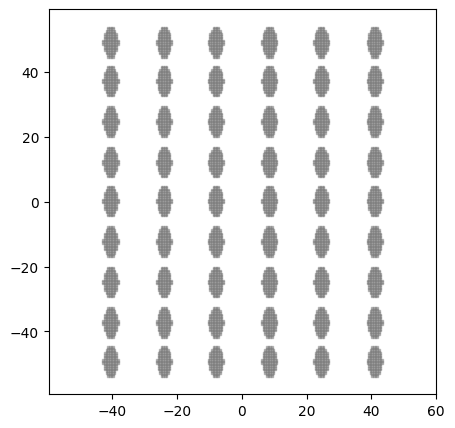

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_928', 'CircularStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


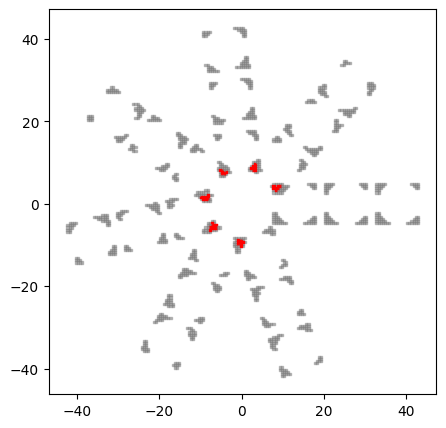

--------------------------------------------------
label: VentHole Chromosome_668: ['TrapezoidShape_659', 'CircularStrictTransformation_616']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


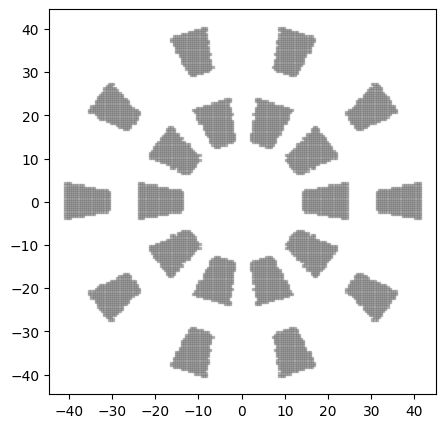

--------------------------------------------------
label: VentHole Chromosome_668: ['TrapezoidShape_668', 'CircularStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


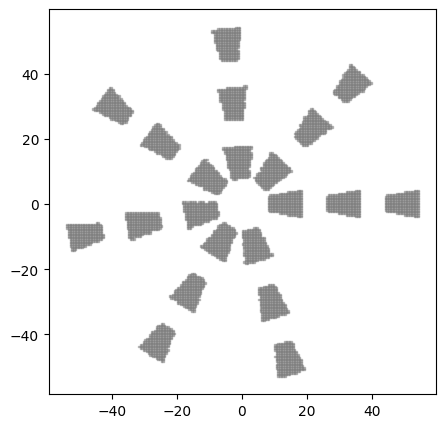

--------------------------------------------------
label: VentHole Chromosome_191: ['TrapezoidShape_298', 'CircularStrictTransformation_668']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


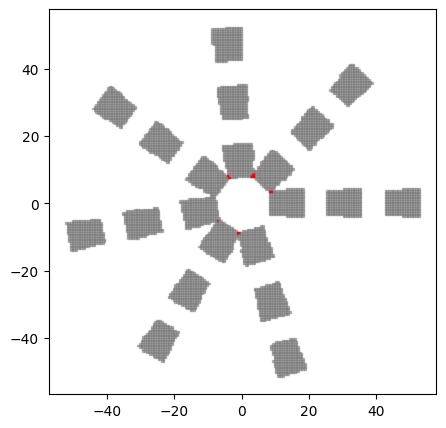

--------------------------------------------------
label: VentHole Chromosome_15: ['TrapezoidShape_365', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


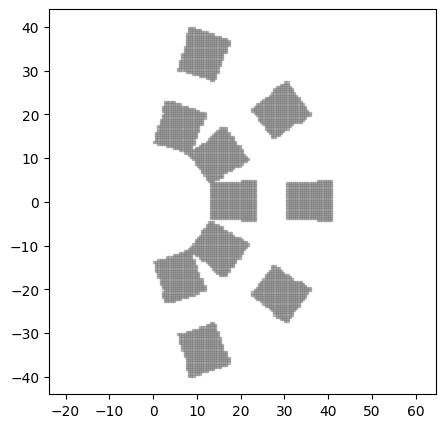

--------------------------------------------------
label: VentHole Chromosome_403: ['WingShape_685', 'CircularStrictTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 2.3176269767576296, phi: 0.41887902047863906, ]


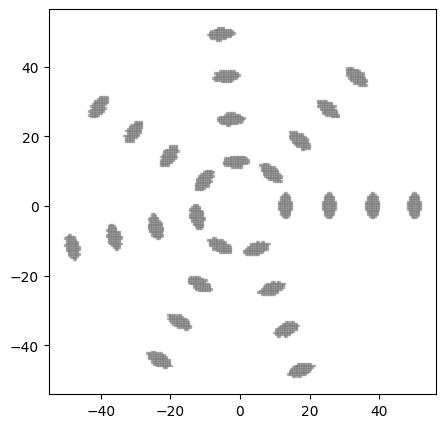

--------------------------------------------------
label: VentHole Chromosome_321: ['TriangleShape_736', 'CornerTransformation_321']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


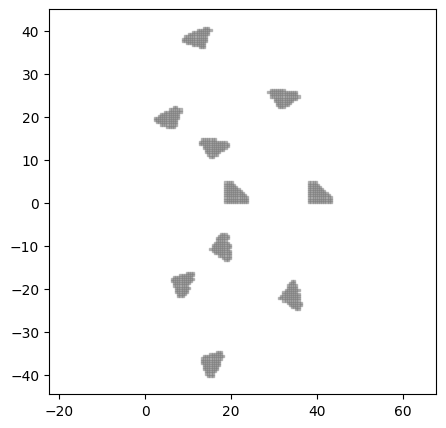

--------------------------------------------------
label: VentHole Chromosome_16: ['TriangleShape_321', 'GridStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


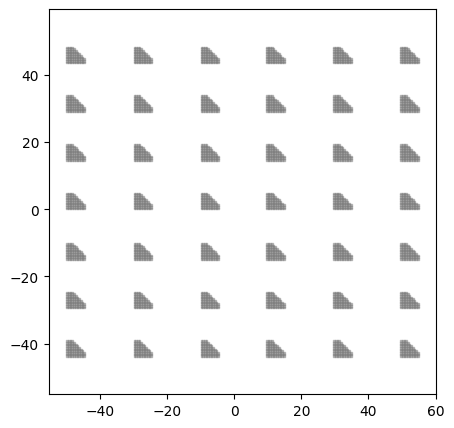

--------------------------------------------------
label: VentHole Chromosome_964: ['WingShape_964', 'CornerTransformation_576']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.617343889993474, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


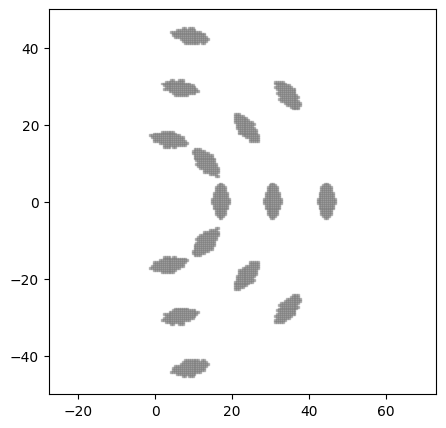

--------------------------------------------------
label: VentHole Chromosome_576: ['HoleShape_792', 'CornerTransformation_964']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


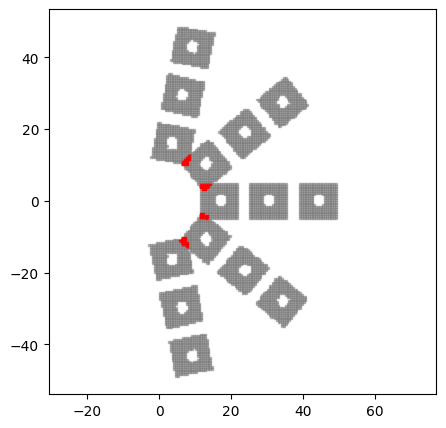

--------------------------------------------------
label: VentHole Chromosome_606: ['DonutShape_928', 'CircularStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


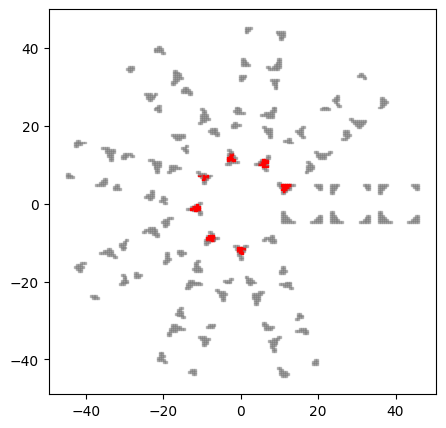

--------------------------------------------------
label: VentHole Chromosome_928: ['TriangleShape_886', 'CornerTransformation_321']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


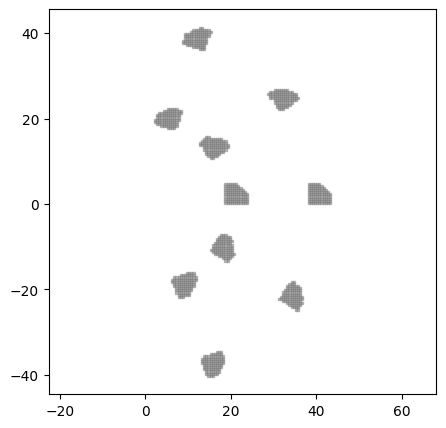

--------------------------------------------------
label: VentHole Chromosome_496: ['TriangleShape_928', 'GridStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.999594967018924, ]


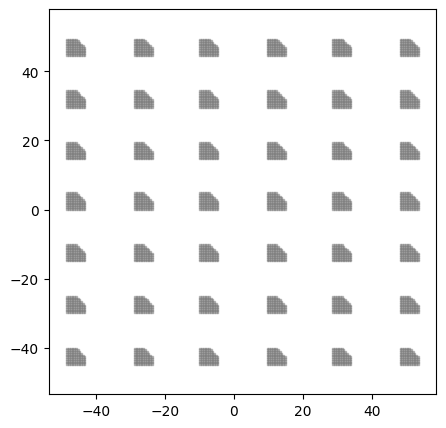

--------------------------------------------------
label: VentHole Chromosome_74: ['TrapezoidShape_829', 'GridStrictTransformation_496']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.930168809539807, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.999594967018924, ]


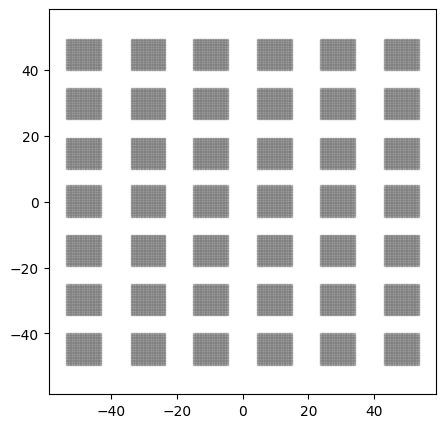

--------------------------------------------------
label: VentHole Chromosome_824: ['DonutShape_886', 'GridStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


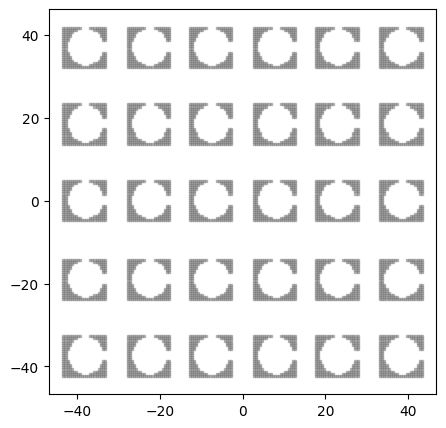

--------------------------------------------------
label: VentHole Chromosome_274: ['DonutShape_824', 'GridStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


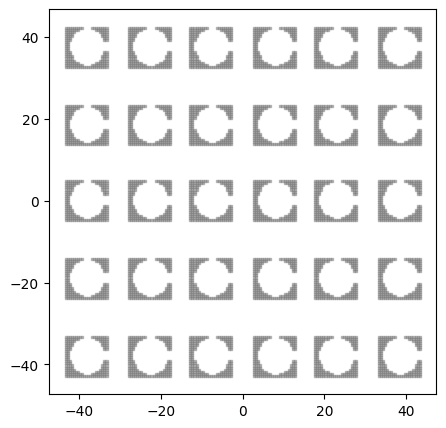

--------------------------------------------------
label: VentHole Chromosome_536: ['DoubleParabolicShape_529', 'GridStrictTransformation_274']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.3912597872446593, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


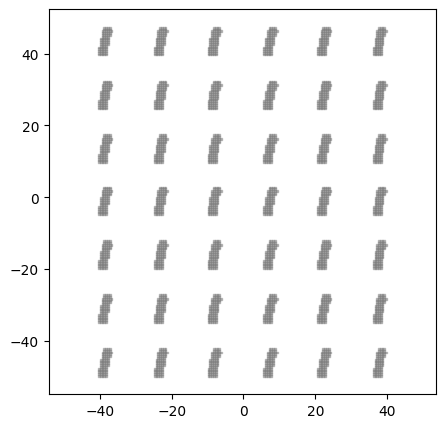

--------------------------------------------------
label: VentHole Chromosome_529: ['WingShape_382', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


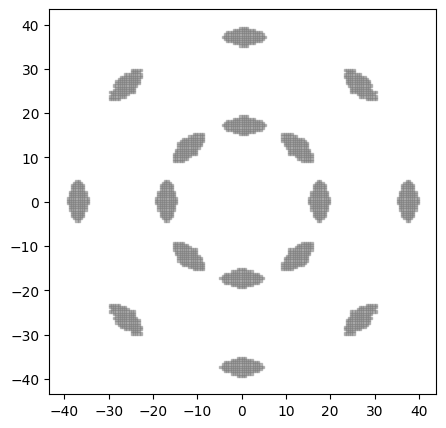

--------------------------------------------------
label: VentHole Chromosome_365: ['TrapezoidShape_15', 'CornerTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


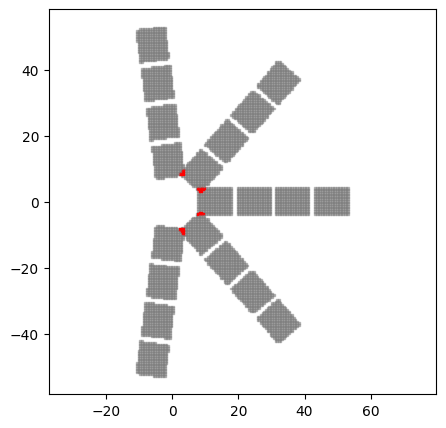

--------------------------------------------------
label: VentHole Chromosome_668: ['TrapezoidShape_365', 'CircularStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


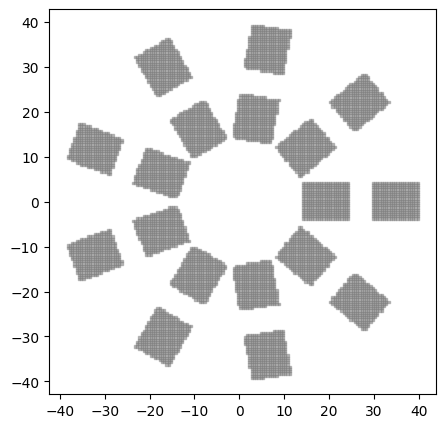

--------------------------------------------------
label: VentHole Chromosome_462: ['WingShape_529', 'CircularStrictTransformation_668']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


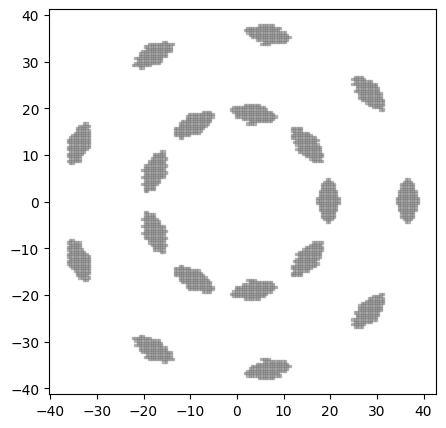

--------------------------------------------------
label: VentHole Chromosome_365: ['WingShape_462', 'CornerTransformation_33']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 9.99259790556069, dx: 1.854979472202907, phi: 0.5217966994807657, rot_count: 4.0, ]


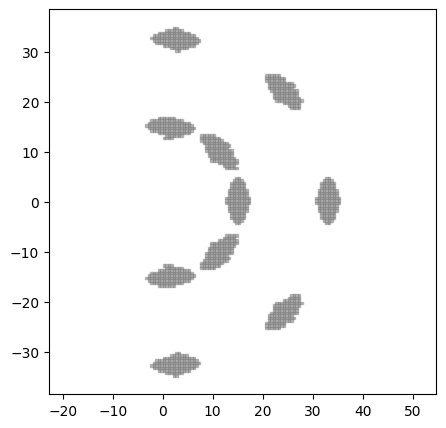

--------------------------------------------------
label: VentHole Chromosome_33: ['HoleShape_243', 'GridStrictTransformation_16']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.284594089657327, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


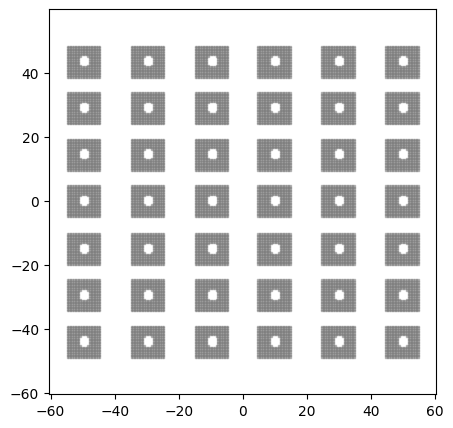

--------------------------------------------------
label: VentHole Chromosome_613: ['HoleShape_304', 'GridStrictTransformation_33']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


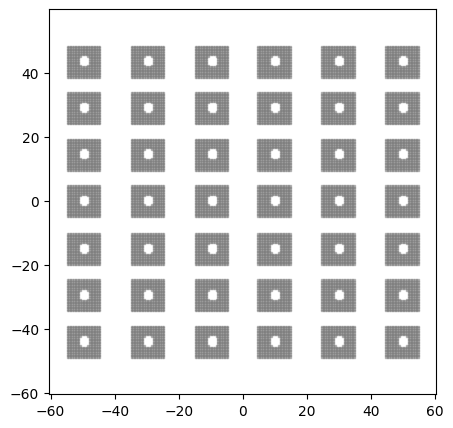

--------------------------------------------------
label: VentHole Chromosome_367: ['CircleShape_253', 'GridStrictTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.759517141611187, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


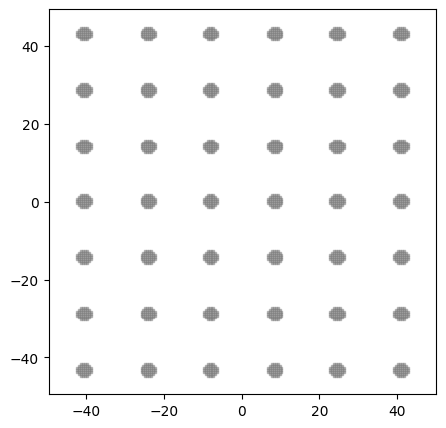

--------------------------------------------------
label: VentHole Chromosome_839: ['TriangleShape_67', 'CircularStrictTransformation_191']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


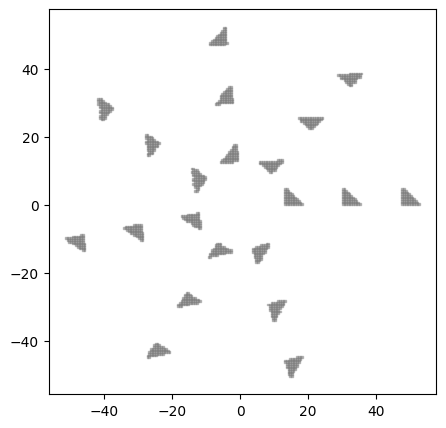

--------------------------------------------------
label: VentHole Chromosome_531: ['CircleShape_521', 'CircularStrictTransformation_668']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.2985740857085455, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


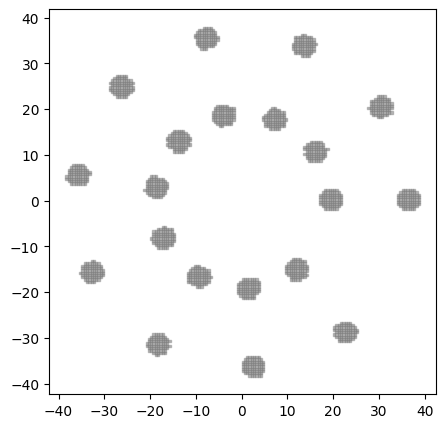

--------------------------------------------------
label: VentHole Chromosome_521: ['TriangleShape_496', 'CircularStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


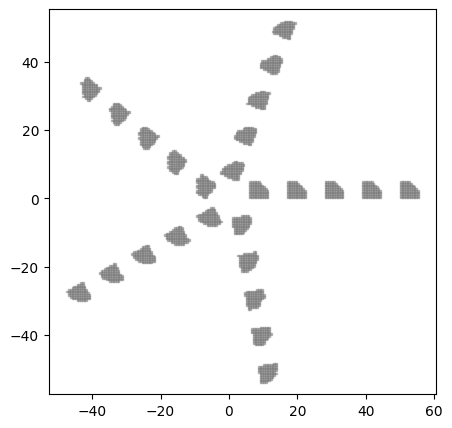

--------------------------------------------------
label: VentHole Chromosome_7: ['TriangleShape_366', 'GridStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 6.871929180248772, dy: 4.999594967018924, ]


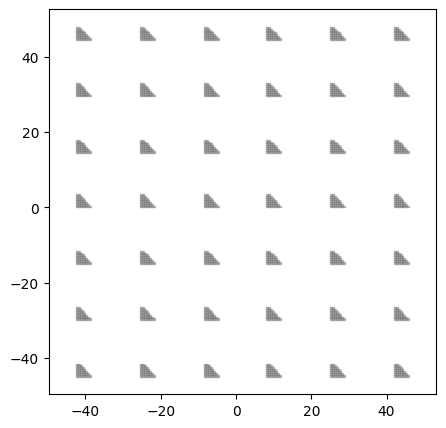

--------------------------------------------------
label: VentHole Chromosome_791: ['TriangleShape_7', 'CornerTransformation_142']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


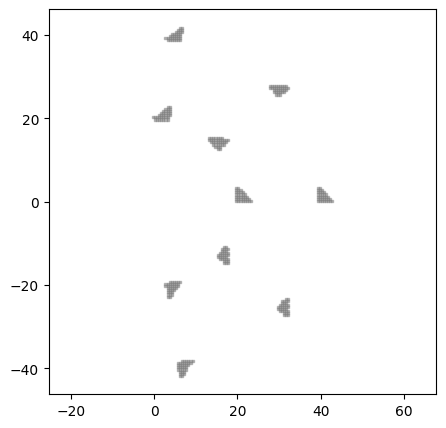

--------------------------------------------------
label: VentHole Chromosome_942: ['DonutShape_916', 'CornerTransformation_791']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


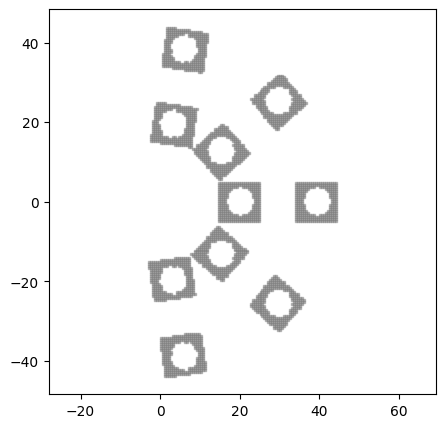

--------------------------------------------------
label: VentHole Chromosome_529: ['TriangleShape_333', 'CircularStrictTransformation_445']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.99947579870443, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 5.807728062127912, phi: 0.483321946706122, ]


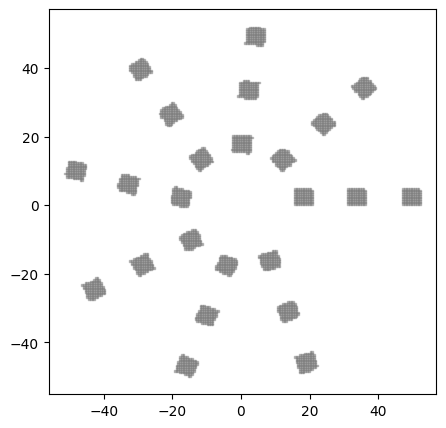

--------------------------------------------------
label: VentHole Chromosome_445: ['TriangleShape_791', 'CircularStrictTransformation_398']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


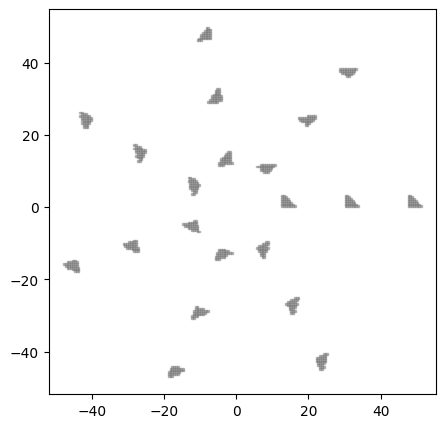

--------------------------------------------------
label: VentHole Chromosome_872: ['DoubleParabolicShape_765', 'CircularStrictTransformation_445']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


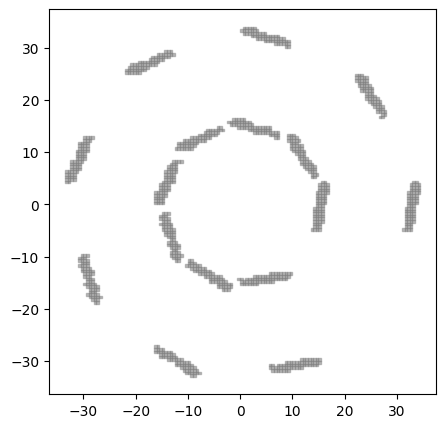

--------------------------------------------------
label: VentHole Chromosome_363: ['DoubleParabolicShape_872', 'CircularStrictTransformation_180']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 9.90251222160351, phi: 0.6283185307179586, ]


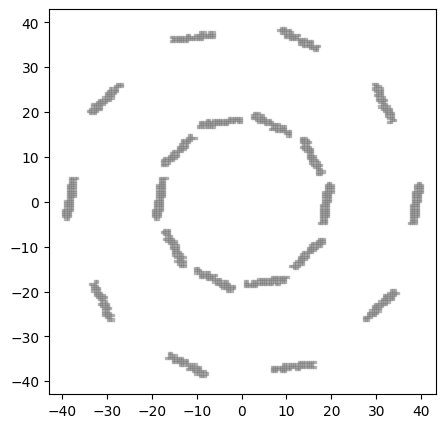

--------------------------------------------------
label: VentHole Chromosome_180: ['DonutShape_346', 'GridStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


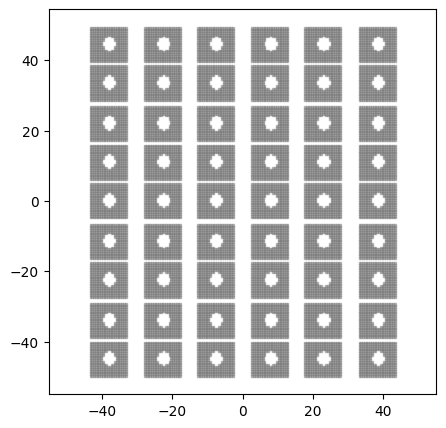

--------------------------------------------------
label: VentHole Chromosome_285: ['WingShape_388', 'CircularStrictTransformation_872']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


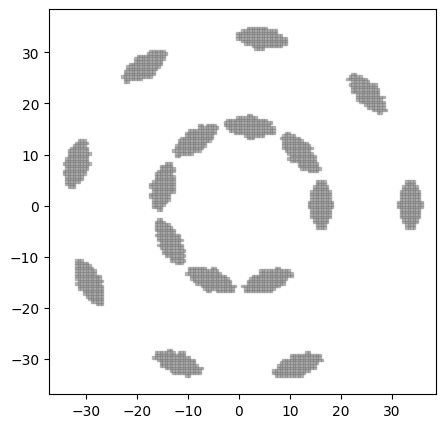

--------------------------------------------------
label: VentHole Chromosome_955: ['TrapezoidShape_668', 'CornerTransformation_243']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.5877628877894474, rot_count: 6.0, ]


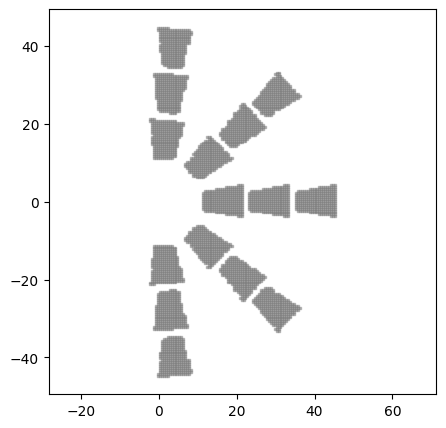

--------------------------------------------------
label: VentHole Chromosome_984: ['DonutShape_613', 'CornerTransformation_955']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.3135732127556907, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.5877628877894474, rot_count: 6.0, ]


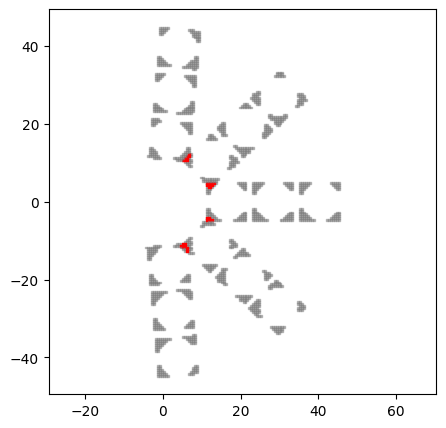

--------------------------------------------------
label: VentHole Chromosome_758: ['DonutShape_984', 'CircularStrictTransformation_964']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.3135732127556907, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


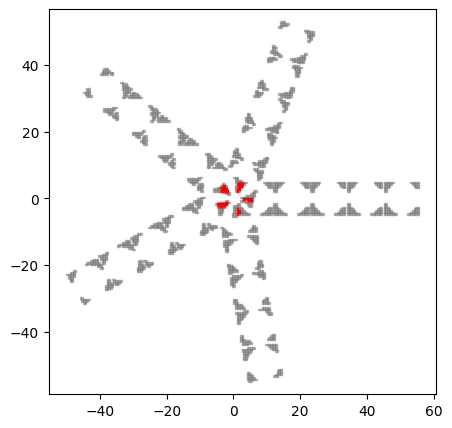

--------------------------------------------------
label: VentHole Chromosome_413: ['WingShape_403', 'CornerTransformation_964']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 11.540744726128407, dx: 9.88983082456521, phi: 0.7678887097189364, rot_count: 4.0, ]


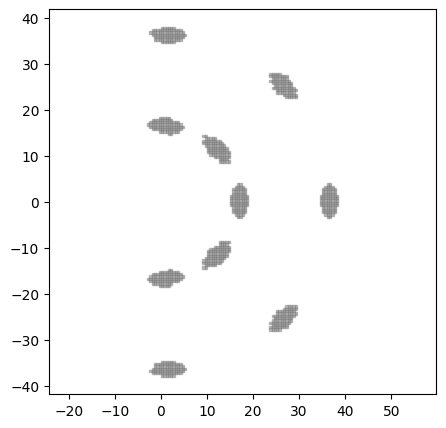

--------------------------------------------------
label: VentHole Chromosome_964: ['DonutShape_884', 'CornerTransformation_413']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.761051345084564, r_outer: 9.241956798635755, ]
pattern parameter:
parameter_list: [ di: 11.540744726128407, dx: 9.88983082456521, phi: 0.7678887097189364, rot_count: 4.0, ]


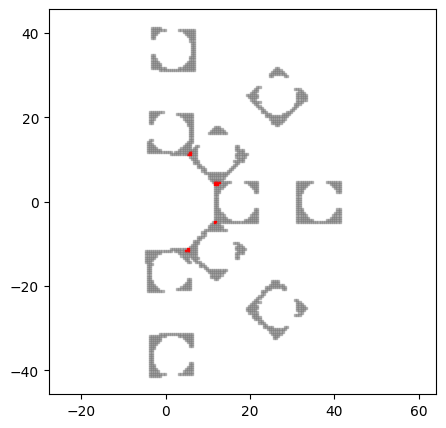

--------------------------------------------------
label: VentHole Chromosome_884: ['DonutShape_964', 'CircularStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.761051345084564, r_outer: 9.241956798635755, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


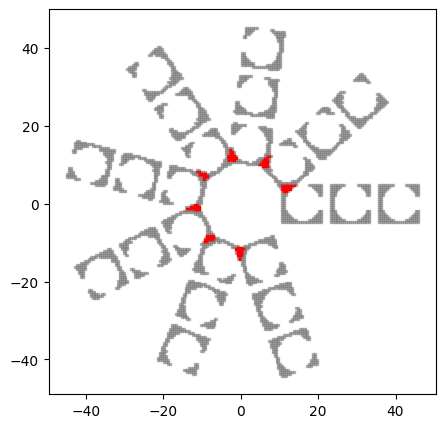

--------------------------------------------------
label: VentHole Chromosome_723: ['TriangleShape_16', 'CircularStrictTransformation_884']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


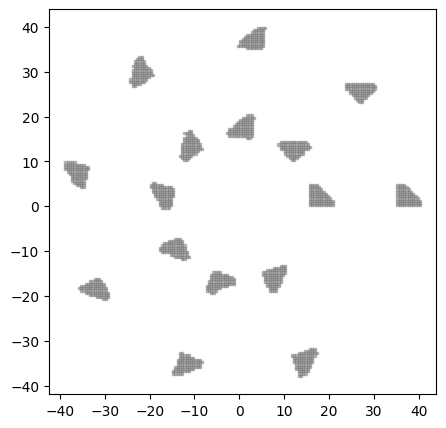

--------------------------------------------------
label: VentHole Chromosome_548: ['TriangleShape_723', 'GridStrictTransformation_122']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


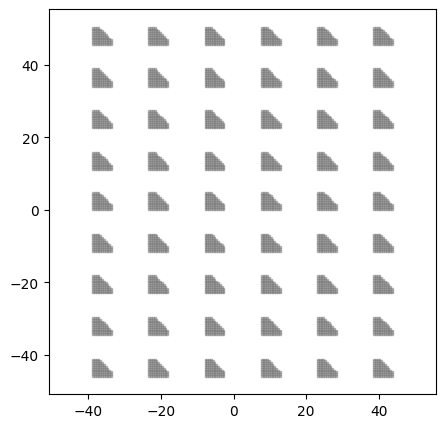

--------------------------------------------------
label: VentHole Chromosome_886: ['TriangleShape_445', 'GridStrictTransformation_824']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


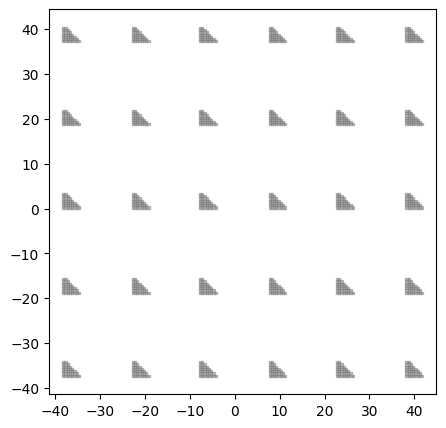

--------------------------------------------------
label: VentHole Chromosome_529: ['HoleShape_556', 'CircularStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.776942860477072, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


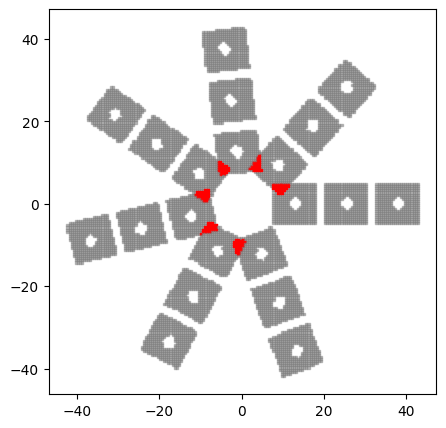

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_929', 'GridStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ dx: 6.871929180248772, dy: 4.999594967018924, ]


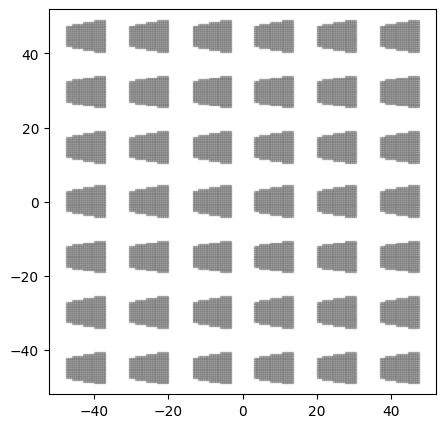

--------------------------------------------------
label: VentHole Chromosome_282: ['TriangleShape_388', 'CircularStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.685329774968638, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


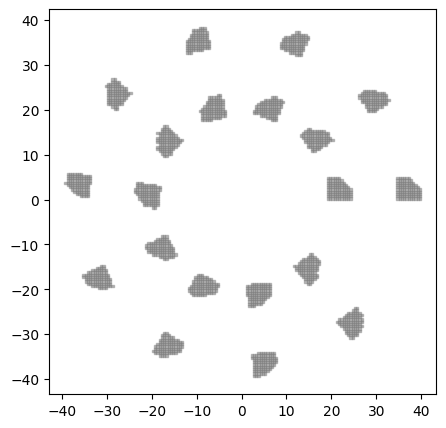

--------------------------------------------------
label: VentHole Chromosome_849: ['WingShape_467', 'CircularStrictTransformation_282']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


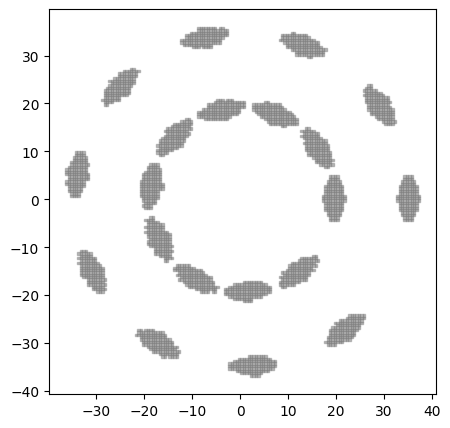

--------------------------------------------------
label: VentHole Chromosome_585: ['WingShape_849', 'CornerTransformation_334']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


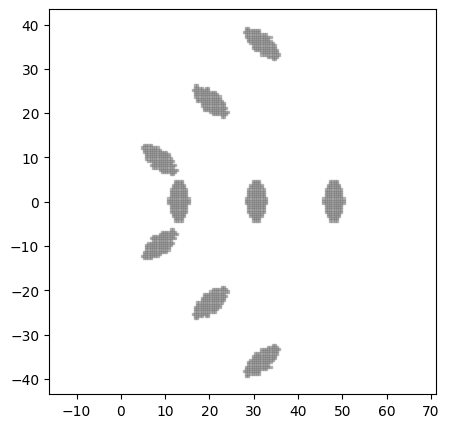

--------------------------------------------------
label: VentHole Chromosome_100: ['WingShape_74', 'GridStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


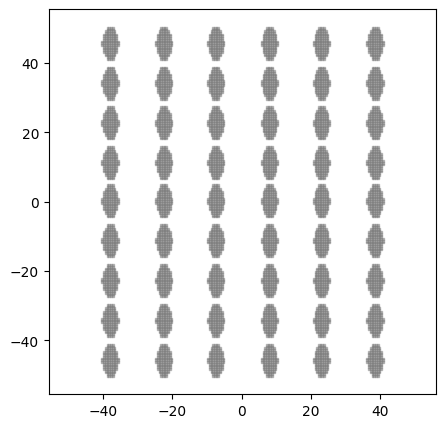

--------------------------------------------------
label: VentHole Chromosome_736: ['TrapezoidShape_467', 'GridStrictTransformation_100']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


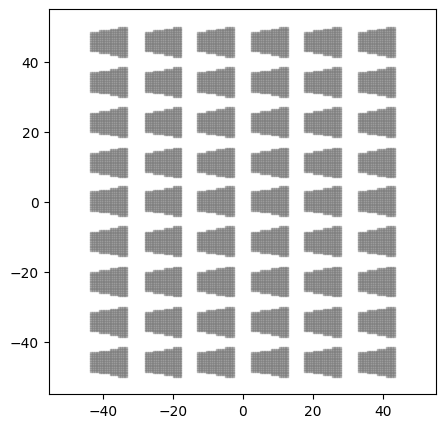

--------------------------------------------------
label: VentHole Chromosome_467: ['WingShape_585', 'CircularStrictTransformation_955']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


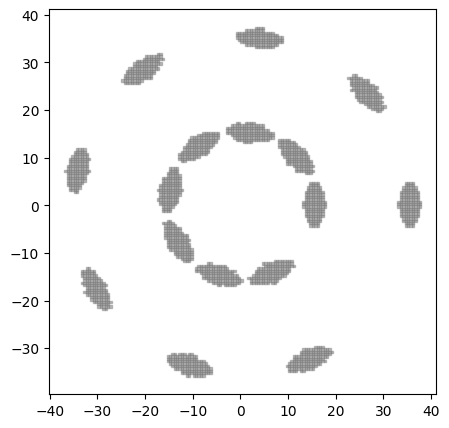

--------------------------------------------------
label: VentHole Chromosome_614: ['WingShape_467', 'CornerTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


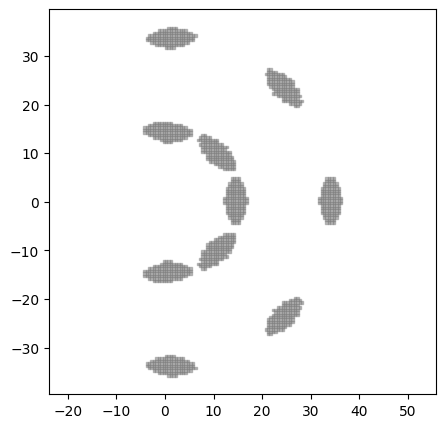

--------------------------------------------------
label: VentHole Chromosome_823: ['TriangleShape_191', 'CornerTransformation_614']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


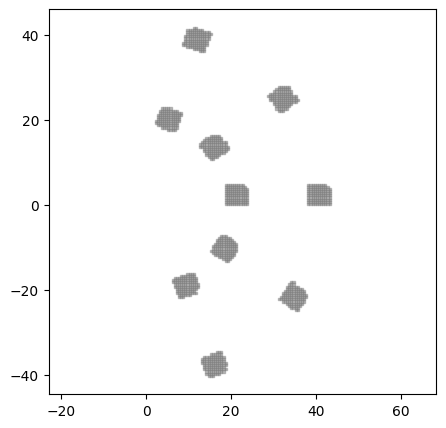

--------------------------------------------------
label: VentHole Chromosome_329: ['CircleShape_258', 'CornerTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.58398077439835, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


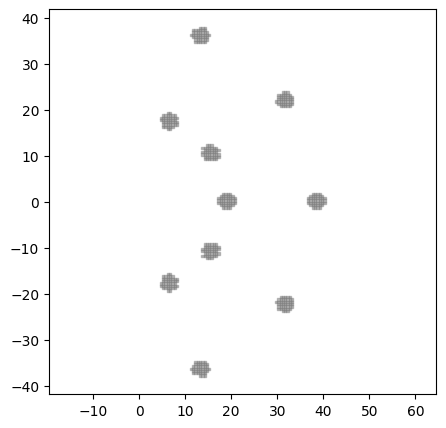

--------------------------------------------------
label: VentHole Chromosome_62: ['DoubleParabolicShape_42', 'GridStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.863197303829144, upper_coefficient: 2.0833663276112597, lower_y-intercept: 2.825243246658168, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 1.4620855337477492, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


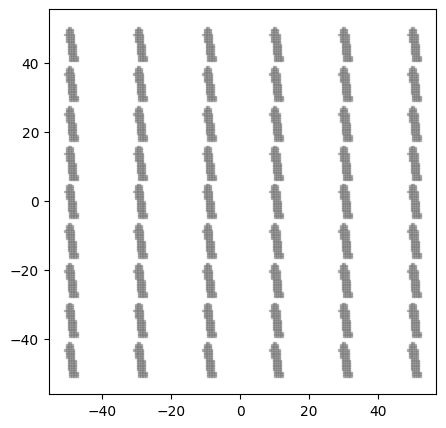

--------------------------------------------------
label: VentHole Chromosome_964: ['DoubleParabolicShape_62', 'CircularStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.863197303829144, upper_coefficient: 2.0833663276112597, lower_y-intercept: 2.825243246658168, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 1.4620855337477492, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


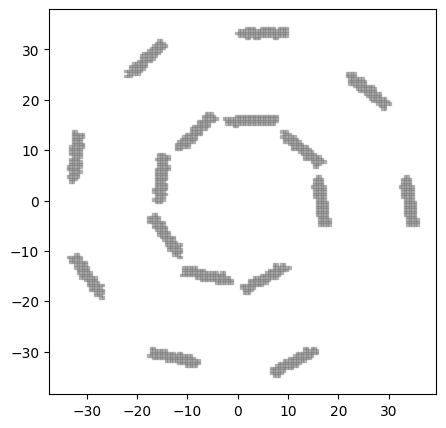

--------------------------------------------------
label: VentHole Chromosome_398: ['TriangleShape_488', 'CircularStrictTransformation_964']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


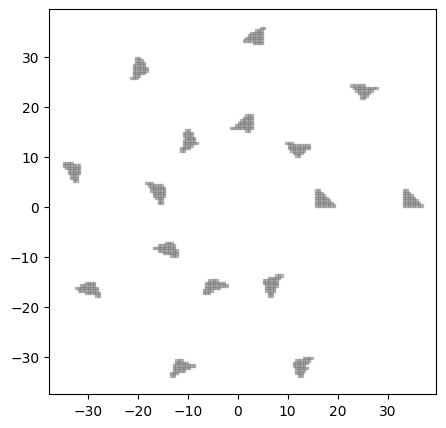

--------------------------------------------------
label: VentHole Chromosome_928: ['DoubleParabolicShape_783', 'CornerTransformation_15']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


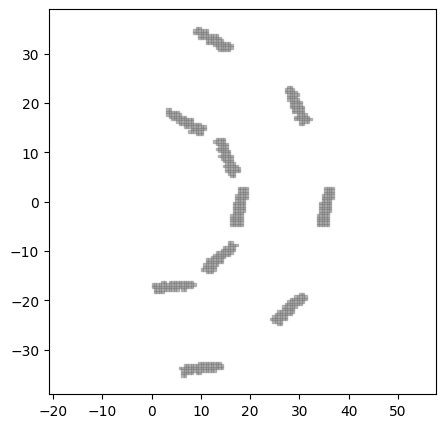

--------------------------------------------------
label: VentHole Chromosome_783: ['DoubleParabolicShape_928', 'GridStrictTransformation_352']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


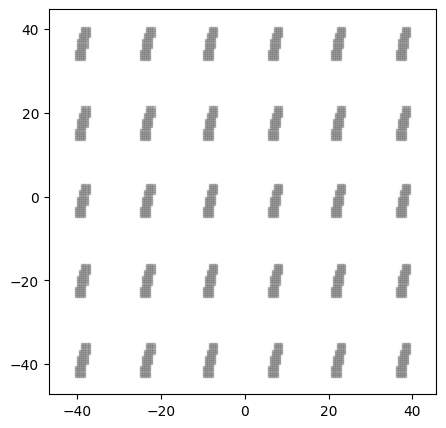

--------------------------------------------------
label: VentHole Chromosome_258: ['TriangleShape_529', 'GridStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.99947579870443, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


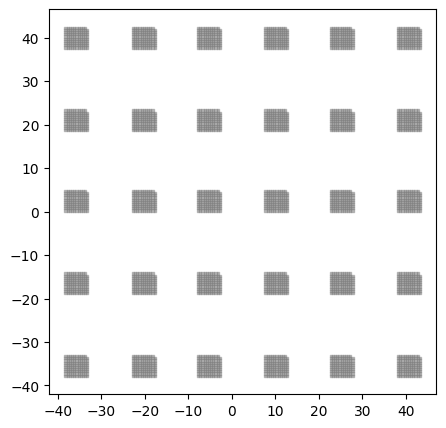

--------------------------------------------------
label: VentHole Chromosome_333: ['TriangleShape_258', 'CornerTransformation_365']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.99947579870443, ]
pattern parameter:
parameter_list: [ di: 9.99259790556069, dx: 1.854979472202907, phi: 0.5217966994807657, rot_count: 4.0, ]


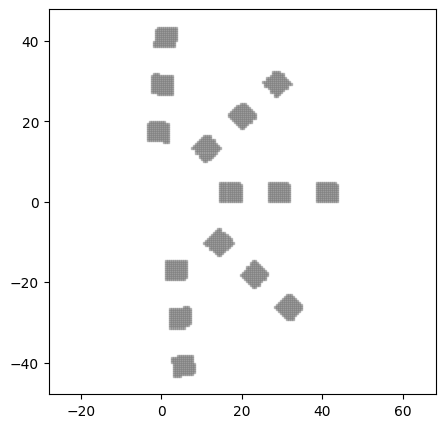

--------------------------------------------------
label: VentHole Chromosome_783: ['DoubleParabolicShape_783', 'CircularStrictTransformation_758']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.4175014634953778, upper_coefficient: 1.5834992903871752, lower_y-intercept: 1.6554269175941352, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 1.3339051227738343, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


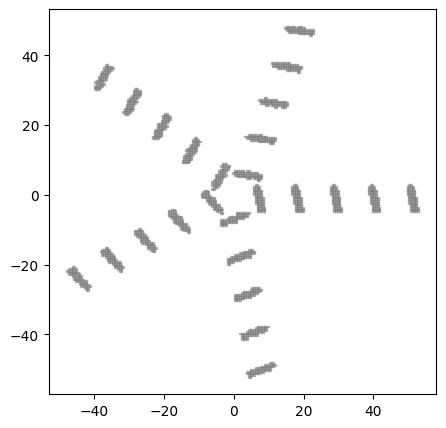

--------------------------------------------------
label: VentHole Chromosome_438: ['WingShape_413', 'GridStrictTransformation_736']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


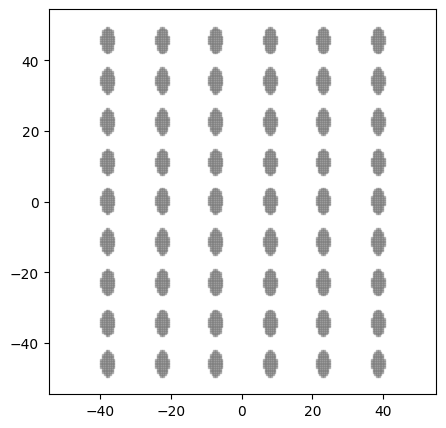

--------------------------------------------------
label: VentHole Chromosome_285: ['HoleShape_871', 'CornerTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


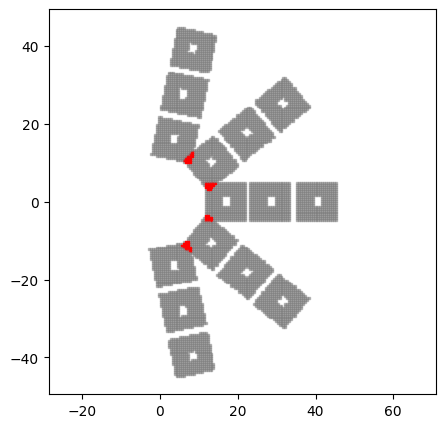

--------------------------------------------------
label: VentHole Chromosome_205: ['HoleShape_93', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.7190393992841844, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


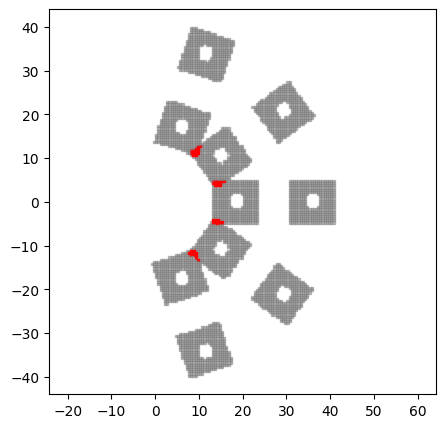

--------------------------------------------------
label: VentHole Chromosome_928: ['WingShape_100', 'CornerTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


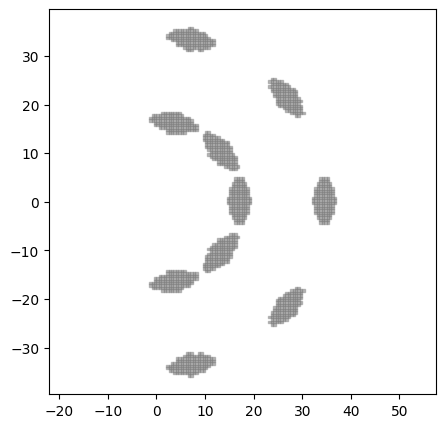

--------------------------------------------------
label: VentHole Chromosome_100: ['WingShape_928', 'CornerTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


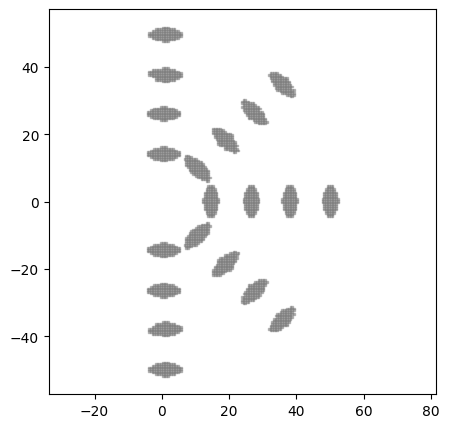

--------------------------------------------------
label: VentHole Chromosome_57: ['HoleShape_613', 'GridStrictTransformation_74']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.999594967018924, ]


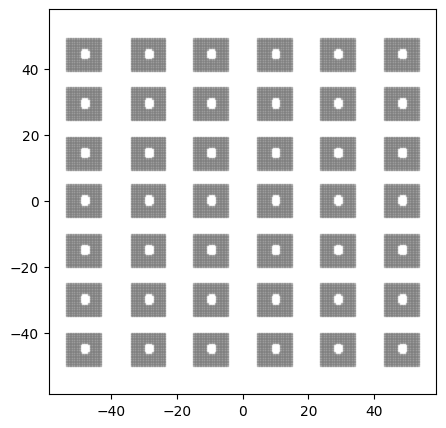

--------------------------------------------------
label: VentHole Chromosome_415: ['TrapezoidShape_808', 'CircularStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.9903946904461765, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


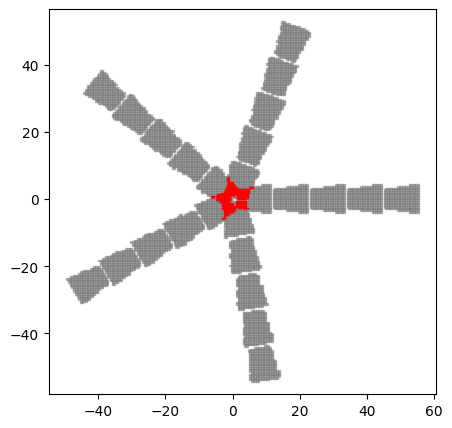

--------------------------------------------------
label: VentHole Chromosome_574: ['RayShape_332', 'CornerTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


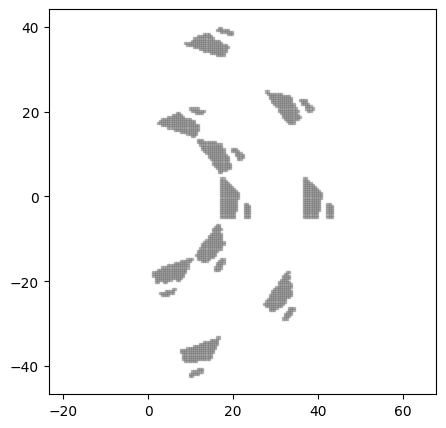

--------------------------------------------------
label: VentHole Chromosome_304: ['DoubleParabolicShape_685', 'GridStrictTransformation_44']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


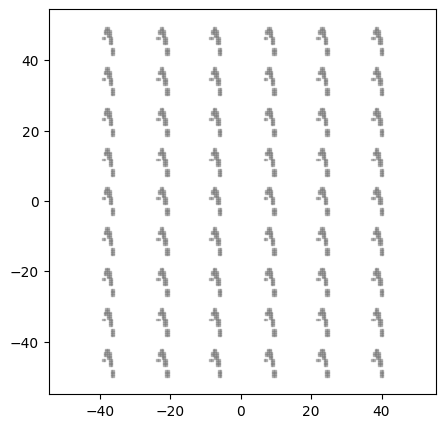

--------------------------------------------------
label: VentHole Chromosome_904: ['WingShape_984', 'GridStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


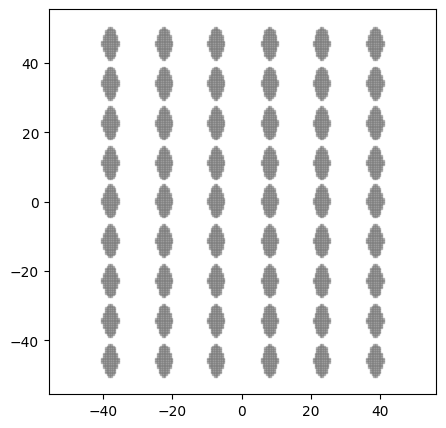

--------------------------------------------------
label: VentHole Chromosome_984: ['DoubleParabolicShape_692', 'CornerTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 9.28197864314253, dx: 1.859799167794286, phi: 0.7422463986582669, rot_count: 4.0, ]


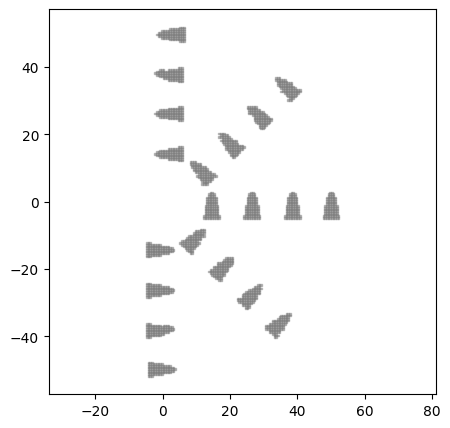

--------------------------------------------------
label: VentHole Chromosome_692: ['WingShape_365', 'CircularStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


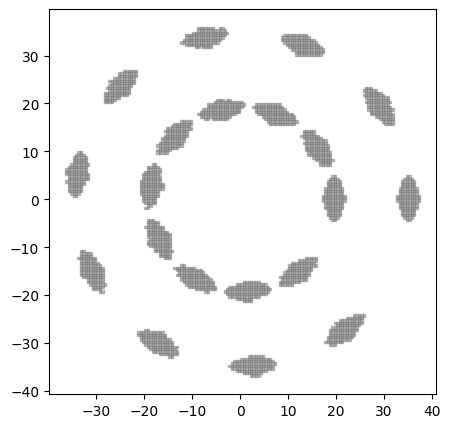

--------------------------------------------------
label: VentHole Chromosome_382: ['TriangleShape_476', 'CornerTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


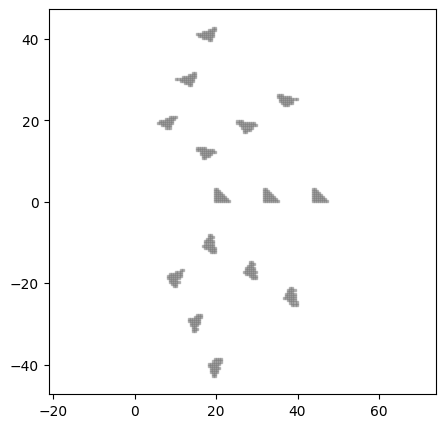

--------------------------------------------------
label: VentHole Chromosome_556: ['TriangleShape_382', 'CircularStrictTransformation_521']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


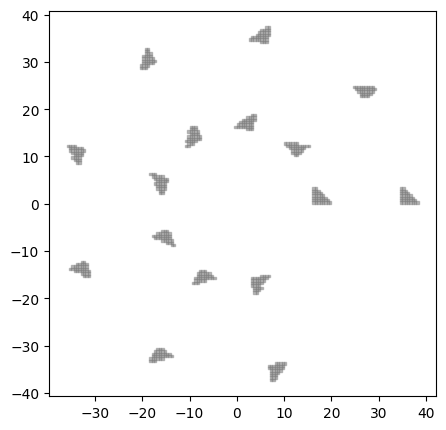

--------------------------------------------------
label: VentHole Chromosome_948: ['DonutShape_300', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


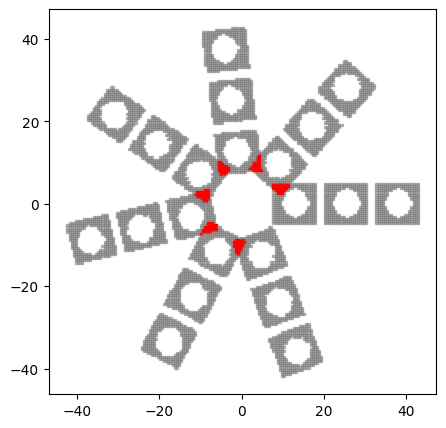

--------------------------------------------------
label: VentHole Chromosome_574: ['DoubleParabolicShape_304', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


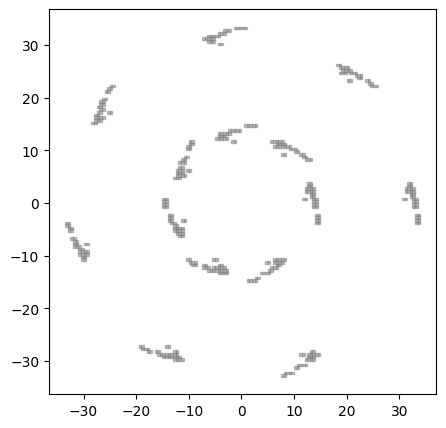

--------------------------------------------------
label: VentHole Chromosome_304: ['DoubleParabolicShape_958', 'CornerTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.5556779074696199, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


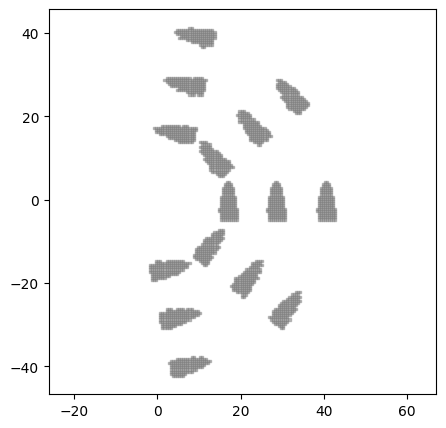

--------------------------------------------------
label: VentHole Chromosome_34: ['DoubleParabolicShape_304', 'GridStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.5556779074696199, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


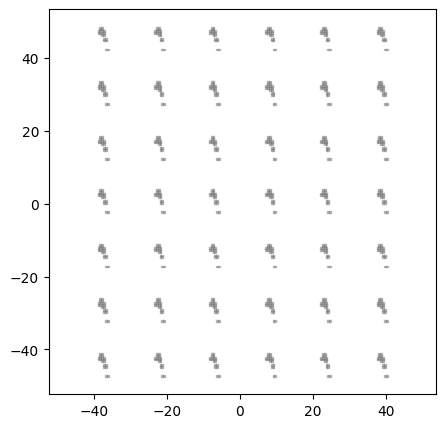

--------------------------------------------------
label: VentHole Chromosome_948: ['CircleShape_509', 'CircularStrictTransformation_67']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


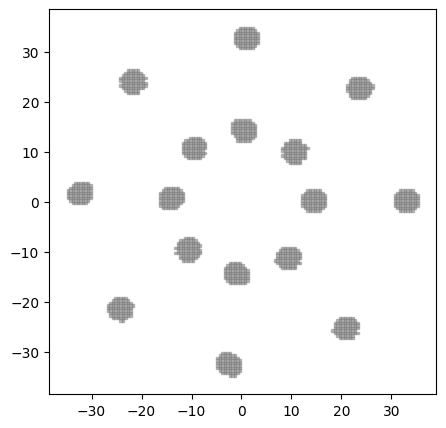

--------------------------------------------------
label: VentHole Chromosome_67: ['TriangleShape_839', 'CircularStrictTransformation_574']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


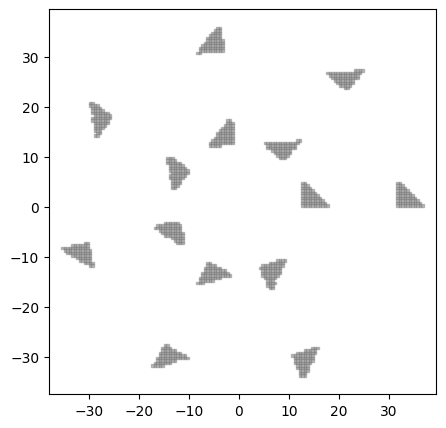

--------------------------------------------------
label: VentHole Chromosome_540: ['TrapezoidShape_660', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.930168809539807, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


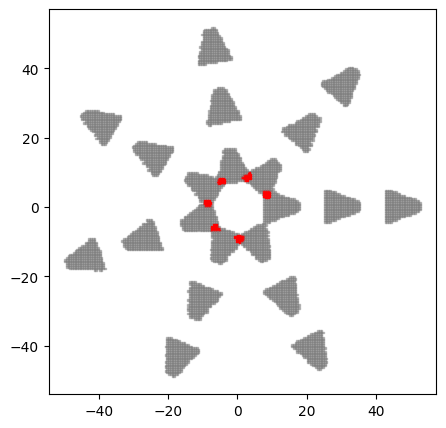

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_942', 'CircularStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


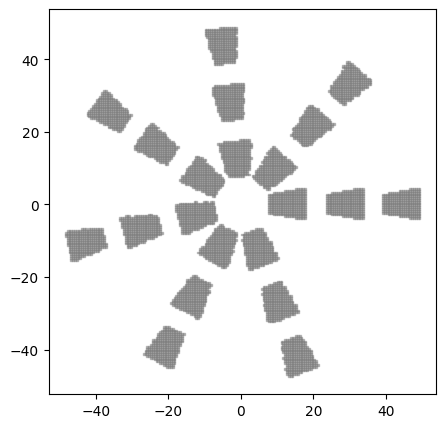

--------------------------------------------------
label: VentHole Chromosome_886: ['TrapezoidShape_668', 'GridStrictTransformation_904']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


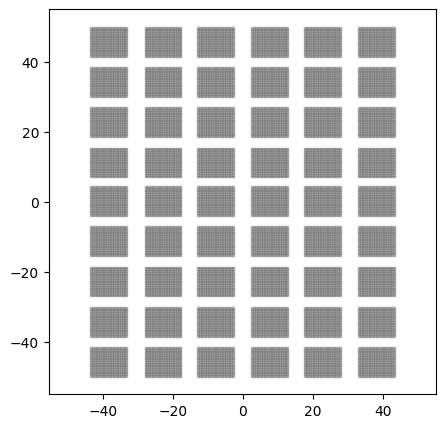

--------------------------------------------------
label: VentHole Chromosome_690: ['WingShape_690', 'CircularStrictTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.3442848867734063, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


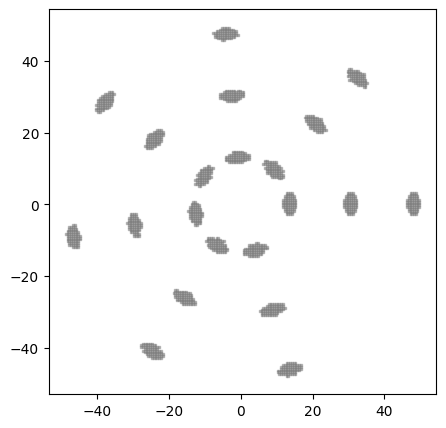

--------------------------------------------------
label: VentHole Chromosome_919: ['TriangleShape_556', 'CircularStrictTransformation_690']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


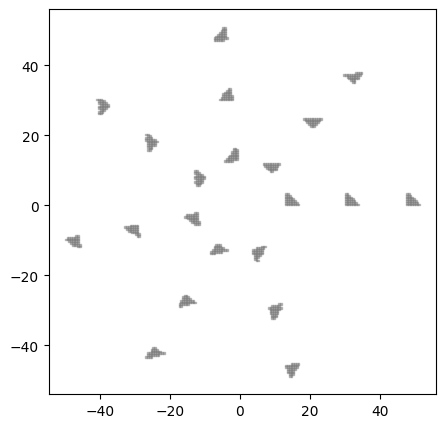

--------------------------------------------------
label: VentHole Chromosome_24: ['CircleShape_367', 'CircularStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.759517141611187, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.807728062127912, phi: 0.5235987755982988, ]


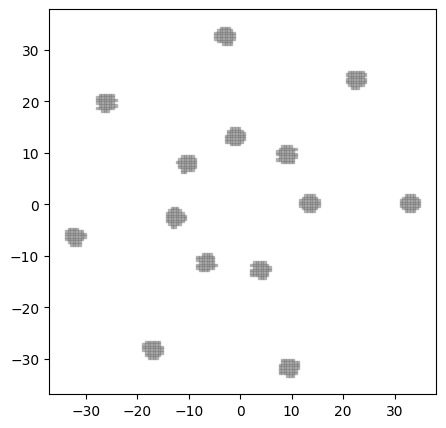

--------------------------------------------------
label: VentHole Chromosome_839: ['CircleShape_24', 'CircularStrictTransformation_712']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.759517141611187, ]
pattern parameter:
parameter_list: [ di: 14.356906849561378, dx: 9.832462236362868, phi: 0.6981317007977318, ]


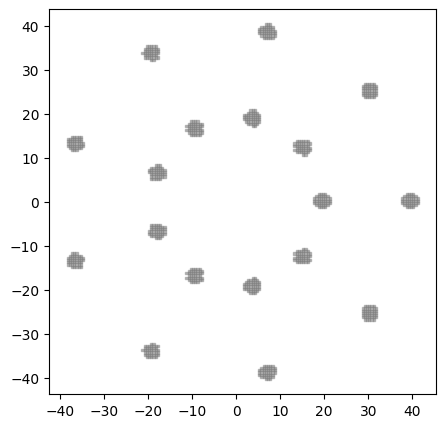

--------------------------------------------------
label: VentHole Chromosome_258: ['WingShape_904', 'CircularStrictTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 14.356906849561378, dx: 9.832462236362868, phi: 0.6981317007977318, ]


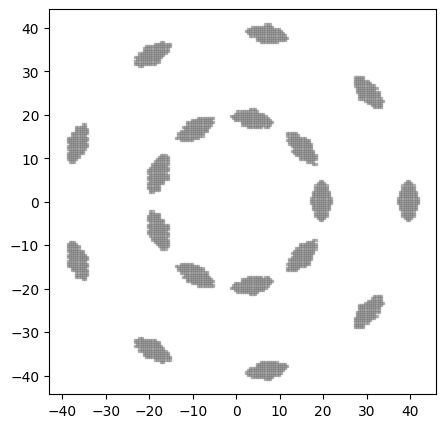

--------------------------------------------------
label: VentHole Chromosome_961: ['TrapezoidShape_191', 'GridStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


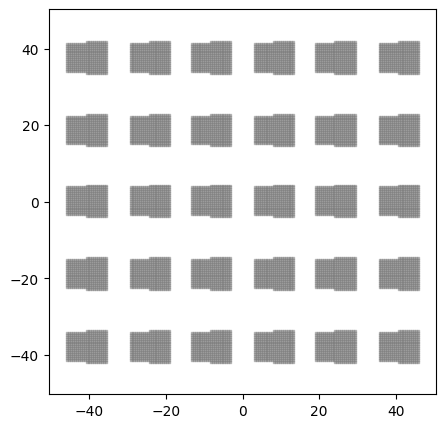

--------------------------------------------------
label: VentHole Chromosome_871: ['TrapezoidShape_961', 'CornerTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 4.0, ]


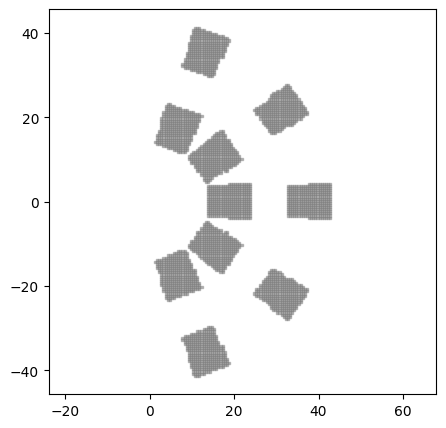

--------------------------------------------------
label: VentHole Chromosome_127: ['DoubleParabolicShape_574', 'CornerTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 4.0, ]


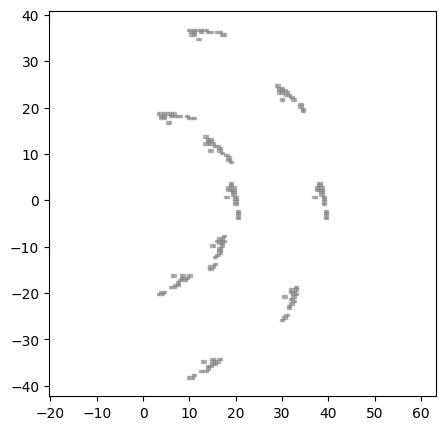

--------------------------------------------------
label: VentHole Chromosome_647: ['DoubleParabolicShape_127', 'CircularStrictTransformation_975']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


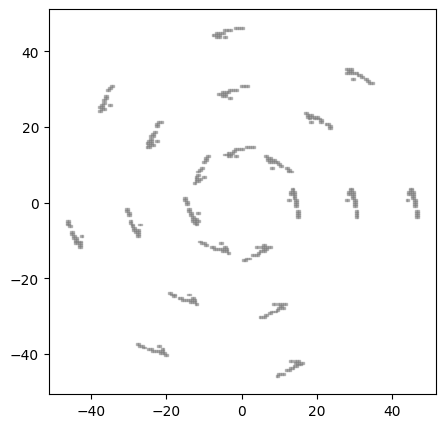

--------------------------------------------------
label: VentHole Chromosome_304: ['TrapezoidShape_958', 'CornerTransformation_574']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


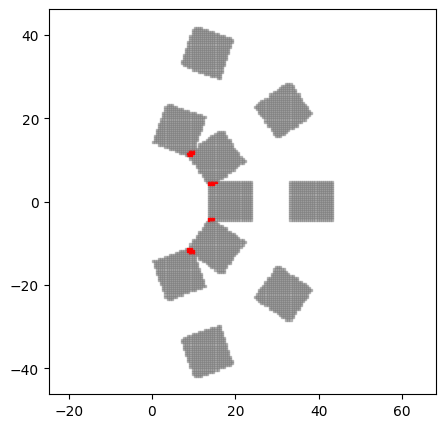

--------------------------------------------------
label: VentHole Chromosome_34: ['TrapezoidShape_545', 'CircularStrictTransformation_521']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


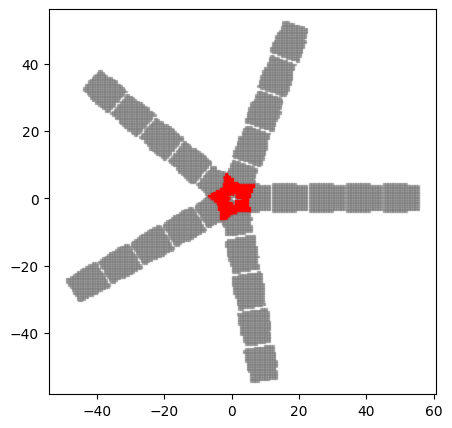

--------------------------------------------------
label: VentHole Chromosome_991: ['TrapezoidShape_34', 'CircularStrictTransformation_463']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


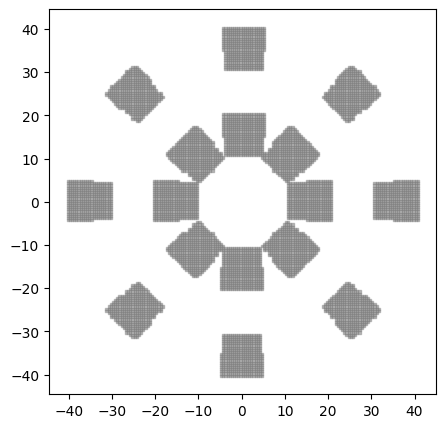

--------------------------------------------------
label: VentHole Chromosome_488: ['DoubleParabolicShape_300', 'CircularStrictTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 0.7943149583733558, phi: 0.7853981633974483, ]


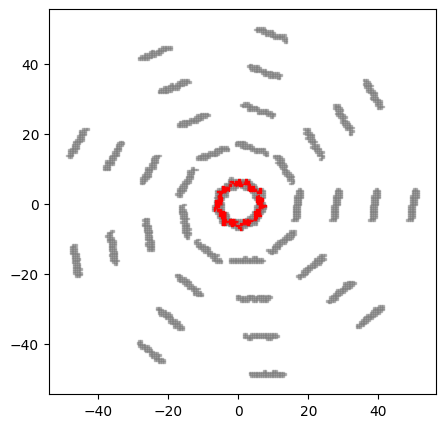

--------------------------------------------------
label: VentHole Chromosome_488: ['TriangleShape_398', 'CircularStrictTransformation_531']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


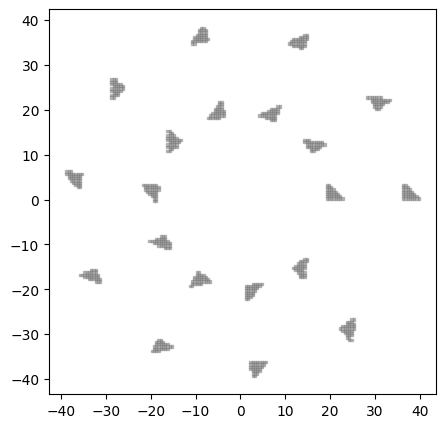

--------------------------------------------------
label: VentHole Chromosome_659: ['DoubleParabolicShape_772', 'CircularStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.3379712024976496, upper_coefficient: 2.8402130431173567, lower_y-intercept: 2.5200883221574966, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


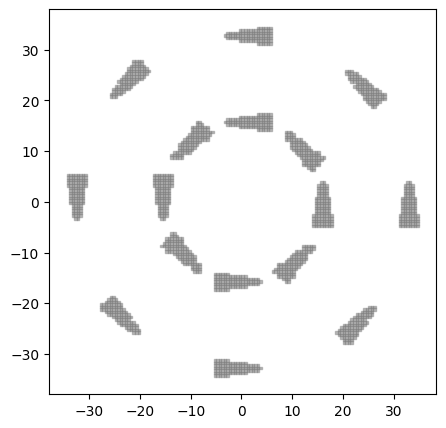

--------------------------------------------------
label: VentHole Chromosome_772: ['WingShape_7', 'GridStrictTransformation_355']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


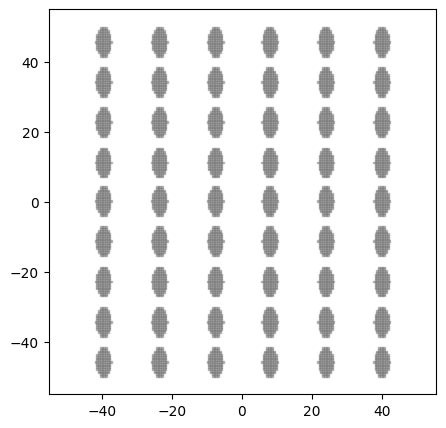

--------------------------------------------------
label: VentHole Chromosome_366: ['DonutShape_606', 'CornerTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


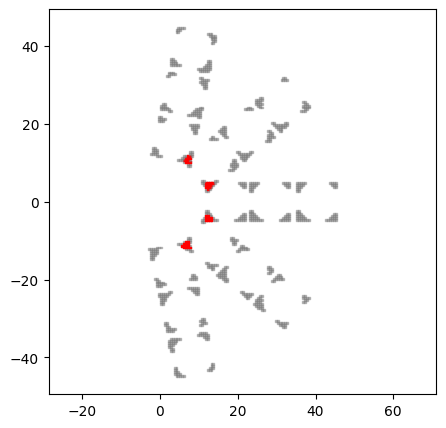

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_366', 'GridStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


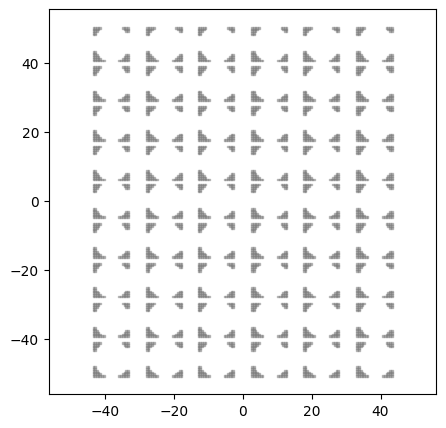

--------------------------------------------------
label: VentHole Chromosome_44: ['DoubleParabolicShape_44', 'CircularStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 3.572072892139567, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 0.7943149583733558, phi: 0.483321946706122, ]


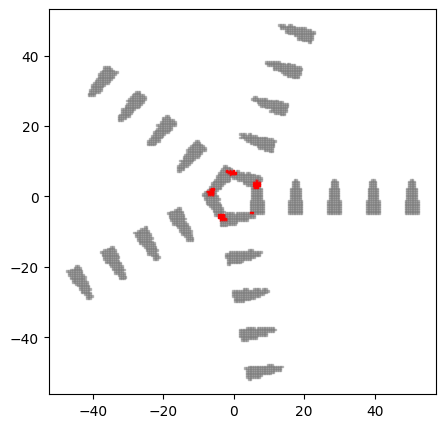

--------------------------------------------------
label: VentHole Chromosome_899: ['DoubleParabolicShape_647', 'CircularStrictTransformation_44']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 0.7943149583733558, phi: 0.483321946706122, ]


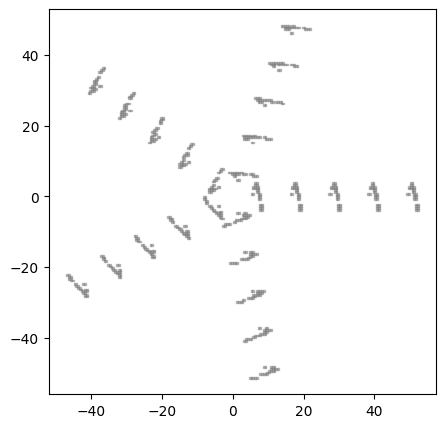

--------------------------------------------------
label: VentHole Chromosome_304: ['DonutShape_948', 'CornerTransformation_729']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.4664540289461003, phi: 0.5587425220674574, rot_count: 4.0, ]


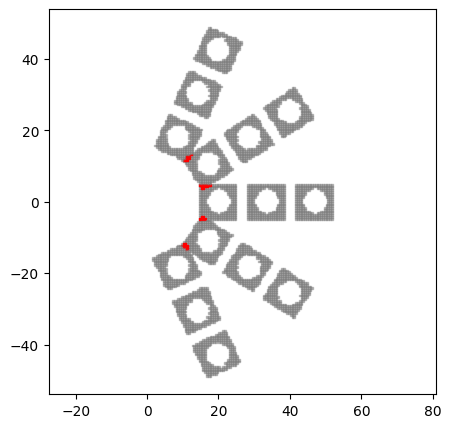

--------------------------------------------------
label: VentHole Chromosome_886: ['WingShape_772', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


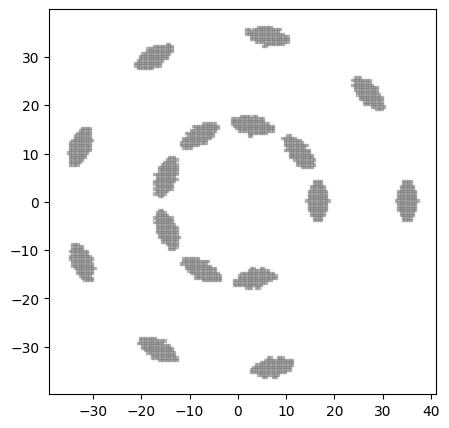

--------------------------------------------------
label: VentHole Chromosome_108: ['TrapezoidShape_919', 'CornerTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


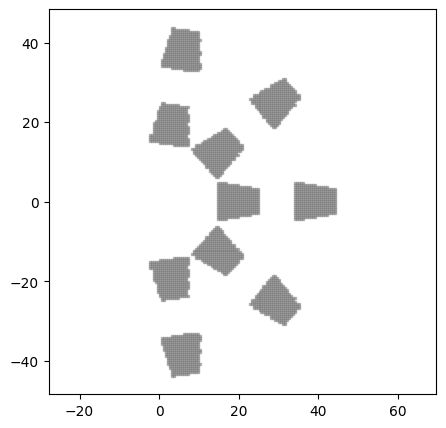

--------------------------------------------------
label: VentHole Chromosome_7: ['TriangleShape_551', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.7853981633974483, ]


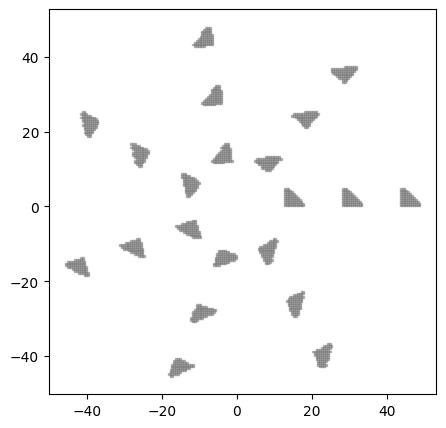

--------------------------------------------------
label: VentHole Chromosome_251: ['TriangleShape_7', 'CircularStrictTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


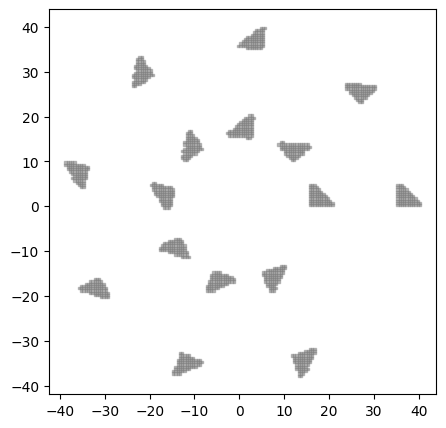

--------------------------------------------------
label: VentHole Chromosome_189: ['DoubleParabolicShape_862', 'CircularStrictTransformation_251']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


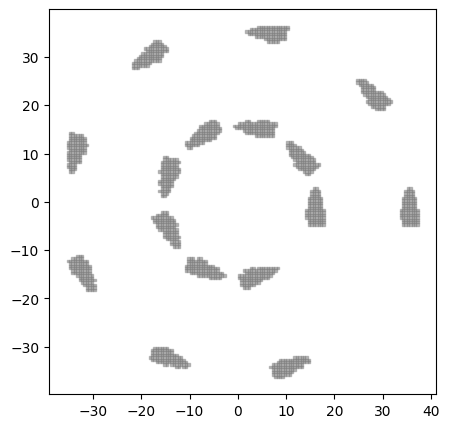

--------------------------------------------------
label: VentHole Chromosome_808: ['RayShape_839', 'GridStrictTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 2.4071513191656018, dy: 6.930864596693787, ]


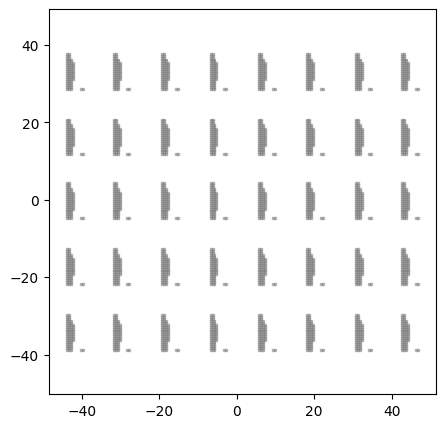

--------------------------------------------------
label: VentHole Chromosome_181: ['RayShape_808', 'CornerTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 5.0, ]


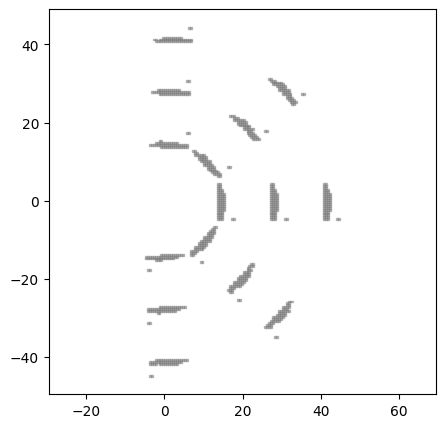

--------------------------------------------------
label: VentHole Chromosome_101: ['DonutShape_274', 'CircularStrictTransformation_660']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


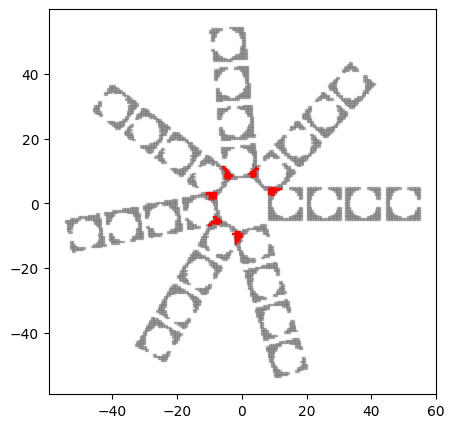

--------------------------------------------------
label: VentHole Chromosome_984: ['TrapezoidShape_352', 'CircularStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.3131251481041093, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


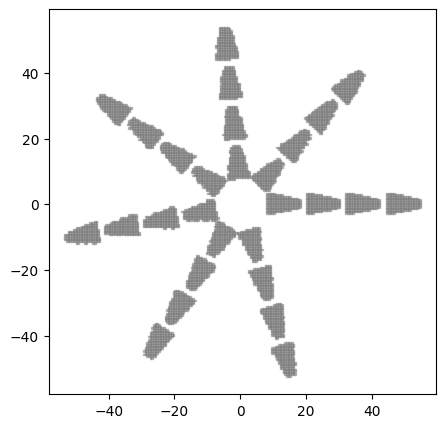

--------------------------------------------------
label: VentHole Chromosome_352: ['TrapezoidShape_984', 'CircularStrictTransformation_975']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.3131251481041093, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


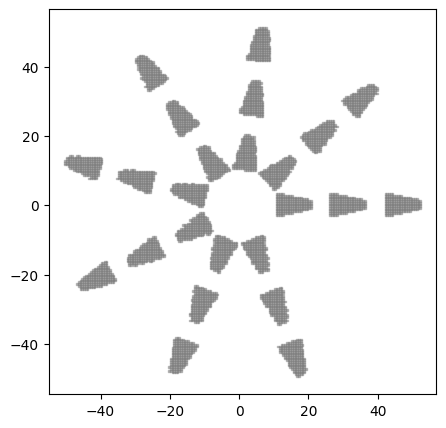

--------------------------------------------------
label: VentHole Chromosome_975: ['TriangleShape_823', 'CornerTransformation_127']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 4.0, ]


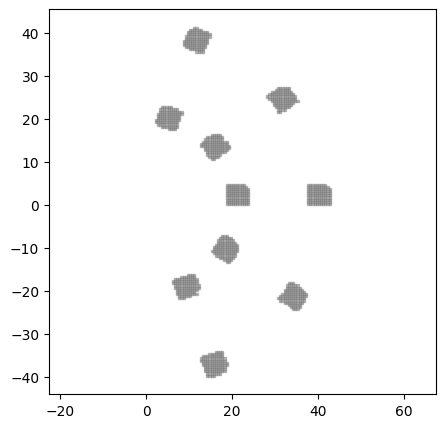

--------------------------------------------------
label: VentHole Chromosome_127: ['TrapezoidShape_108', 'CircularStrictTransformation_474']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


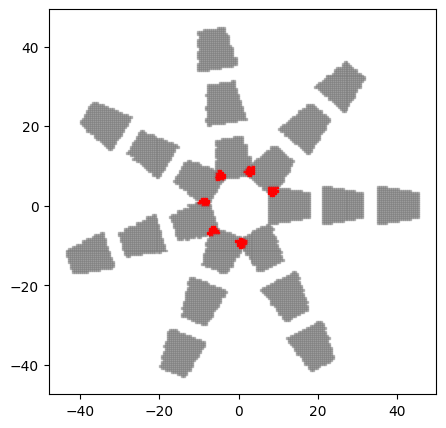

--------------------------------------------------
label: VentHole Chromosome_363: ['RayShape_574', 'CircularStrictTransformation_127']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


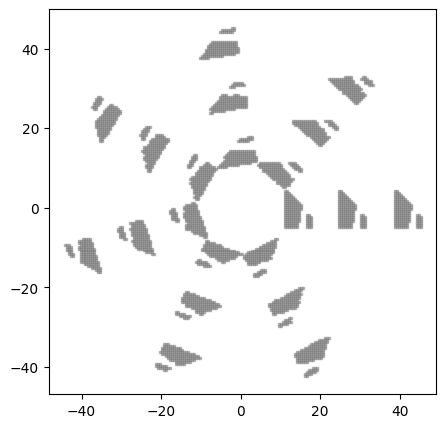

--------------------------------------------------
label: VentHole Chromosome_420: ['RayShape_363', 'CircularStrictTransformation_191']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.6283185307179586, ]


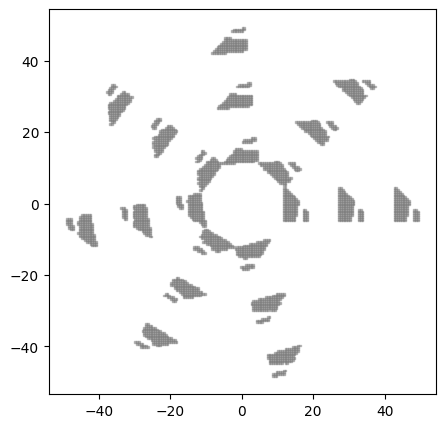

--------------------------------------------------
label: VentHole Chromosome_258: ['TriangleShape_723', 'GridStrictTransformation_982']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


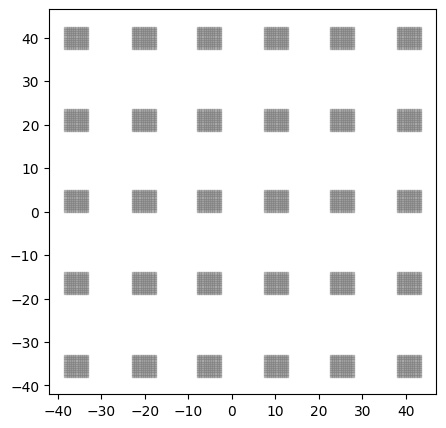

--------------------------------------------------
label: VentHole Chromosome_783: ['DonutShape_316', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


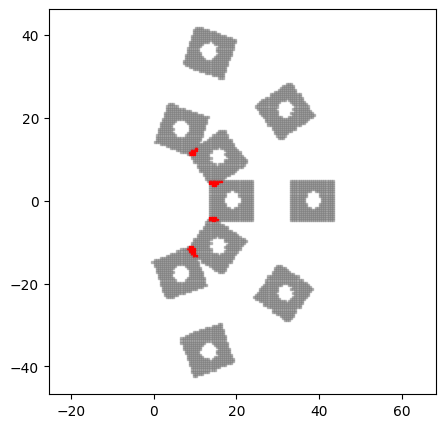

--------------------------------------------------
label: VentHole Chromosome_872: ['RayShape_316', 'CircularStrictTransformation_647']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6559143436561357, nose_point: 1.227754993634589, lower_coefficient: 3.3595026999583957, lower_x-intercept: 1.4318805033924202, lower_y-intercept: 1.6110833899145065, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


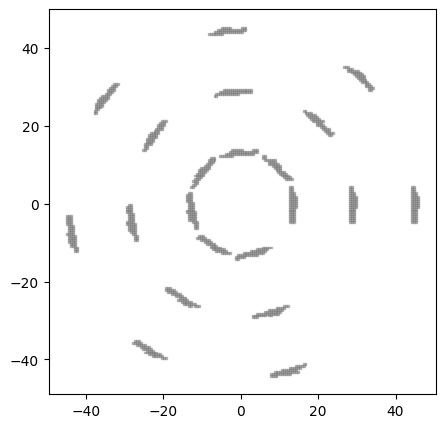

--------------------------------------------------
label: VentHole Chromosome_685: ['TrapezoidShape_871', 'CircularStrictTransformation_991']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


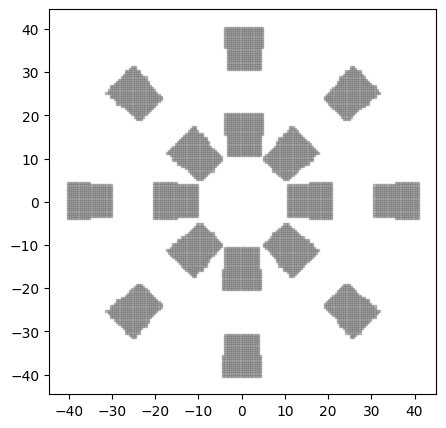

--------------------------------------------------
label: VentHole Chromosome_42: ['TrapezoidShape_685', 'GridStrictTransformation_510']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


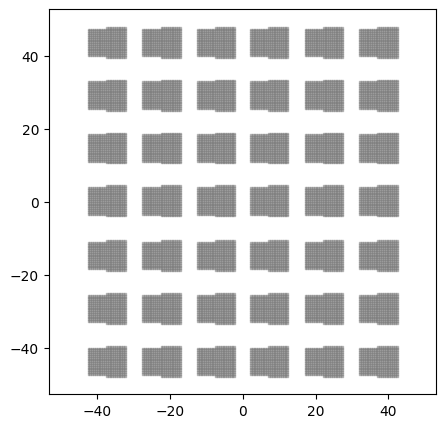

--------------------------------------------------
label: VentHole Chromosome_991: ['TriangleShape_488', 'CornerTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


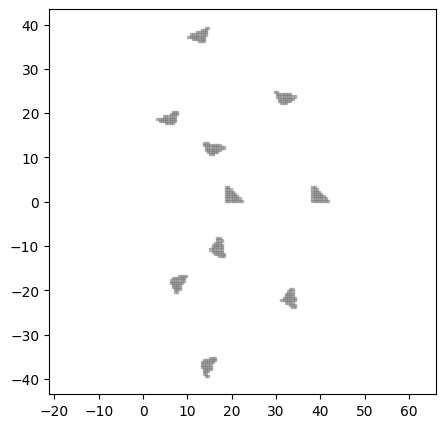

--------------------------------------------------
label: VentHole Chromosome_839: ['DoubleParabolicShape_548', 'CornerTransformation_991']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.2661943750335705, upper_coefficient: 1.7218859482710167, lower_y-intercept: 2.983751818459124, upper_y-intercept_from_lower_y: 1.6457817518665636, lower_x_trans: 0.9999517746226037, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


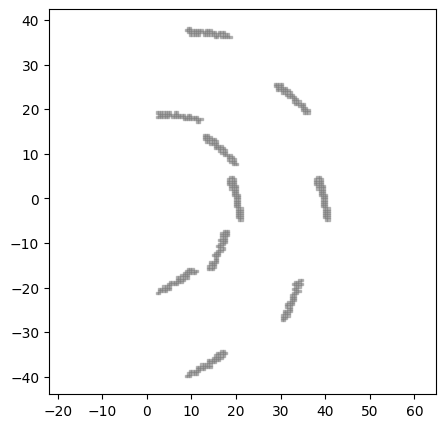

--------------------------------------------------
label: VentHole Chromosome_253: ['DoubleParabolicShape_839', 'CircularStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.2661943750335705, upper_coefficient: 1.7218859482710167, lower_y-intercept: 2.983751818459124, upper_y-intercept_from_lower_y: 1.6457817518665636, lower_x_trans: 0.9999517746226037, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 0.7943149583733558, phi: 0.483321946706122, ]


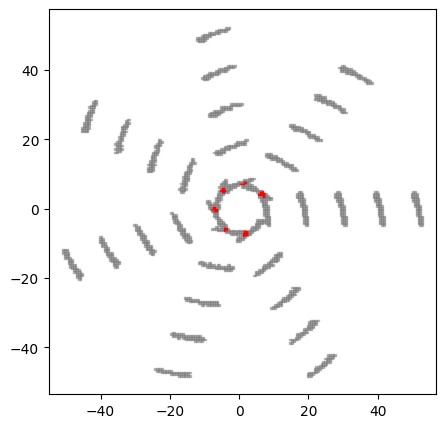

--------------------------------------------------
label: VentHole Chromosome_984: ['RayShape_740', 'CircularStrictTransformation_253']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 0.7943149583733558, phi: 0.483321946706122, ]


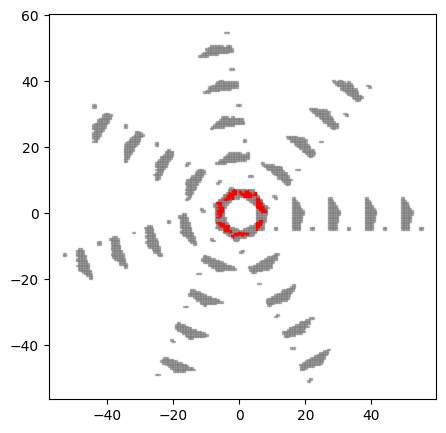

--------------------------------------------------
label: VentHole Chromosome_740: ['TrapezoidShape_899', 'CircularStrictTransformation_415']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


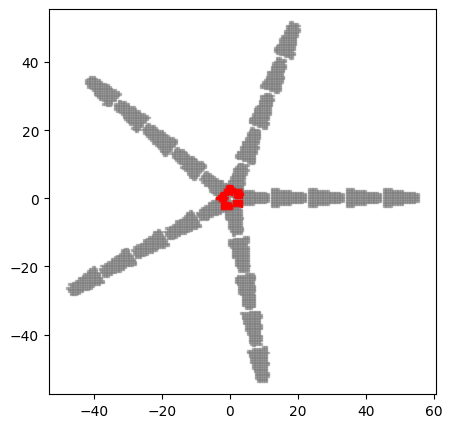

--------------------------------------------------
label: VentHole Chromosome_459: ['TrapezoidShape_740', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


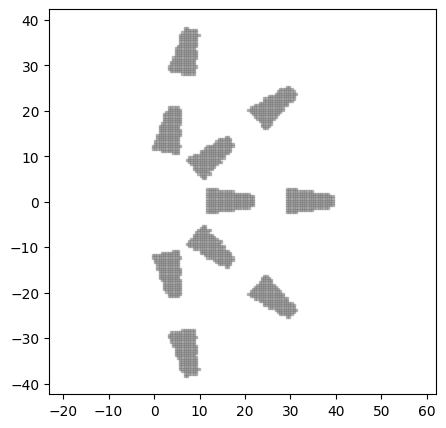

--------------------------------------------------
label: VentHole Chromosome_792: ['RayShape_792', 'CircularStrictTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


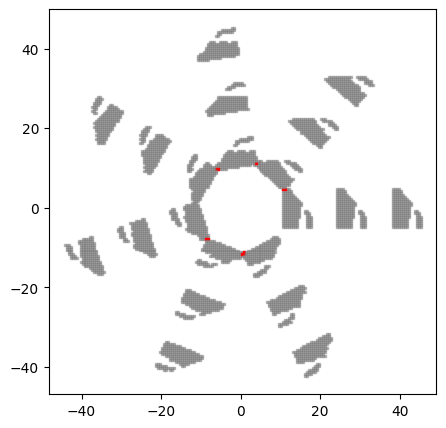

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_459', 'GridStrictTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


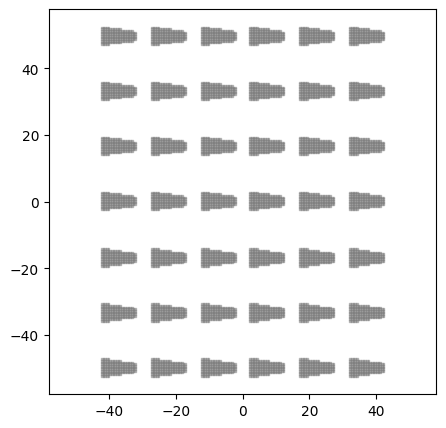

--------------------------------------------------
label: VentHole Chromosome_438: ['WingShape_692', 'GridStrictTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


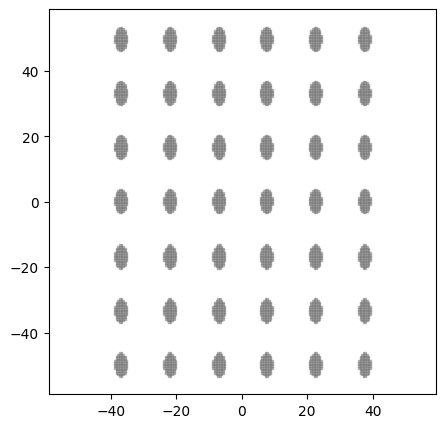

--------------------------------------------------
label: VentHole Chromosome_692: ['RayShape_463', 'CornerTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 9.28197864314253, dx: 1.859799167794286, phi: 0.7422463986582669, rot_count: 4.0, ]


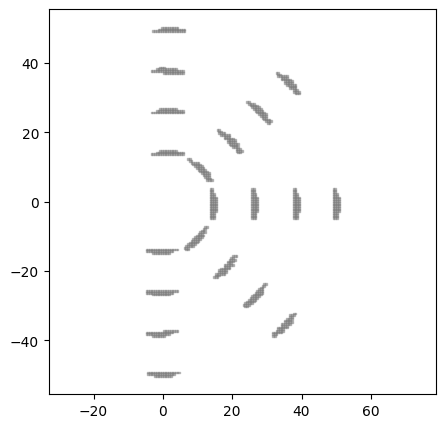

--------------------------------------------------
label: VentHole Chromosome_298: ['HoleShape_548', 'GridStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.365803290777451, ]
pattern parameter:
parameter_list: [ dx: 8.149986214070697, dy: 6.794986250436445, ]


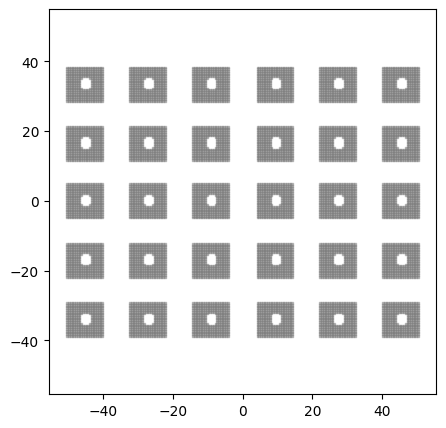

--------------------------------------------------
label: VentHole Chromosome_723: ['WingShape_692', 'CornerTransformation_459']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


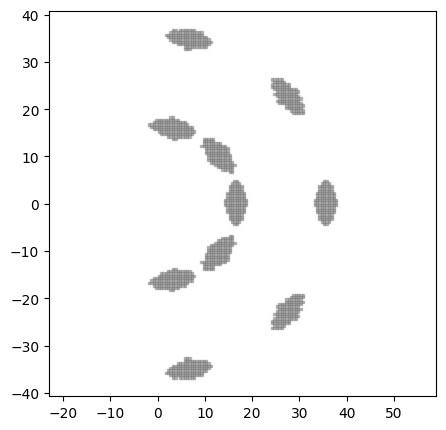

--------------------------------------------------
label: VentHole Chromosome_382: ['WingShape_723', 'CircularStrictTransformation_352']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.695674343457537, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


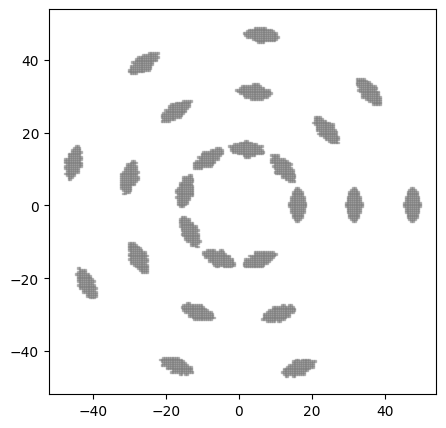

--------------------------------------------------
label: VentHole Chromosome_975: ['TrapezoidShape_487', 'CircularStrictTransformation_382']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


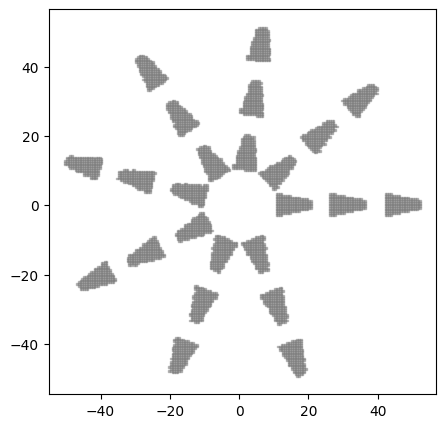

--------------------------------------------------
label: VentHole Chromosome_694: ['TriangleShape_823', 'CircularStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


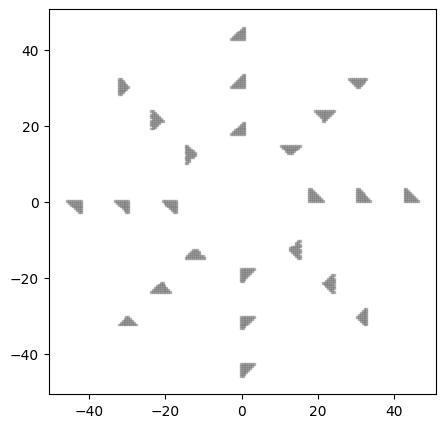

--------------------------------------------------
label: VentHole Chromosome_458: ['RayShape_692', 'CircularStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


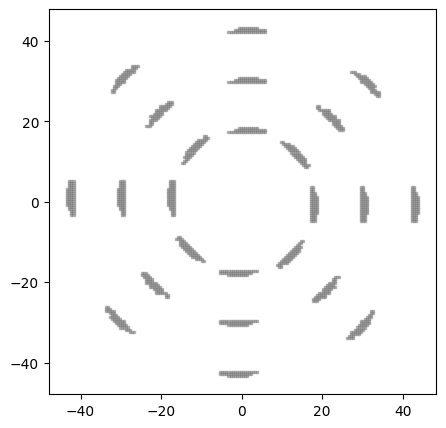

--------------------------------------------------
label: VentHole Chromosome_258: ['RayShape_458', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


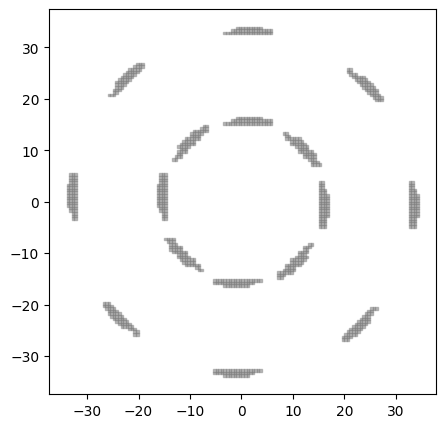

--------------------------------------------------
label: VentHole Chromosome_538: ['HoleShape_712', 'CircularStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 11.390439673634724, dx: 7.500565927872639, phi: 0.7853981633974483, ]


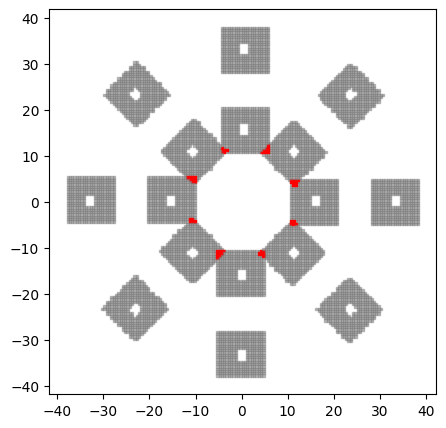

--------------------------------------------------
label: VentHole Chromosome_928: ['HoleShape_538', 'CircularStrictTransformation_649']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 8.145479259950836, phi: 0.483321946706122, ]


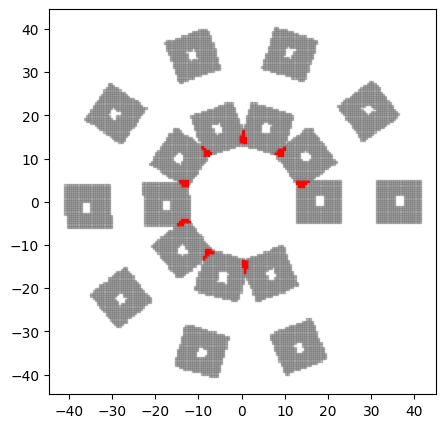

--------------------------------------------------
label: VentHole Chromosome_649: ['TrapezoidShape_975', 'CircularStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 8.145479259950836, phi: 0.483321946706122, ]


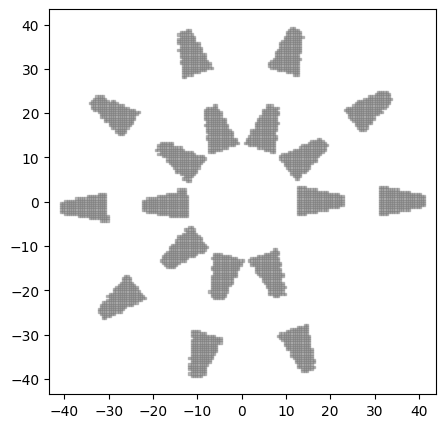

--------------------------------------------------
label: VentHole Chromosome_823: ['RayShape_792', 'CircularStrictTransformation_540']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


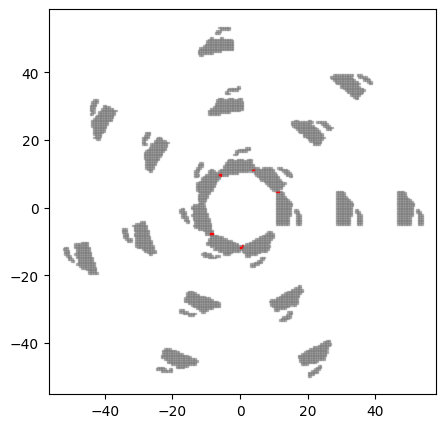

--------------------------------------------------
label: VentHole Chromosome_792: ['RayShape_824', 'CornerTransformation_459']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 1.0235249549719176, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


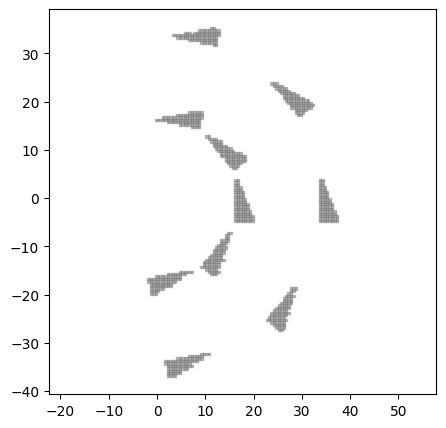

--------------------------------------------------
label: VentHole Chromosome_105: ['RayShape_792', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 1.0235249549719176, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


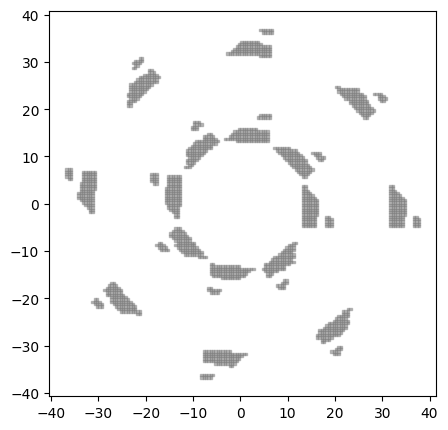

--------------------------------------------------
label: VentHole Chromosome_659: ['WingShape_438', 'CircularStrictTransformation_659']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


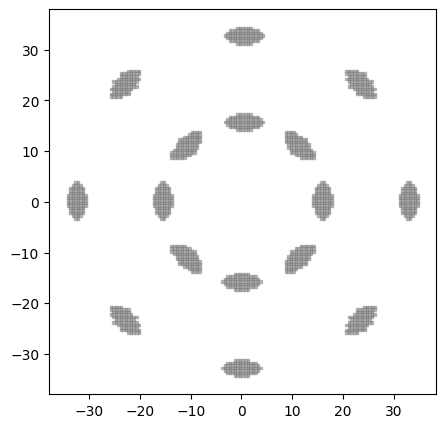

--------------------------------------------------
label: VentHole Chromosome_894: ['TrapezoidShape_127', 'CircularStrictTransformation_659']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


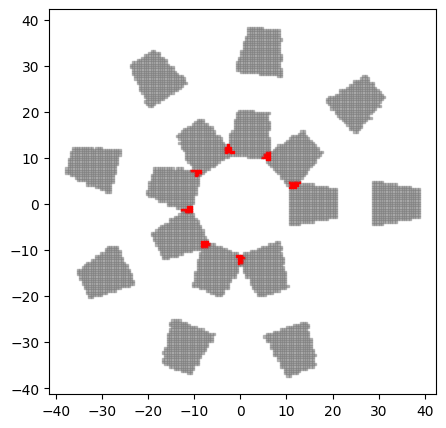

--------------------------------------------------
label: VentHole Chromosome_146: ['RayShape_899', 'CornerTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


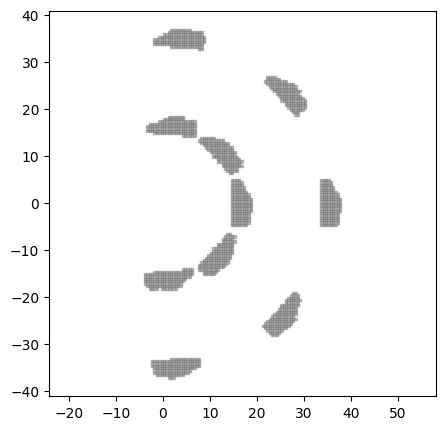

--------------------------------------------------
label: VentHole Chromosome_277: ['WingShape_7', 'CornerTransformation_126']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.882171081248374, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 1.816438586966198, phi: 0.4785459301078606, rot_count: 6.0, ]


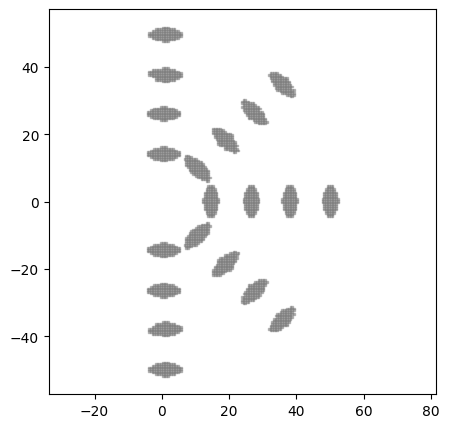

--------------------------------------------------
label: VentHole Chromosome_388: ['WingShape_277', 'CircularStrictTransformation_189']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.882171081248374, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


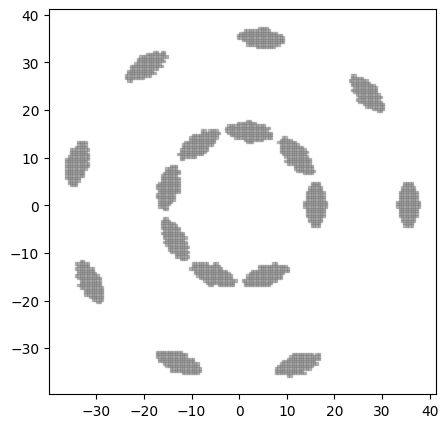

--------------------------------------------------
label: VentHole Chromosome_723: ['TrapezoidShape_230', 'CornerTransformation_365']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


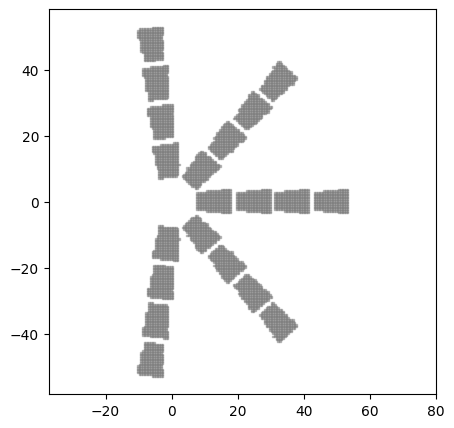

--------------------------------------------------
label: VentHole Chromosome_839: ['HoleShape_57', 'CornerTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.295188182743882, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


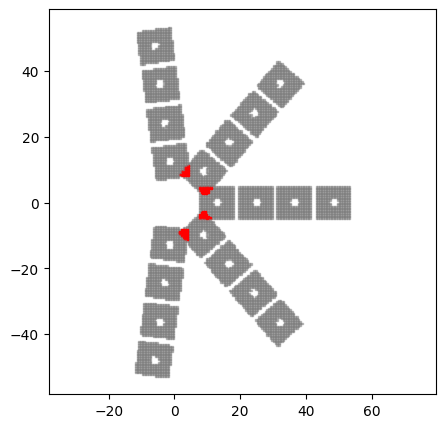

--------------------------------------------------
label: VentHole Chromosome_749: ['RayShape_420', 'CornerTransformation_988']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


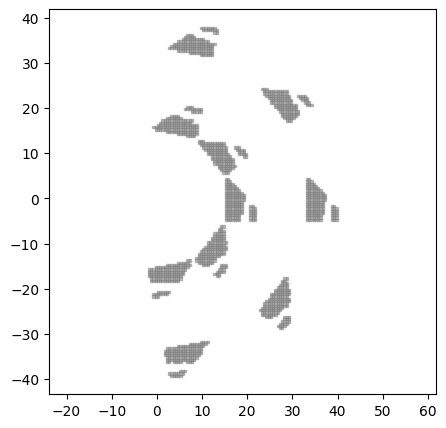

--------------------------------------------------
label: VentHole Chromosome_467: ['RayShape_749', 'CornerTransformation_108']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


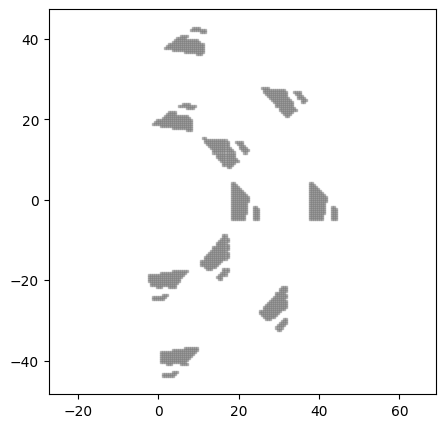

--------------------------------------------------
label: VentHole Chromosome_942: ['TriangleShape_67', 'CornerTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


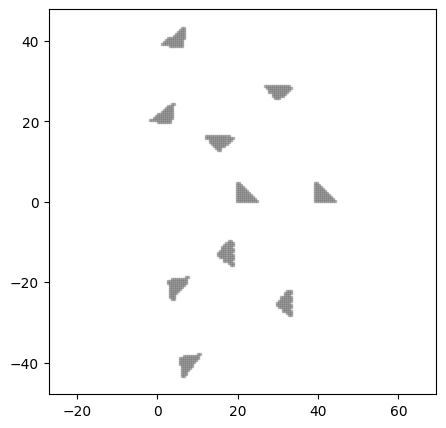

--------------------------------------------------
label: VentHole Chromosome_67: ['TriangleShape_942', 'CircularStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


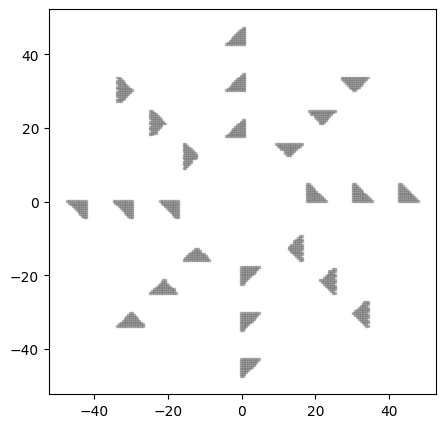

--------------------------------------------------
label: VentHole Chromosome_366: ['TriangleShape_230', 'CornerTransformation_585']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


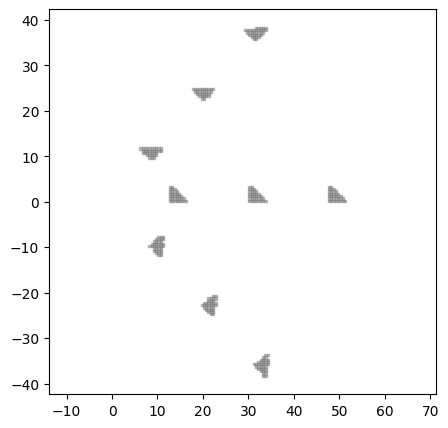

--------------------------------------------------
label: VentHole Chromosome_334: ['DoubleParabolicShape_899', 'CornerTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


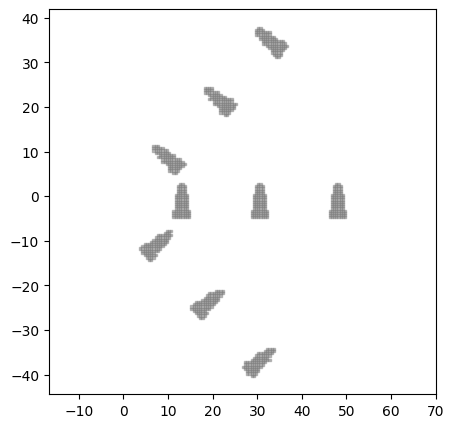

--------------------------------------------------
label: VentHole Chromosome_730: ['WingShape_659', 'CornerTransformation_749']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


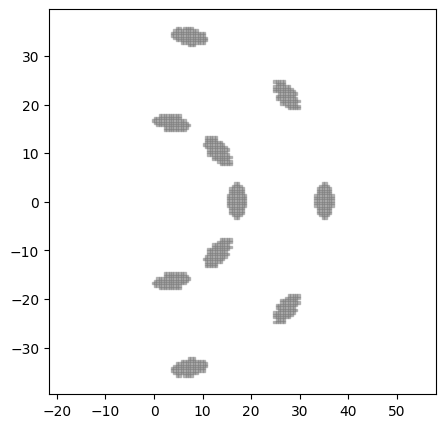

--------------------------------------------------
label: VentHole Chromosome_413: ['WingShape_730', 'CornerTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


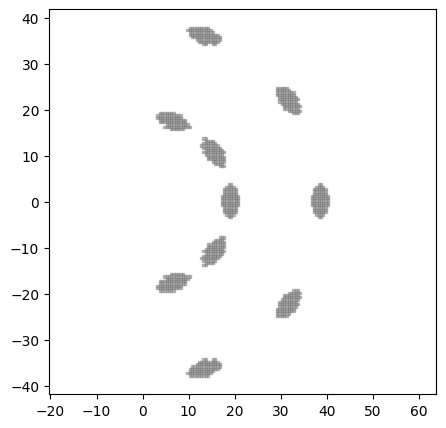

--------------------------------------------------
label: VentHole Chromosome_432: ['TriangleShape_991', 'CornerTransformation_413']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


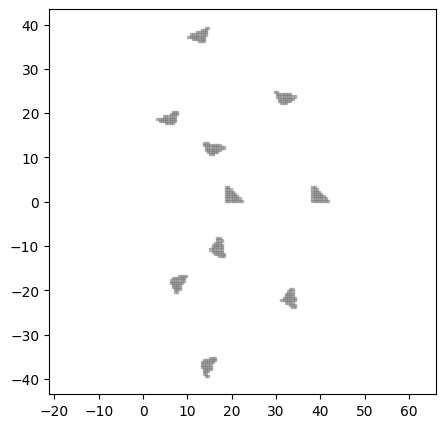

--------------------------------------------------
label: VentHole Chromosome_991: ['TriangleShape_432', 'CornerTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 12.63236254093845, dx: 7.429882210168095, phi: 0.5166828267611085, rot_count: 3.0, ]


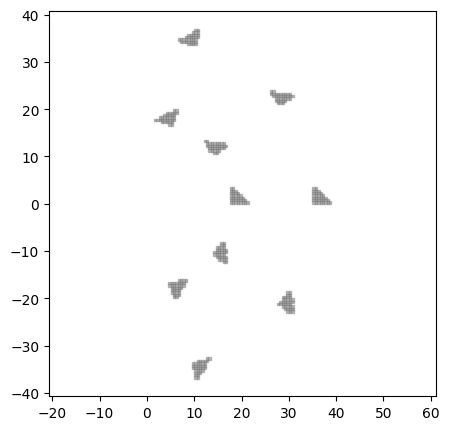

--------------------------------------------------
label: VentHole Chromosome_889: ['TriangleShape_366', 'CornerTransformation_991']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 12.63236254093845, dx: 7.429882210168095, phi: 0.5166828267611085, rot_count: 3.0, ]


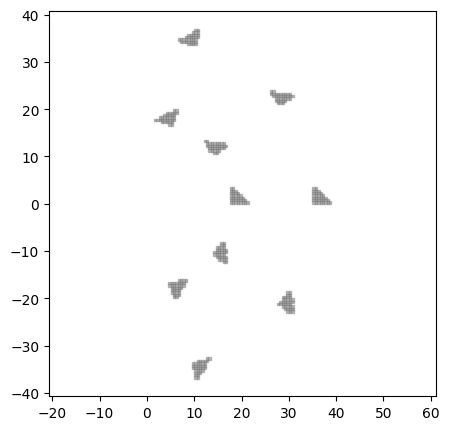

--------------------------------------------------
label: VentHole Chromosome_798: ['TriangleShape_889', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


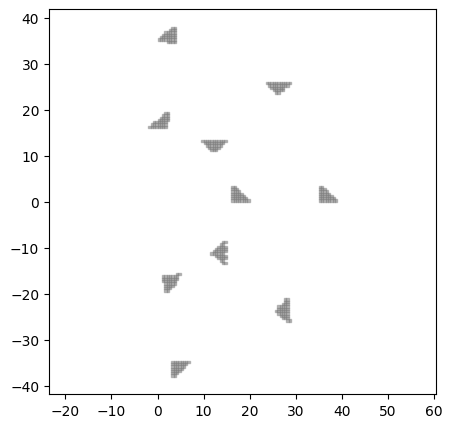

--------------------------------------------------
label: VentHole Chromosome_849: ['WingShape_413', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 5.807728062127912, phi: 0.483321946706122, ]


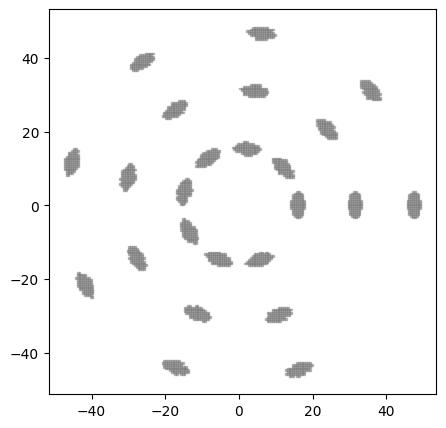

--------------------------------------------------
label: VentHole Chromosome_723: ['HoleShape_298', 'CircularStrictTransformation_692']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.365803290777451, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


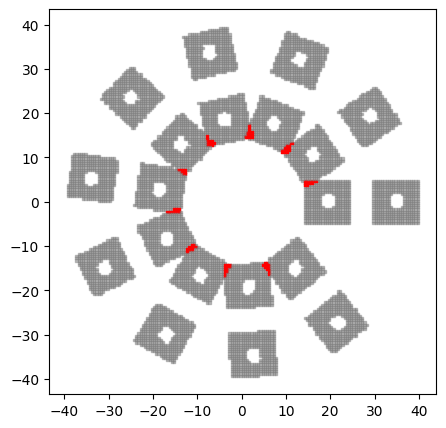

--------------------------------------------------
label: VentHole Chromosome_645: ['TrapezoidShape_42', 'CircularStrictTransformation_740']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


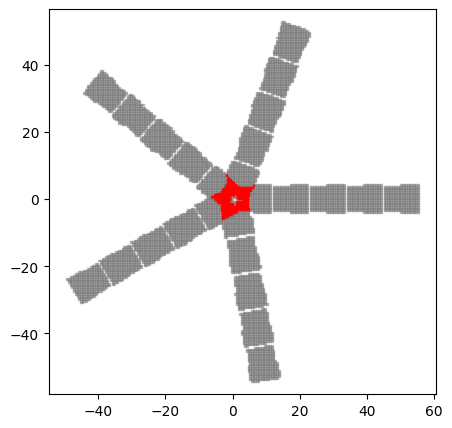

--------------------------------------------------
label: VentHole Chromosome_304: ['DoubleParabolicShape_334', 'CircularStrictTransformation_645']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


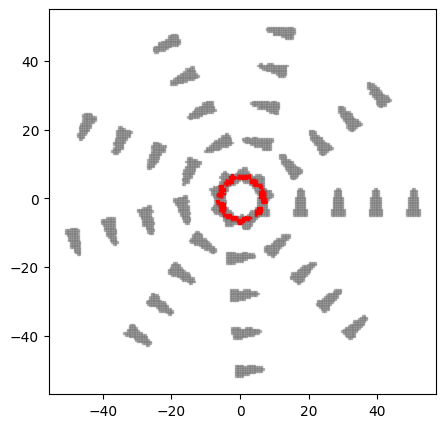

--------------------------------------------------
label: VentHole Chromosome_694: ['DoubleParabolicShape_304', 'GridStrictTransformation_180']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


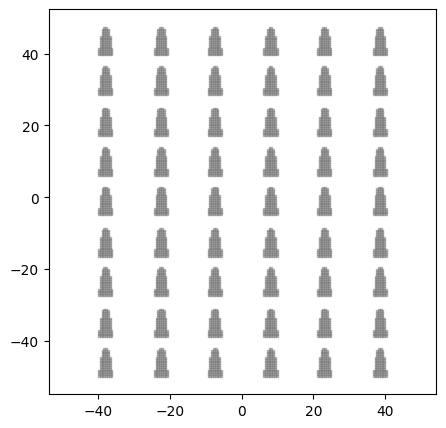

--------------------------------------------------
label: VentHole Chromosome_105: ['RayShape_105', 'GridStrictTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 1.0235249549719176, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


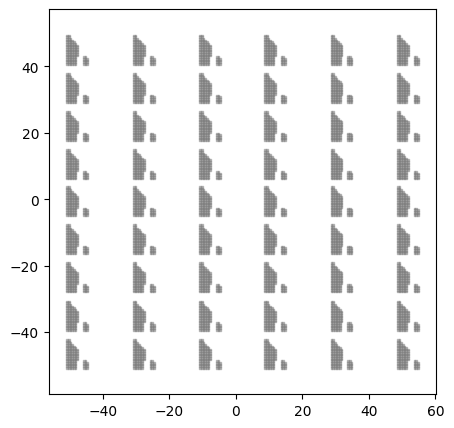

--------------------------------------------------
label: VentHole Chromosome_62: ['TrapezoidShape_942', 'GridStrictTransformation_105']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


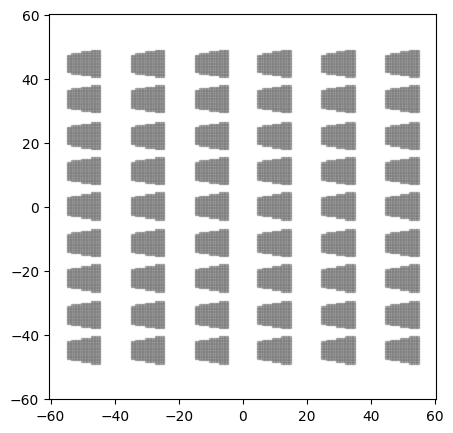

--------------------------------------------------
label: VentHole Chromosome_849: ['DonutShape_783', 'GridStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 8.149986214070697, dy: 6.794986250436445, ]


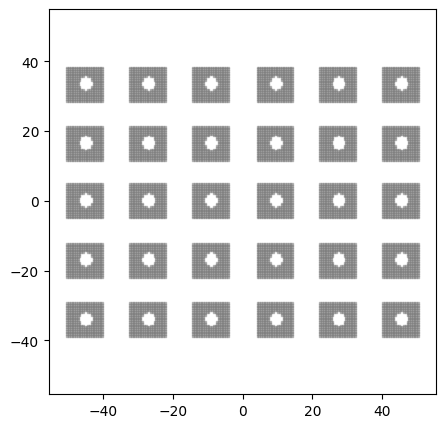

--------------------------------------------------
label: VentHole Chromosome_34: ['RayShape_606', 'CircularStrictTransformation_884']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.3864273081077458, nose_point: 1.6633561681512983, lower_coefficient: 1.2945238092317164, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.945911121840797, ]
pattern parameter:
parameter_list: [ di: 7.7987692056343345, dx: 9.90251222160351, phi: 0.6283185307179586, ]


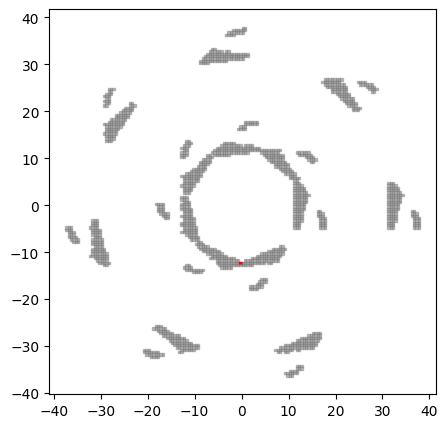

--------------------------------------------------
label: VentHole Chromosome_836: ['TriangleShape_798', 'GridStrictTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 5.127324192664817, dy: 4.484528829467593, ]


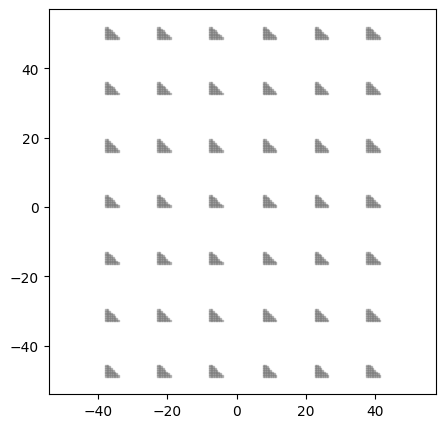

--------------------------------------------------
label: VentHole Chromosome_366: ['TriangleShape_836', 'CircularStrictTransformation_86']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


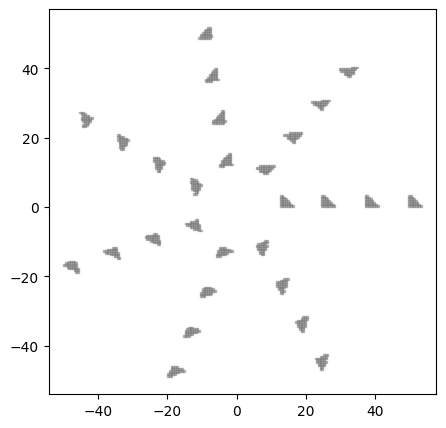

--------------------------------------------------
label: VentHole Chromosome_86: ['TrapezoidShape_894', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


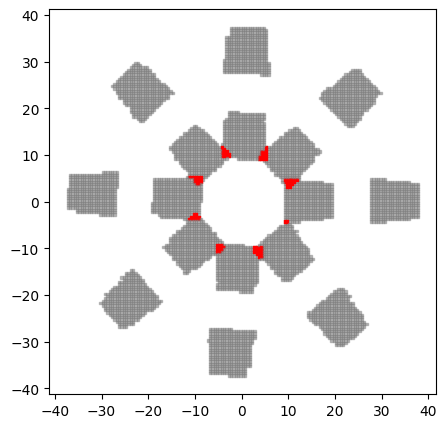

--------------------------------------------------
label: VentHole Chromosome_823: ['TrapezoidShape_649', 'CircularStrictTransformation_894']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


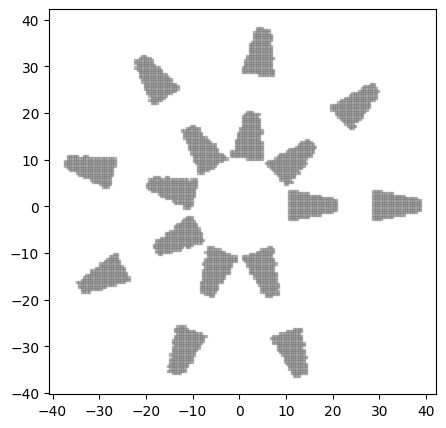

--------------------------------------------------
label: VentHole Chromosome_982: ['DonutShape_872', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


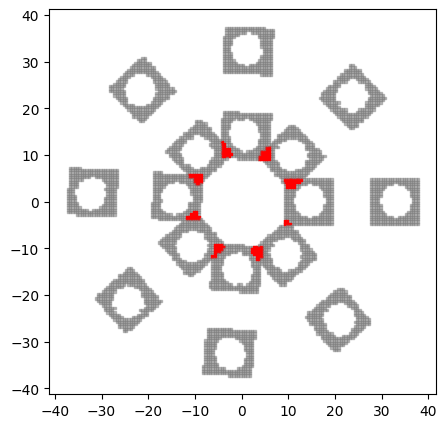

--------------------------------------------------
label: VentHole Chromosome_164: ['WingShape_849', 'GridStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


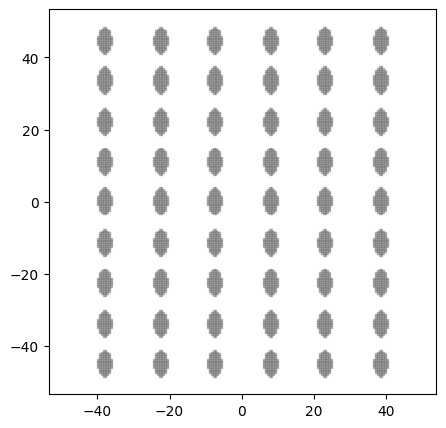

--------------------------------------------------
label: VentHole Chromosome_514: ['TriangleShape_258', 'CornerTransformation_332']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.7422463986582669, rot_count: 6.0, ]


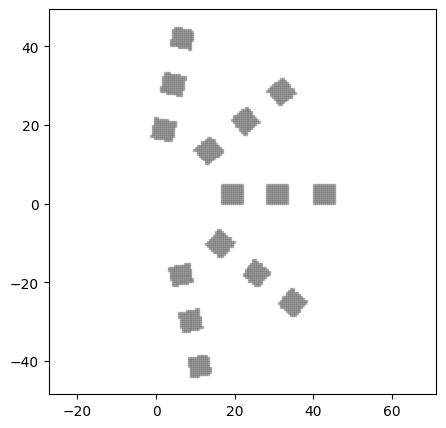

--------------------------------------------------
label: VentHole Chromosome_836: ['TriangleShape_514', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


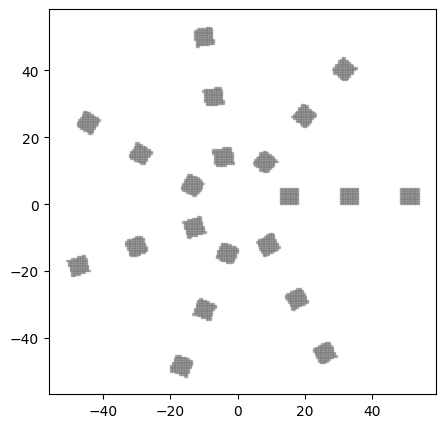

--------------------------------------------------
label: VentHole Chromosome_948: ['WingShape_948', 'CircularStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 2.9334022202764176, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


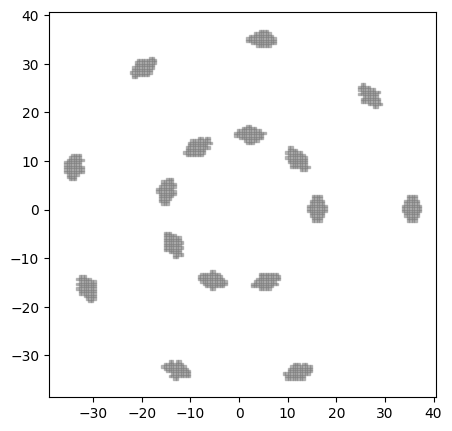

--------------------------------------------------
label: VentHole Chromosome_82: ['DoubleParabolicShape_514', 'CircularStrictTransformation_487']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


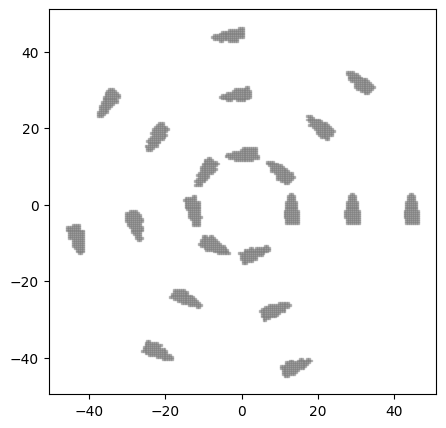

--------------------------------------------------
label: VentHole Chromosome_277: ['TrapezoidShape_736', 'GridStrictTransformation_352']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 7.023365592404686, dy: 8.794727031067021, ]


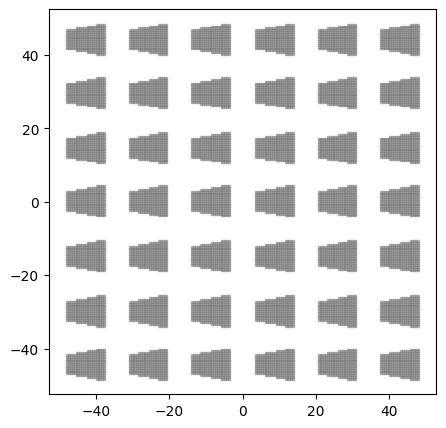

--------------------------------------------------
label: VentHole Chromosome_529: ['DonutShape_180', 'GridStrictTransformation_191']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


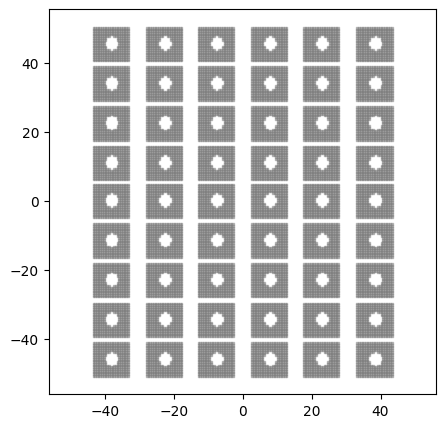

--------------------------------------------------
label: VentHole Chromosome_346: ['DonutShape_529', 'GridStrictTransformation_979']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 1.8973495203997655, dy: 4.999594967018924, ]


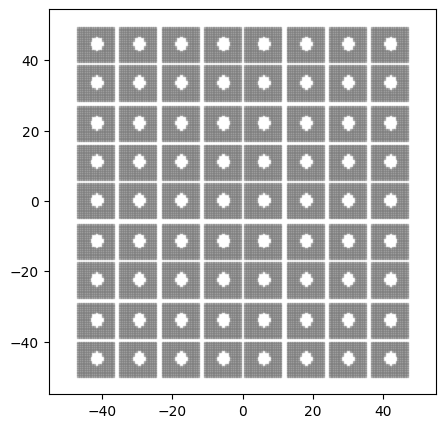

--------------------------------------------------
label: VentHole Chromosome_463: ['DonutShape_463', 'CircularStrictTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.356176217981065, r_outer: 8.600344704619449, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


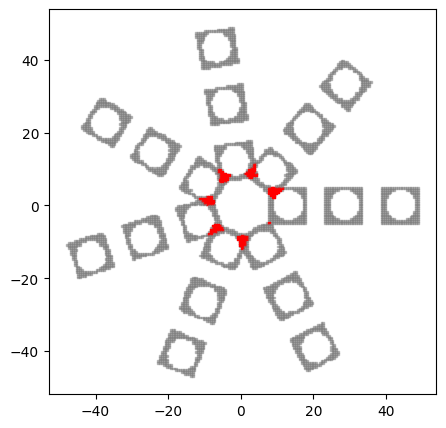

--------------------------------------------------
label: VentHole Chromosome_855: ['TriangleShape_282', 'CircularStrictTransformation_872']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.685329774968638, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


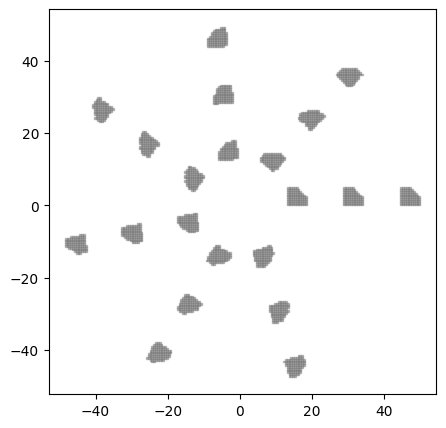

--------------------------------------------------
label: VentHole Chromosome_341: ['DonutShape_849', 'CircularStrictTransformation_855']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


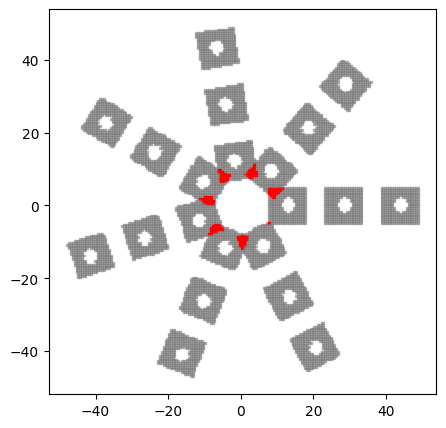

--------------------------------------------------
label: VentHole Chromosome_251: ['DonutShape_341', 'CircularStrictTransformation_398']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


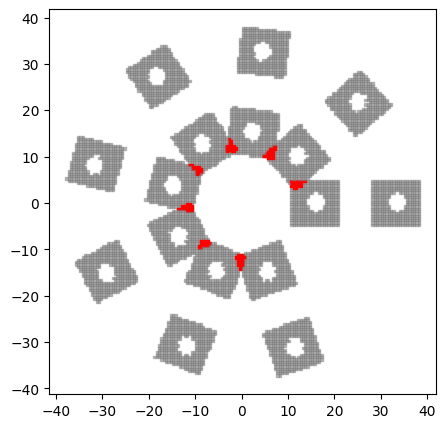

--------------------------------------------------
label: VentHole Chromosome_982: ['DoubleParabolicShape_982', 'GridStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.938108402846558, upper_coefficient: 1.6037410382015655, lower_y-intercept: 2.5852724678406362, upper_y-intercept_from_lower_y: 1.434182648048219, lower_x_trans: 0.6584983925627528, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


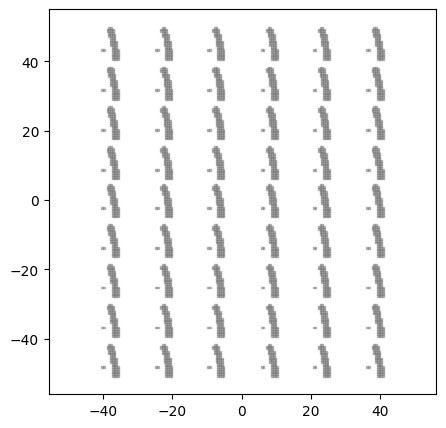

--------------------------------------------------
label: VentHole Chromosome_191: ['TriangleShape_488', 'CircularStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.6981317007977318, ]


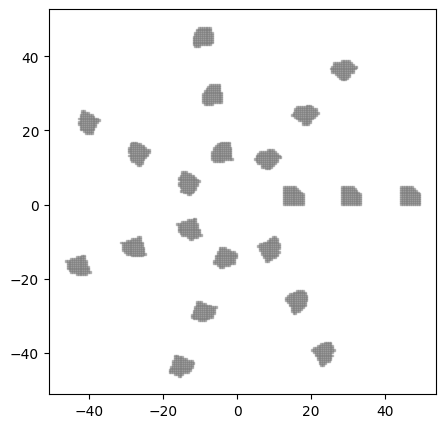

--------------------------------------------------
label: VentHole Chromosome_285: ['TrapezoidShape_96', 'GridStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.045318289883957, k2: 1.907833174810472, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 6.850813481976112, ]


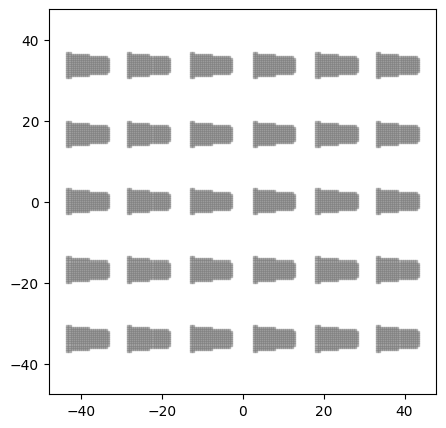

--------------------------------------------------
label: VentHole Chromosome_808: ['WingShape_614', 'CircularStrictTransformation_514']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


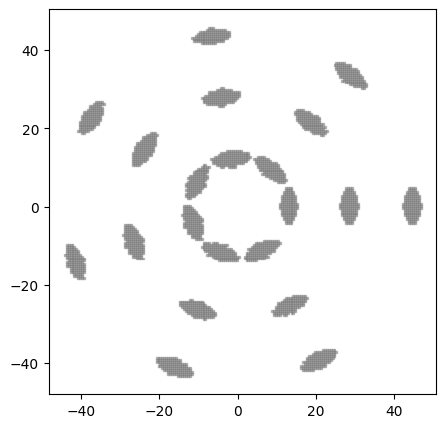

--------------------------------------------------
label: VentHole Chromosome_606: ['WingShape_258', 'CircularStrictTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


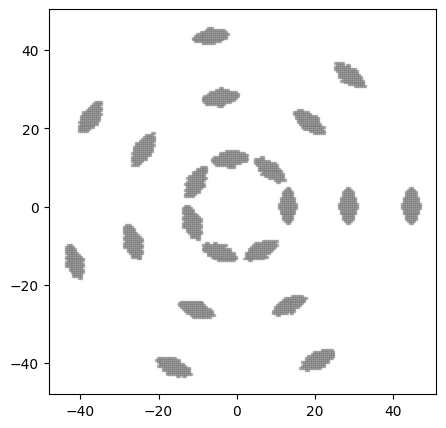

--------------------------------------------------
label: VentHole Chromosome_961: ['RayShape_146', 'GridStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


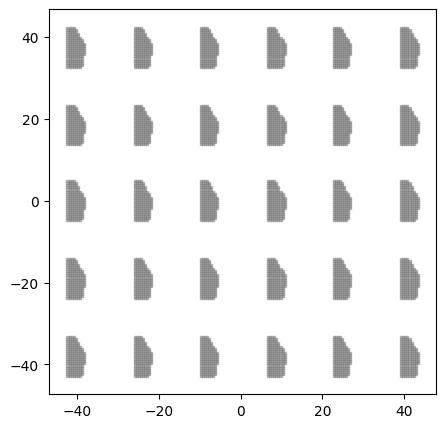

--------------------------------------------------
label: VentHole Chromosome_489: ['WingShape_606', 'CircularStrictTransformation_341']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


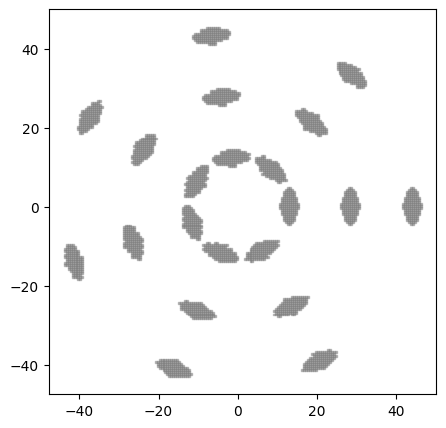

--------------------------------------------------
label: VentHole Chromosome_961: ['WingShape_489', 'GridStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


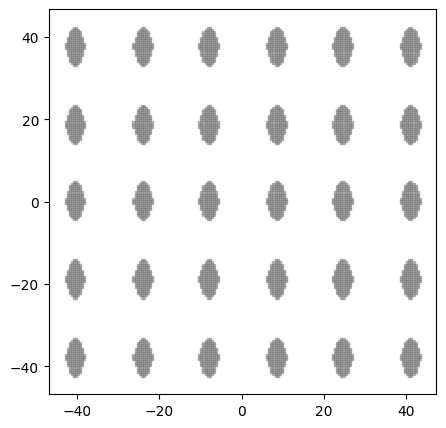

--------------------------------------------------
label: VentHole Chromosome_961: ['WingShape_961', 'CircularStrictTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


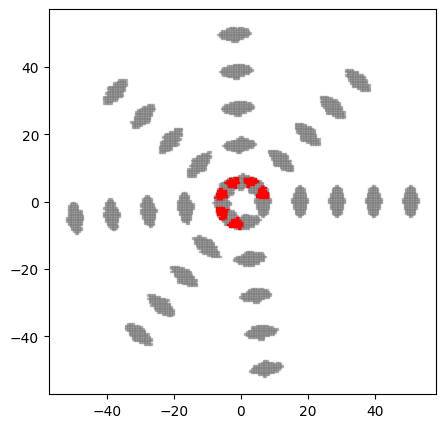

--------------------------------------------------
label: VentHole Chromosome_487: ['RayShape_984', 'CircularStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


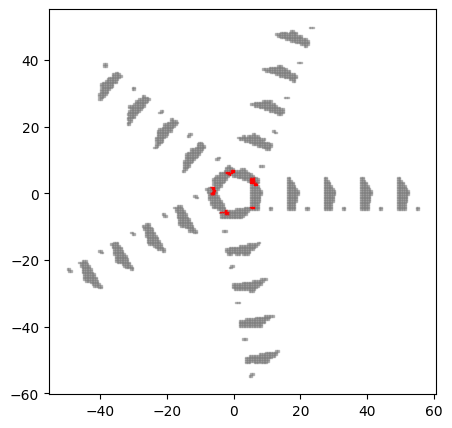

--------------------------------------------------
label: VentHole Chromosome_438: ['RayShape_467', 'CircularStrictTransformation_462']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


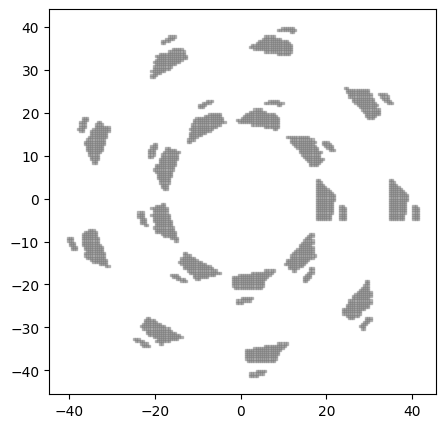

--------------------------------------------------
label: VentHole Chromosome_230: ['RayShape_971', 'CircularStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


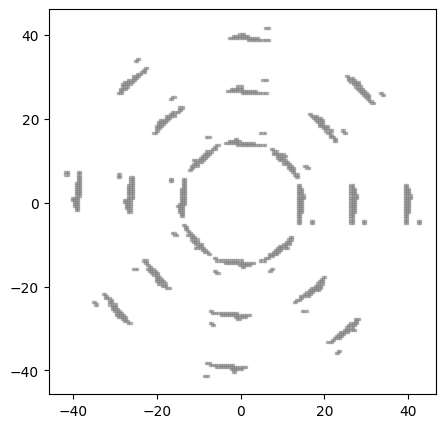

--------------------------------------------------
label: VentHole Chromosome_300: ['RayShape_230', 'CircularStrictTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


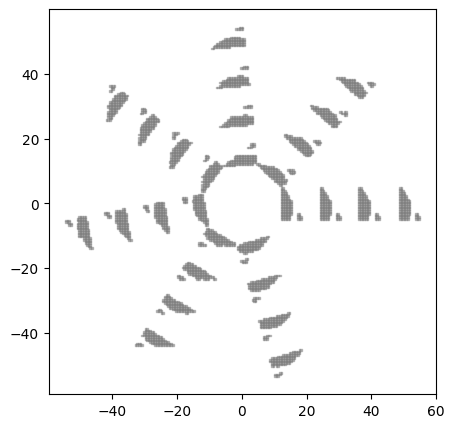

--------------------------------------------------
label: VentHole Chromosome_783: ['RayShape_438', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


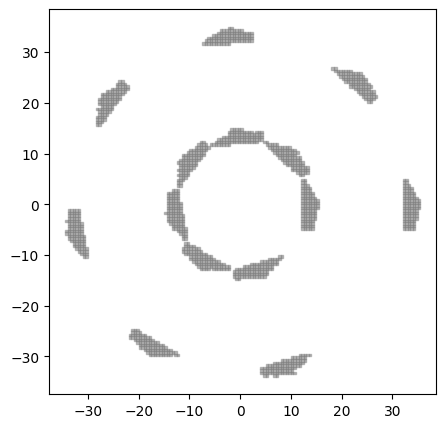

--------------------------------------------------
label: VentHole Chromosome_919: ['TrapezoidShape_645', 'CircularStrictTransformation_489']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


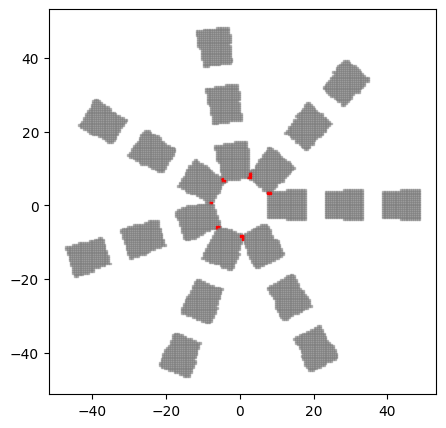

--------------------------------------------------
label: VentHole Chromosome_167: ['TrapezoidShape_86', 'GridStrictTransformation_720']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


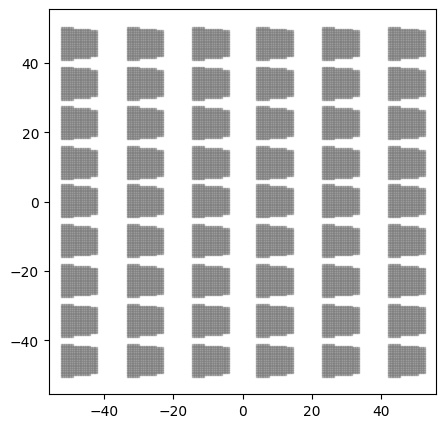

--------------------------------------------------
label: VentHole Chromosome_146: ['RayShape_329', 'CircularStrictTransformation_919']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


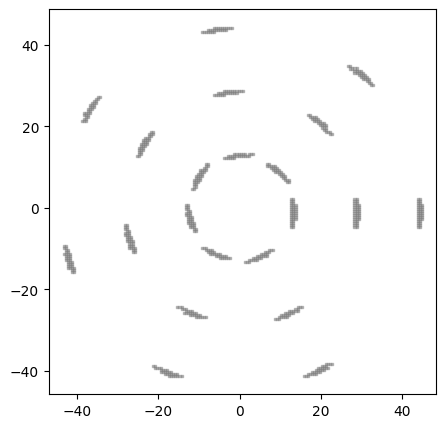

--------------------------------------------------
label: VentHole Chromosome_824: ['RayShape_146', 'CircularStrictTransformation_487']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


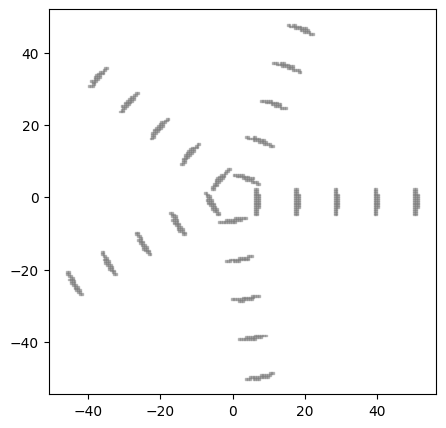

--------------------------------------------------
label: VentHole Chromosome_929: ['TrapezoidShape_62', 'CornerTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


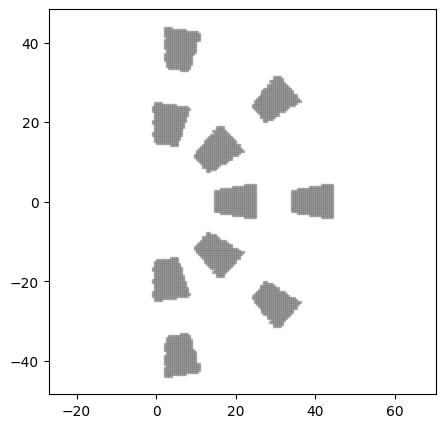

--------------------------------------------------
label: VentHole Chromosome_142: ['TrapezoidShape_723', 'CircularStrictTransformation_919']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


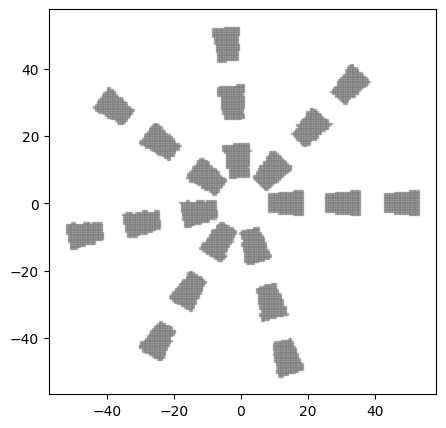

--------------------------------------------------
label: VentHole Chromosome_600: ['WingShape_808', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


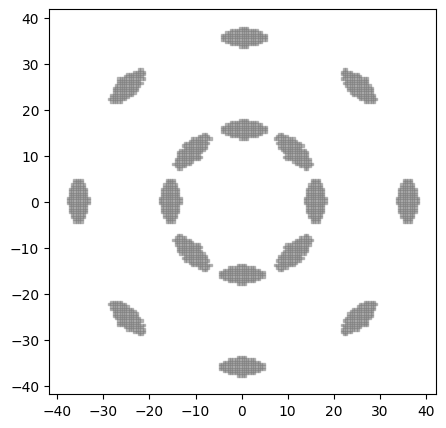

--------------------------------------------------
label: VentHole Chromosome_367: ['TrapezoidShape_142', 'CircularStrictTransformation_600']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


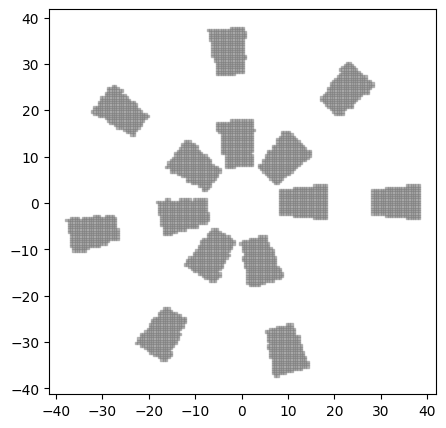

--------------------------------------------------
label: VentHole Chromosome_723: ['TrapezoidShape_367', 'CircularStrictTransformation_824']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


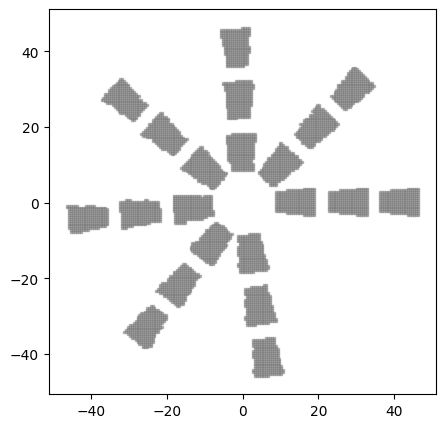

--------------------------------------------------
label: VentHole Chromosome_180: ['WingShape_964', 'CircularStrictTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.617343889993474, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


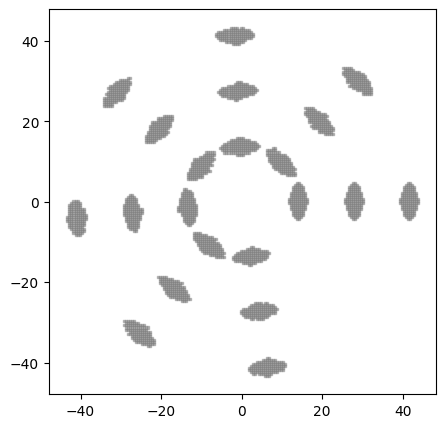

--------------------------------------------------
label: VentHole Chromosome_698: ['WingShape_180', 'GridStrictTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.617343889993474, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


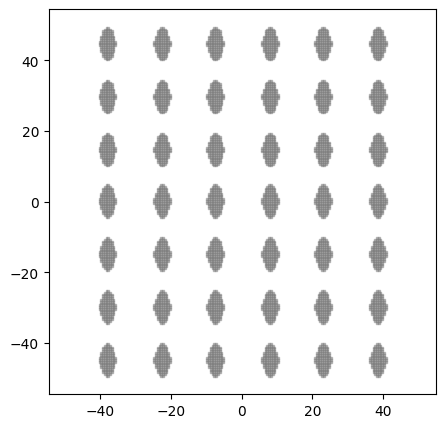

--------------------------------------------------
label: VentHole Chromosome_467: ['HoleShape_791', 'GridStrictTransformation_698']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


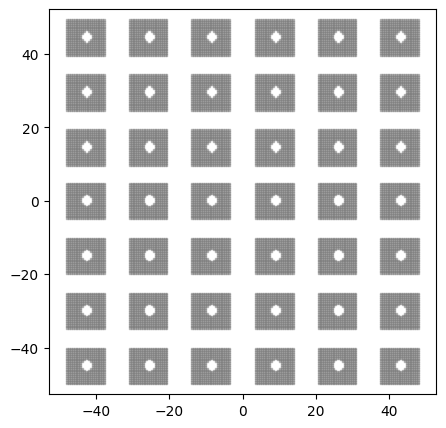

--------------------------------------------------
label: VentHole Chromosome_975: ['DoubleParabolicShape_310', 'CircularStrictTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 1.130536644657902, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


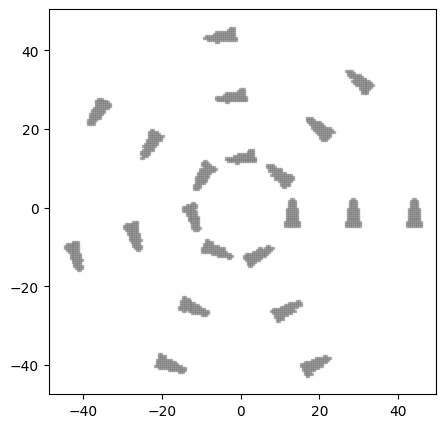

--------------------------------------------------
label: VentHole Chromosome_616: ['DoubleParabolicShape_975', 'CornerTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 1.130536644657902, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 11.616212757610864, dx: 0.9323115409400118, phi: 0.4443368011847215, rot_count: 3.0, ]


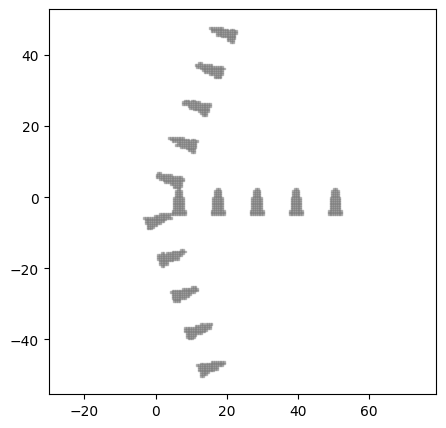

--------------------------------------------------
label: VentHole Chromosome_44: ['DoubleParabolicShape_44', 'CornerTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 3.572072892139567, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


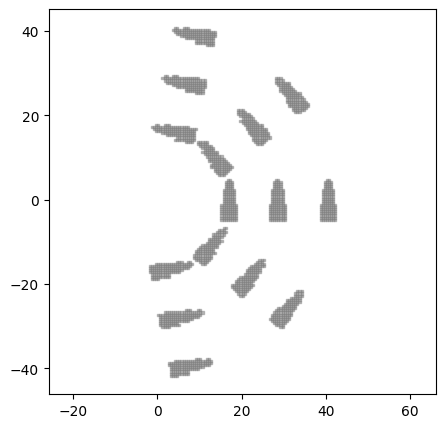

--------------------------------------------------
label: VentHole Chromosome_205: ['DoubleParabolicShape_751', 'CornerTransformation_44']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.1506227339525932, upper_y-intercept_from_lower_y: 1.6496962443104994, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


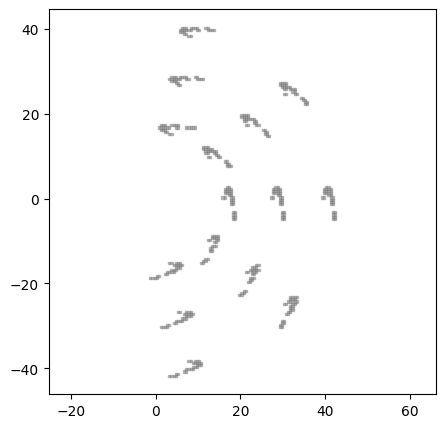

--------------------------------------------------
label: VentHole Chromosome_751: ['DoubleParabolicShape_205', 'CircularStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.1506227339525932, upper_y-intercept_from_lower_y: 1.6496962443104994, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 11.867950597251768, dx: 4.967750890003798, phi: 0.41887902047863906, ]


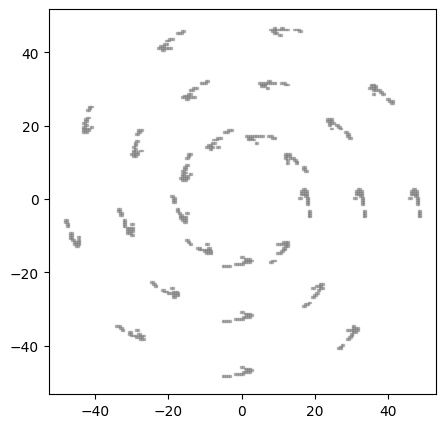

--------------------------------------------------
label: VentHole Chromosome_531: ['RayShape_706', 'CircularStrictTransformation_751']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6472948808468857, nose_point: 1.1119489214540719, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.1729789467665697, ]
pattern parameter:
parameter_list: [ di: 11.867950597251768, dx: 4.967750890003798, phi: 0.41887902047863906, ]


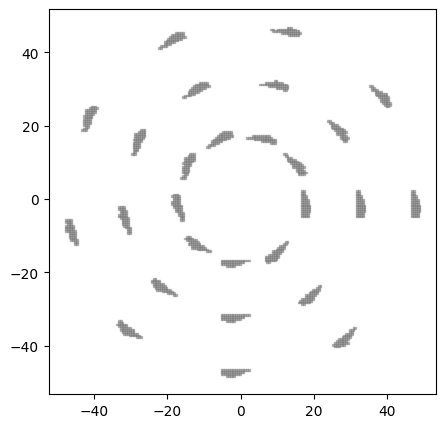

--------------------------------------------------
label: VentHole Chromosome_706: ['RayShape_531', 'CornerTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6472948808468857, nose_point: 1.1119489214540719, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.1729789467665697, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


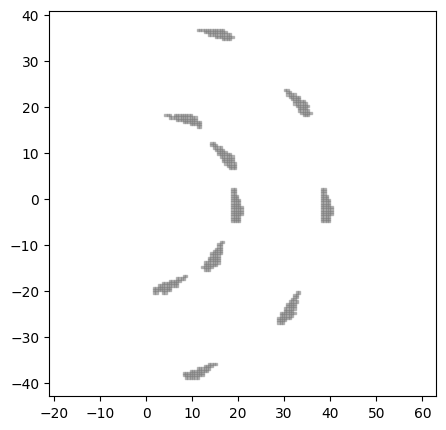

--------------------------------------------------
label: VentHole Chromosome_614: ['TrapezoidShape_942', 'CornerTransformation_798']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


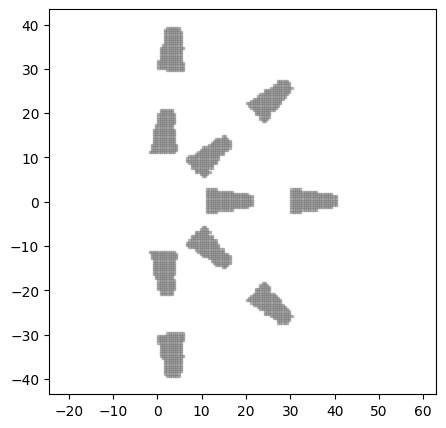

--------------------------------------------------
label: VentHole Chromosome_849: ['RayShape_300', 'CornerTransformation_614']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 8.745123640700152, phi: 0.7422463986582669, rot_count: 2.0, ]


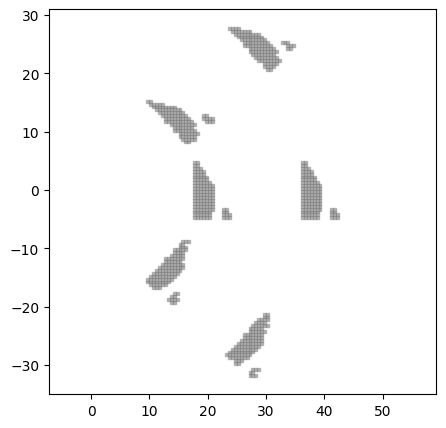

--------------------------------------------------
label: VentHole Chromosome_146: ['DonutShape_285', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.5405586455597153, r_outer: 9.655362115791107, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


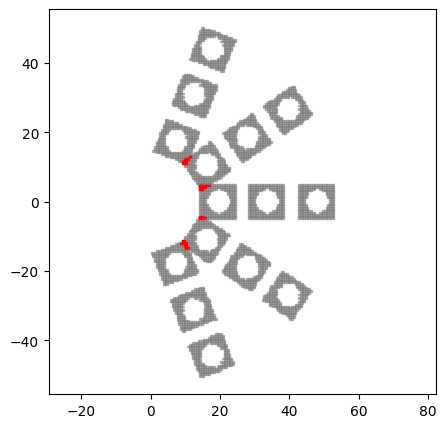

--------------------------------------------------
label: VentHole Chromosome_778: ['DonutShape_146', 'GridStrictTransformation_878']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.5405586455597153, r_outer: 9.655362115791107, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


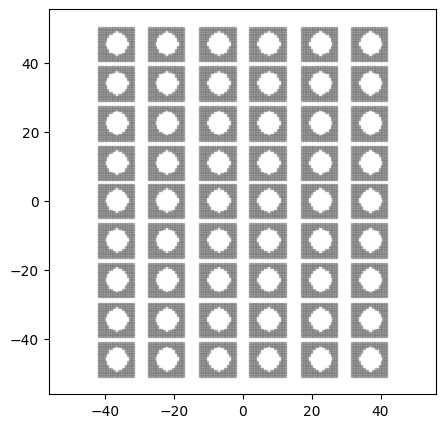

--------------------------------------------------
label: VentHole Chromosome_319: ['TriangleShape_366', 'GridStrictTransformation_778']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


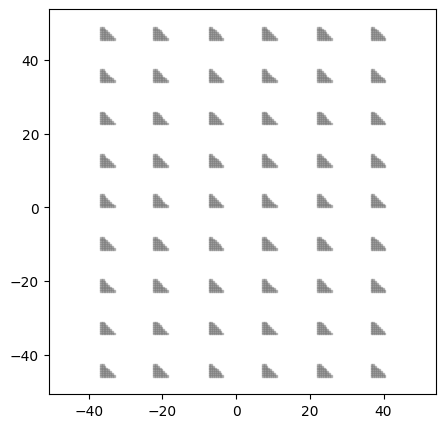

--------------------------------------------------
label: VentHole Chromosome_346: ['TrapezoidShape_668', 'GridStrictTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


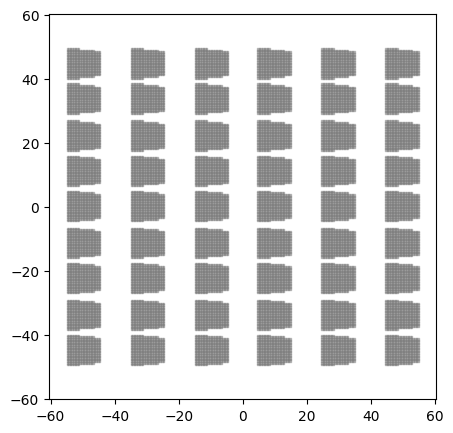

--------------------------------------------------
label: VentHole Chromosome_979: ['DonutShape_849', 'CornerTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


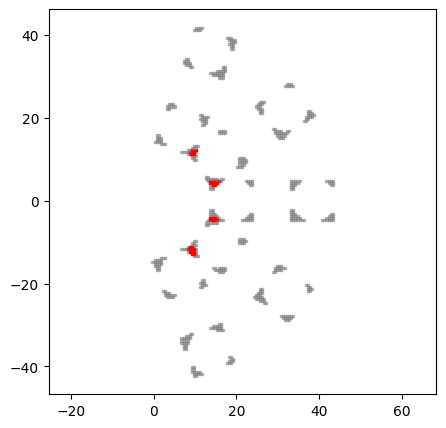

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_979', 'CornerTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


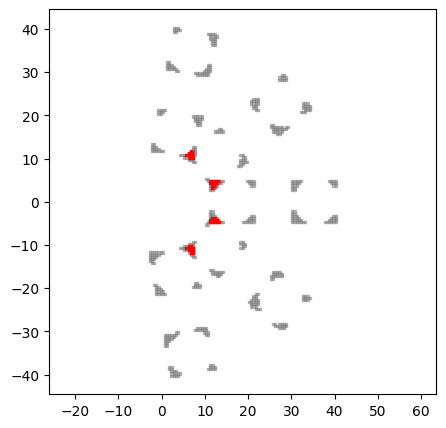

--------------------------------------------------
label: VentHole Chromosome_606: ['RayShape_34', 'GridStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.3864273081077458, nose_point: 1.6633561681512983, lower_coefficient: 1.2945238092317164, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.945911121840797, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


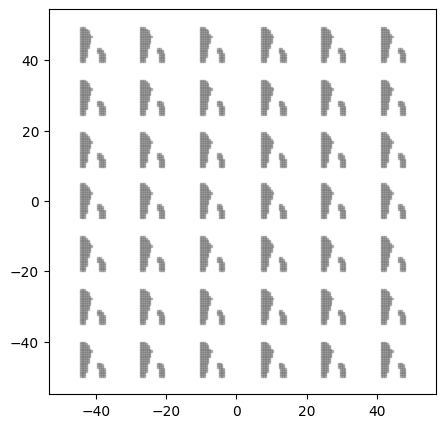

--------------------------------------------------
label: VentHole Chromosome_871: ['TrapezoidShape_919', 'CircularStrictTransformation_180']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


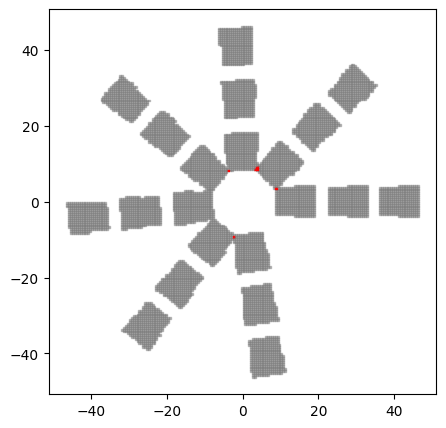

--------------------------------------------------
label: VentHole Chromosome_388: ['TriangleShape_576', 'GridStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


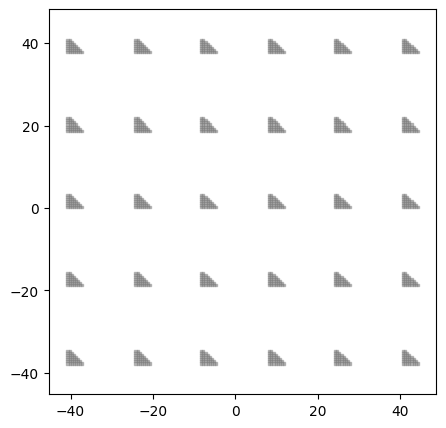

--------------------------------------------------
label: VentHole Chromosome_898: ['RayShape_487', 'GridStrictTransformation_346']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


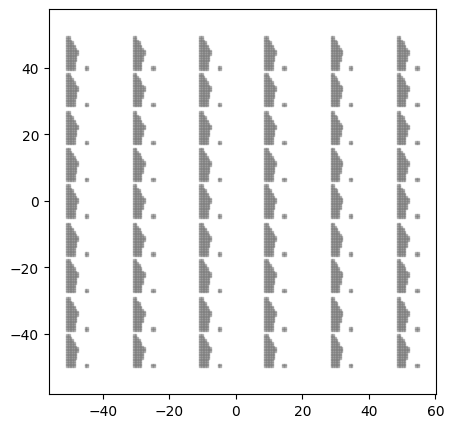

--------------------------------------------------
label: VentHole Chromosome_134: ['RayShape_898', 'GridStrictTransformation_319']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


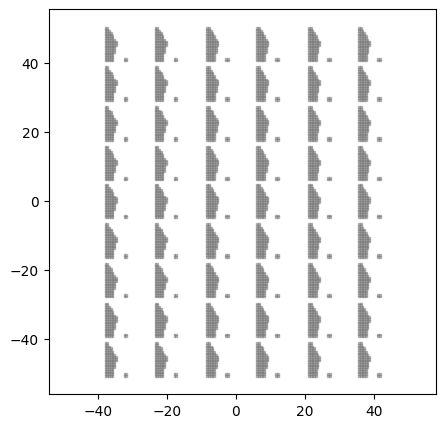

--------------------------------------------------
label: VentHole Chromosome_600: ['DoubleParabolicShape_647', 'GridStrictTransformation_134']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.2593728075358106, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


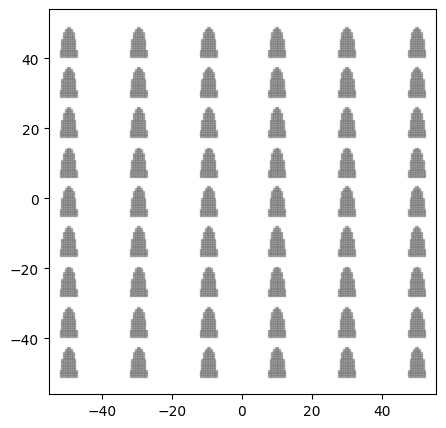

--------------------------------------------------
label: VentHole Chromosome_647: ['DoubleParabolicShape_600', 'CircularStrictTransformation_975']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.2593728075358106, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


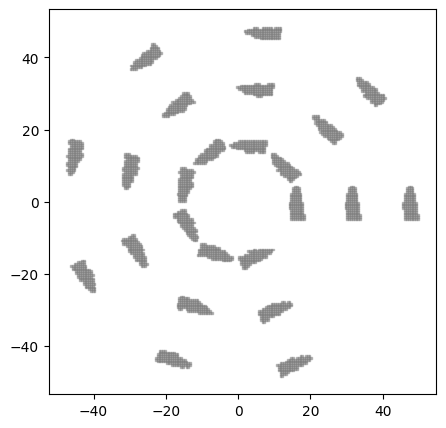

--------------------------------------------------
label: VentHole Chromosome_829: ['CircleShape_467', 'CircularStrictTransformation_647']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


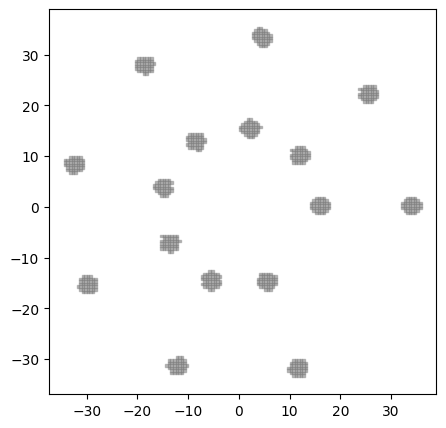

--------------------------------------------------
label: VentHole Chromosome_467: ['TrapezoidShape_258', 'CornerTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2266082422248252, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


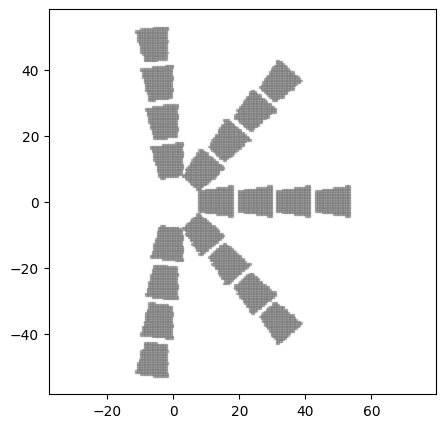

--------------------------------------------------
label: VentHole Chromosome_258: ['DonutShape_101', 'GridStrictTransformation_791']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


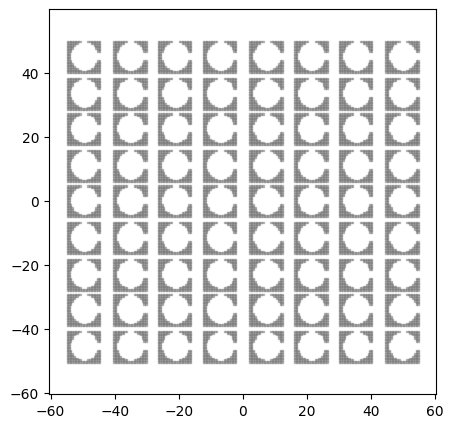

--------------------------------------------------
label: VentHole Chromosome_108: ['DonutShape_258', 'GridStrictTransformation_277']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 7.023365592404686, dy: 8.794727031067021, ]


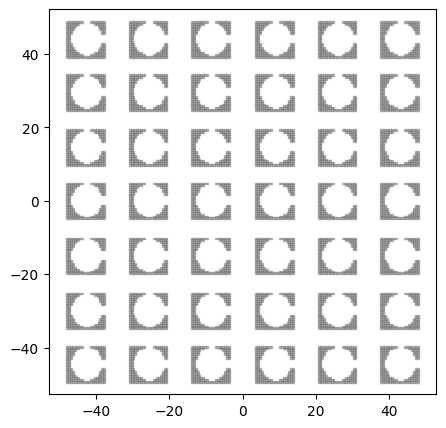

--------------------------------------------------
label: VentHole Chromosome_277: ['RayShape_961', 'CircularStrictTransformation_142']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


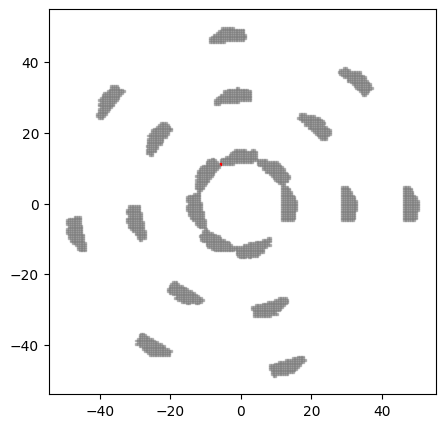

--------------------------------------------------
label: VentHole Chromosome_928: ['TriangleShape_251', 'CircularStrictTransformation_277']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


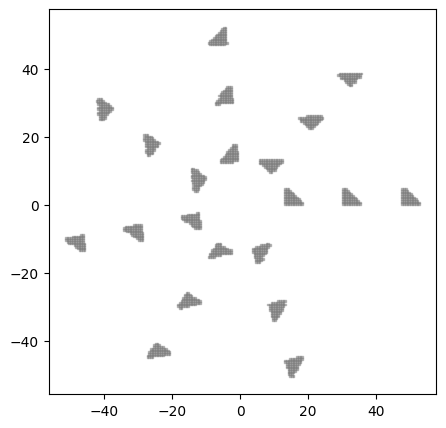

--------------------------------------------------
label: VentHole Chromosome_108: ['RayShape_839', 'CornerTransformation_929']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.8257282907256152, nose_point: 2.3585973878335977, lower_coefficient: 2.9990207161788933, lower_x-intercept: 3.5039730262192608, lower_y-intercept: 1.2711383997652552, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


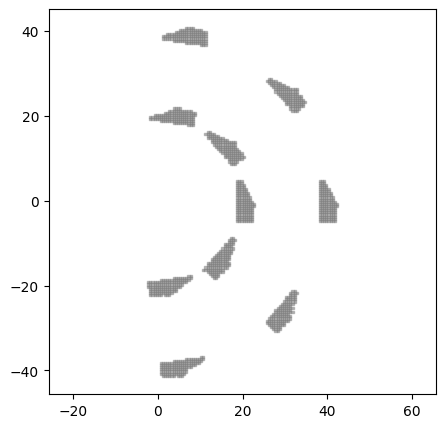

--------------------------------------------------
label: VentHole Chromosome_808: ['RayShape_108', 'CornerTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.8257282907256152, nose_point: 2.3585973878335977, lower_coefficient: 2.9990207161788933, lower_x-intercept: 3.5039730262192608, lower_y-intercept: 1.2711383997652552, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


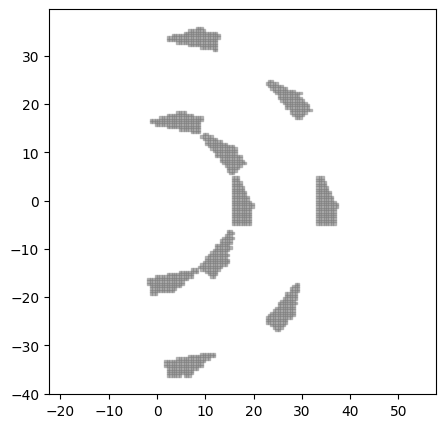

--------------------------------------------------
label: VentHole Chromosome_585: ['WingShape_600', 'GridStrictTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ dx: 5.127324192664817, dy: 4.484528829467593, ]


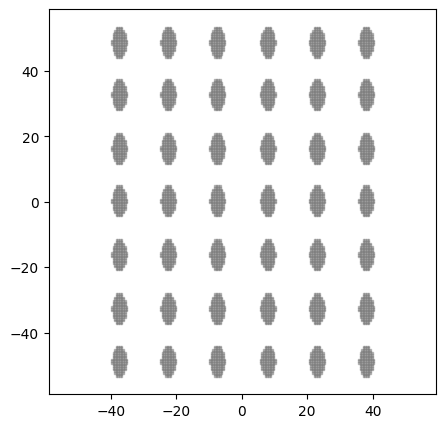

--------------------------------------------------
label: VentHole Chromosome_694: ['WingShape_285', 'GridStrictTransformation_585']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ dx: 5.127324192664817, dy: 4.484528829467593, ]


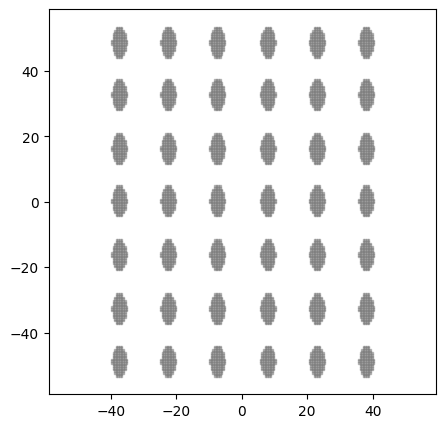

--------------------------------------------------
label: VentHole Chromosome_529: ['WingShape_694', 'CornerTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


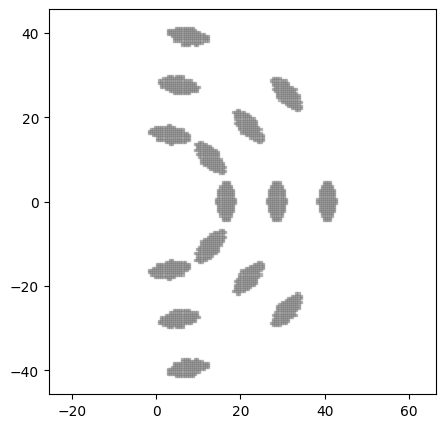

--------------------------------------------------
label: VentHole Chromosome_459: ['WingShape_961', 'CornerTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


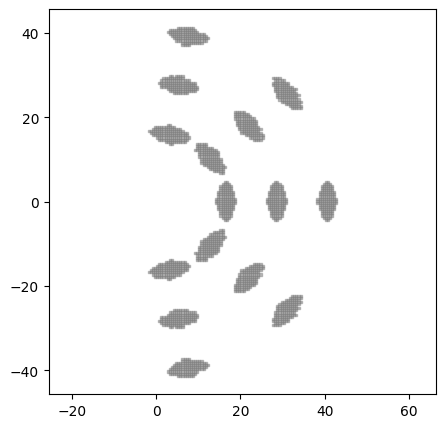

--------------------------------------------------
label: VentHole Chromosome_961: ['TriangleShape_836', 'GridStrictTransformation_898']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


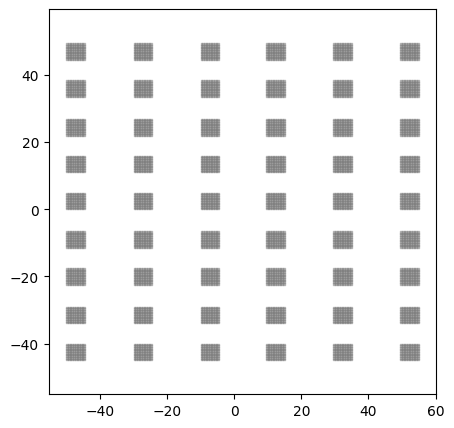

--------------------------------------------------
label: VentHole Chromosome_836: ['TriangleShape_961', 'GridStrictTransformation_772']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


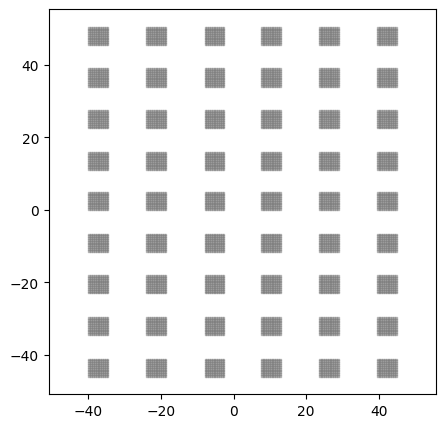

--------------------------------------------------
label: VentHole Chromosome_674: ['CircleShape_352', 'CircularStrictTransformation_576']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.9150283484613553, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


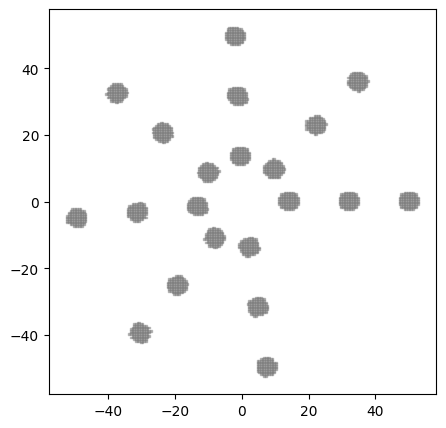

--------------------------------------------------
label: VentHole Chromosome_685: ['DonutShape_108', 'CircularStrictTransformation_674']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


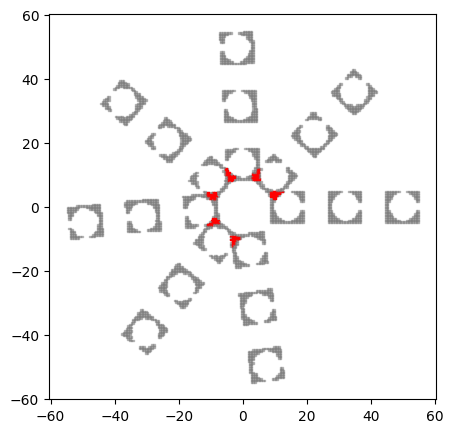

--------------------------------------------------
label: VentHole Chromosome_15: ['DonutShape_685', 'CircularStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


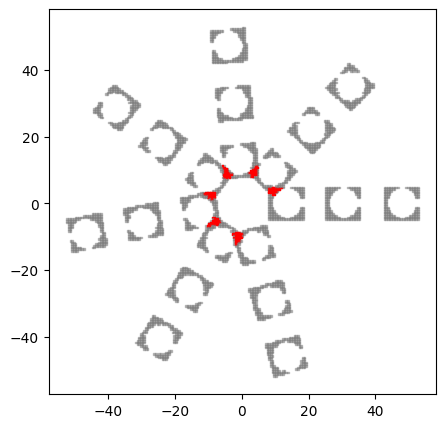

--------------------------------------------------
label: VentHole Chromosome_536: ['TriangleShape_855', 'CircularStrictTransformation_15']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.685329774968638, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


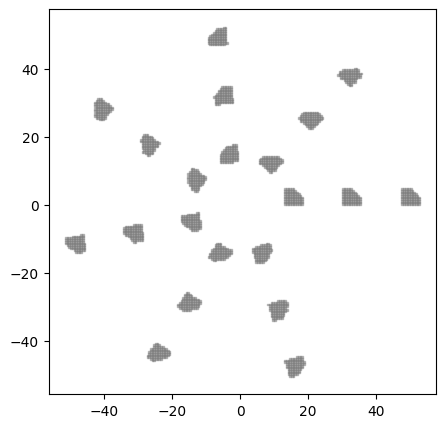

--------------------------------------------------
label: VentHole Chromosome_388: ['TriangleShape_536', 'GridStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.685329774968638, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


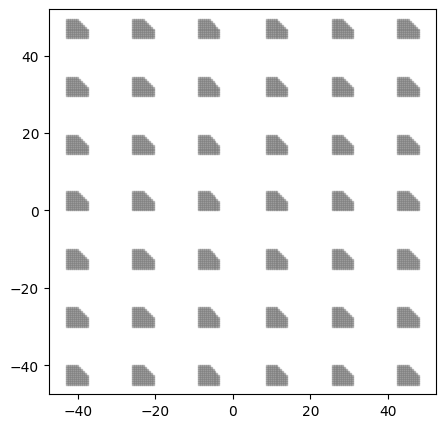

--------------------------------------------------
label: VentHole Chromosome_467: ['RayShape_872', 'CircularStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6559143436561357, nose_point: 1.227754993634589, lower_coefficient: 3.3595026999583957, lower_x-intercept: 1.4318805033924202, lower_y-intercept: 1.6110833899145065, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


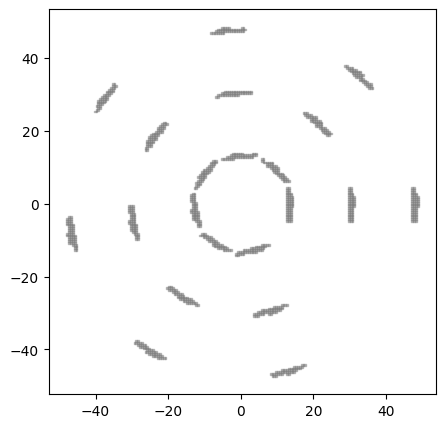

--------------------------------------------------
label: VentHole Chromosome_839: ['CircleShape_839', 'GridStrictTransformation_982']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.759517141611187, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


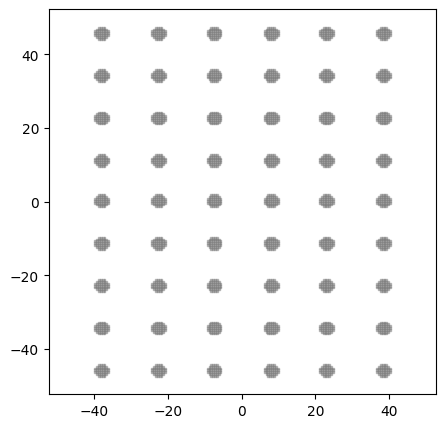

--------------------------------------------------
label: VentHole Chromosome_574: ['RayShape_783', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


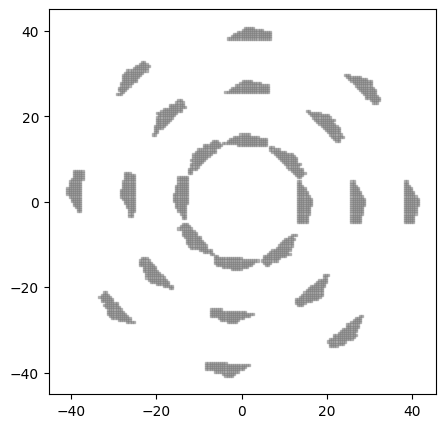

--------------------------------------------------
label: VentHole Chromosome_574: ['RayShape_791', 'CircularStrictTransformation_574']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


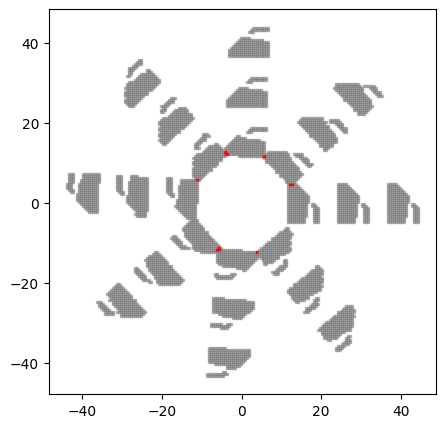

--------------------------------------------------
label: VentHole Chromosome_306: ['DonutShape_15', 'GridStrictTransformation_253']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


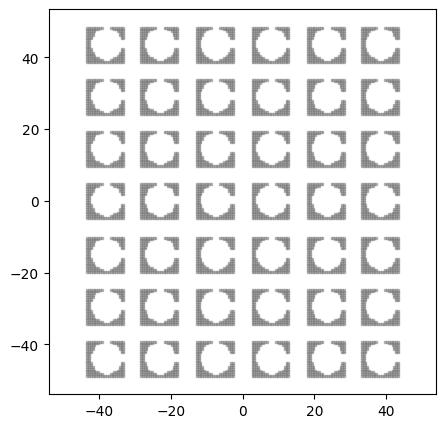

--------------------------------------------------
label: VentHole Chromosome_274: ['DonutShape_306', 'CircularStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


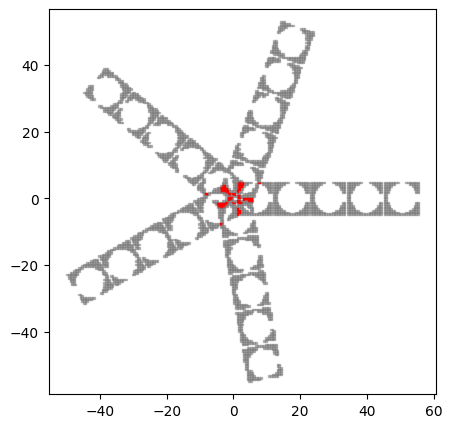

--------------------------------------------------
label: VentHole Chromosome_167: ['TriangleShape_167', 'CircularStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.781734802810038, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


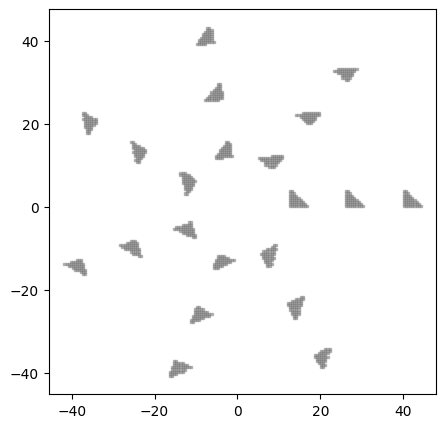

--------------------------------------------------
label: VentHole Chromosome_44: ['TriangleShape_67', 'CornerTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.338635932295716, phi: 0.5326911441693254, rot_count: 4.0, ]


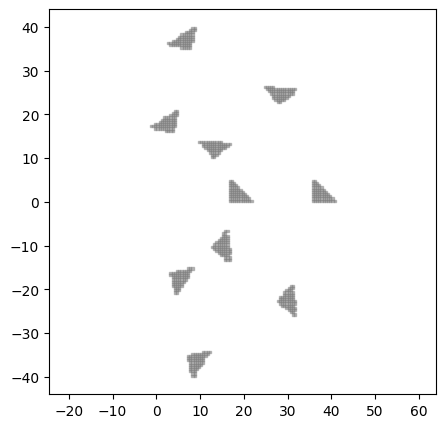

--------------------------------------------------
label: VentHole Chromosome_363: ['HoleShape_723', 'CornerTransformation_44']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.365803290777451, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.338635932295716, phi: 0.5326911441693254, rot_count: 4.0, ]


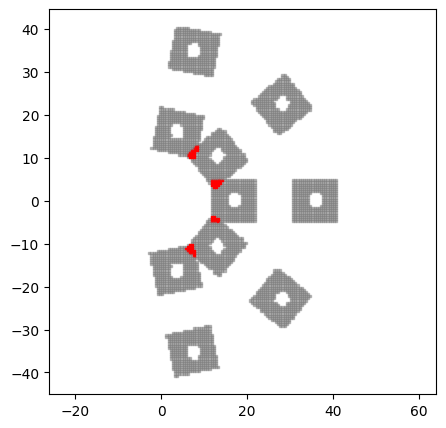

--------------------------------------------------
label: VentHole Chromosome_872: ['HoleShape_363', 'GridStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.365803290777451, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 6.850813481976112, ]


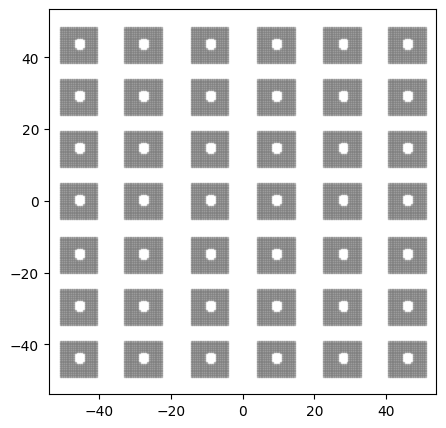

--------------------------------------------------
label: VentHole Chromosome_388: ['TrapezoidShape_42', 'GridStrictTransformation_872']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.808328061181311, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 6.850813481976112, ]


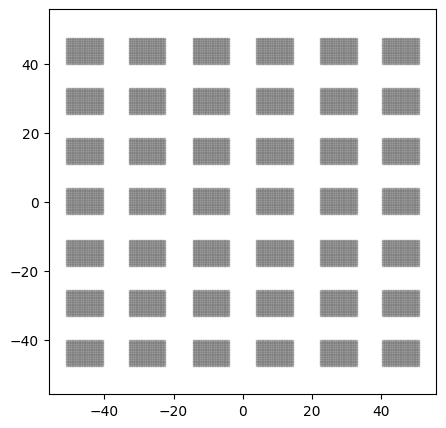

--------------------------------------------------
label: VentHole Chromosome_258: ['WingShape_191', 'CircularStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 14.356906849561378, dx: 9.832462236362868, phi: 0.6981317007977318, ]


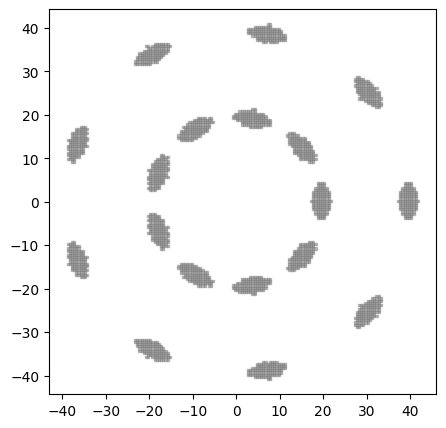

--------------------------------------------------
label: VentHole Chromosome_751: ['TrapezoidShape_991', 'CircularStrictTransformation_463']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


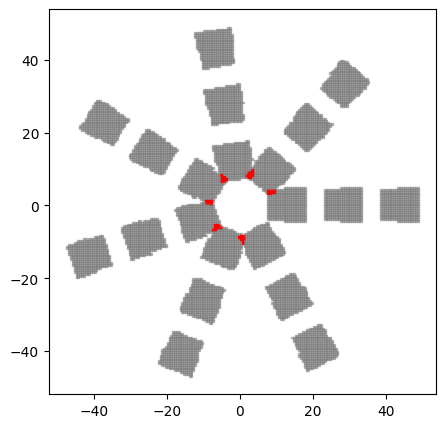

--------------------------------------------------
label: VentHole Chromosome_304: ['TrapezoidShape_751', 'CircularStrictTransformation_82']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


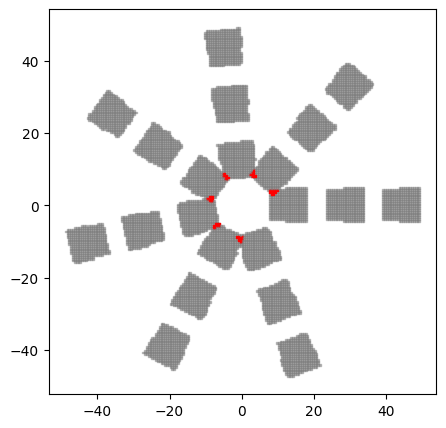

--------------------------------------------------
label: VentHole Chromosome_808: ['TrapezoidShape_415', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.9903946904461765, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


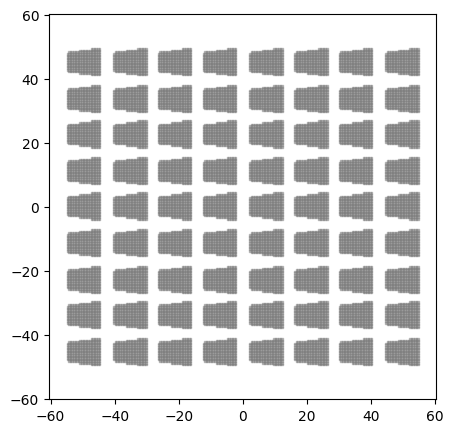

--------------------------------------------------
label: VentHole Chromosome_258: ['RayShape_574', 'GridStrictTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


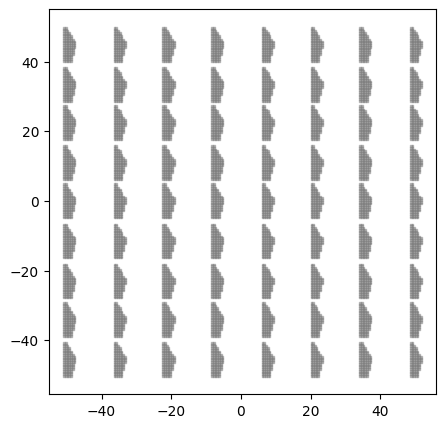

--------------------------------------------------
label: VentHole Chromosome_420: ['RayShape_109', 'CircularStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


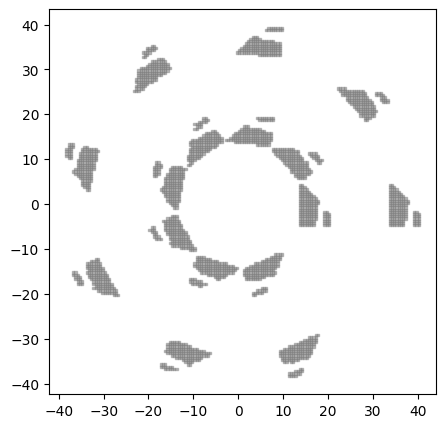

--------------------------------------------------
label: VentHole Chromosome_668: ['RayShape_420', 'GridStrictTransformation_758']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 8.805609626836397, dy: 4.999594967018924, ]


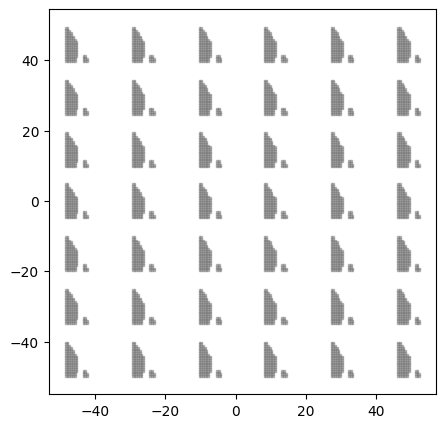

--------------------------------------------------
label: VentHole Chromosome_758: ['TrapezoidShape_723', 'GridStrictTransformation_668']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ dx: 8.805609626836397, dy: 4.999594967018924, ]


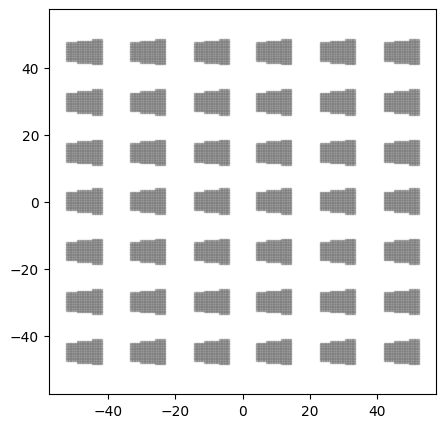

--------------------------------------------------
label: VentHole Chromosome_467: ['TrapezoidShape_758', 'GridStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ dx: 8.473360805396354, dy: 4.999594967018924, ]


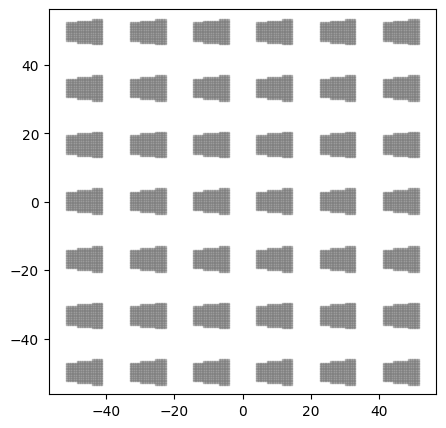

--------------------------------------------------
label: VentHole Chromosome_109: ['RayShape_668', 'CircularStrictTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


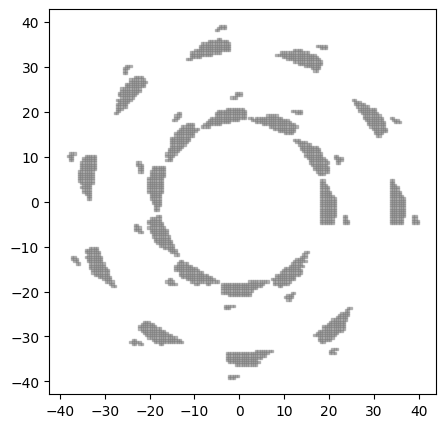

--------------------------------------------------
label: VentHole Chromosome_849: ['RayShape_824', 'CircularStrictTransformation_109']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 5.556587748578083, phi: 0.5235987755982988, ]


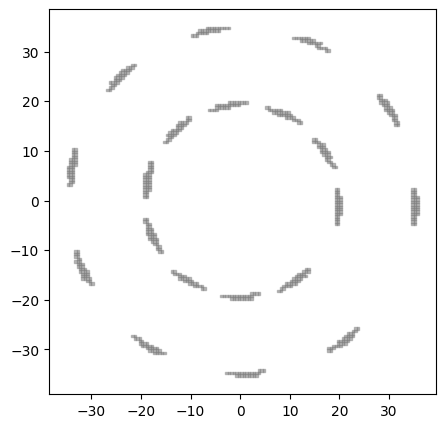

--------------------------------------------------
label: VentHole Chromosome_955: ['WingShape_164', 'CircularStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


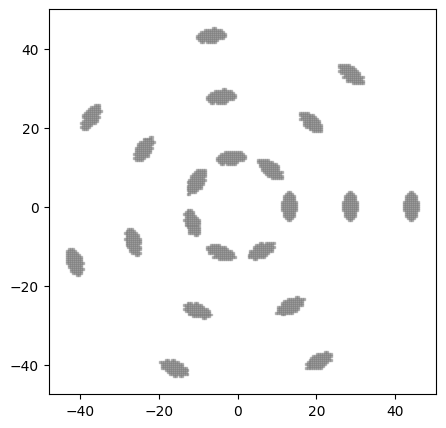

--------------------------------------------------
label: VentHole Chromosome_659: ['TrapezoidShape_823', 'CircularStrictTransformation_105']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


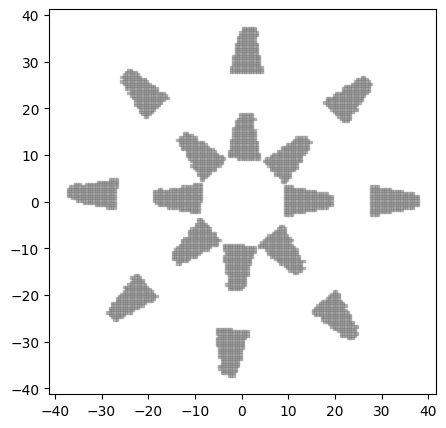

--------------------------------------------------
label: VentHole Chromosome_487: ['TrapezoidShape_659', 'CircularStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


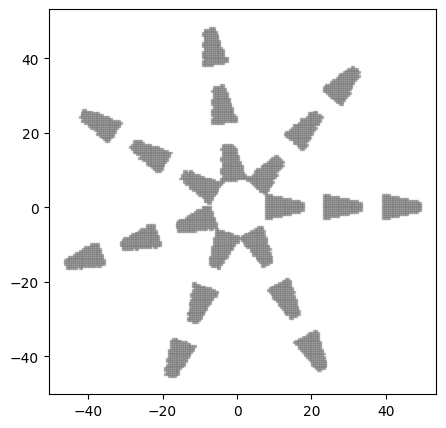

--------------------------------------------------
label: VentHole Chromosome_173: ['RayShape_258', 'CornerTransformation_398']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


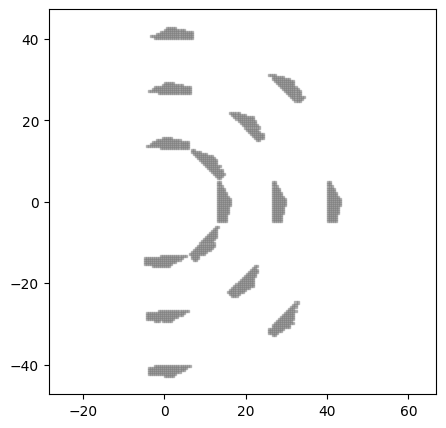

--------------------------------------------------
label: VentHole Chromosome_548: ['TrapezoidShape_766', 'CornerTransformation_173']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


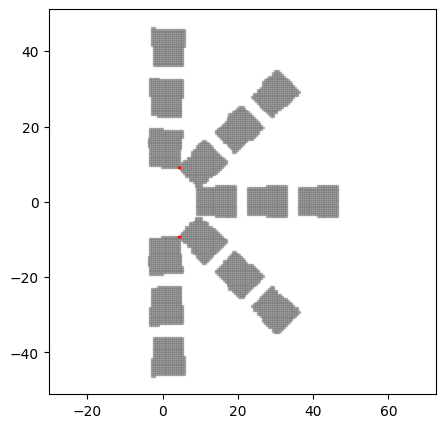

--------------------------------------------------
label: VentHole Chromosome_898: ['DoubleParabolicShape_82', 'GridStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


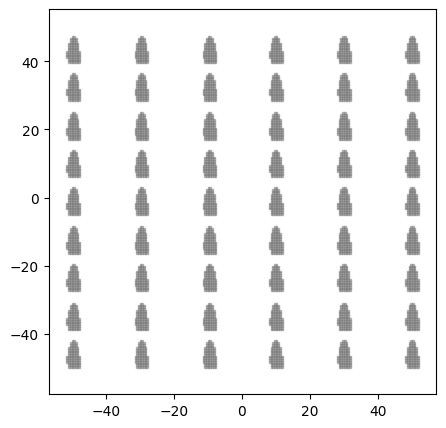

--------------------------------------------------
label: VentHole Chromosome_823: ['DoubleParabolicShape_898', 'GridStrictTransformation_96']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


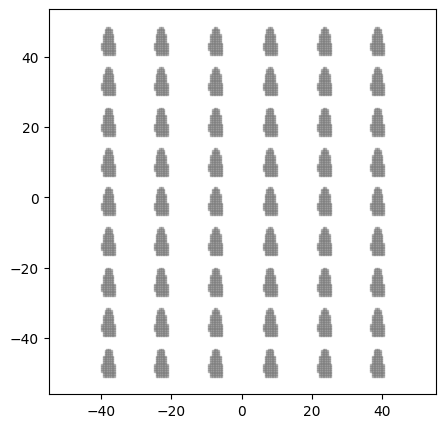

--------------------------------------------------
label: VentHole Chromosome_529: ['TrapezoidShape_886', 'GridStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


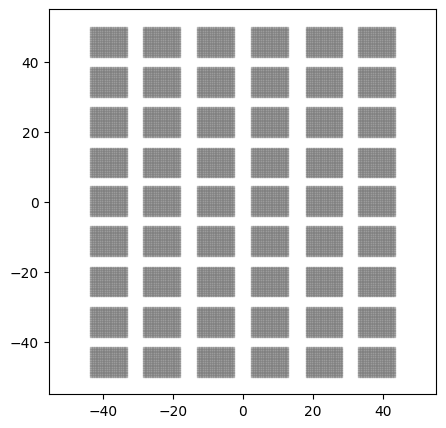

--------------------------------------------------
label: VentHole Chromosome_126: ['DonutShape_274', 'CornerTransformation_277']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 1.816438586966198, phi: 0.4785459301078606, rot_count: 6.0, ]


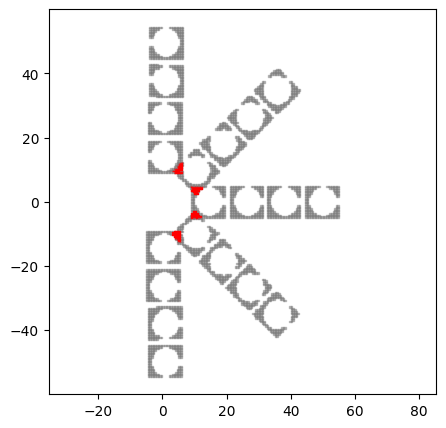

--------------------------------------------------
label: VentHole Chromosome_15: ['DonutShape_126', 'CircularStrictTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 2.3176269767576296, phi: 0.41887902047863906, ]


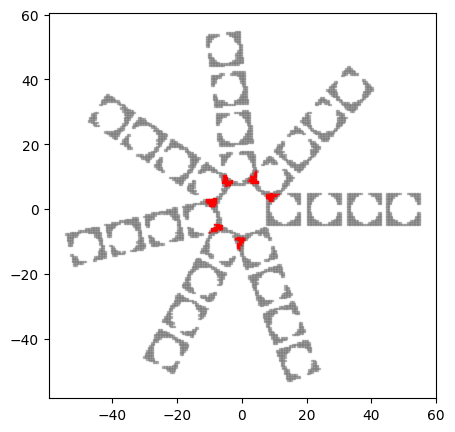

--------------------------------------------------
label: VentHole Chromosome_948: ['HoleShape_57', 'CornerTransformation_432']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


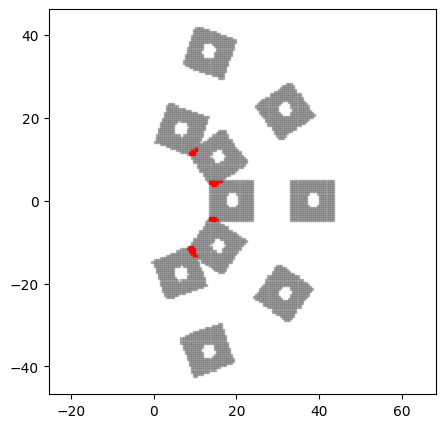

--------------------------------------------------
label: VentHole Chromosome_258: ['TriangleShape_24', 'CornerTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


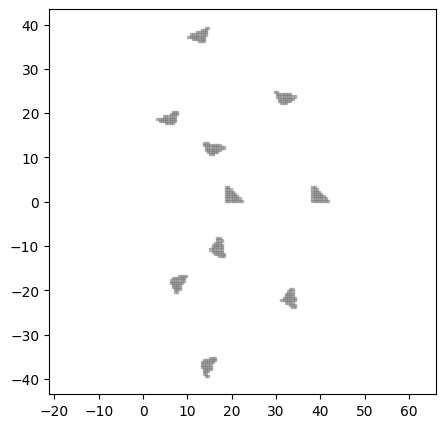

--------------------------------------------------
label: VentHole Chromosome_388: ['TriangleShape_258', 'CircularStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


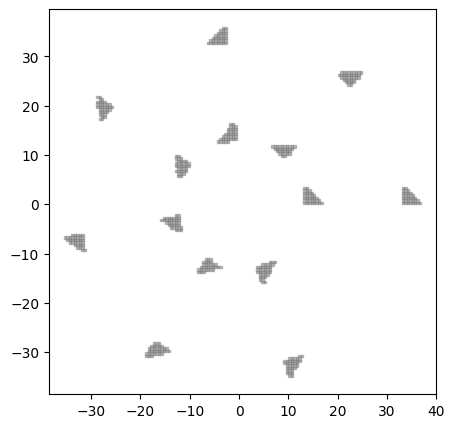

--------------------------------------------------
label: VentHole Chromosome_403: ['DoubleParabolicShape_536', 'CircularStrictTransformation_487']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.3912597872446593, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


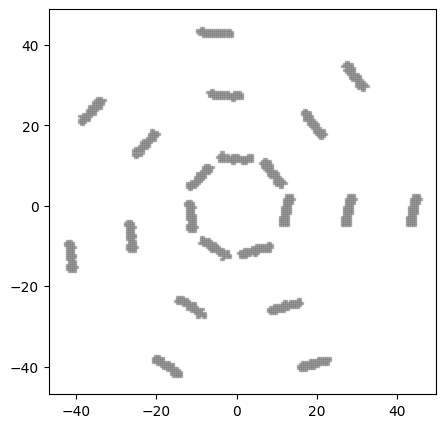

--------------------------------------------------
label: VentHole Chromosome_606: ['HoleShape_576', 'CircularStrictTransformation_659']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


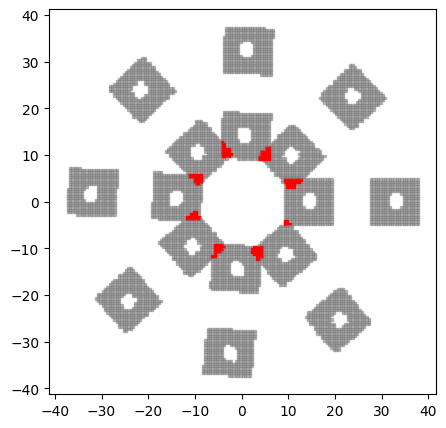

--------------------------------------------------
label: VentHole Chromosome_659: ['WingShape_955', 'CornerTransformation_916']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


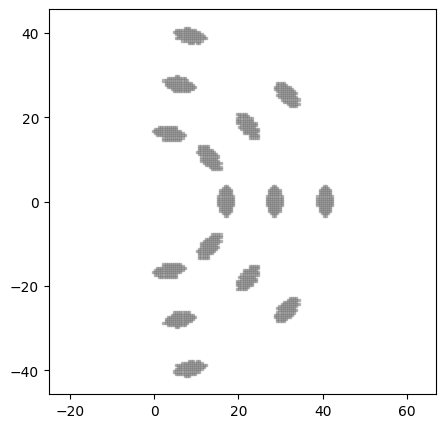

--------------------------------------------------
label: VentHole Chromosome_89: ['RayShape_808', 'CornerTransformation_514']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.8257282907256152, nose_point: 2.3585973878335977, lower_coefficient: 2.9990207161788933, lower_x-intercept: 3.5039730262192608, lower_y-intercept: 1.2711383997652552, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.7422463986582669, rot_count: 6.0, ]


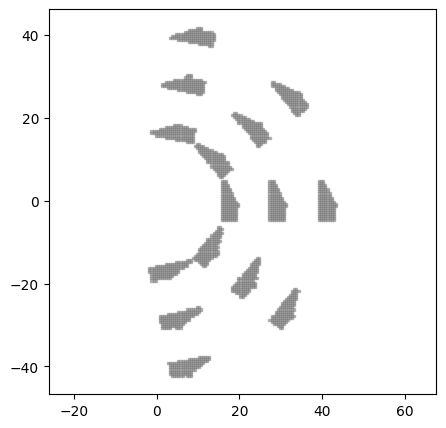

--------------------------------------------------
label: VentHole Chromosome_16: ['CircleShape_529', 'GridStrictTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


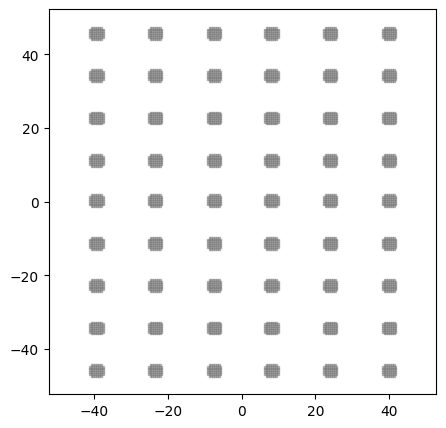

--------------------------------------------------
label: VentHole Chromosome_355: ['TrapezoidShape_346', 'GridStrictTransformation_16']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


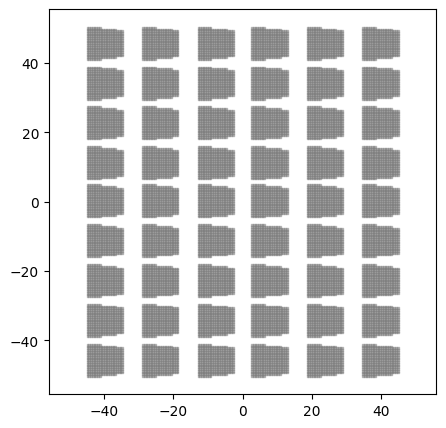

--------------------------------------------------
label: VentHole Chromosome_961: ['RayShape_134', 'CornerTransformation_979']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


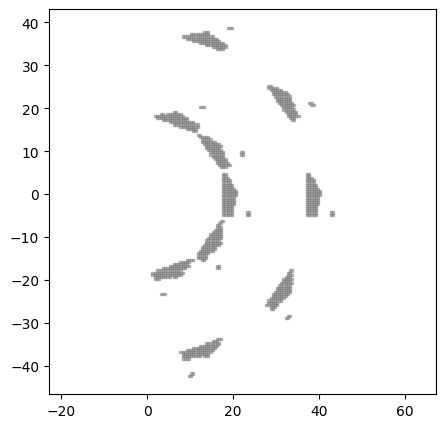

--------------------------------------------------
label: VentHole Chromosome_474: ['CircleShape_529', 'CornerTransformation_126']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 1.816438586966198, phi: 0.4785459301078606, rot_count: 6.0, ]


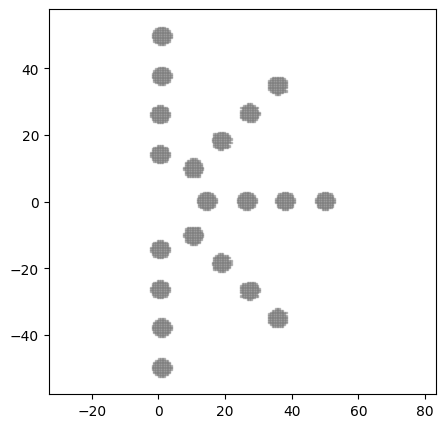

--------------------------------------------------
label: VentHole Chromosome_264: ['RayShape_277', 'GridStrictTransformation_898']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


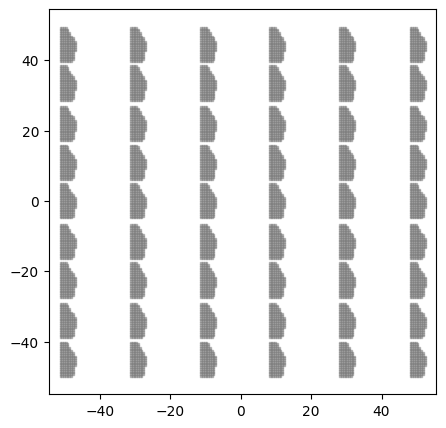

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_264', 'CornerTransformation_576']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


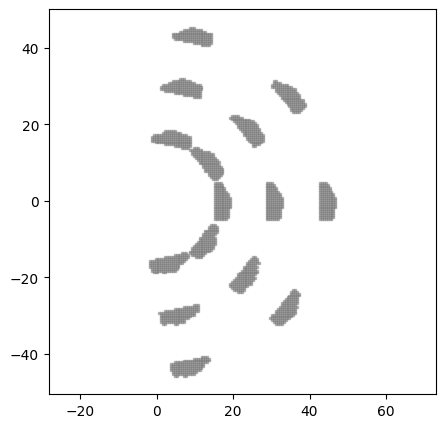

--------------------------------------------------
label: VentHole Chromosome_10: ['DoubleParabolicShape_783', 'CornerTransformation_872']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.4175014634953778, upper_coefficient: 1.5834992903871752, lower_y-intercept: 1.6554269175941352, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 1.3339051227738343, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 2.79176786166162, phi: 0.4098912790616371, rot_count: 3.0, ]


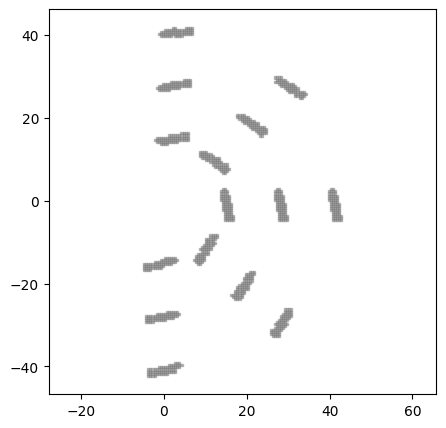

--------------------------------------------------
label: VentHole Chromosome_694: ['RayShape_556', 'GridStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


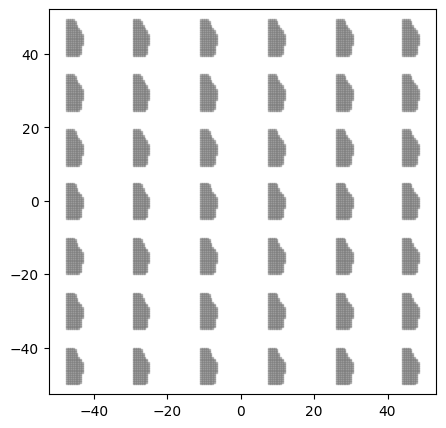

--------------------------------------------------
label: VentHole Chromosome_298: ['HoleShape_948', 'GridStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


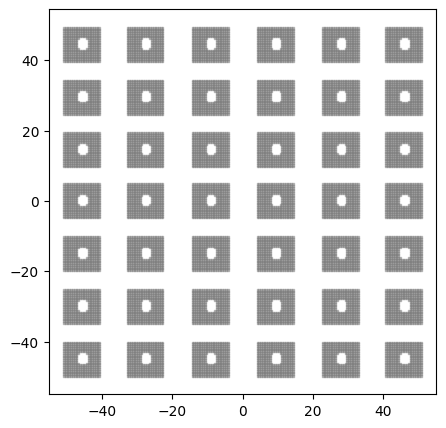

--------------------------------------------------
label: VentHole Chromosome_329: ['DonutShape_251', 'CircularStrictTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


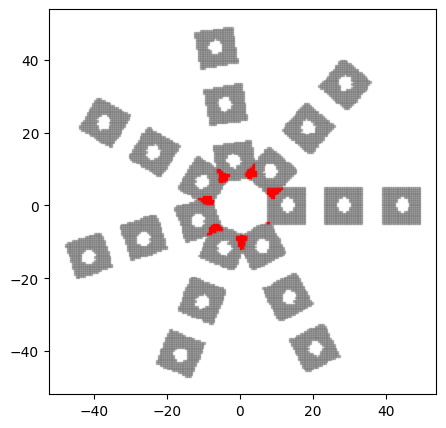

--------------------------------------------------
label: VentHole Chromosome_488: ['WingShape_438', 'CornerTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


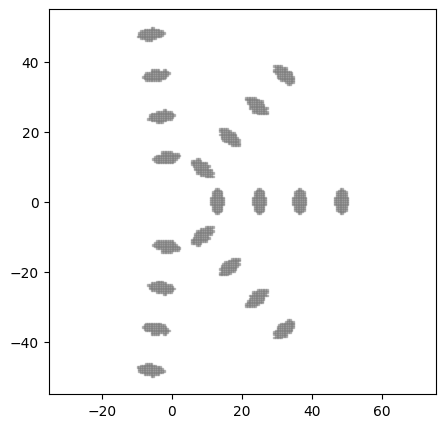

--------------------------------------------------
label: VentHole Chromosome_458: ['TrapezoidShape_487', 'GridStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 6.624524664029363, dy: 6.850813481976112, ]


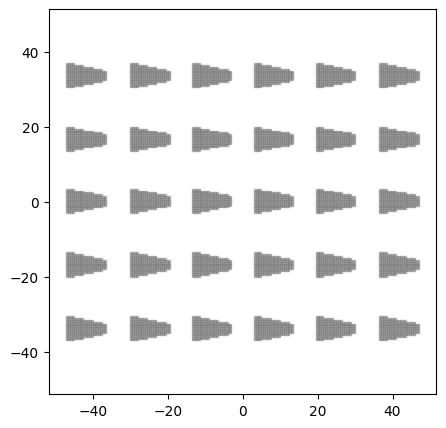

--------------------------------------------------
label: VentHole Chromosome_536: ['TrapezoidShape_458', 'GridStrictTransformation_333']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 7.023365592404686, dy: 1.3940027386743572, ]


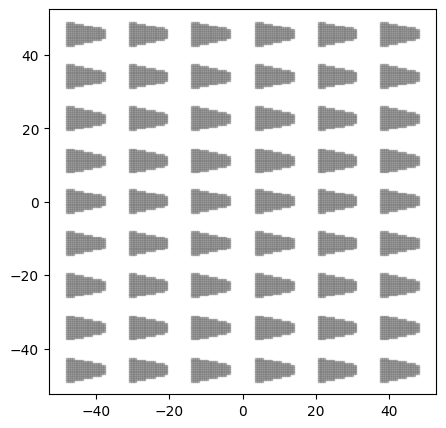

--------------------------------------------------
label: VentHole Chromosome_489: ['HoleShape_285', 'GridStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ dx: 7.023365592404686, dy: 1.3940027386743572, ]


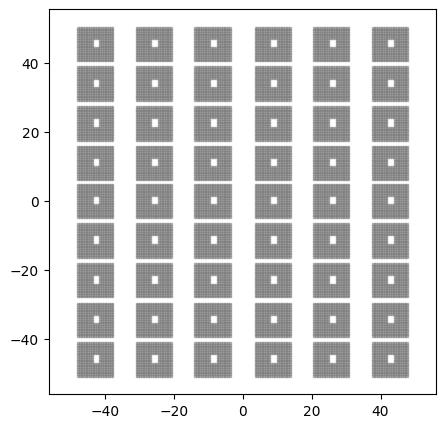

--------------------------------------------------
label: VentHole Chromosome_181: ['HoleShape_489', 'CircularStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


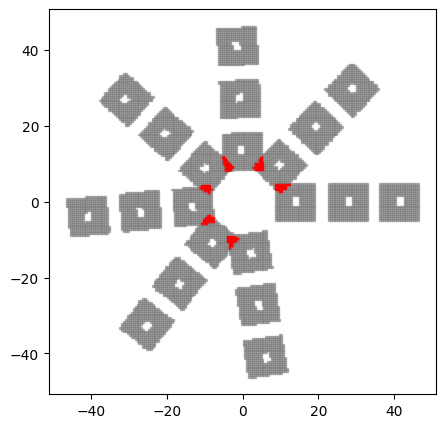

--------------------------------------------------
label: VentHole Chromosome_467: ['CircleShape_829', 'GridStrictTransformation_613']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


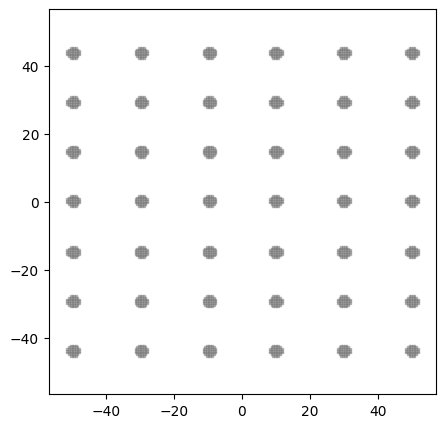

--------------------------------------------------
label: VentHole Chromosome_438: ['RayShape_961', 'GridStrictTransformation_355']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


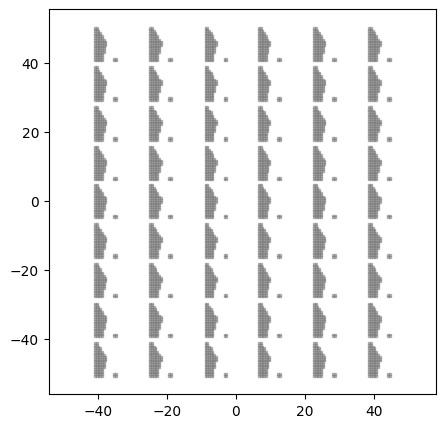

--------------------------------------------------
label: VentHole Chromosome_413: ['DonutShape_948', 'GridStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


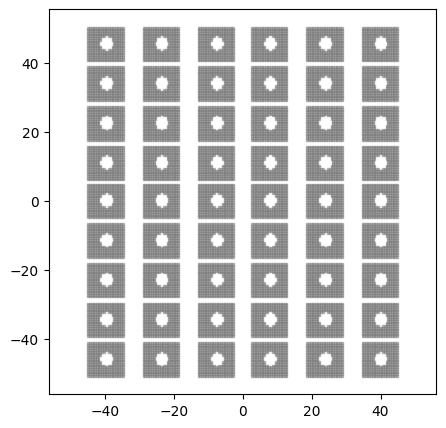

--------------------------------------------------
label: VentHole Chromosome_413: ['DonutShape_413', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


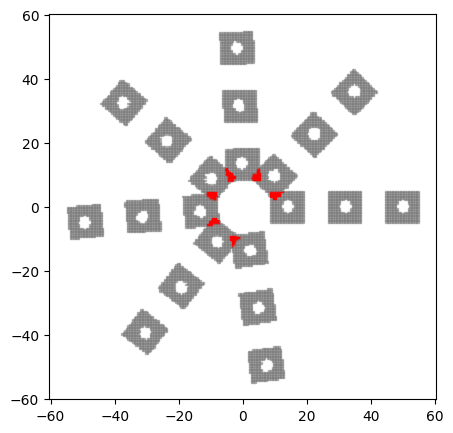

--------------------------------------------------
label: VentHole Chromosome_363: ['RayShape_205', 'GridStrictTransformation_57']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.2264955141522853, lower_coefficient: 1.07850249948789, lower_x-intercept: 1.4422524380283435, lower_y-intercept: 1.2308035626130915, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.999594967018924, ]


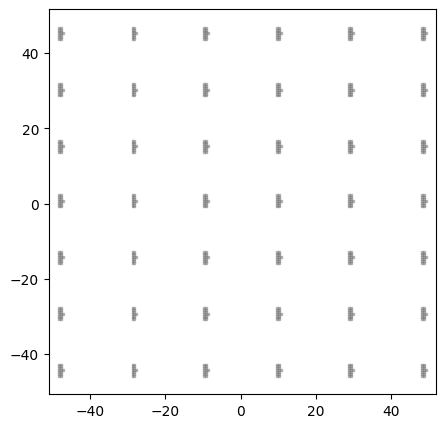

--------------------------------------------------
label: VentHole Chromosome_74: ['TrapezoidShape_751', 'GridStrictTransformation_306']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.625347881243773, ]


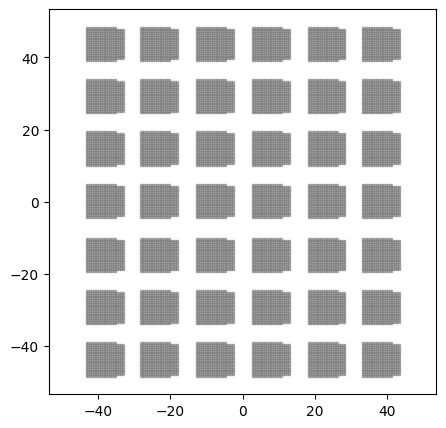

--------------------------------------------------
label: VentHole Chromosome_366: ['DonutShape_304', 'GridStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 6.850813481976112, ]


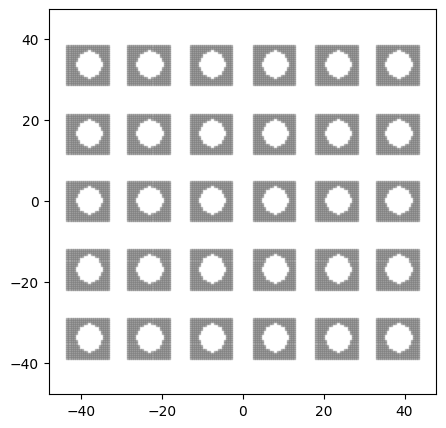

--------------------------------------------------
label: VentHole Chromosome_300: ['DoubleParabolicShape_783', 'CircularStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


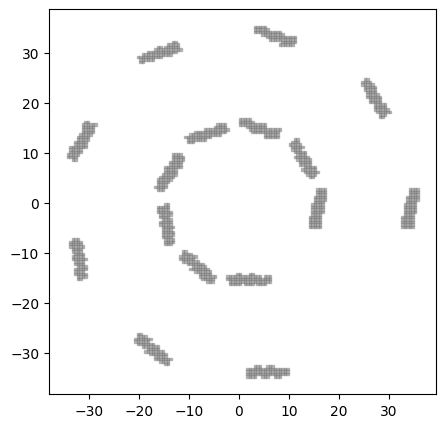

--------------------------------------------------
label: VentHole Chromosome_783: ['HoleShape_839', 'GridStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.295188182743882, ]
pattern parameter:
parameter_list: [ dx: 8.149986214070697, dy: 6.794986250436445, ]


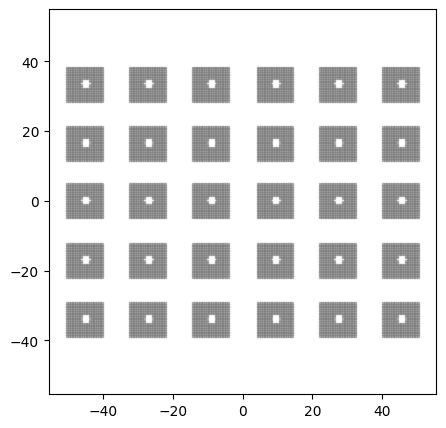

--------------------------------------------------
label: VentHole Chromosome_749: ['TrapezoidShape_285', 'CornerTransformation_730']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.045318289883957, k2: 1.907833174810472, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


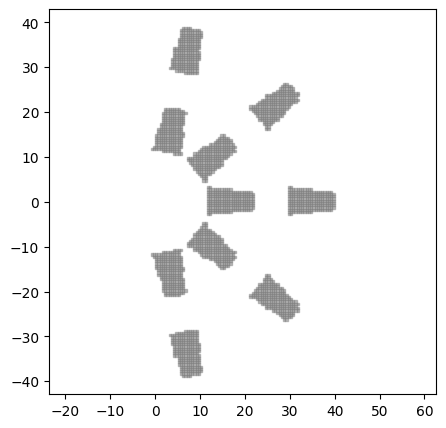

--------------------------------------------------
label: VentHole Chromosome_285: ['TrapezoidShape_749', 'GridStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.045318289883957, k2: 1.907833174810472, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


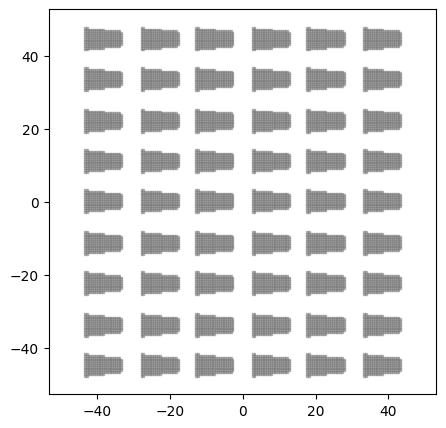

--------------------------------------------------
label: VentHole Chromosome_548: ['DonutShape_164', 'CircularStrictTransformation_191']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.30142999997884, r_outer: 7.879177221925768, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 3.9142584353847534, phi: 0.4487989505128276, ]


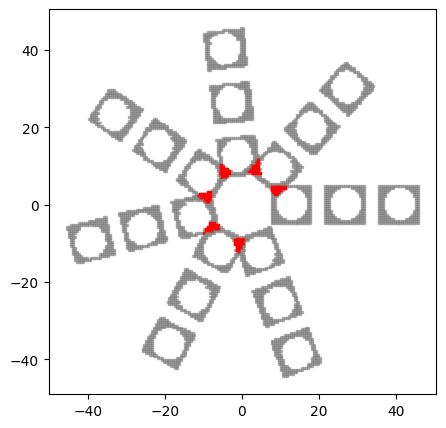

--------------------------------------------------
label: VentHole Chromosome_191: ['TrapezoidShape_614', 'CircularStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 3.9142584353847534, phi: 0.4487989505128276, ]


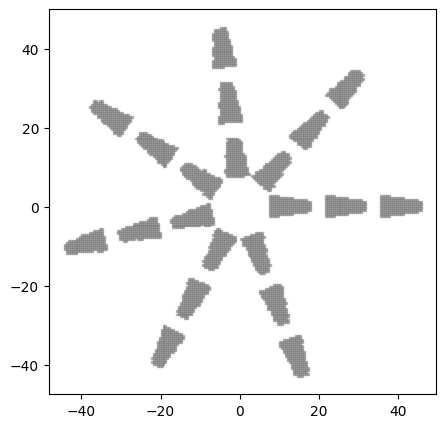

--------------------------------------------------
label: VentHole Chromosome_614: ['TrapezoidShape_191', 'CornerTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


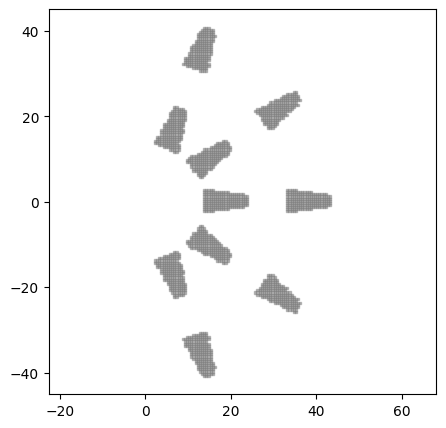

--------------------------------------------------
label: VentHole Chromosome_122: ['RayShape_173', 'GridStrictTransformation_432']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.502880628557838, dy: 1.3940027386743572, ]


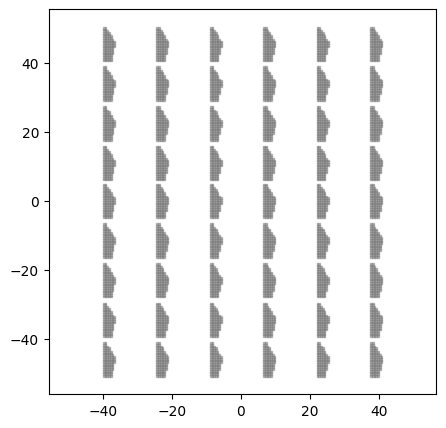

--------------------------------------------------
label: VentHole Chromosome_432: ['TriangleShape_836', 'GridStrictTransformation_122']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 5.502880628557838, dy: 1.3940027386743572, ]


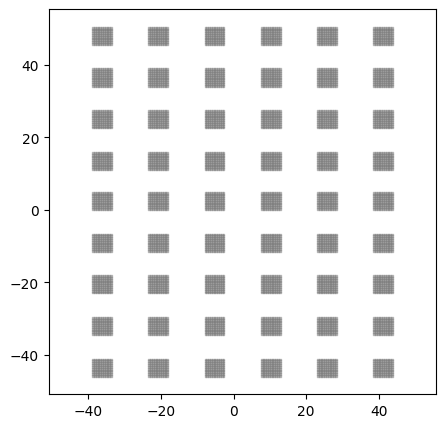

--------------------------------------------------
label: VentHole Chromosome_167: ['TriangleShape_616', 'CircularStrictTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


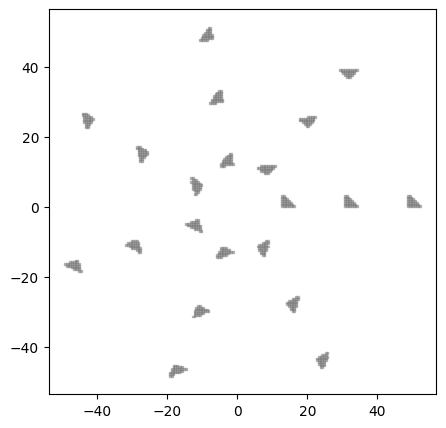

--------------------------------------------------
label: VentHole Chromosome_366: ['HoleShape_298', 'GridStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 6.850813481976112, ]


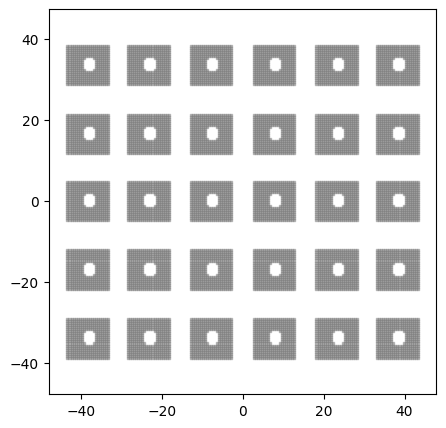

--------------------------------------------------
label: VentHole Chromosome_740: ['TriangleShape_44', 'GridStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


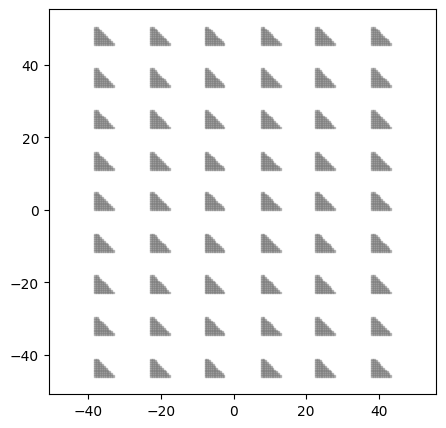

--------------------------------------------------
label: VentHole Chromosome_67: ['DonutShape_413', 'CircularStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


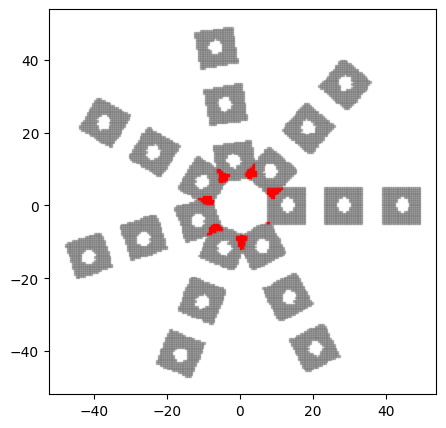

--------------------------------------------------
label: VentHole Chromosome_243: ['DonutShape_67', 'CornerTransformation_89']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.7422463986582669, rot_count: 6.0, ]


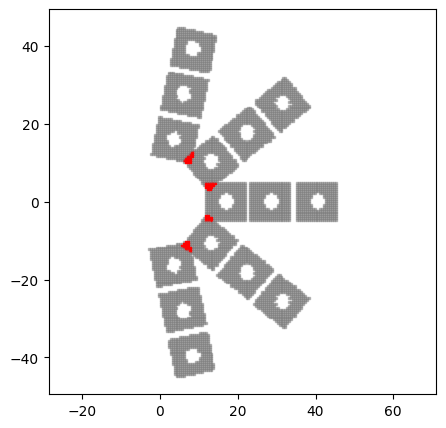

--------------------------------------------------
label: VentHole Chromosome_363: ['HoleShape_366', 'CornerTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 13.452218671446346, dx: 3.4664540289461003, phi: 0.7422463986582669, rot_count: 6.0, ]


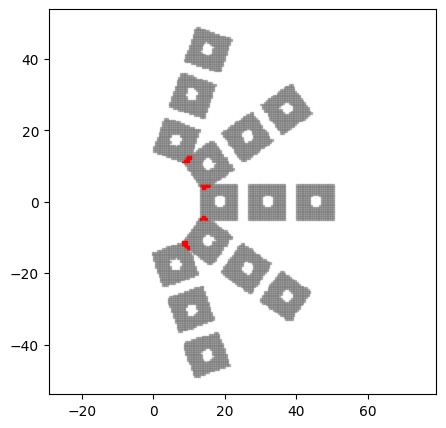

--------------------------------------------------
label: VentHole Chromosome_886: ['DonutShape_15', 'CircularStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 9.90251222160351, phi: 0.5235987755982988, ]


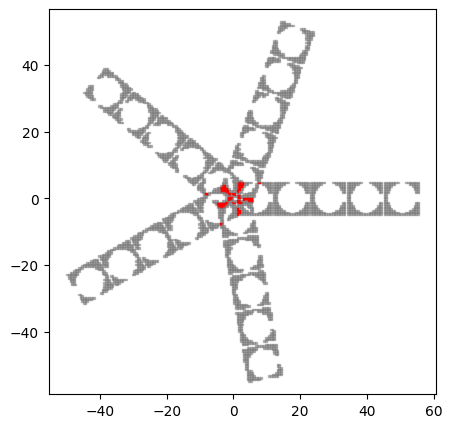

--------------------------------------------------
label: VentHole Chromosome_366: ['WingShape_488', 'CornerTransformation_261']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 3.0, ]


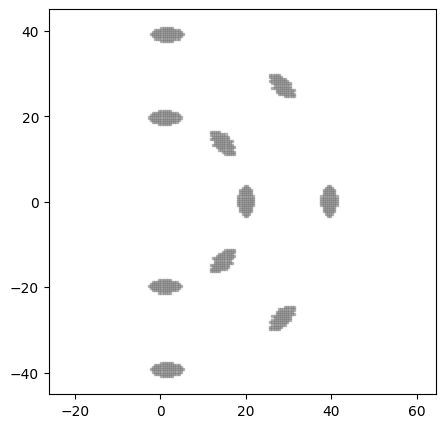

--------------------------------------------------
label: VentHole Chromosome_261: ['RayShape_258', 'CornerTransformation_614']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


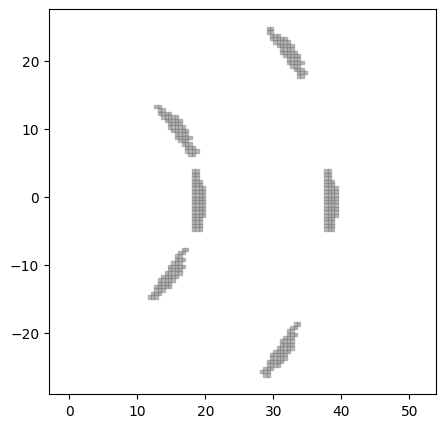

--------------------------------------------------
label: VentHole Chromosome_413: ['TriangleShape_928', 'CornerTransformation_261']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


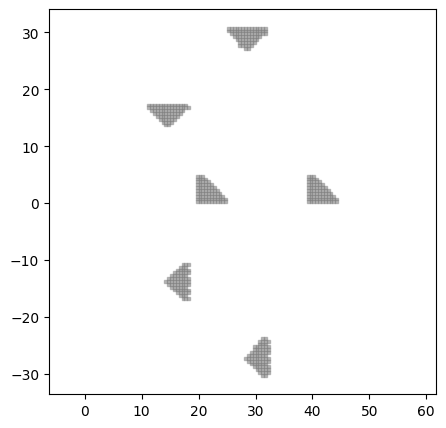

--------------------------------------------------
label: VentHole Chromosome_403: ['DoubleParabolicShape_706', 'CornerTransformation_413']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


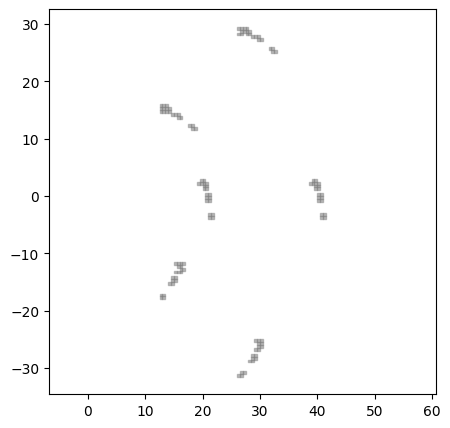

--------------------------------------------------
label: VentHole Chromosome_706: ['TriangleShape_975', 'GridStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


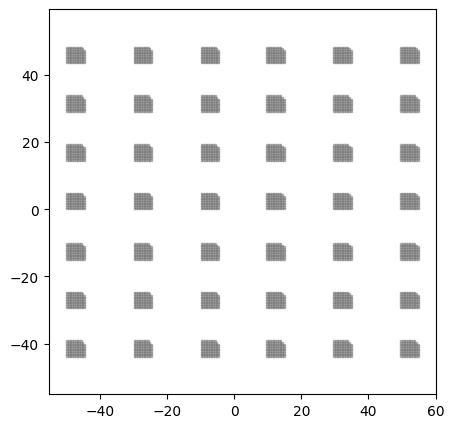

--------------------------------------------------
label: VentHole Chromosome_33: ['TriangleShape_706', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


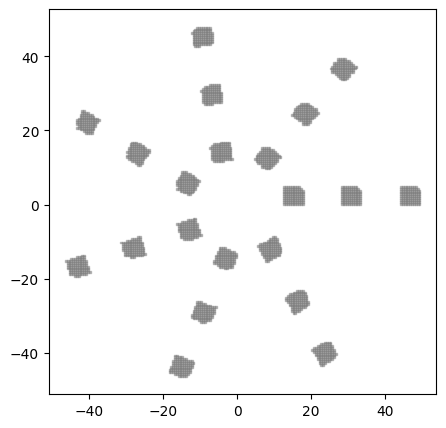

--------------------------------------------------
label: VentHole Chromosome_692: ['HoleShape_692', 'CircularStrictTransformation_413']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


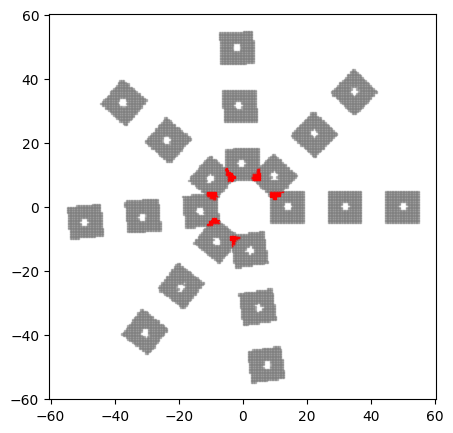

--------------------------------------------------
label: VentHole Chromosome_692: ['HoleShape_889', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


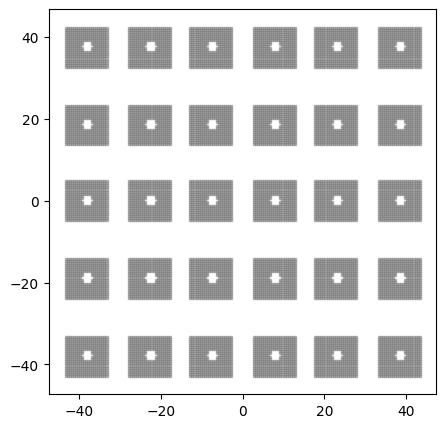

--------------------------------------------------
label: VentHole Chromosome_458: ['CircleShape_458', 'GridStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.0201124017242, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


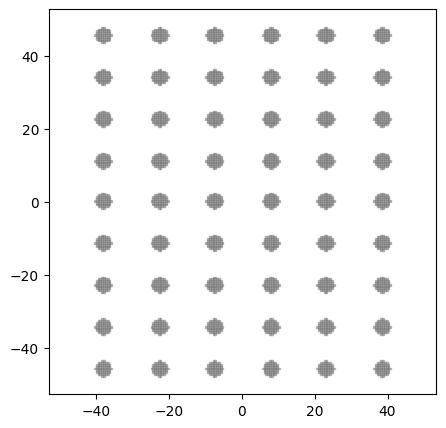

--------------------------------------------------
label: VentHole Chromosome_920: ['CircleShape_474', 'CornerTransformation_67']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 8.61704047528884, phi: 0.5326911441693254, rot_count: 4.0, ]


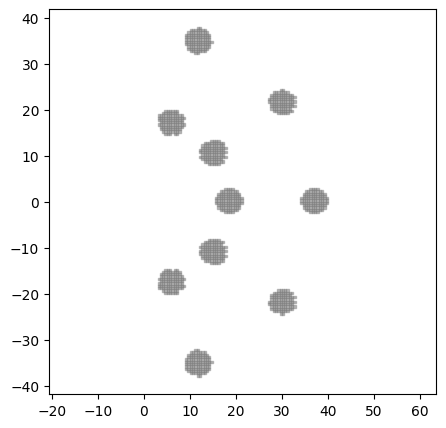

--------------------------------------------------
label: VentHole Chromosome_67: ['TrapezoidShape_304', 'CornerTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


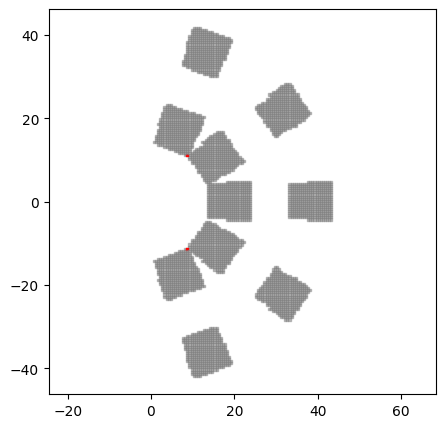

--------------------------------------------------
label: VentHole Chromosome_367: ['DoubleParabolicShape_723', 'CornerTransformation_67']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.7829859327241708, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


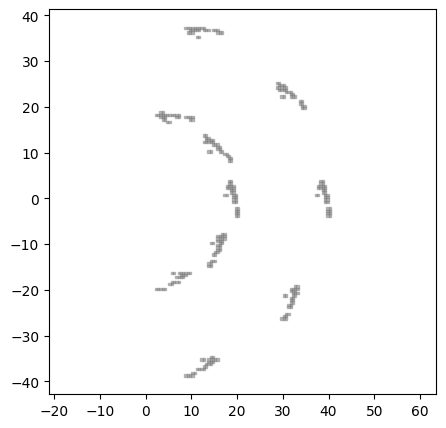

--------------------------------------------------
label: VentHole Chromosome_723: ['DonutShape_366', 'CircularStrictTransformation_420']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.6283185307179586, ]


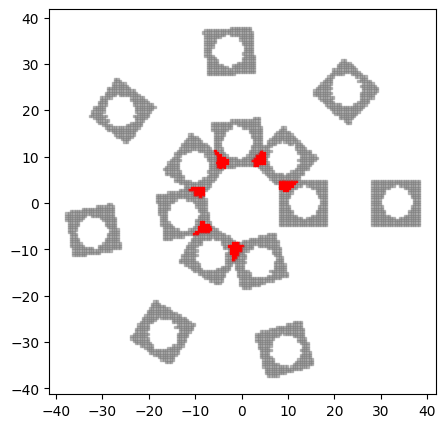

--------------------------------------------------
label: VentHole Chromosome_948: ['DonutShape_723', 'GridStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


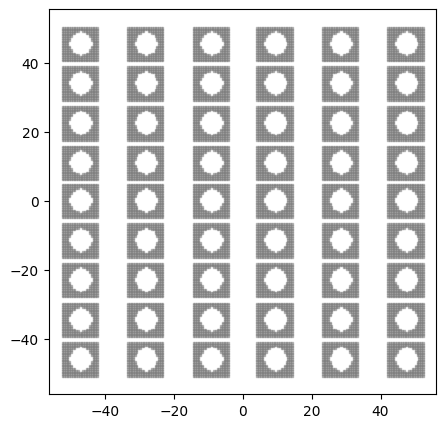

--------------------------------------------------
label: VentHole Chromosome_878: ['TriangleShape_167', 'GridStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


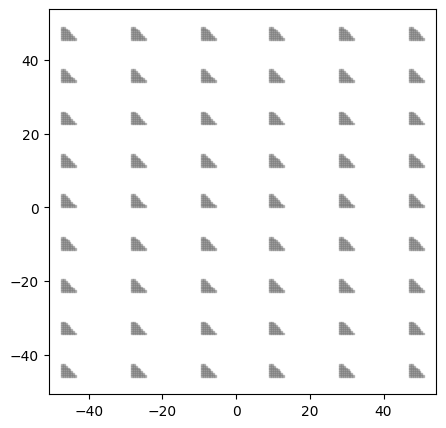

--------------------------------------------------
label: VentHole Chromosome_282: ['DonutShape_955', 'CircularStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.19970997842427, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 3.9142584353847534, phi: 0.4487989505128276, ]


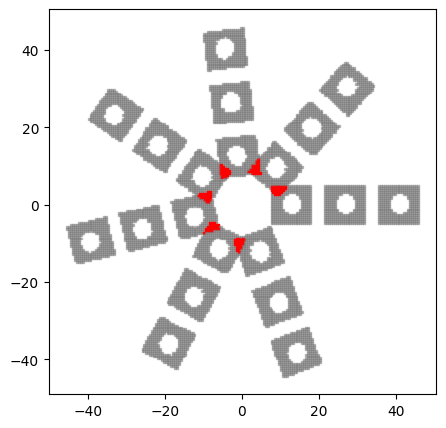

--------------------------------------------------
label: VentHole Chromosome_529: ['DonutShape_282', 'CornerTransformation_633']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.19970997842427, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 8.745123640700152, phi: 0.7678887097189364, rot_count: 6.0, ]


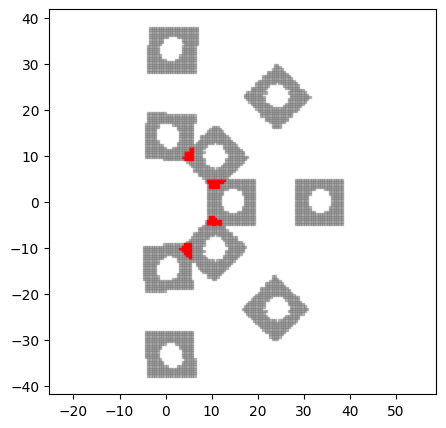

--------------------------------------------------
label: VentHole Chromosome_751: ['DoubleParabolicShape_751', 'CornerTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.1506227339525932, upper_y-intercept_from_lower_y: 1.6496962443104994, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


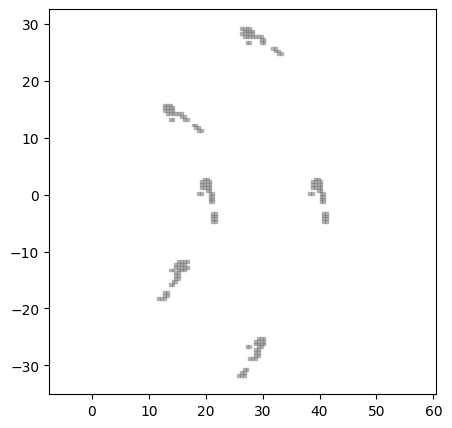

--------------------------------------------------
label: VentHole Chromosome_205: ['DonutShape_878', 'GridStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 8.473360805396354, dy: 4.999594967018924, ]


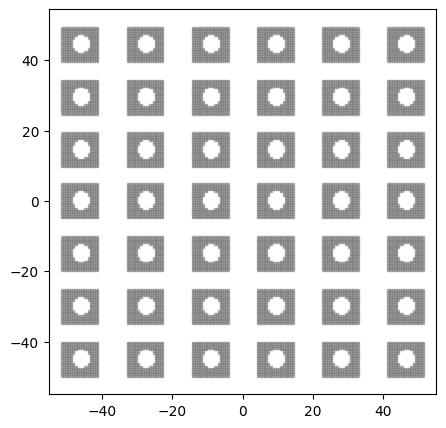

--------------------------------------------------
label: VentHole Chromosome_109: ['RayShape_109', 'GridStrictTransformation_346']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 1.8973495203997655, dy: 4.999594967018924, ]


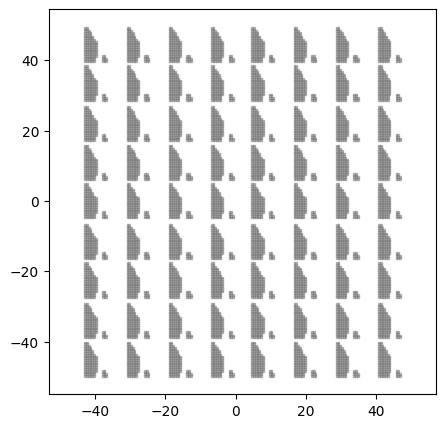

--------------------------------------------------
label: VentHole Chromosome_886: ['TriangleShape_576', 'CircularStrictTransformation_463']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.912435326111364, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


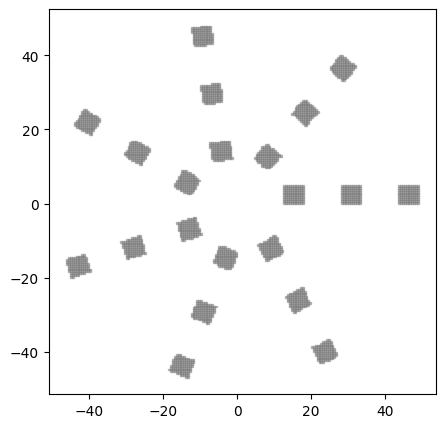

--------------------------------------------------
label: VentHole Chromosome_142: ['TriangleShape_886', 'GridStrictTransformation_346']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.912435326111364, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


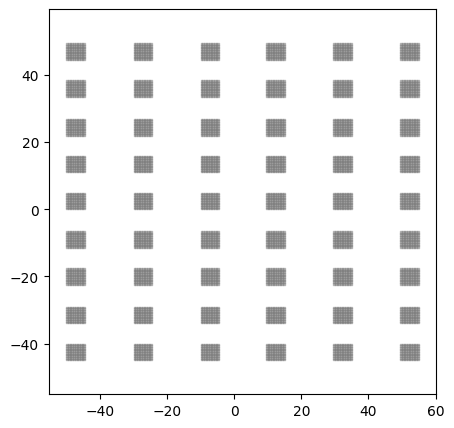

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_694', 'CircularStrictTransformation_33']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


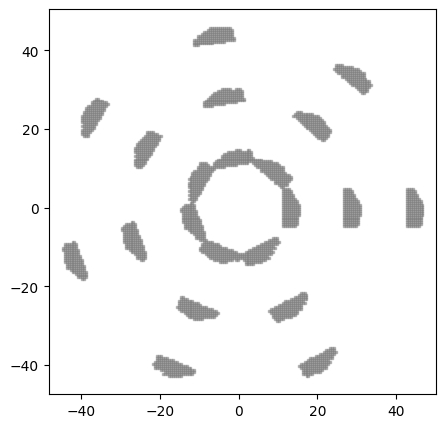

--------------------------------------------------
label: VentHole Chromosome_823: ['CircleShape_16', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


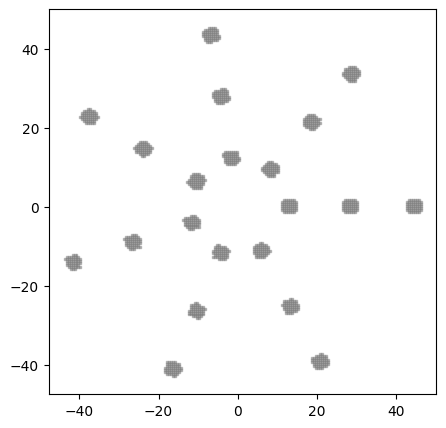

--------------------------------------------------
label: VentHole Chromosome_942: ['DonutShape_991', 'CornerTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 9.795259919111736, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


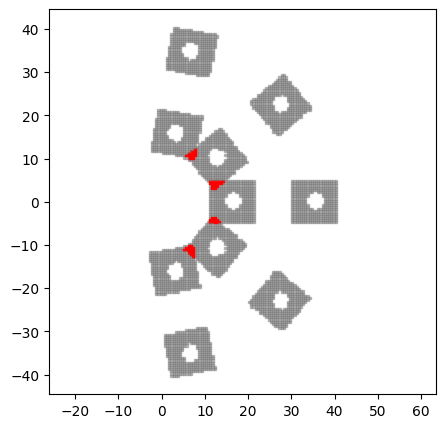

--------------------------------------------------
label: VentHole Chromosome_488: ['DonutShape_346', 'CircularStrictTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


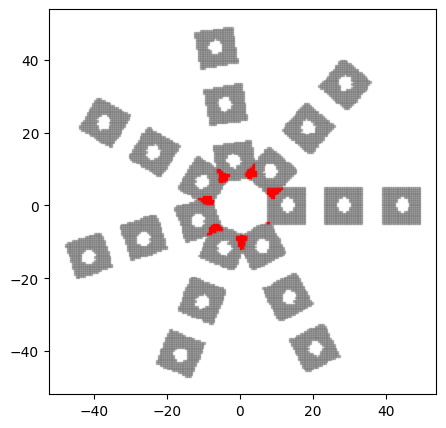

--------------------------------------------------
label: VentHole Chromosome_346: ['DonutShape_488', 'GridStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


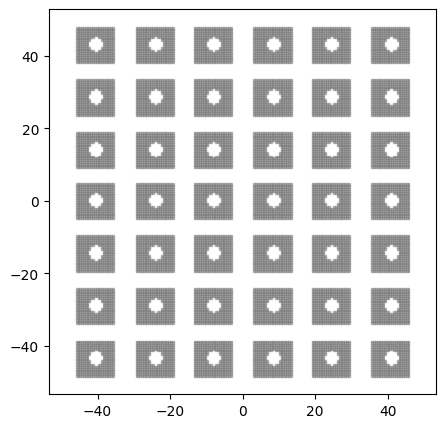

--------------------------------------------------
label: VentHole Chromosome_540: ['RayShape_849', 'GridStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.127324192664817, dy: 4.484528829467593, ]


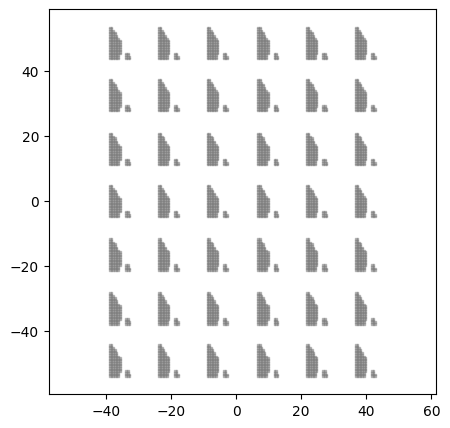

--------------------------------------------------
label: VentHole Chromosome_836: ['RayShape_606', 'CornerTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.3864273081077458, nose_point: 1.6633561681512983, lower_coefficient: 1.2945238092317164, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.945911121840797, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


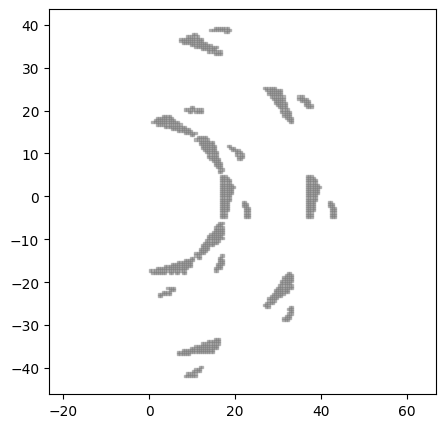

--------------------------------------------------
label: VentHole Chromosome_329: ['HoleShape_606', 'CornerTransformation_836']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


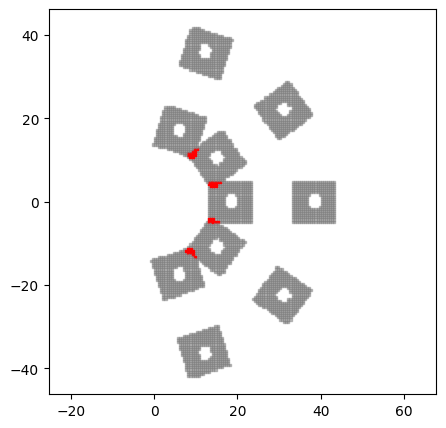

--------------------------------------------------
label: VentHole Chromosome_606: ['DonutShape_349', 'CircularStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 8.780235503775744, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


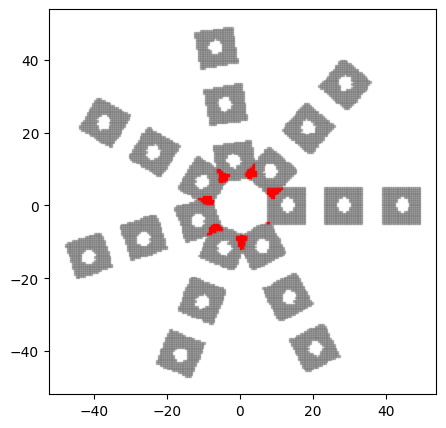

--------------------------------------------------
label: VentHole Chromosome_948: ['DonutShape_606', 'GridStrictTransformation_188']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 8.780235503775744, ]
pattern parameter:
parameter_list: [ dx: 1.8968207093092064, dy: 4.625347881243773, ]


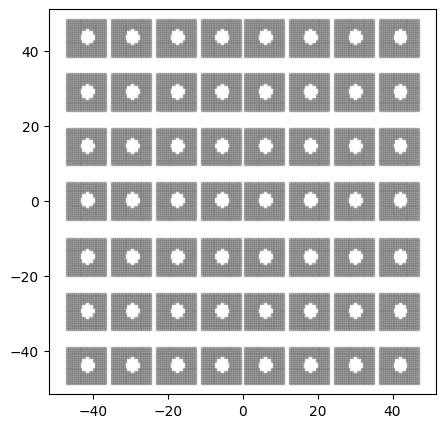

--------------------------------------------------
label: VentHole Chromosome_188: ['DonutShape_886', 'GridStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 1.8968207093092064, dy: 4.625347881243773, ]


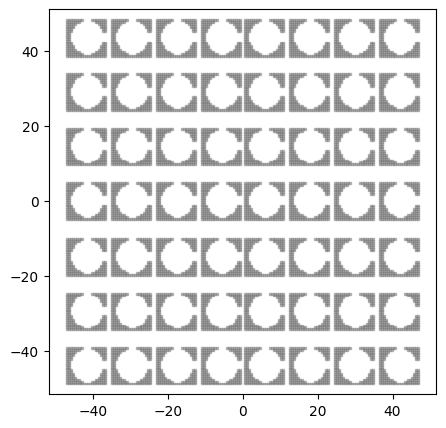

--------------------------------------------------
label: VentHole Chromosome_274: ['DonutShape_205', 'CornerTransformation_274']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.7511107218289792, phi: 0.7422463986582669, rot_count: 6.0, ]


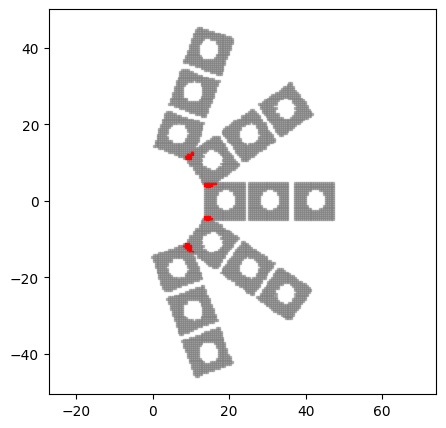

--------------------------------------------------
label: VentHole Chromosome_205: ['DonutShape_34', 'CornerTransformation_751']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


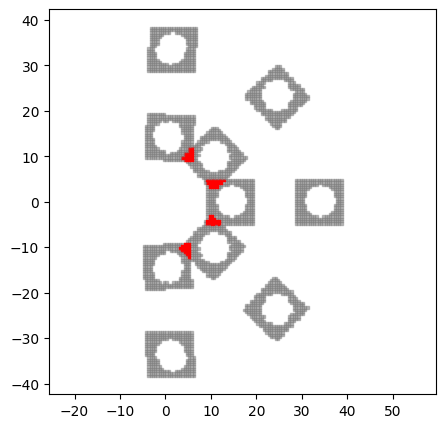

--------------------------------------------------
label: VentHole Chromosome_916: ['DoubleParabolicShape_824', 'CornerTransformation_659']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.9555316046270645, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


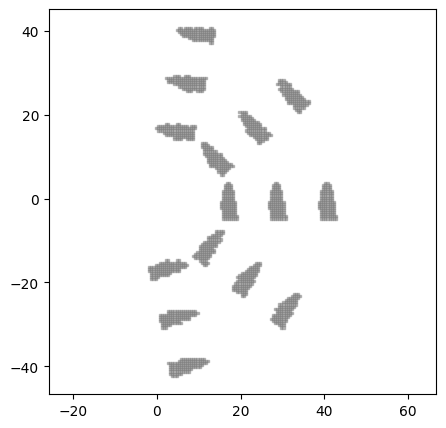

--------------------------------------------------
label: VentHole Chromosome_613: ['RayShape_574', 'CornerTransformation_181']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 5.0, ]


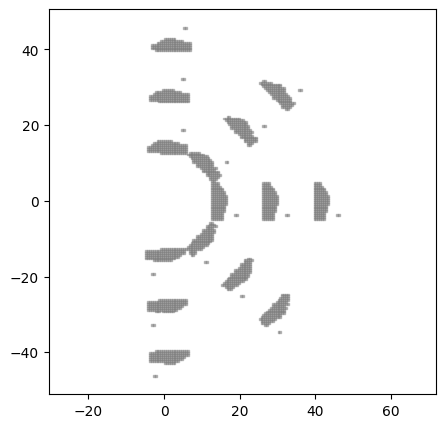

--------------------------------------------------
label: VentHole Chromosome_367: ['RayShape_556', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


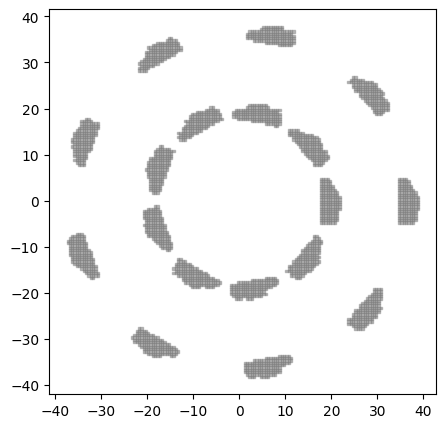

--------------------------------------------------
label: VentHole Chromosome_11: ['DoubleParabolicShape_984', 'CornerTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


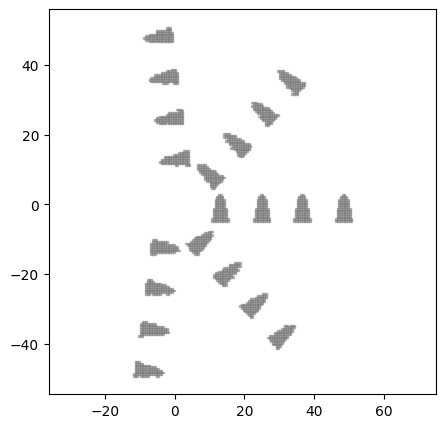

--------------------------------------------------
label: VentHole Chromosome_398: ['DoubleParabolicShape_11', 'CornerTransformation_975']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 4.0, ]


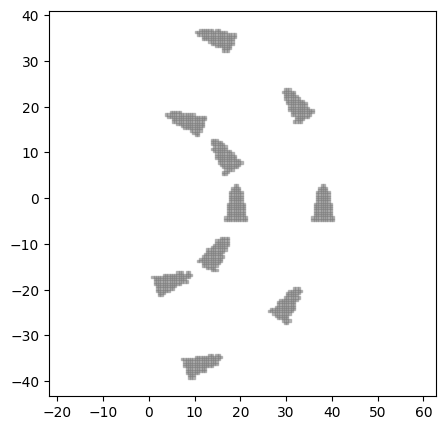

--------------------------------------------------
label: VentHole Chromosome_685: ['WingShape_659', 'CircularStrictTransformation_447']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 12.60840670397763, dx: 1.2155657505626951, phi: 0.6981317007977318, ]


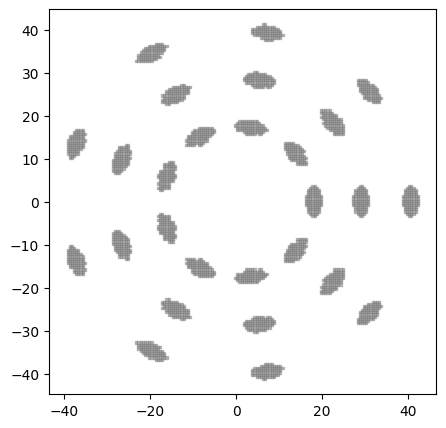

--------------------------------------------------
label: VentHole Chromosome_447: ['TrapezoidShape_899', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 12.60840670397763, dx: 1.2155657505626951, phi: 0.6981317007977318, ]


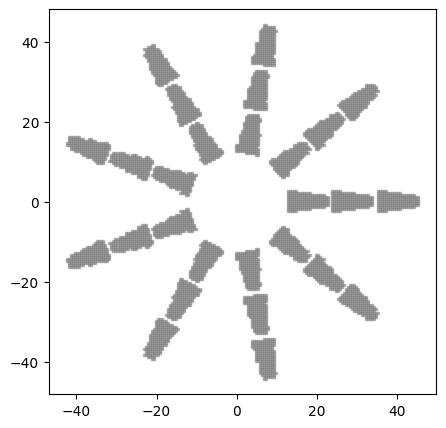

--------------------------------------------------
label: VentHole Chromosome_899: ['TrapezoidShape_447', 'CircularStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


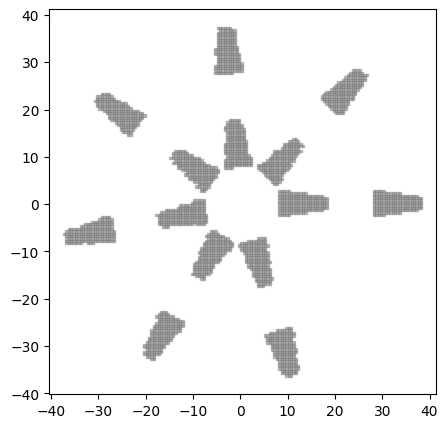

--------------------------------------------------
label: VentHole Chromosome_300: ['RayShape_540', 'GridStrictTransformation_142']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


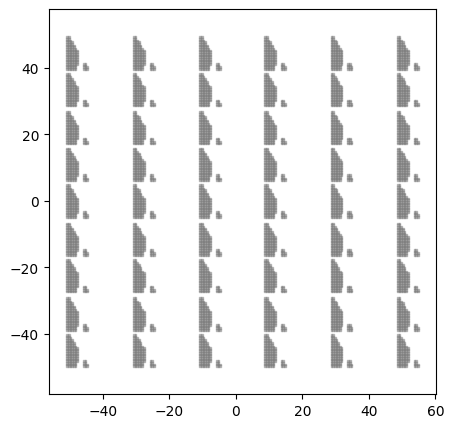

--------------------------------------------------
label: VentHole Chromosome_961: ['WingShape_459', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


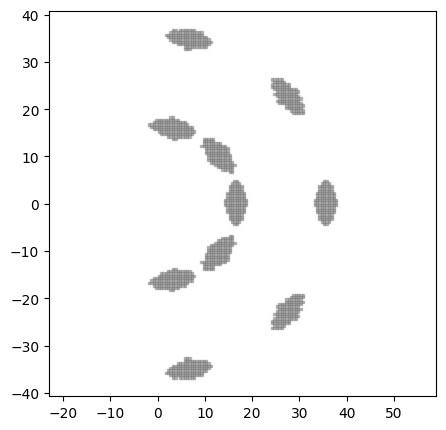

--------------------------------------------------
label: VentHole Chromosome_329: ['RayShape_329', 'CornerTransformation_749']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


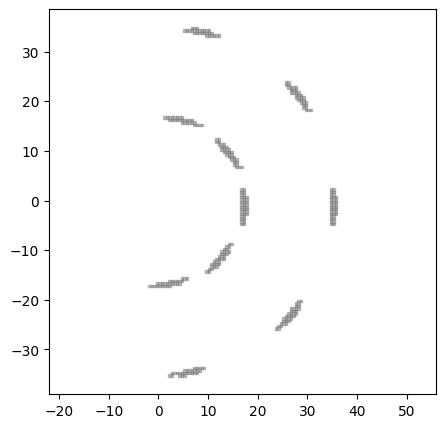

--------------------------------------------------
label: VentHole Chromosome_261: ['TriangleShape_432', 'CircularStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


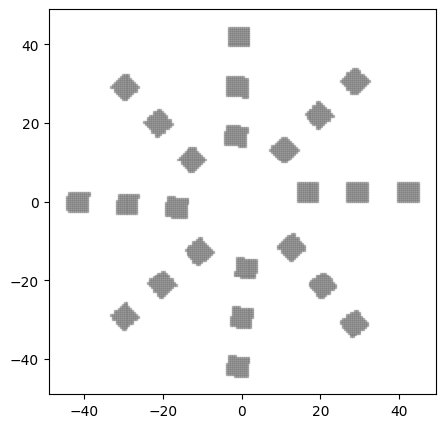

--------------------------------------------------
label: VentHole Chromosome_458: ['HoleShape_181', 'CircularStrictTransformation_261']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.14518147454222, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


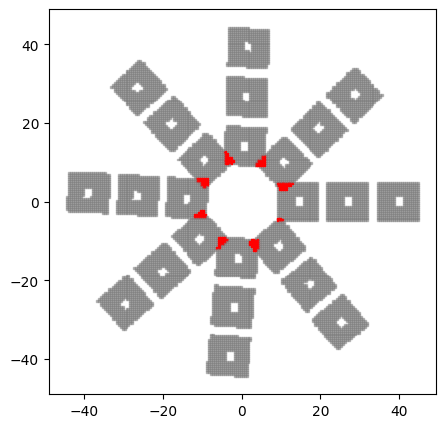

--------------------------------------------------
label: VentHole Chromosome_751: ['DonutShape_443', 'CornerTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.860778269600655, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


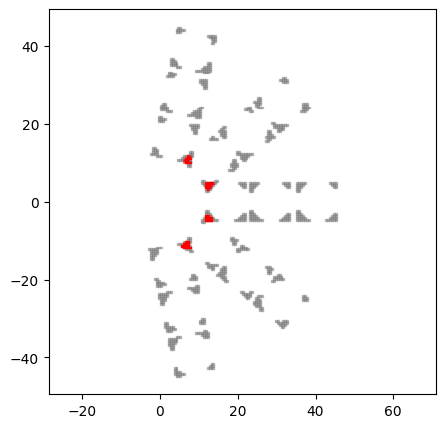

--------------------------------------------------
label: VentHole Chromosome_443: ['HoleShape_329', 'CircularStrictTransformation_849']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 5.807728062127912, phi: 0.483321946706122, ]


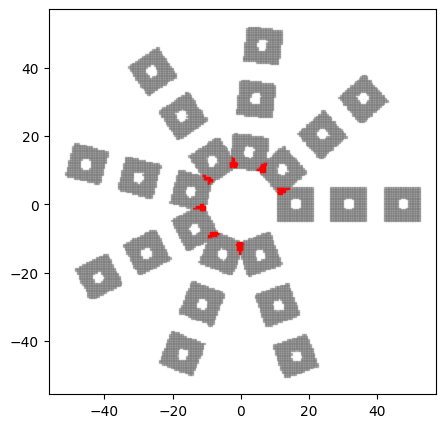

--------------------------------------------------
label: VentHole Chromosome_606: ['DoubleParabolicShape_751', 'CircularStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.1506227339525932, upper_y-intercept_from_lower_y: 1.6496962443104994, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


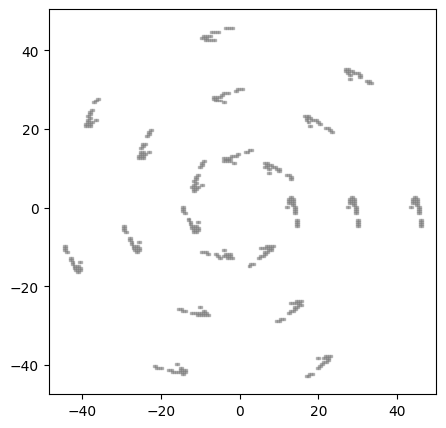

--------------------------------------------------
label: VentHole Chromosome_889: ['DoubleParabolicShape_606', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.1506227339525932, upper_y-intercept_from_lower_y: 1.6496962443104994, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


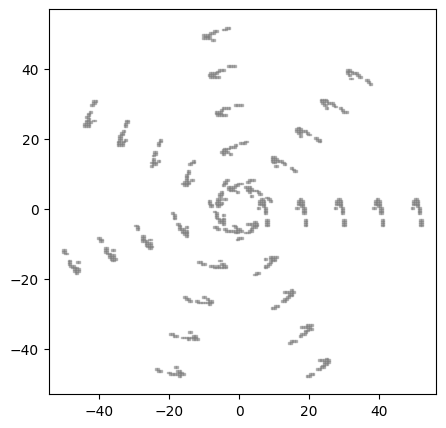

--------------------------------------------------
label: VentHole Chromosome_942: ['RayShape_261', 'CircularStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


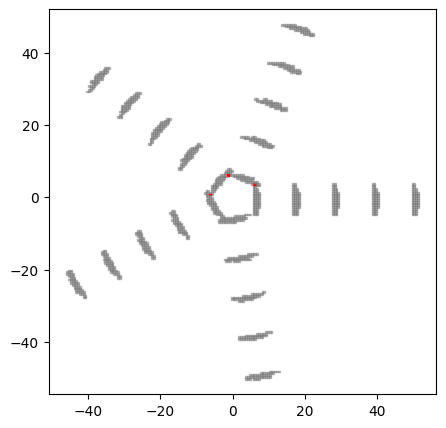

--------------------------------------------------
label: VentHole Chromosome_258: ['RayShape_942', 'CircularStrictTransformation_274']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


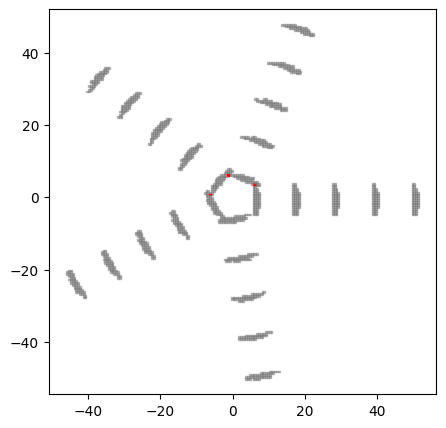

--------------------------------------------------
label: VentHole Chromosome_167: ['TriangleShape_548', 'CircularStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


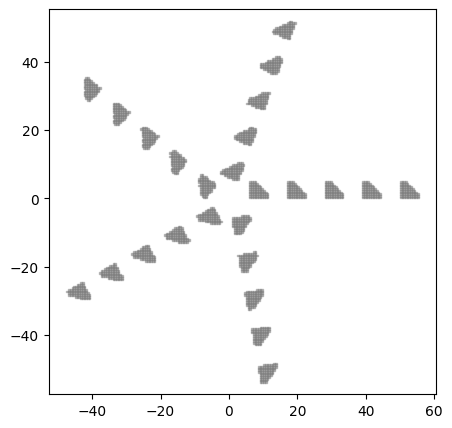

--------------------------------------------------
label: VentHole Chromosome_16: ['TriangleShape_167', 'GridStrictTransformation_692']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


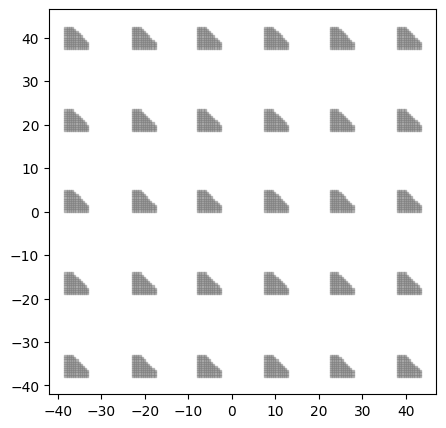

--------------------------------------------------
label: VentHole Chromosome_824: ['TrapezoidShape_556', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


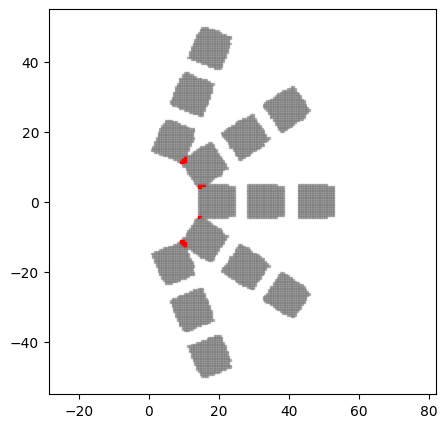

--------------------------------------------------
label: VentHole Chromosome_146: ['TriangleShape_388', 'CornerTransformation_824']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.685329774968638, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


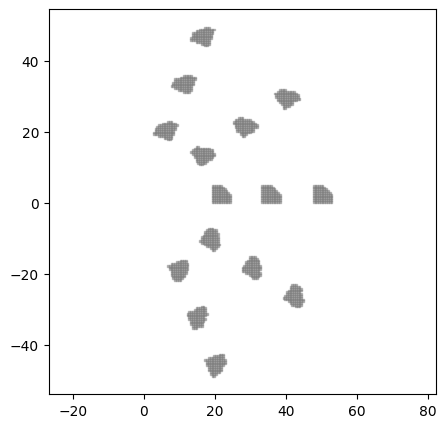

--------------------------------------------------
label: VentHole Chromosome_388: ['RayShape_367', 'GridStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 6.850813481976112, ]


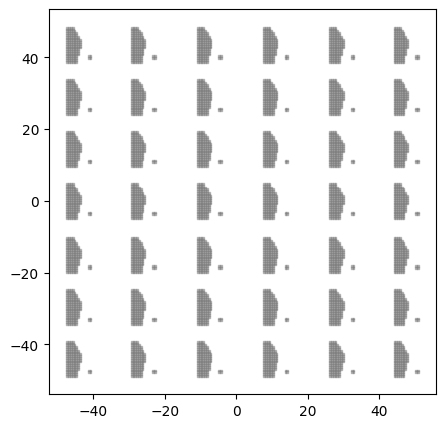

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_388', 'CornerTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


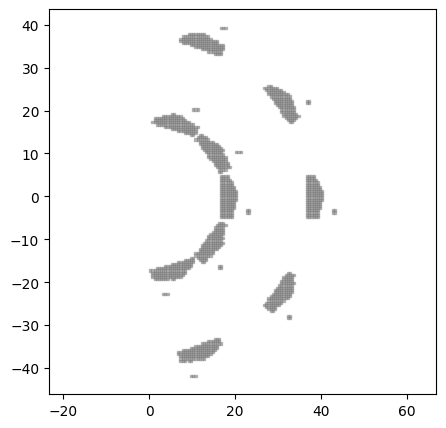

--------------------------------------------------
label: VentHole Chromosome_329: ['DonutShape_948', 'CornerTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


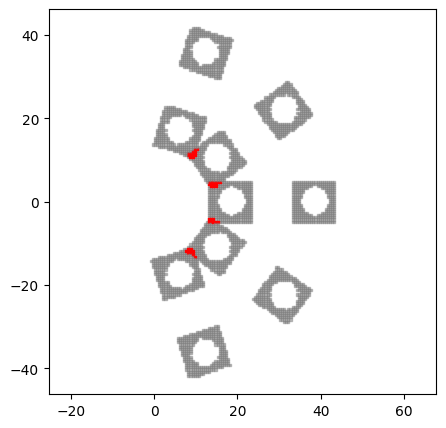

--------------------------------------------------
label: VentHole Chromosome_548: ['DonutShape_329', 'CornerTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


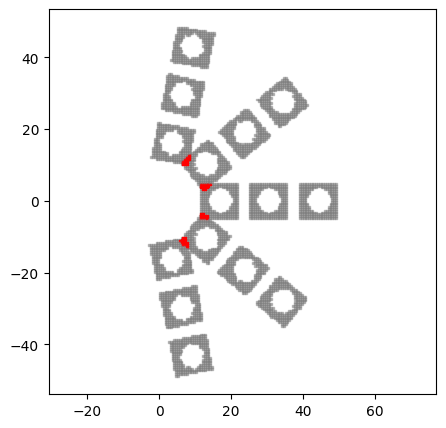

--------------------------------------------------
label: VentHole Chromosome_576: ['TriangleShape_142', 'CornerTransformation_334']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.912435326111364, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


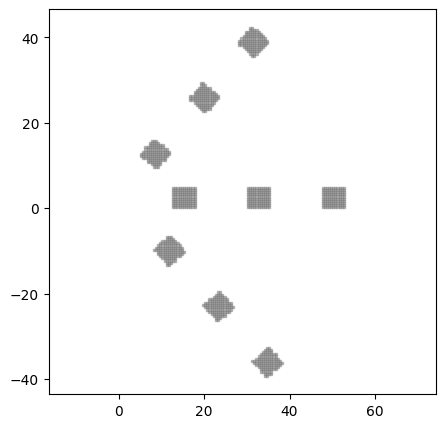

--------------------------------------------------
label: VentHole Chromosome_100: ['WingShape_100', 'CornerTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


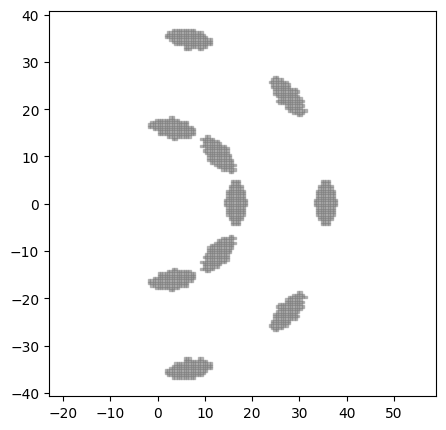

--------------------------------------------------
label: VentHole Chromosome_685: ['HoleShape_692', 'CornerTransformation_100']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


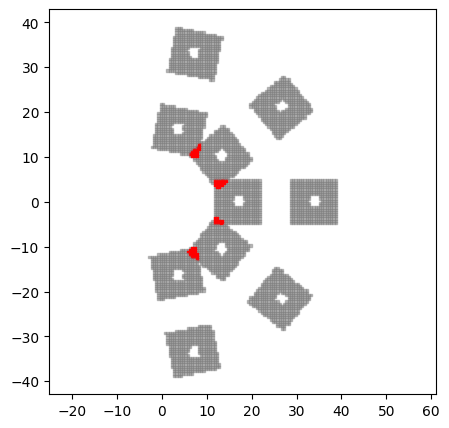

--------------------------------------------------
label: VentHole Chromosome_692: ['HoleShape_685', 'GridStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ dx: 8.149986214070697, dy: 6.794986250436445, ]


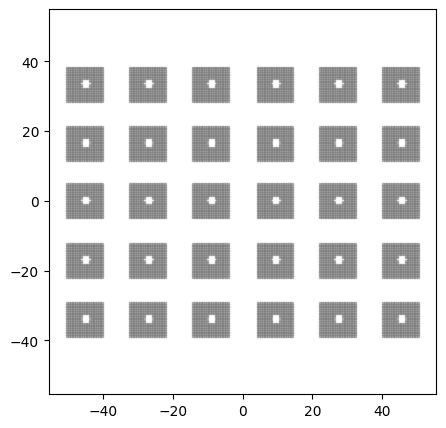

--------------------------------------------------
label: VentHole Chromosome_849: ['TriangleShape_261', 'GridStrictTransformation_692']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 8.149986214070697, dy: 6.794986250436445, ]


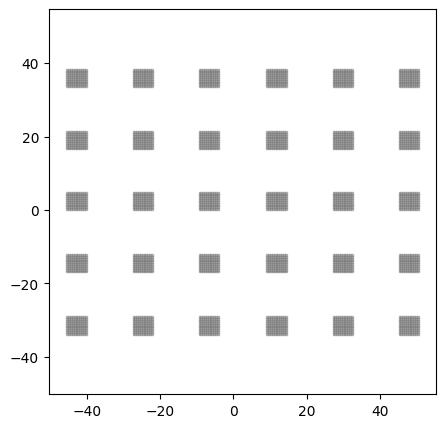

--------------------------------------------------
label: VentHole Chromosome_173: ['CircleShape_349', 'GridStrictTransformation_173']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ dx: 1.7511107218289792, dy: 4.625347881243773, ]


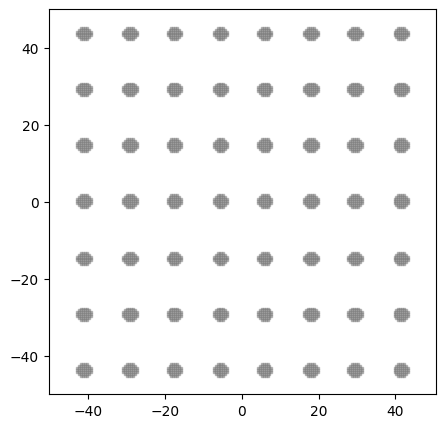

--------------------------------------------------
label: VentHole Chromosome_349: ['DonutShape_548', 'CornerTransformation_916']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


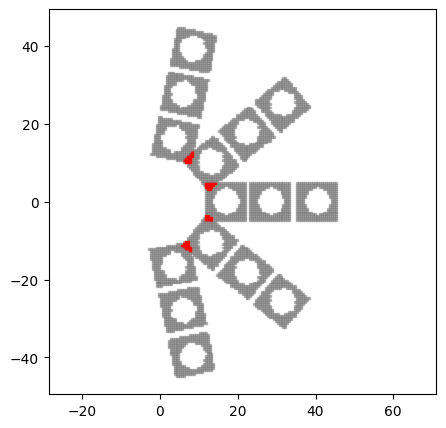

--------------------------------------------------
label: VentHole Chromosome_548: ['DonutShape_349', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


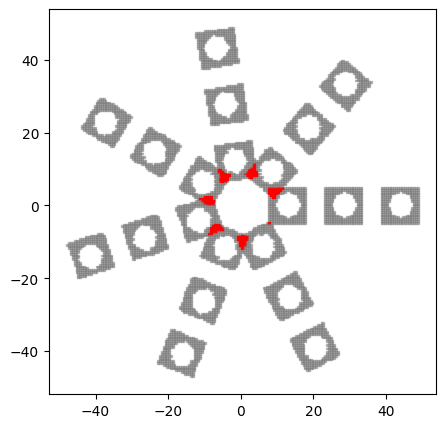

--------------------------------------------------
label: VentHole Chromosome_971: ['WingShape_529', 'CircularStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.483321946706122, ]


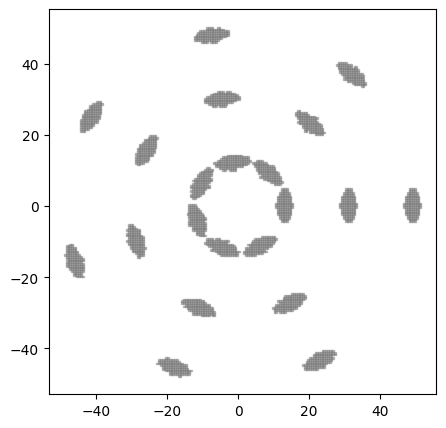

--------------------------------------------------
label: VentHole Chromosome_19: ['RayShape_181', 'CircularStrictTransformation_971']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.483321946706122, ]


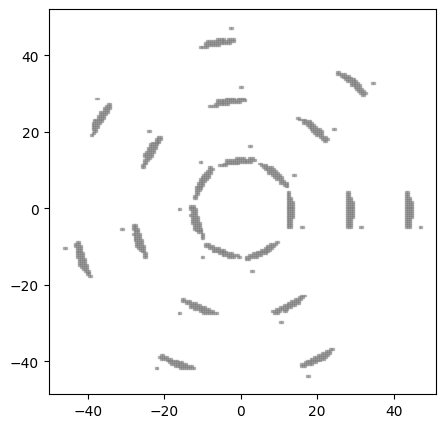

--------------------------------------------------
label: VentHole Chromosome_181: ['RayShape_19', 'GridStrictTransformation_540']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.4615904393341665, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.127324192664817, dy: 4.484528829467593, ]


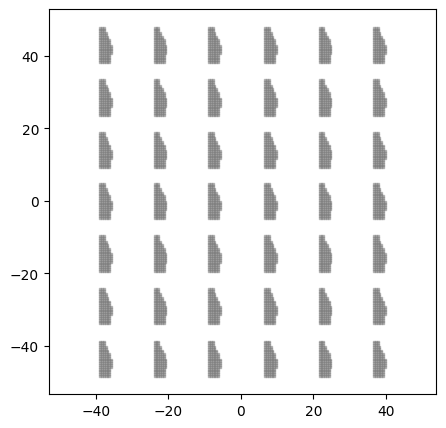

--------------------------------------------------
label: VentHole Chromosome_304: ['TrapezoidShape_67', 'GridStrictTransformation_413']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


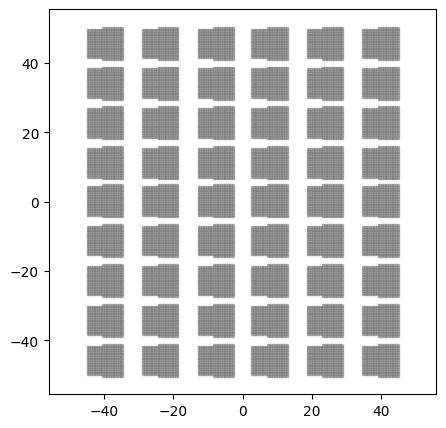

--------------------------------------------------
label: VentHole Chromosome_713: ['TriangleShape_684', 'CircularStrictTransformation_24']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.807728062127912, phi: 0.5235987755982988, ]


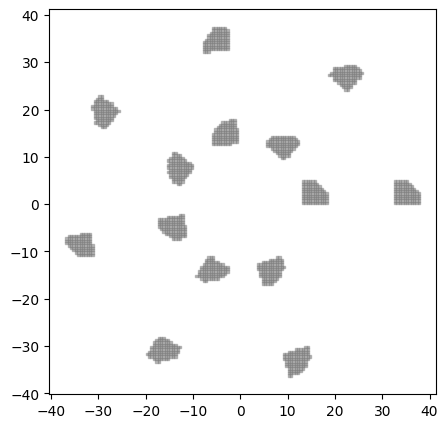

--------------------------------------------------
label: VentHole Chromosome_706: ['DonutShape_548', 'CornerTransformation_24']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.30142999997884, r_outer: 7.879177221925768, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


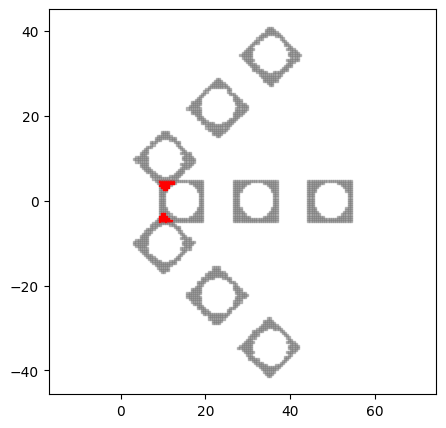

--------------------------------------------------
label: VentHole Chromosome_548: ['TriangleShape_24', 'GridStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


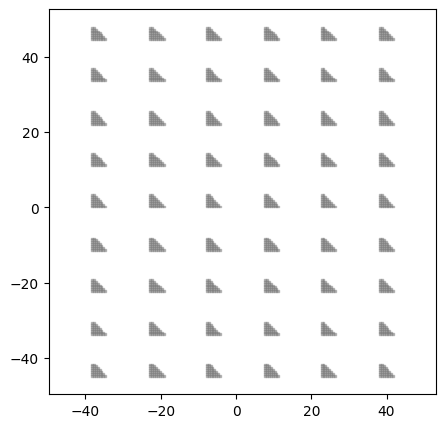

--------------------------------------------------
label: VentHole Chromosome_62: ['TriangleShape_548', 'CornerTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


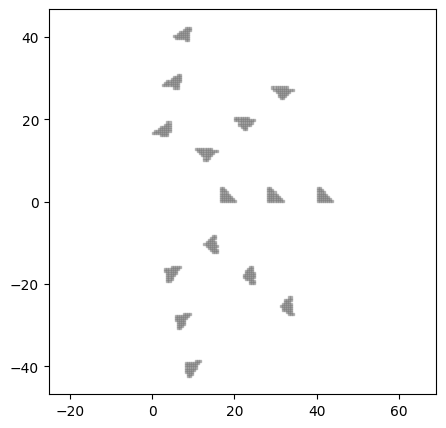

--------------------------------------------------
label: VentHole Chromosome_251: ['TriangleShape_413', 'CircularStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


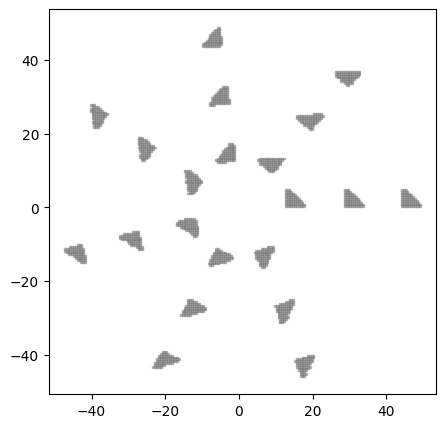

--------------------------------------------------
label: VentHole Chromosome_808: ['WingShape_585', 'CircularStrictTransformation_251']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


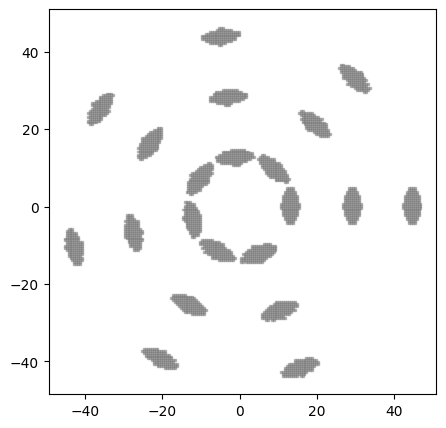

--------------------------------------------------
label: VentHole Chromosome_167: ['DonutShape_548', 'CornerTransformation_751']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


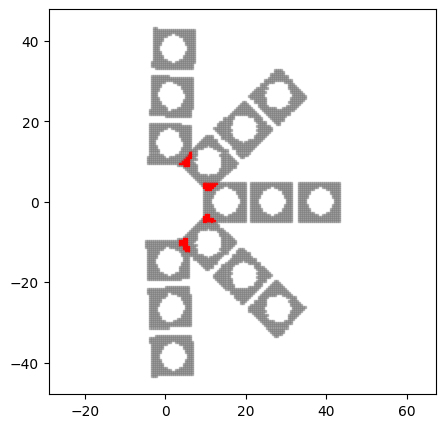

--------------------------------------------------
label: VentHole Chromosome_948: ['RayShape_556', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


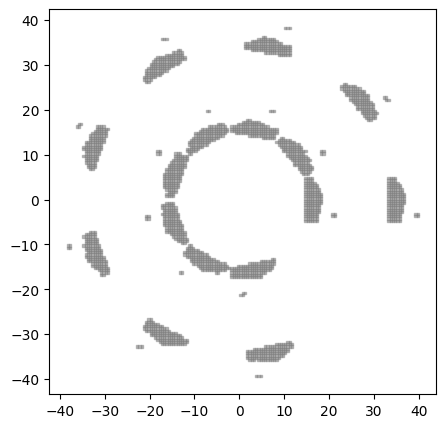

--------------------------------------------------
label: VentHole Chromosome_11: ['WingShape_258', 'CornerTransformation_11']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


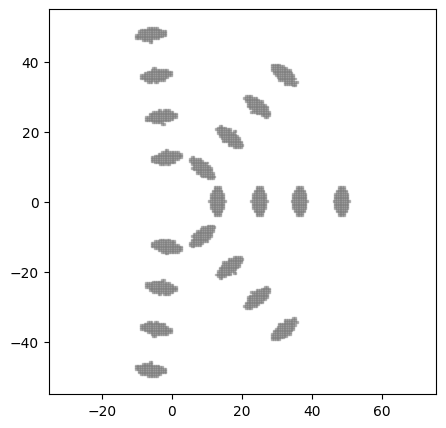

--------------------------------------------------
label: VentHole Chromosome_984: ['CircleShape_948', 'CornerTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6062866637503088, rot_count: 6.0, ]


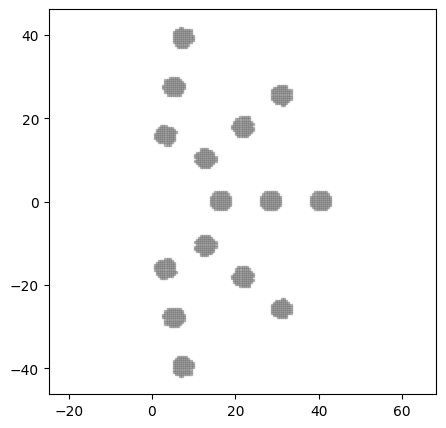

--------------------------------------------------
label: VentHole Chromosome_948: ['DoubleParabolicShape_398', 'CornerTransformation_765']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 4.0, ]


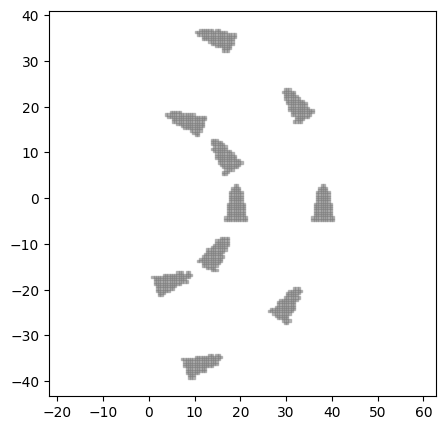

--------------------------------------------------
label: VentHole Chromosome_443: ['CircleShape_467', 'GridStrictTransformation_443']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.9315344678112325, ]


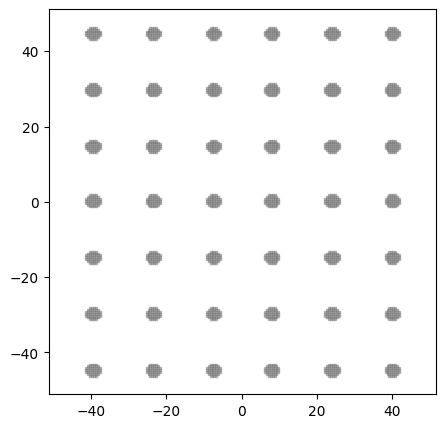

--------------------------------------------------
label: VentHole Chromosome_928: ['CircleShape_443', 'CircularStrictTransformation_24']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


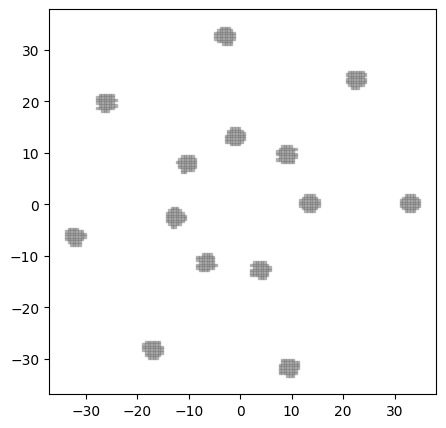

--------------------------------------------------
label: VentHole Chromosome_363: ['RayShape_613', 'CornerTransformation_955']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.572009543843525, phi: 0.7422463986582669, rot_count: 6.0, ]


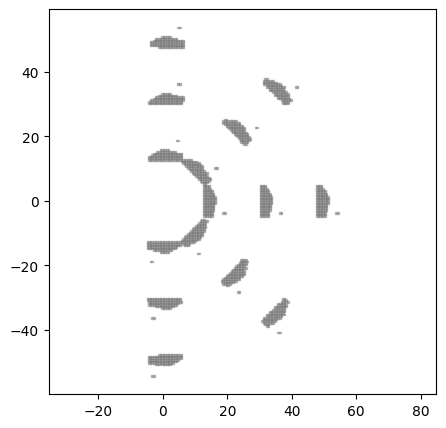

--------------------------------------------------
label: VentHole Chromosome_367: ['CircleShape_920', 'CircularStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


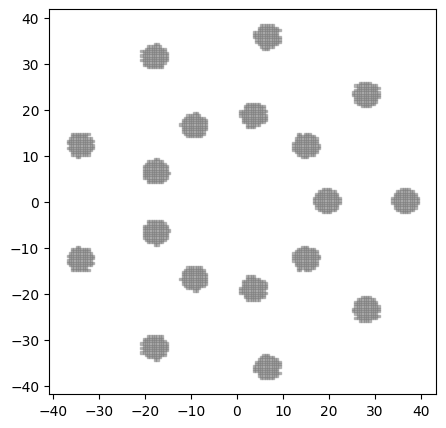

--------------------------------------------------
label: VentHole Chromosome_920: ['CircleShape_367', 'GridStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


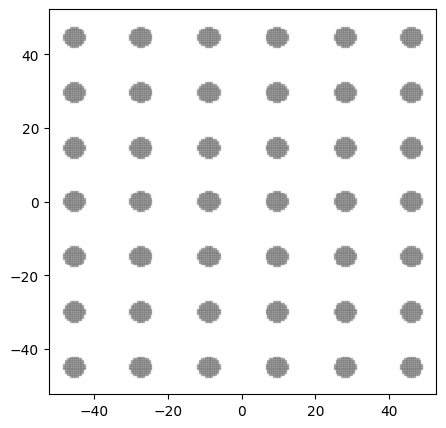

--------------------------------------------------
label: VentHole Chromosome_633: ['DonutShape_942', 'GridStrictTransformation_920']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 9.795259919111736, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


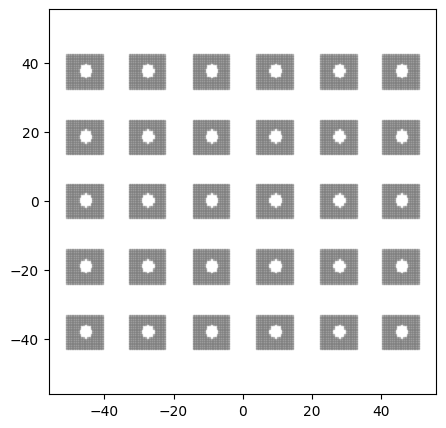

--------------------------------------------------
label: VentHole Chromosome_884: ['DonutShape_633', 'CircularStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 9.795259919111736, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


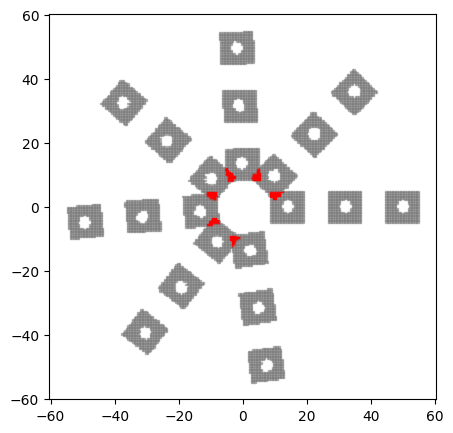

--------------------------------------------------
label: VentHole Chromosome_126: ['DoubleParabolicShape_403', 'CircularStrictTransformation_884']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.3912597872446593, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


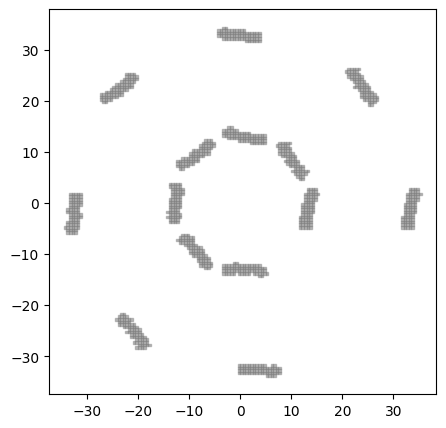

--------------------------------------------------
label: VentHole Chromosome_403: ['CircleShape_984', 'CircularStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


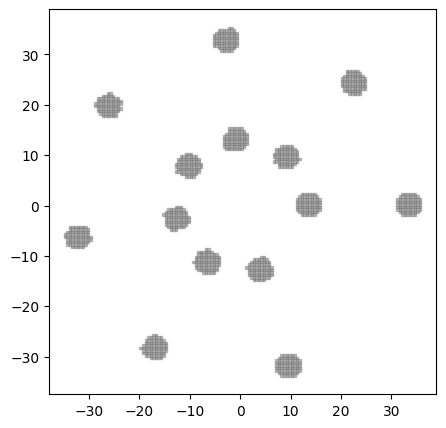

--------------------------------------------------
label: VentHole Chromosome_120: ['CircleShape_403', 'CornerTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


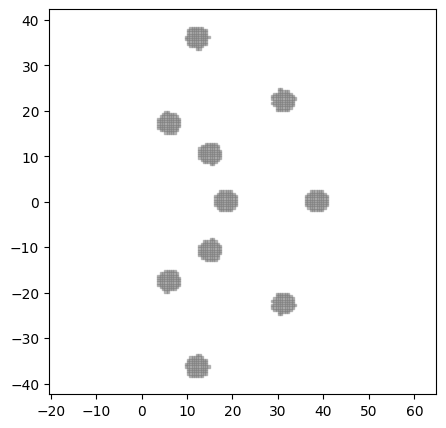

--------------------------------------------------
label: VentHole Chromosome_301: ['TriangleShape_301', 'CircularStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.912435326111364, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


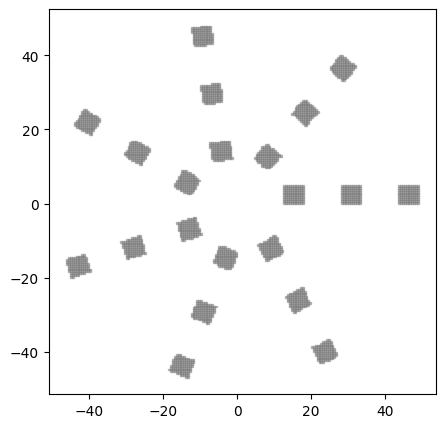

--------------------------------------------------
label: VentHole Chromosome_489: ['DonutShape_188', 'CircularStrictTransformation_301']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


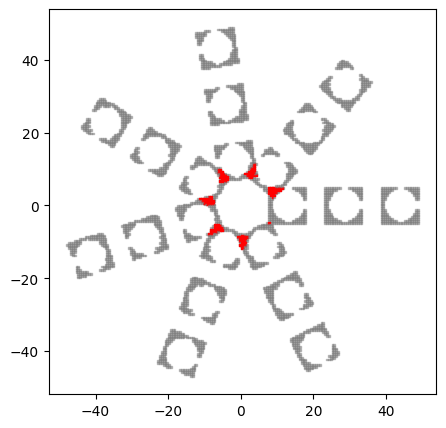

--------------------------------------------------
label: VentHole Chromosome_15: ['DonutShape_758', 'GridStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.3135732127556907, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


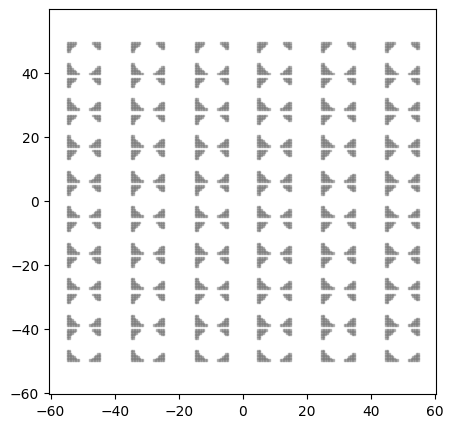

--------------------------------------------------
label: VentHole Chromosome_300: ['DoubleParabolicShape_443', 'CornerTransformation_10']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.7118761530723616, rot_count: 4.0, ]


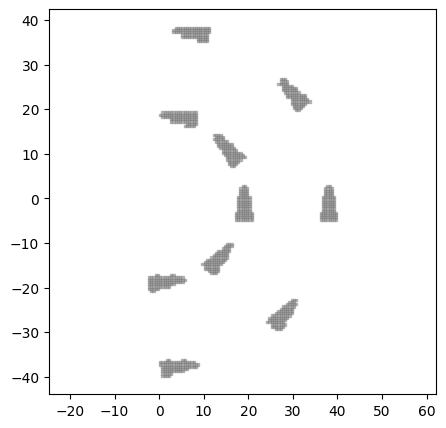

--------------------------------------------------
label: VentHole Chromosome_722: ['DoubleParabolicShape_300', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


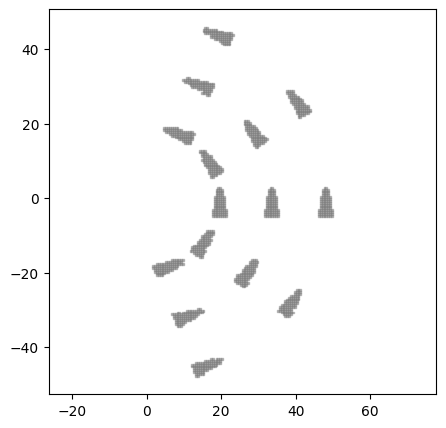

--------------------------------------------------
label: VentHole Chromosome_146: ['WingShape_685', 'CornerTransformation_722']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


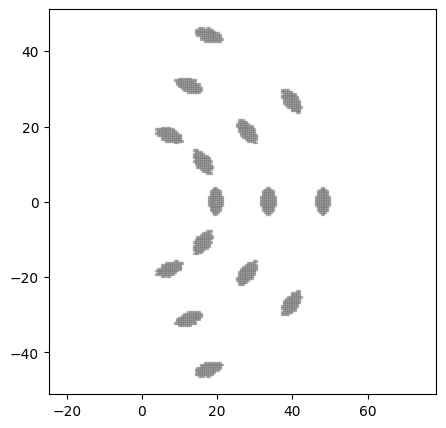

--------------------------------------------------
label: VentHole Chromosome_62: ['TriangleShape_740', 'CornerTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


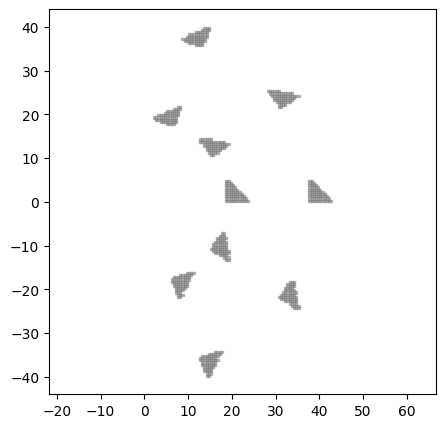

--------------------------------------------------
label: VentHole Chromosome_388: ['TriangleShape_62', 'CornerTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.572009543843525, phi: 0.7422463986582669, rot_count: 6.0, ]


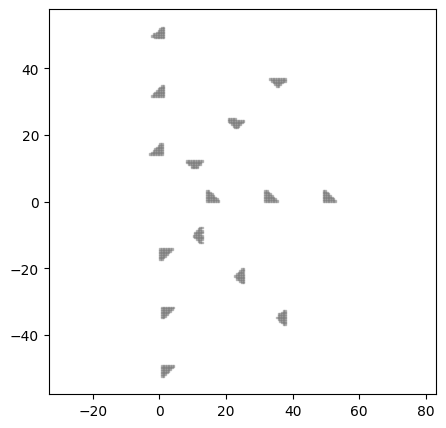

--------------------------------------------------
label: VentHole Chromosome_321: ['DoubleParabolicShape_253', 'CornerTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.2661943750335705, upper_coefficient: 1.7218859482710167, lower_y-intercept: 2.983751818459124, upper_y-intercept_from_lower_y: 1.6457817518665636, lower_x_trans: 0.9999517746226037, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


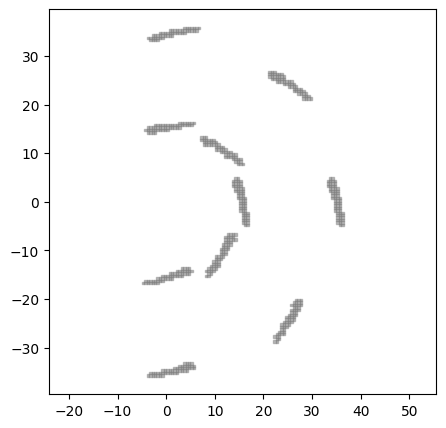

--------------------------------------------------
label: VentHole Chromosome_545: ['TrapezoidShape_324', 'CircularStrictTransformation_447']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.375621347896969, k2: 4.682186256866677, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


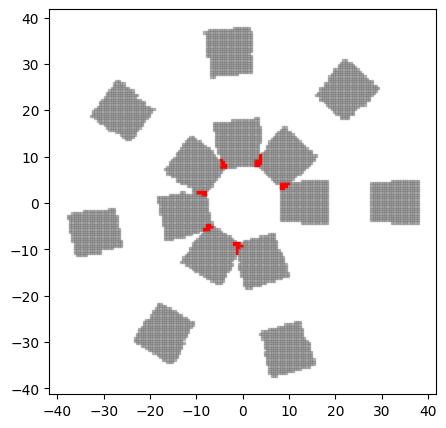

--------------------------------------------------
label: VentHole Chromosome_694: ['DoubleParabolicShape_694', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4589928758275925, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


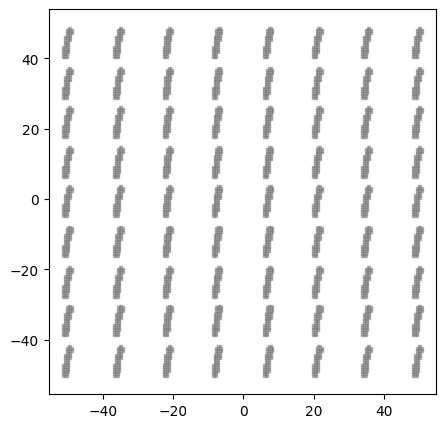

--------------------------------------------------
label: VentHole Chromosome_812: ['DonutShape_474', 'GridStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.099757504352789, r_outer: 7.705454121241933, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


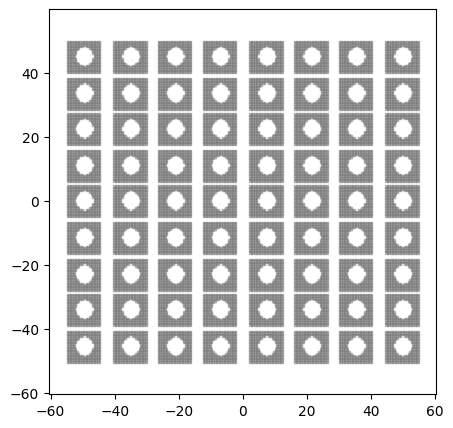

--------------------------------------------------
label: VentHole Chromosome_474: ['DonutShape_812', 'GridStrictTransformation_878']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.099757504352789, r_outer: 7.705454121241933, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


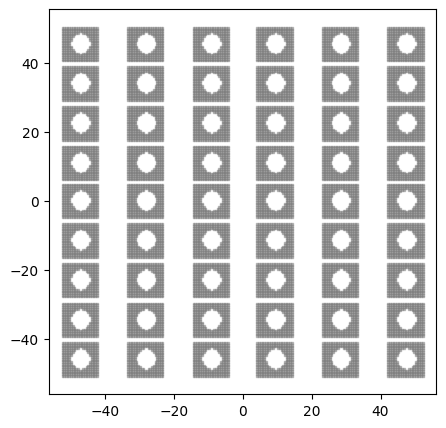

--------------------------------------------------
label: VentHole Chromosome_142: ['DoubleParabolicShape_488', 'GridStrictTransformation_474']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


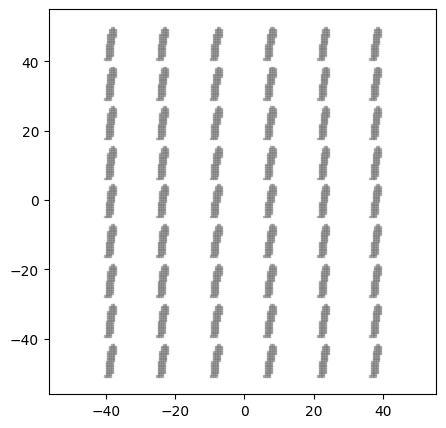

--------------------------------------------------
label: VentHole Chromosome_298: ['DoubleParabolicShape_647', 'CircularStrictTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.2593728075358106, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


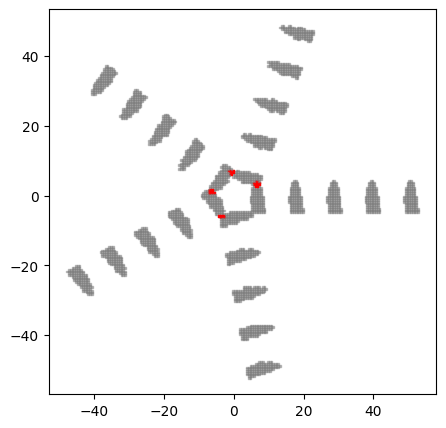

--------------------------------------------------
label: VentHole Chromosome_899: ['DonutShape_928', 'CircularStrictTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 0.7943149583733558, phi: 0.483321946706122, ]


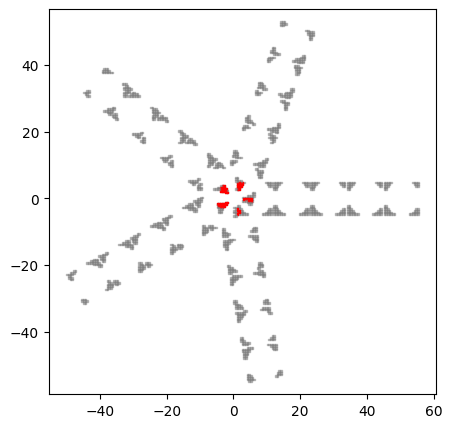

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_899', 'CircularStrictTransformation_545']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


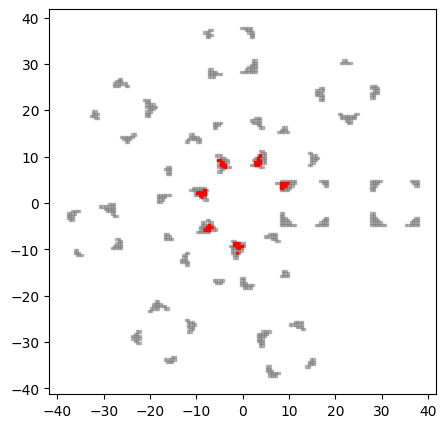

--------------------------------------------------
label: VentHole Chromosome_16: ['TriangleShape_16', 'GridStrictTransformation_812']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


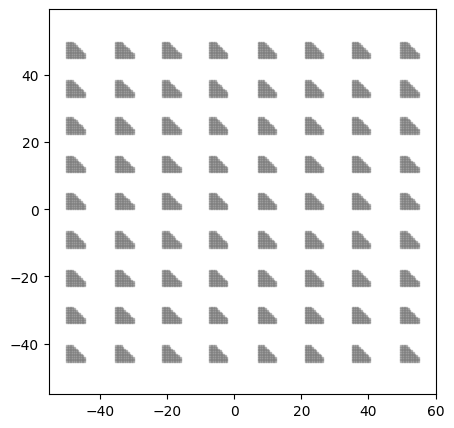

--------------------------------------------------
label: VentHole Chromosome_812: ['DonutShape_432', 'GridStrictTransformation_16']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.7884330054304476, r_outer: 9.114152172184859, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.3293583346218638, ]


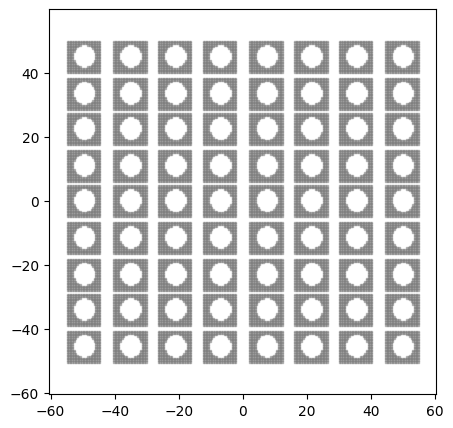

--------------------------------------------------
label: VentHole Chromosome_432: ['HoleShape_205', 'CornerTransformation_120']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.7190393992841844, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


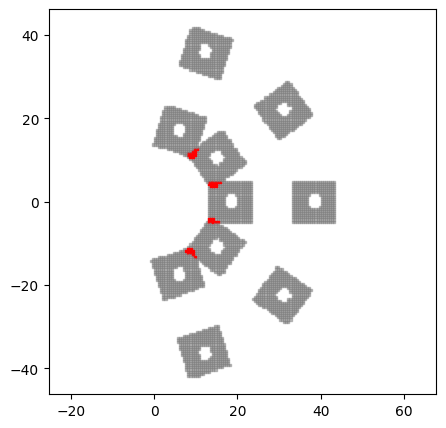

--------------------------------------------------
label: VentHole Chromosome_24: ['HoleShape_432', 'CircularStrictTransformation_403']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.7190393992841844, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


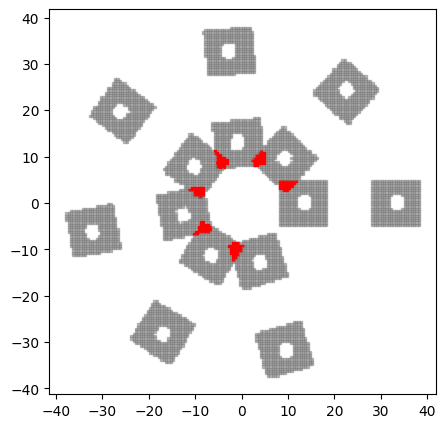

--------------------------------------------------
label: VentHole Chromosome_205: ['TrapezoidShape_74', 'CircularStrictTransformation_126']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


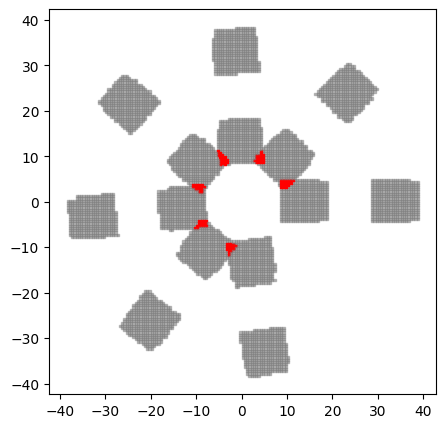

--------------------------------------------------
label: VentHole Chromosome_74: ['WingShape_11', 'GridStrictTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ dx: 9.295150927661393, dy: 4.999594967018924, ]


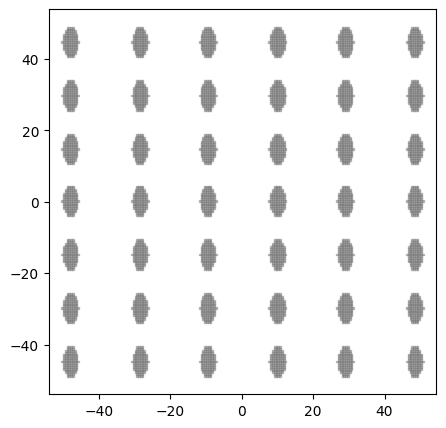

--------------------------------------------------
label: VentHole Chromosome_7: ['DoubleParabolicShape_982', 'CircularStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.938108402846558, upper_coefficient: 1.6037410382015655, lower_y-intercept: 2.5852724678406362, upper_y-intercept_from_lower_y: 1.434182648048219, lower_x_trans: 0.6584983925627528, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 0.7943149583733558, phi: 0.7853981633974483, ]


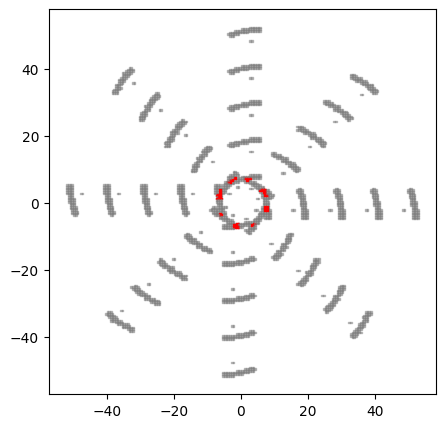

--------------------------------------------------
label: VentHole Chromosome_300: ['DoubleParabolicShape_7', 'GridStrictTransformation_346']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.938108402846558, upper_coefficient: 1.6037410382015655, lower_y-intercept: 2.5852724678406362, upper_y-intercept_from_lower_y: 1.434182648048219, lower_x_trans: 0.6584983925627528, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


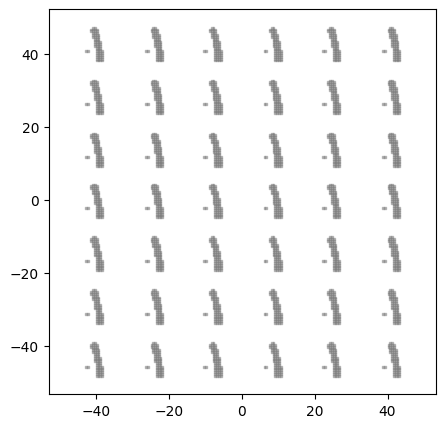

--------------------------------------------------
label: VentHole Chromosome_540: ['DonutShape_463', 'GridStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.356176217981065, r_outer: 8.600344704619449, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


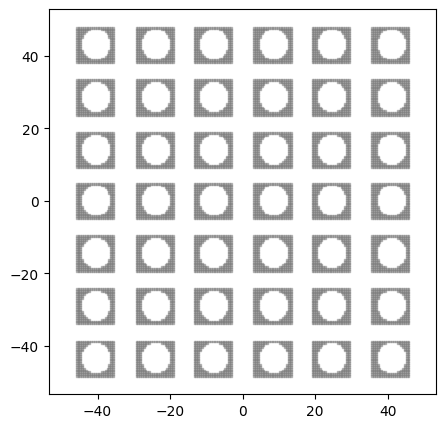

--------------------------------------------------
label: VentHole Chromosome_463: ['HoleShape_467', 'GridStrictTransformation_109']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ dx: 1.8973495203997655, dy: 4.999594967018924, ]


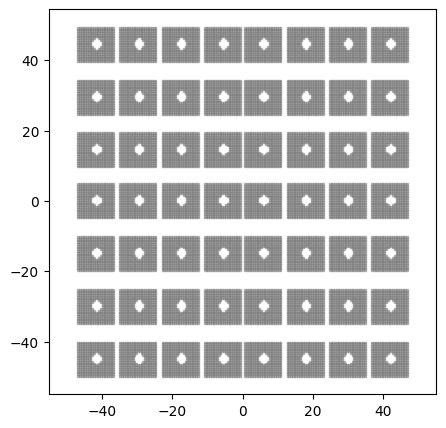

--------------------------------------------------
label: VentHole Chromosome_489: ['RayShape_167', 'CircularStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


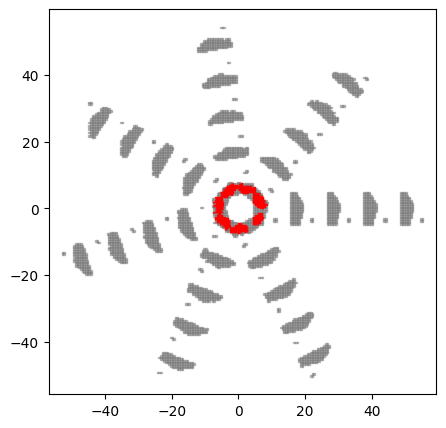

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_899', 'GridStrictTransformation_540']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


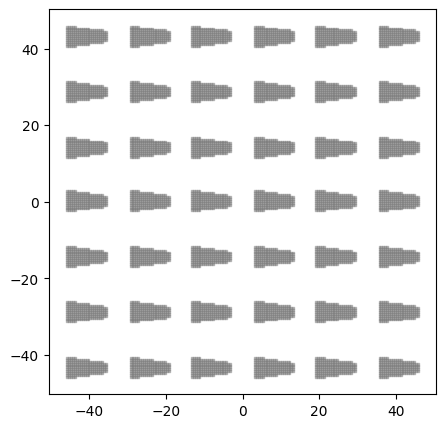

--------------------------------------------------
label: VentHole Chromosome_836: ['CircleShape_920', 'CircularStrictTransformation_324']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 5.7079720946130195, phi: 0.6283185307179586, ]


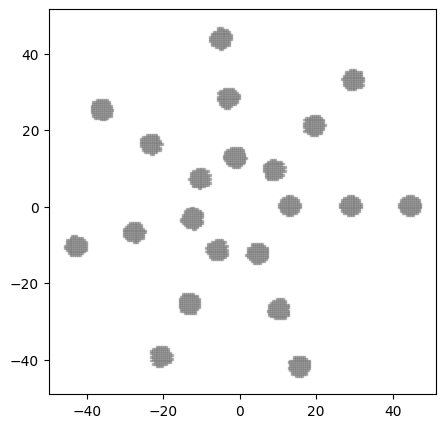

--------------------------------------------------
label: VentHole Chromosome_942: ['DoubleParabolicShape_363', 'CornerTransformation_613']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 5.0, ]


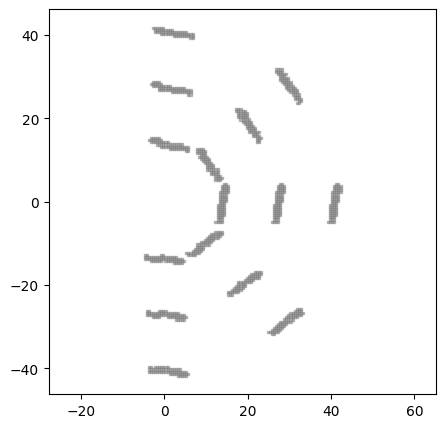

--------------------------------------------------
label: VentHole Chromosome_613: ['DoubleParabolicShape_916', 'CircularStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.9555316046270645, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


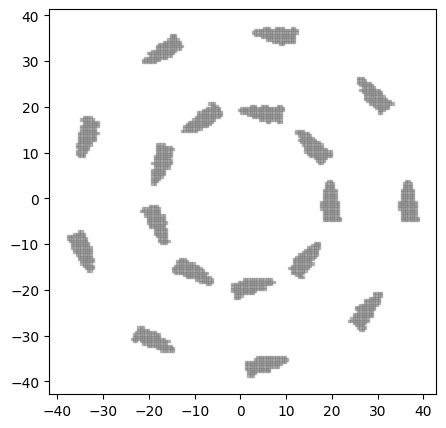

--------------------------------------------------
label: VentHole Chromosome_919: ['RayShape_438', 'CircularStrictTransformation_649']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 8.145479259950836, phi: 0.483321946706122, ]


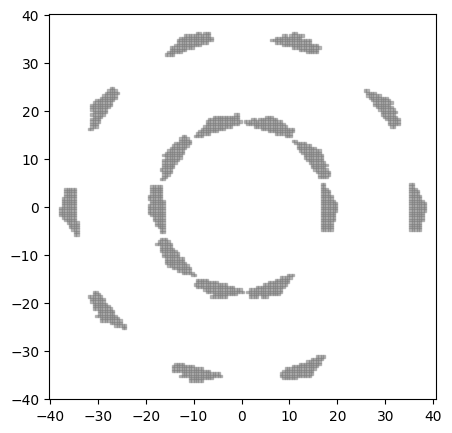

--------------------------------------------------
label: VentHole Chromosome_15: ['TrapezoidShape_955', 'GridStrictTransformation_15']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 1.1944947805979598, ]


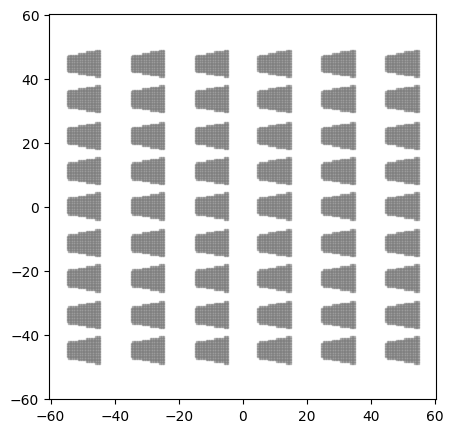

--------------------------------------------------
label: VentHole Chromosome_955: ['TrapezoidShape_15', 'GridStrictTransformation_766']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.4149157974465862, k2: 4.248053931078779, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


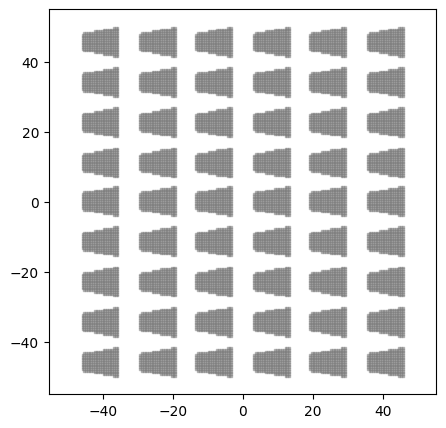

--------------------------------------------------
label: VentHole Chromosome_928: ['TriangleShape_808', 'GridStrictTransformation_955']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


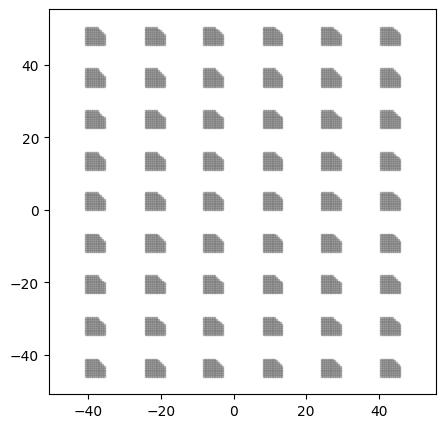

--------------------------------------------------
label: VentHole Chromosome_438: ['TriangleShape_928', 'GridStrictTransformation_600']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 7.325160411260114, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


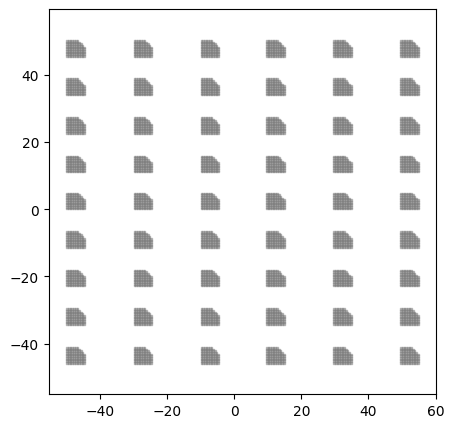

--------------------------------------------------
label: VentHole Chromosome_319: ['WingShape_319', 'CircularStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


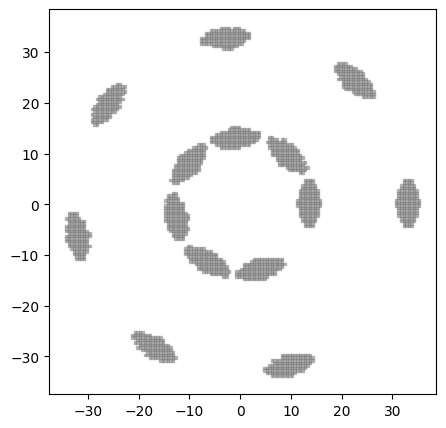

--------------------------------------------------
label: VentHole Chromosome_191: ['TriangleShape_33', 'CircularStrictTransformation_489']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


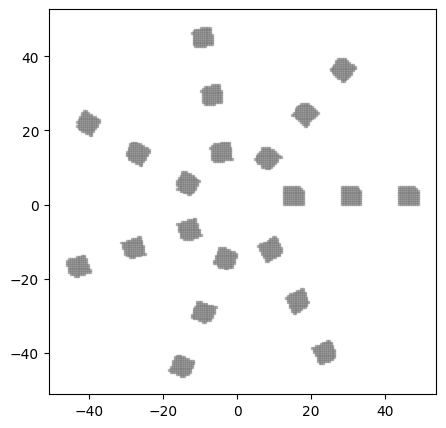

--------------------------------------------------
label: VentHole Chromosome_367: ['TriangleShape_16', 'CornerTransformation_108']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


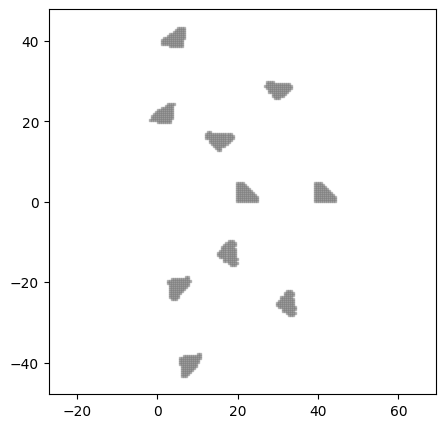

--------------------------------------------------
label: VentHole Chromosome_10: ['DonutShape_258', 'CornerTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


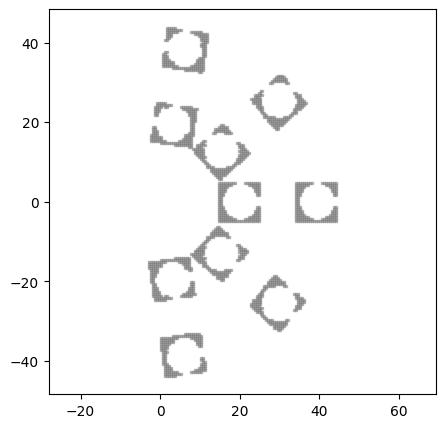

--------------------------------------------------
label: VentHole Chromosome_188: ['DonutShape_10', 'GridStrictTransformation_740']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


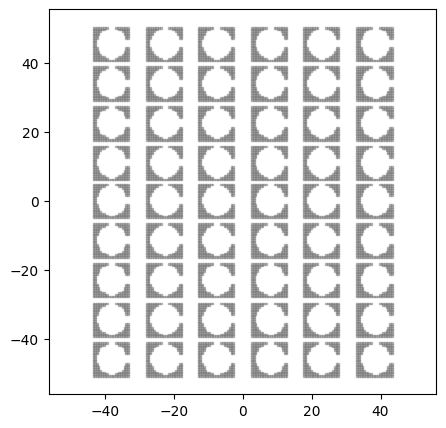

--------------------------------------------------
label: VentHole Chromosome_44: ['DoubleParabolicShape_44', 'GridStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 3.572072892139567, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 5.820309204666935, ]


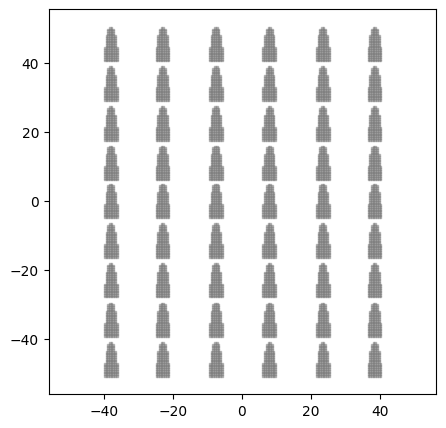

--------------------------------------------------
label: VentHole Chromosome_668: ['TrapezoidShape_529', 'GridStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


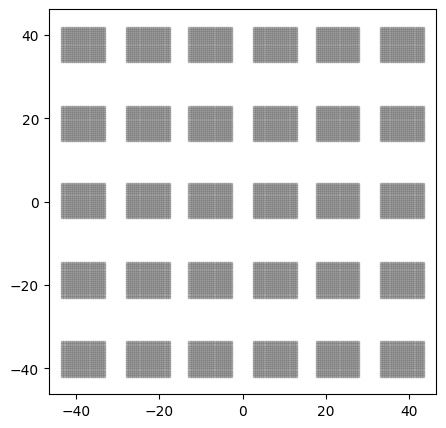

--------------------------------------------------
label: VentHole Chromosome_824: ['RayShape_105', 'CornerTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 1.0235249549719176, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


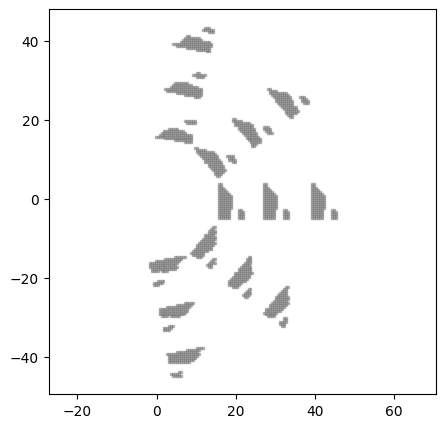

--------------------------------------------------
label: VentHole Chromosome_86: ['DonutShape_167', 'GridStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


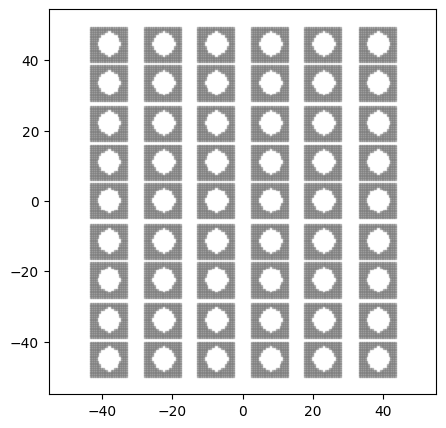

--------------------------------------------------
label: VentHole Chromosome_167: ['CircleShape_120', 'GridStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


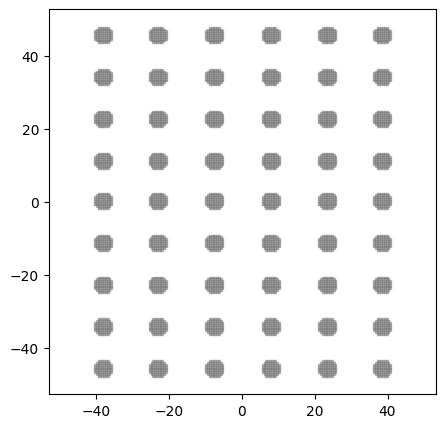

--------------------------------------------------
label: VentHole Chromosome_948: ['DonutShape_243', 'CornerTransformation_706']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


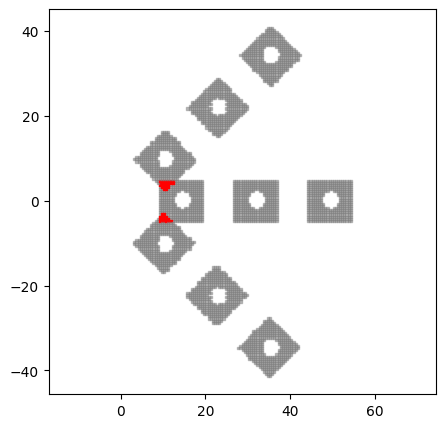

--------------------------------------------------
label: VentHole Chromosome_101: ['DonutShape_948', 'GridStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


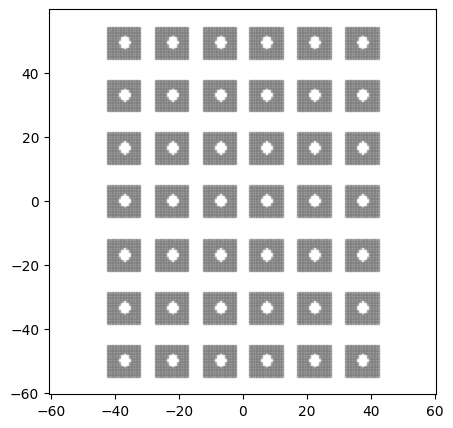

--------------------------------------------------
label: VentHole Chromosome_363: ['HoleShape_463', 'CircularStrictTransformation_24']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


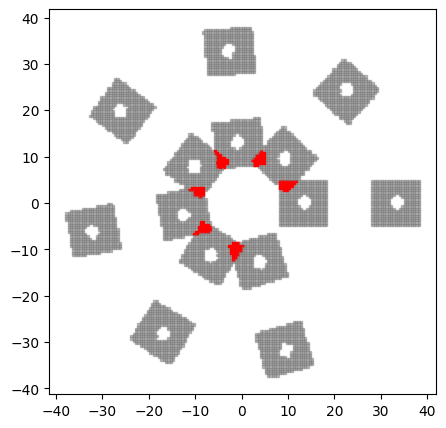

--------------------------------------------------
label: VentHole Chromosome_531: ['CircleShape_928', 'CircularStrictTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


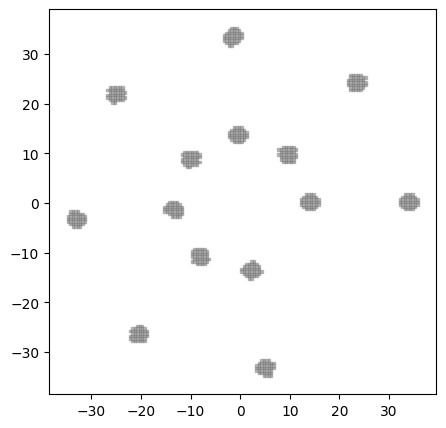

--------------------------------------------------
label: VentHole Chromosome_889: ['HoleShape_529', 'CircularStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.776942860477072, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


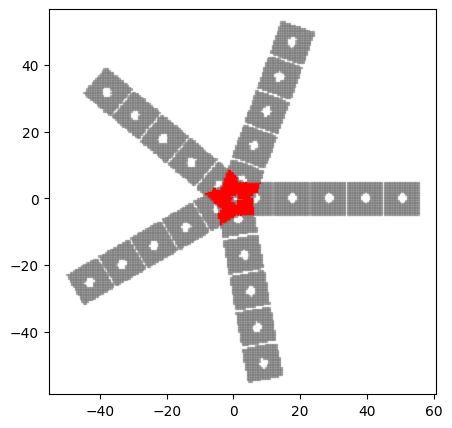

--------------------------------------------------
label: VentHole Chromosome_438: ['TrapezoidShape_824', 'CircularStrictTransformation_181']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


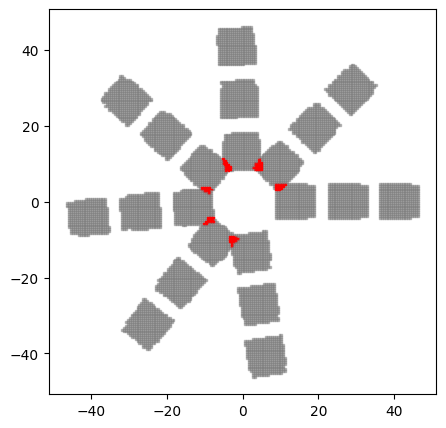

--------------------------------------------------
label: VentHole Chromosome_34: ['DonutShape_205', 'GridStrictTransformation_668']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


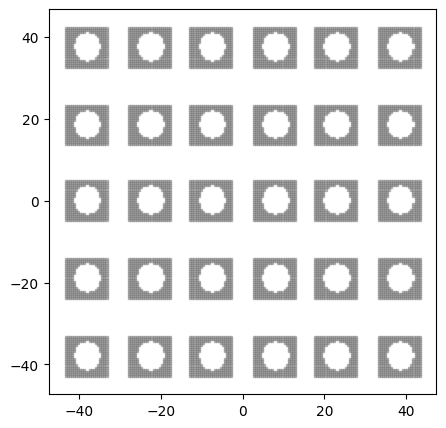

--------------------------------------------------
label: VentHole Chromosome_713: ['RayShape_823', 'GridStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.5053957586144247, nose_point: 1.1119489214540719, lower_coefficient: 3.712701426288192, lower_x-intercept: 2.9767626622629932, lower_y-intercept: 1.7646987033421309, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


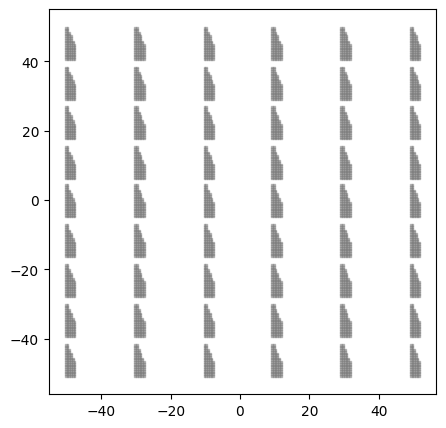

--------------------------------------------------
label: VentHole Chromosome_319: ['WingShape_319', 'CircularStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


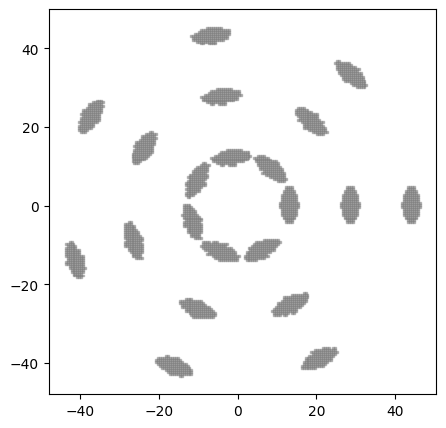

--------------------------------------------------
label: VentHole Chromosome_984: ['WingShape_955', 'CornerTransformation_251']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.6702101322494394, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


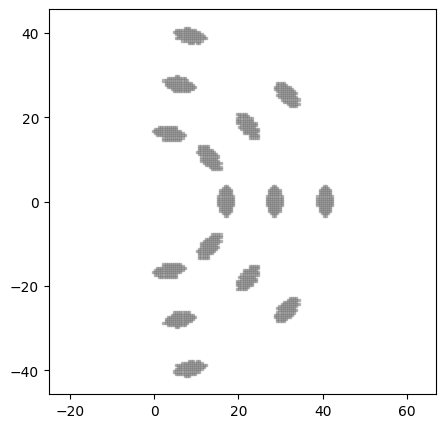

--------------------------------------------------
label: VentHole Chromosome_349: ['CircleShape_173', 'CircularStrictTransformation_420']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


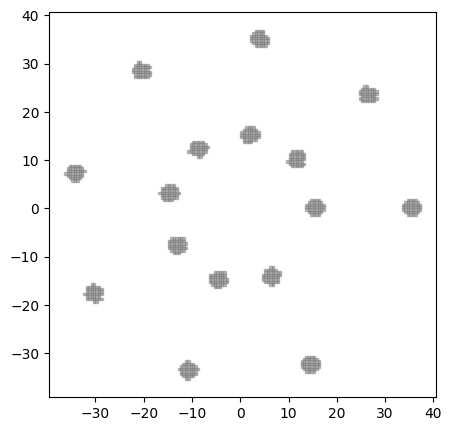

--------------------------------------------------
label: VentHole Chromosome_42: ['DoubleParabolicShape_42', 'CornerTransformation_898']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.930401995077138, upper_coefficient: 1.4405404659933918, lower_y-intercept: 1.8757223532885512, upper_y-intercept_from_lower_y: 1.4709121821021658, lower_x_trans: 2.1692102573872853, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


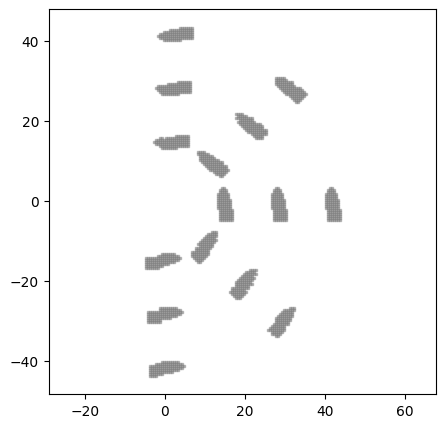

--------------------------------------------------
label: VentHole Chromosome_310: ['TrapezoidShape_467', 'CornerTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


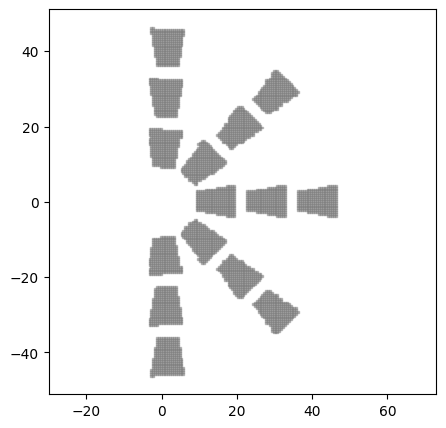

--------------------------------------------------
label: VentHole Chromosome_467: ['TrapezoidShape_310', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.577581890058865, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


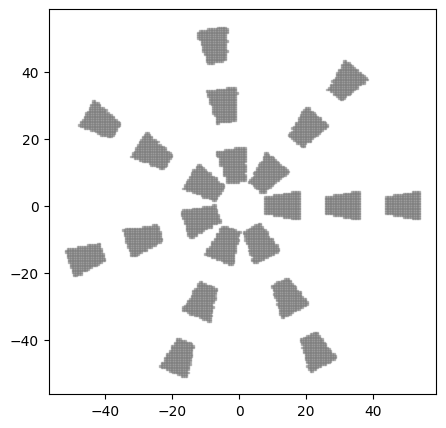

--------------------------------------------------
label: VentHole Chromosome_167: ['TriangleShape_849', 'CornerTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 13.62991641675422, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


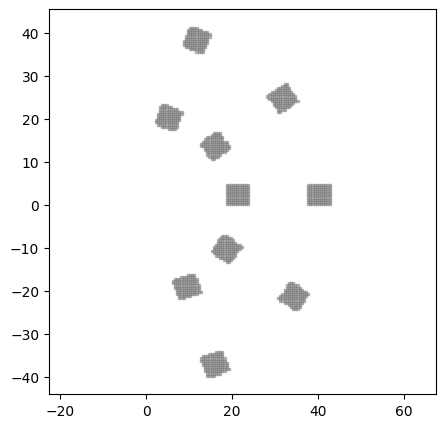

--------------------------------------------------
label: VentHole Chromosome_62: ['WingShape_146', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


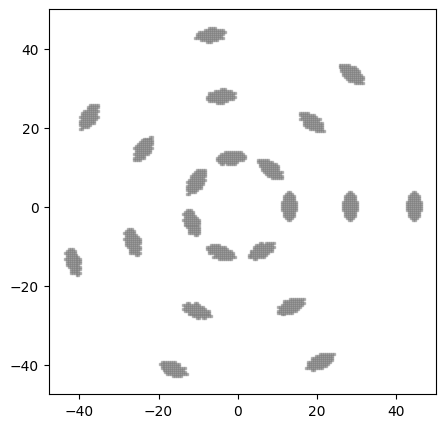

--------------------------------------------------
label: VentHole Chromosome_823: ['TrapezoidShape_823', 'CornerTransformation_10']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


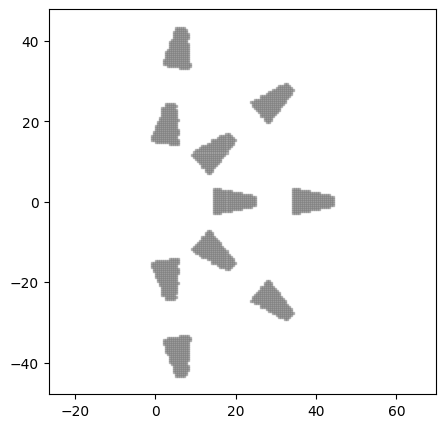

--------------------------------------------------
label: VentHole Chromosome_942: ['DonutShape_101', 'CornerTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


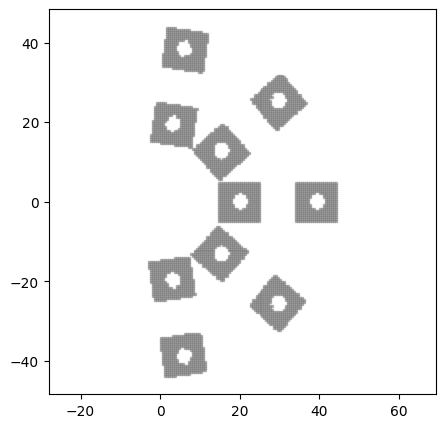

--------------------------------------------------
label: VentHole Chromosome_107: ['RayShape_467', 'GridStrictTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6559143436561357, nose_point: 1.227754993634589, lower_coefficient: 3.3595026999583957, lower_x-intercept: 1.4318805033924202, lower_y-intercept: 1.6110833899145065, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


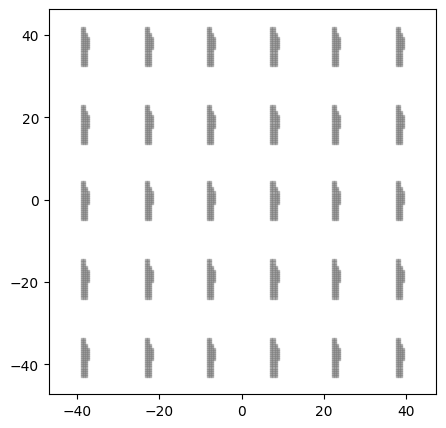

--------------------------------------------------
label: VentHole Chromosome_685: ['RayShape_107', 'CircularStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6559143436561357, nose_point: 1.227754993634589, lower_coefficient: 3.3595026999583957, lower_x-intercept: 1.4318805033924202, lower_y-intercept: 1.6110833899145065, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


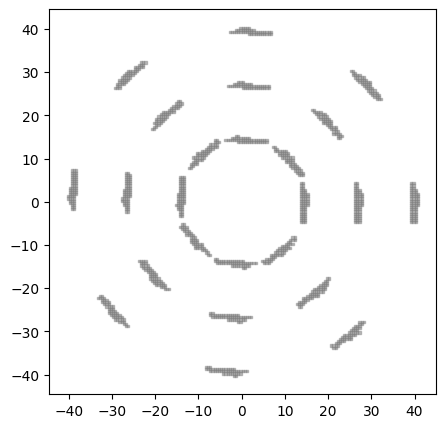

--------------------------------------------------
label: VentHole Chromosome_16: ['TriangleShape_367', 'GridStrictTransformation_633']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


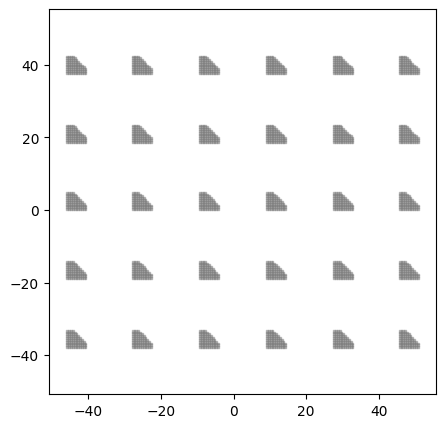

--------------------------------------------------
label: VentHole Chromosome_536: ['DonutShape_300', 'CircularStrictTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


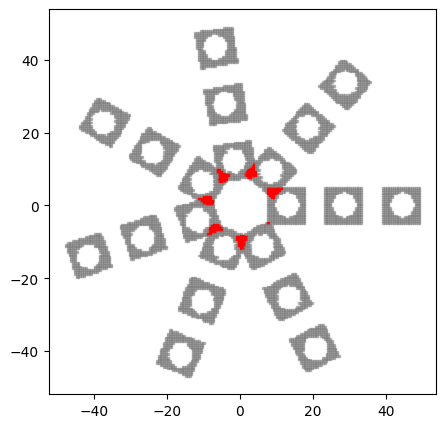

--------------------------------------------------
label: VentHole Chromosome_823: ['RayShape_329', 'CircularStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


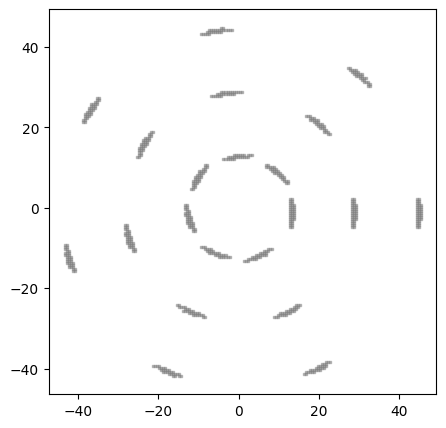

--------------------------------------------------
label: VentHole Chromosome_10: ['RayShape_823', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


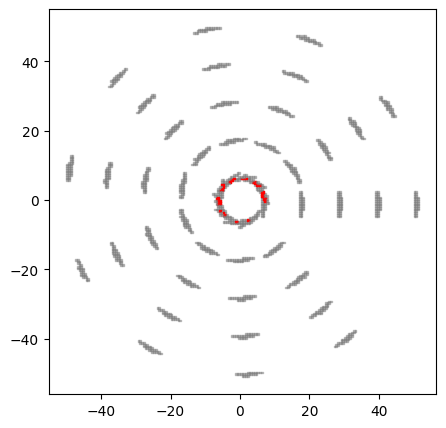

--------------------------------------------------
label: VentHole Chromosome_899: ['TriangleShape_191', 'CircularStrictTransformation_10']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


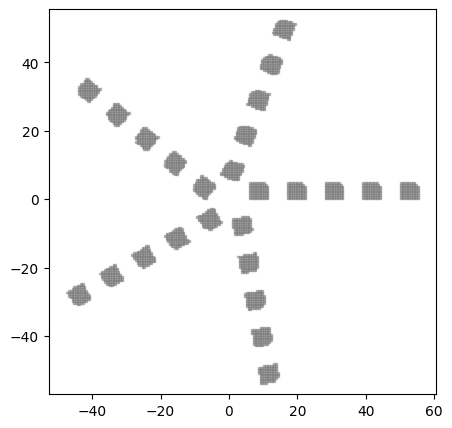

--------------------------------------------------
label: VentHole Chromosome_33: ['TriangleShape_899', 'CircularStrictTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


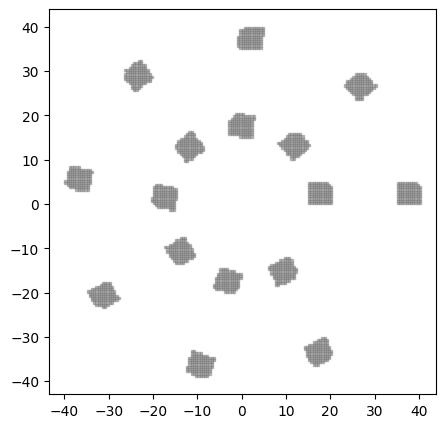

--------------------------------------------------
label: VentHole Chromosome_329: ['TriangleShape_33', 'CircularStrictTransformation_319']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.004327781526493, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


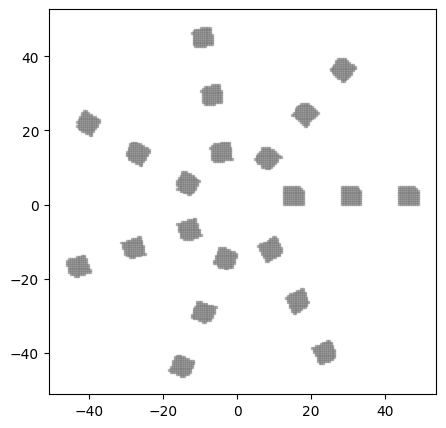

--------------------------------------------------
label: VentHole Chromosome_499: ['DonutShape_346', 'CircularStrictTransformation_19']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.483321946706122, ]


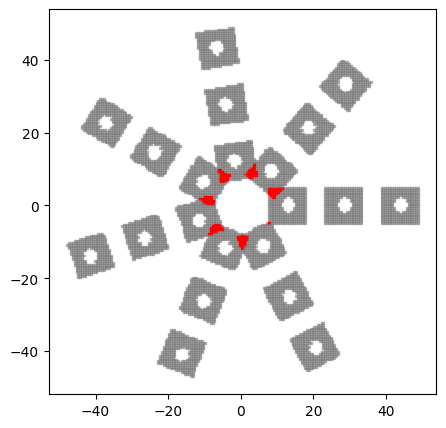

--------------------------------------------------
label: VentHole Chromosome_712: ['DonutShape_19', 'CircularStrictTransformation_379']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


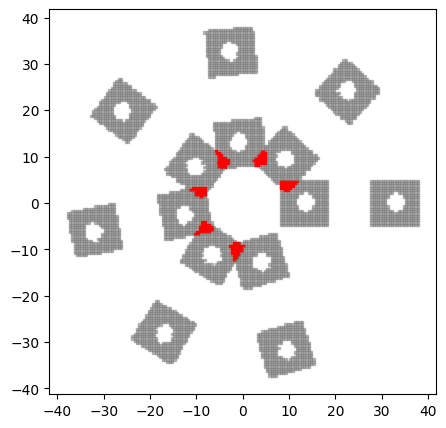

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_928', 'GridStrictTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


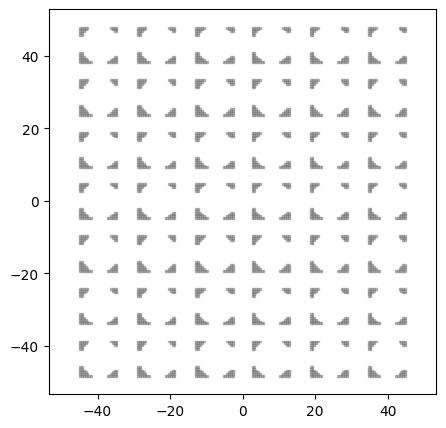

--------------------------------------------------
label: VentHole Chromosome_674: ['DoubleParabolicShape_694', 'GridStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4589928758275925, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


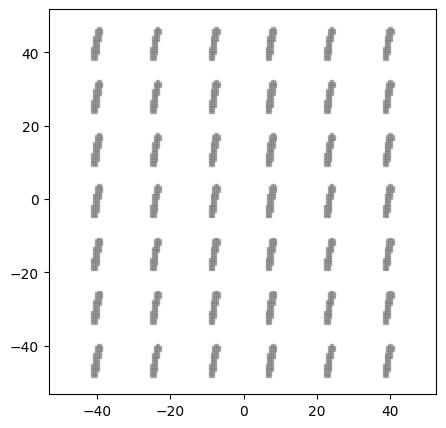

--------------------------------------------------
label: VentHole Chromosome_398: ['DonutShape_884', 'GridStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.761051345084564, r_outer: 9.241956798635755, ]
pattern parameter:
parameter_list: [ dx: 5.3723372362290815, dy: 1.3940027386743572, ]


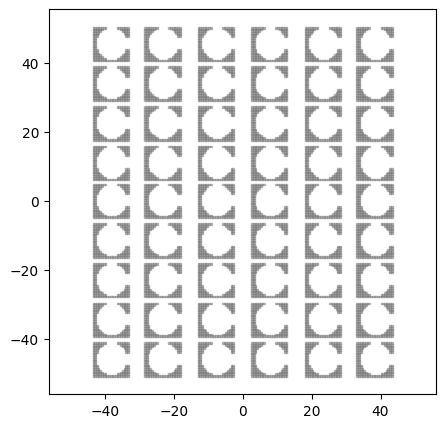

--------------------------------------------------
label: VentHole Chromosome_765: ['DonutShape_398', 'CornerTransformation_261']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.761051345084564, r_outer: 9.241956798635755, ]
pattern parameter:
parameter_list: [ di: 11.540744726128407, dx: 9.88983082456521, phi: 0.7678887097189364, rot_count: 6.0, ]


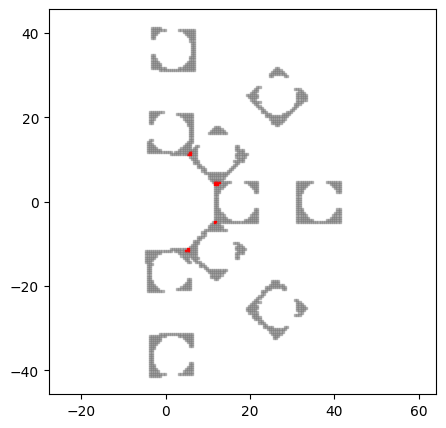

--------------------------------------------------
label: VentHole Chromosome_514: ['TrapezoidShape_740', 'CornerTransformation_765']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.6356664049869387, k2: 1.5077611655780991, ]
pattern parameter:
parameter_list: [ di: 11.540744726128407, dx: 9.88983082456521, phi: 0.7678887097189364, rot_count: 6.0, ]


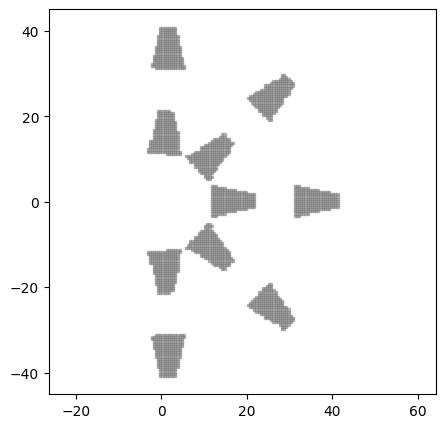

--------------------------------------------------
label: VentHole Chromosome_740: ['TrapezoidShape_514', 'CircularStrictTransformation_443']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.6356664049869387, k2: 1.5077611655780991, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 5.807728062127912, phi: 0.483321946706122, ]


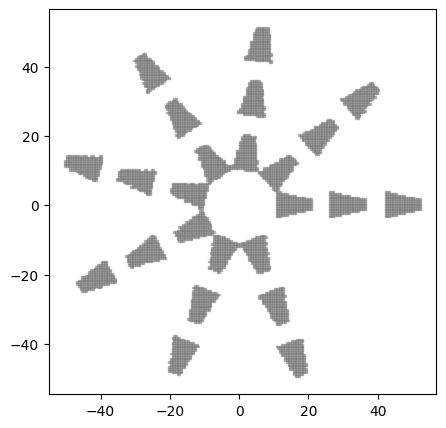

--------------------------------------------------
label: VentHole Chromosome_445: ['RayShape_10', 'GridStrictTransformation_16']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


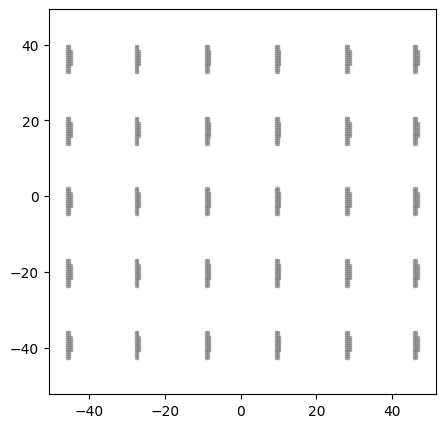

--------------------------------------------------
label: VentHole Chromosome_889: ['TriangleShape_548', 'GridStrictTransformation_445']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


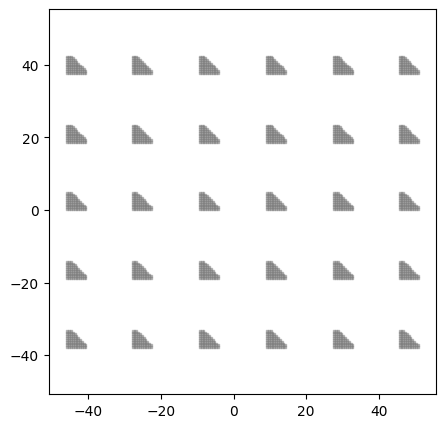

--------------------------------------------------
label: VentHole Chromosome_108: ['TriangleShape_889', 'CircularStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


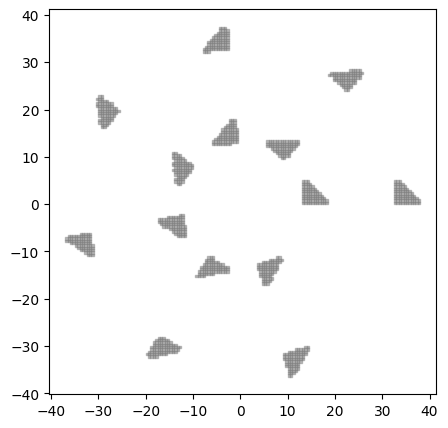

--------------------------------------------------
label: VentHole Chromosome_792: ['DoubleParabolicShape_10', 'CircularStrictTransformation_108']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.4175014634953778, upper_coefficient: 1.5834992903871752, lower_y-intercept: 1.6554269175941352, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 1.3339051227738343, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


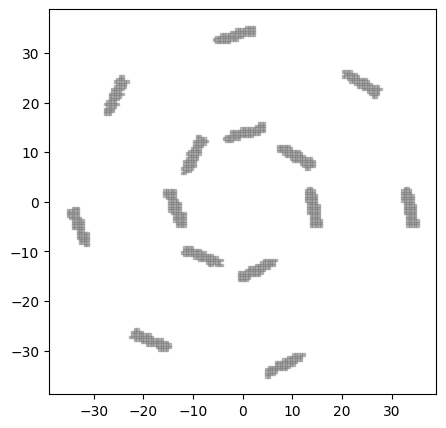

--------------------------------------------------
label: VentHole Chromosome_319: ['DoubleParabolicShape_792', 'GridStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.4175014634953778, upper_coefficient: 1.5834992903871752, lower_y-intercept: 1.6554269175941352, upper_y-intercept_from_lower_y: 1.1193350232545827, lower_x_trans: 1.3339051227738343, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


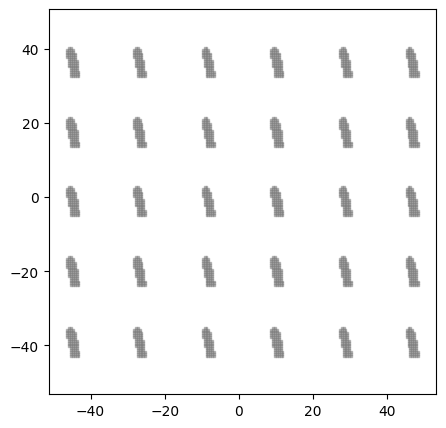

--------------------------------------------------
label: VentHole Chromosome_349: ['CircleShape_349', 'CornerTransformation_420']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


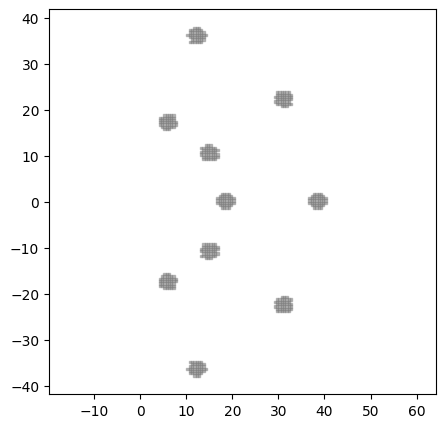

--------------------------------------------------
label: VentHole Chromosome_367: ['DonutShape_34', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 12.398982960418554, dx: 9.88983082456521, phi: 0.7853981633974483, ]


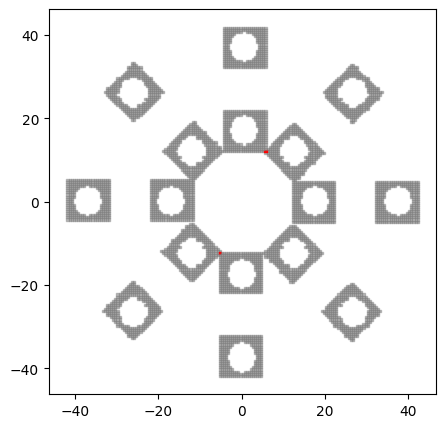

--------------------------------------------------
label: VentHole Chromosome_556: ['TriangleShape_916', 'CircularStrictTransformation_191']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


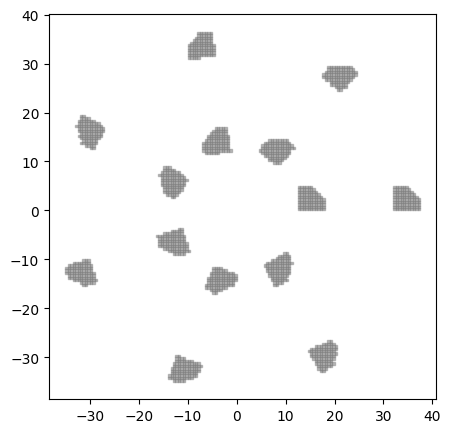

--------------------------------------------------
label: VentHole Chromosome_489: ['DoubleParabolicShape_948', 'CircularStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


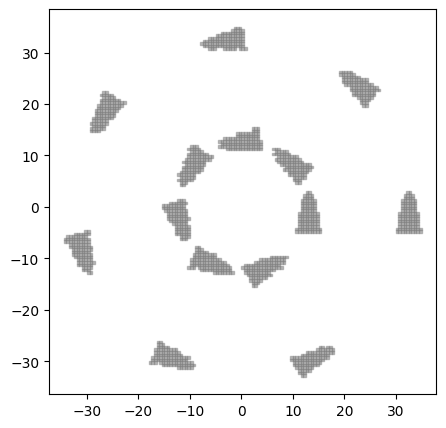

--------------------------------------------------
label: VentHole Chromosome_167: ['TriangleShape_167', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 0.7943149583733558, phi: 0.7853981633974483, ]


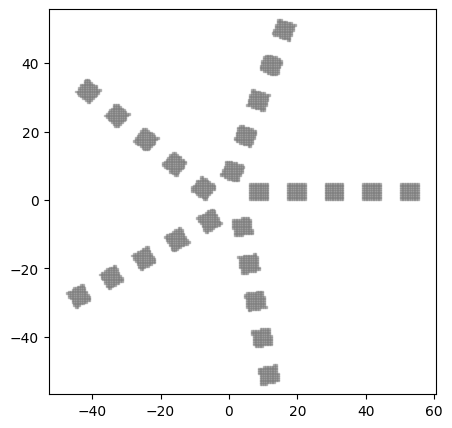

--------------------------------------------------
label: VentHole Chromosome_34: ['DoubleParabolicShape_34', 'CircularStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.5556779074696199, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 0.1623928848025571, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


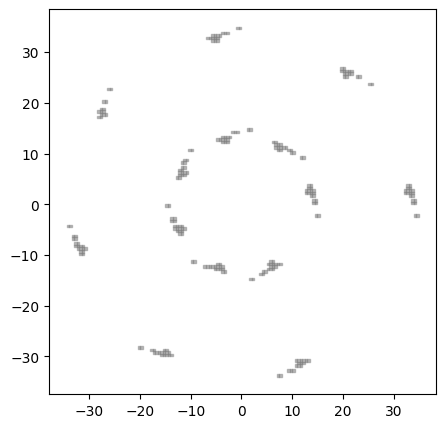

--------------------------------------------------
label: VentHole Chromosome_694: ['CircleShape_836', 'CircularStrictTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.6784555116912765, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


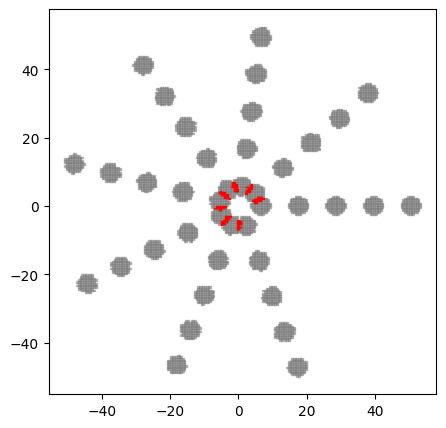

--------------------------------------------------
label: VentHole Chromosome_920: ['DoubleParabolicShape_613', 'GridStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.9555316046270645, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


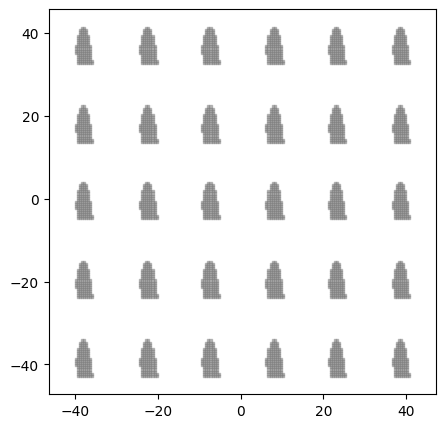

--------------------------------------------------
label: VentHole Chromosome_766: ['DoubleParabolicShape_920', 'CornerTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.9555316046270645, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


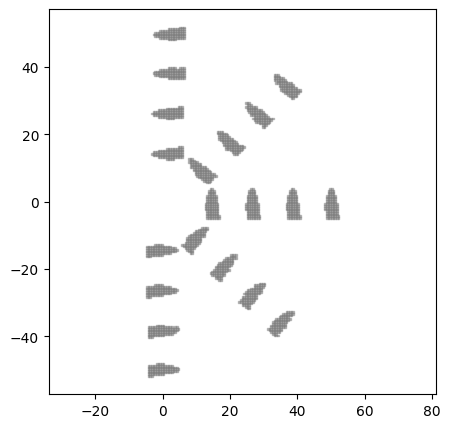

--------------------------------------------------
label: VentHole Chromosome_889: ['TriangleShape_16', 'CornerTransformation_766']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.4785459301078606, rot_count: 6.0, ]


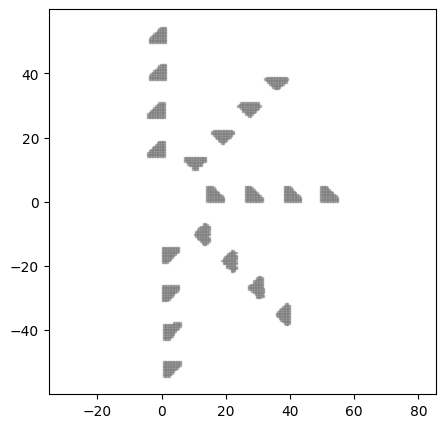

--------------------------------------------------
label: VentHole Chromosome_548: ['TriangleShape_889', 'CircularStrictTransformation_67']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


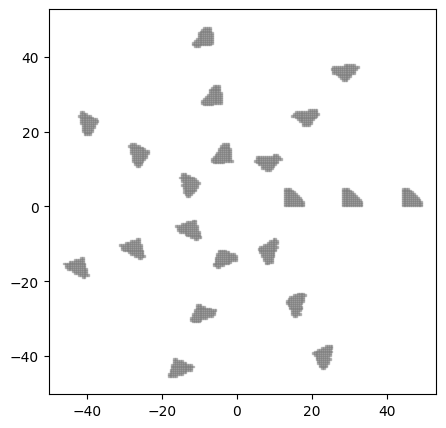

--------------------------------------------------
label: VentHole Chromosome_142: ['HoleShape_363', 'CircularStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


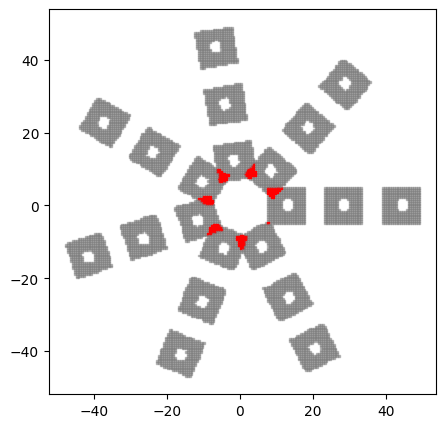

--------------------------------------------------
label: VentHole Chromosome_142: ['HoleShape_142', 'CircularStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 9.311063645313213, dx: 2.152594314077721, phi: 0.4487989505128276, ]


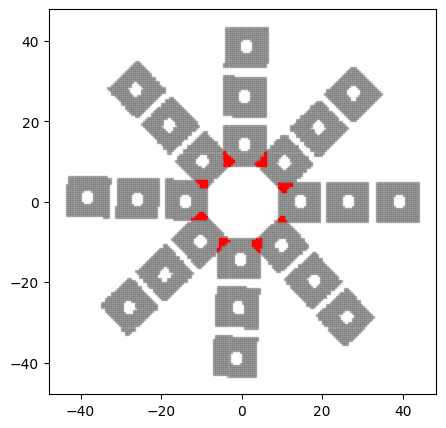

--------------------------------------------------
label: VentHole Chromosome_916: ['DonutShape_274', 'CircularStrictTransformation_142']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.311063645313213, dx: 2.152594314077721, phi: 0.4487989505128276, ]


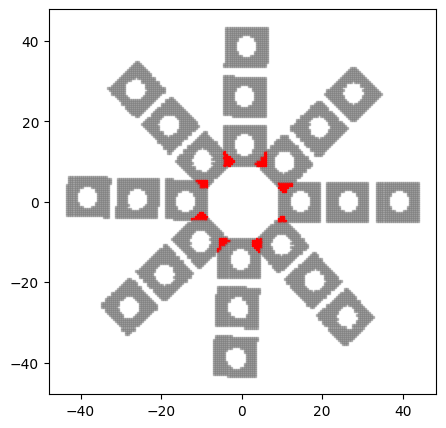

--------------------------------------------------
label: VentHole Chromosome_205: ['DonutShape_916', 'GridStrictTransformation_86']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.8792429519844664, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


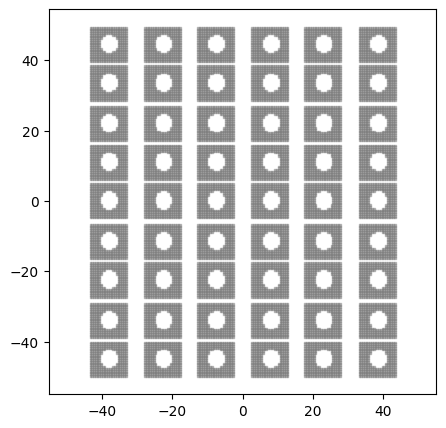

--------------------------------------------------
label: VentHole Chromosome_509: ['WingShape_443', 'GridStrictTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


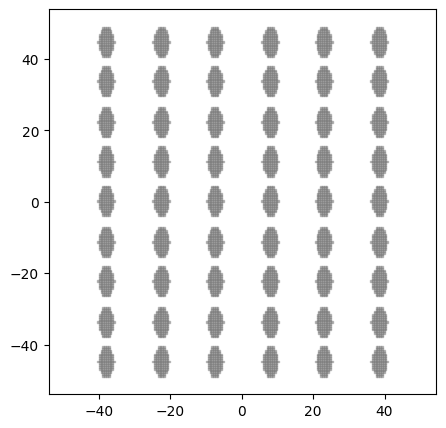

--------------------------------------------------
label: VentHole Chromosome_317: ['WingShape_509', 'CircularStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.442337671675415, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


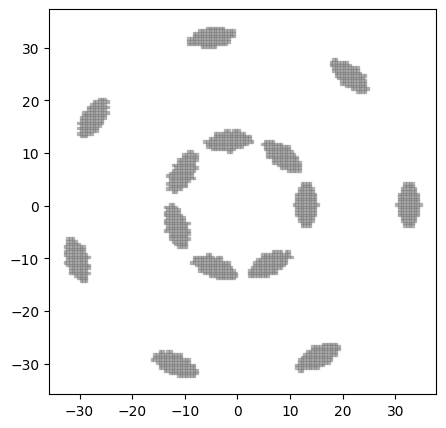

--------------------------------------------------
label: VentHole Chromosome_971: ['WingShape_971', 'GridStrictTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.939220992249961, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


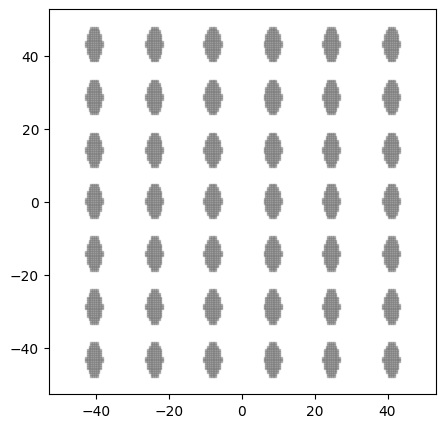

--------------------------------------------------
label: VentHole Chromosome_540: ['RayShape_300', 'CircularStrictTransformation_829']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.7249107623978768, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


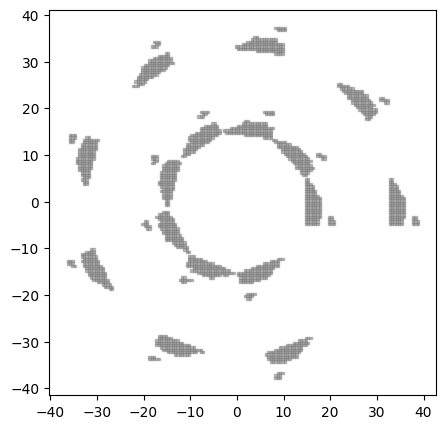

--------------------------------------------------
label: VentHole Chromosome_829: ['TriangleShape_167', 'CornerTransformation_443']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 13.708230140698722, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


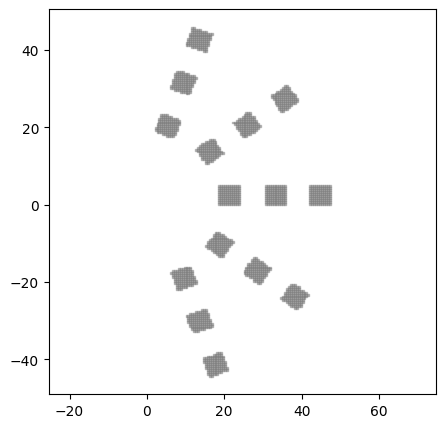

--------------------------------------------------
label: VentHole Chromosome_467: ['RayShape_685', 'GridStrictTransformation_706']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.6559143436561357, nose_point: 1.227754993634589, lower_coefficient: 3.3595026999583957, lower_x-intercept: 1.4318805033924202, lower_y-intercept: 1.6110833899145065, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


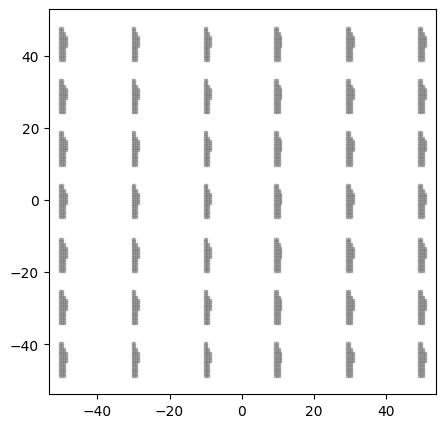

--------------------------------------------------
label: VentHole Chromosome_306: ['RayShape_420', 'GridStrictTransformation_467']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


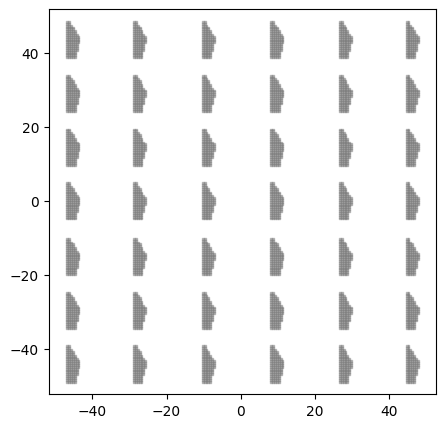

--------------------------------------------------
label: VentHole Chromosome_792: ['DonutShape_540', 'CircularStrictTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.356176217981065, r_outer: 8.600344704619449, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


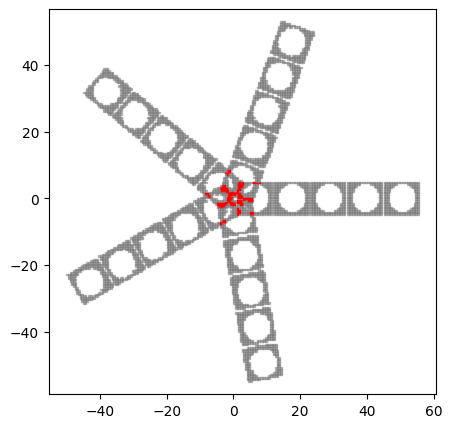

--------------------------------------------------
label: VentHole Chromosome_463: ['DonutShape_792', 'GridStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.356176217981065, r_outer: 8.600344704619449, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


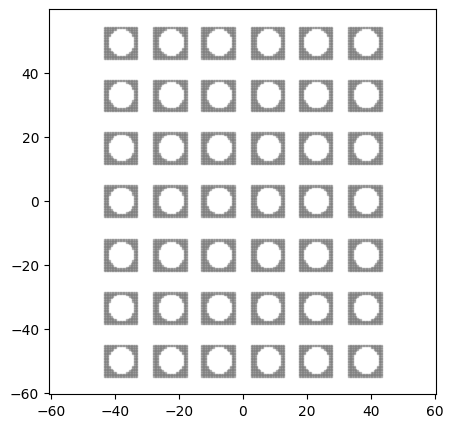

--------------------------------------------------
label: VentHole Chromosome_991: ['HoleShape_142', 'GridStrictTransformation_463']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.999594967018924, ]


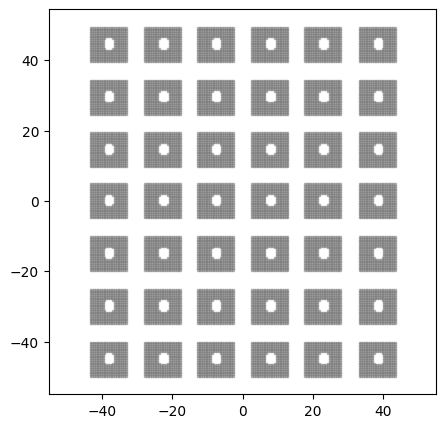

--------------------------------------------------
label: VentHole Chromosome_367: ['HoleShape_991', 'CircularStrictTransformation_258']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 14.356906849561378, dx: 9.832462236362868, phi: 0.6981317007977318, ]


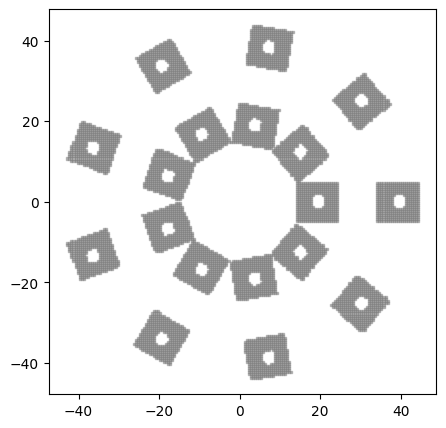

--------------------------------------------------
label: VentHole Chromosome_258: ['DoubleParabolicShape_964', 'CircularStrictTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.863197303829144, upper_coefficient: 2.0833663276112597, lower_y-intercept: 2.825243246658168, upper_y-intercept_from_lower_y: 1.8032402298466856, lower_x_trans: 1.4620855337477492, ]
pattern parameter:
parameter_list: [ di: 14.356906849561378, dx: 9.832462236362868, phi: 0.6981317007977318, ]


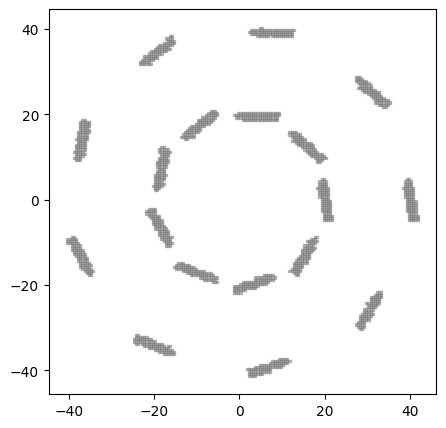

--------------------------------------------------
label: VentHole Chromosome_42: ['TriangleShape_556', 'CircularStrictTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.524146515153322, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


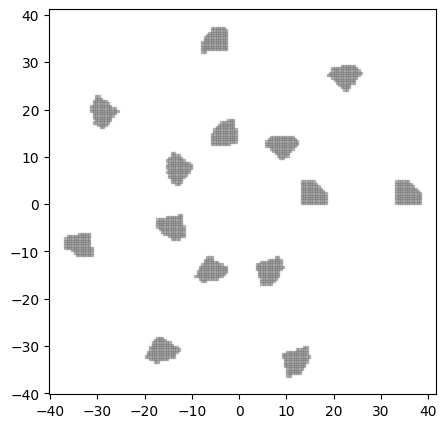

--------------------------------------------------
label: VentHole Chromosome_496: ['TrapezoidShape_388', 'CornerTransformation_459']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.808328061181311, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


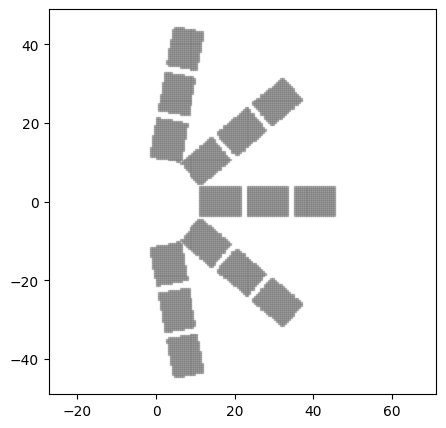

--------------------------------------------------
label: VentHole Chromosome_42: ['TriangleShape_388', 'GridStrictTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 9.449411010547928, dy: 1.3940027386743572, ]


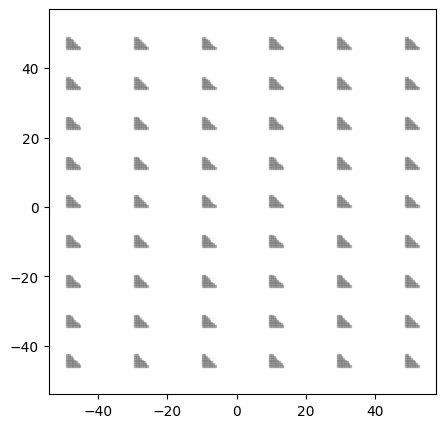

--------------------------------------------------
label: VentHole Chromosome_823: ['DoubleParabolicShape_722', 'CornerTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 8.745123640700152, phi: 0.7678887097189364, rot_count: 6.0, ]


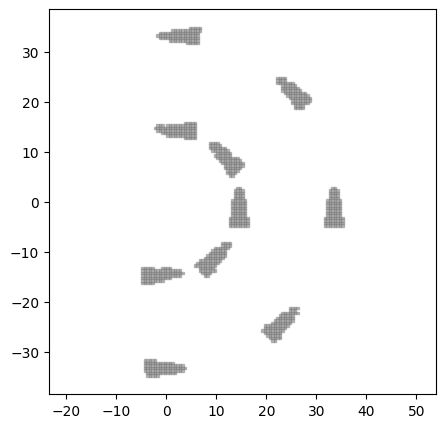

--------------------------------------------------
label: VentHole Chromosome_729: ['DoubleParabolicShape_823', 'CornerTransformation_808']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


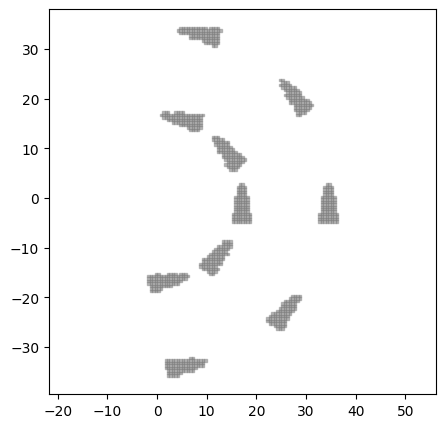

--------------------------------------------------
label: VentHole Chromosome_15: ['TrapezoidShape_898', 'CornerTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


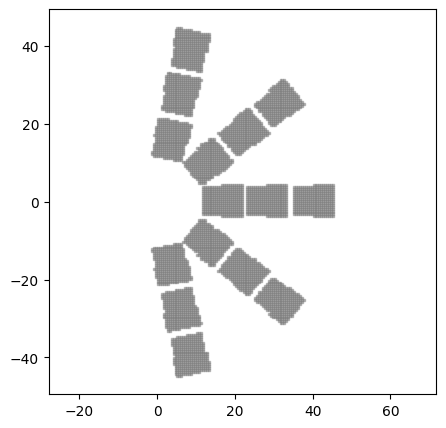

--------------------------------------------------
label: VentHole Chromosome_251: ['DonutShape_942', 'GridStrictTransformation_749']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


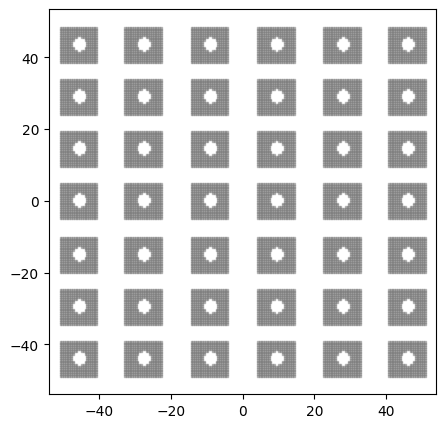

--------------------------------------------------
label: VentHole Chromosome_329: ['DonutShape_251', 'CircularStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


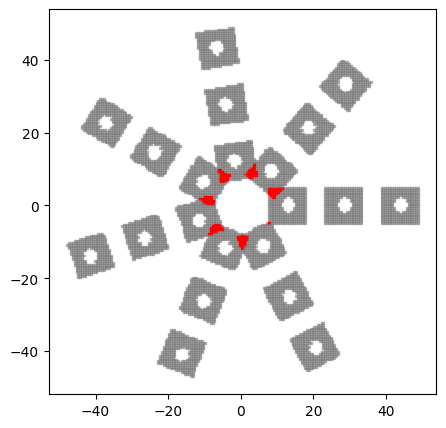

--------------------------------------------------
label: VentHole Chromosome_499: ['TriangleShape_548', 'CircularStrictTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


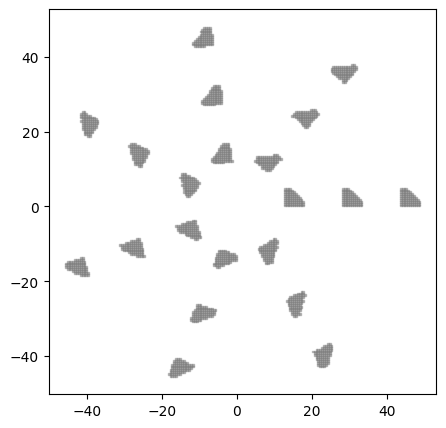

--------------------------------------------------
label: VentHole Chromosome_459: ['TriangleShape_499', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.620161296927049, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.717701356042855, phi: 0.7853981633974483, ]


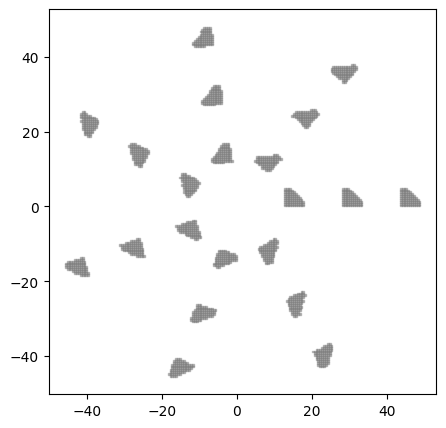

--------------------------------------------------
label: VentHole Chromosome_7: ['TrapezoidShape_765', 'CornerTransformation_617']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 13.655511345245689, dx: 8.201841862514968, phi: 0.5260152146445685, rot_count: 2.0, ]


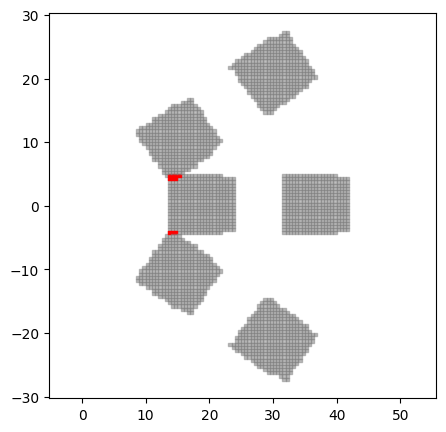

--------------------------------------------------
label: VentHole Chromosome_749: ['CircleShape_823', 'CircularStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


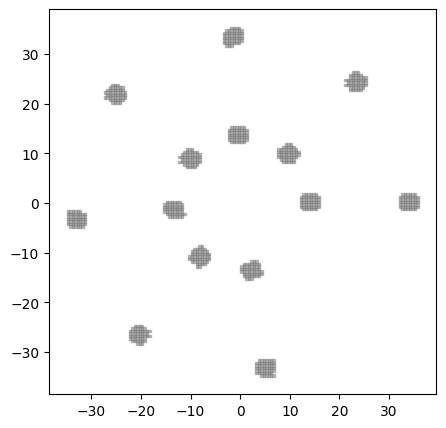

--------------------------------------------------
label: VentHole Chromosome_600: ['TrapezoidShape_668', 'CircularStrictTransformation_298']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


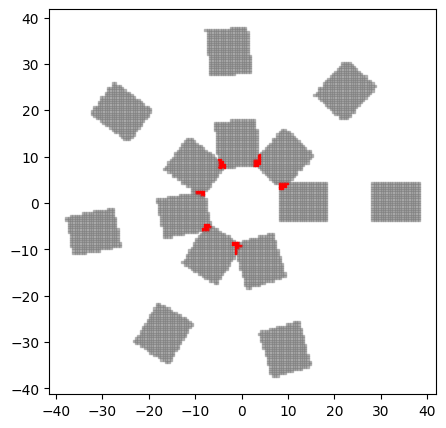

--------------------------------------------------
label: VentHole Chromosome_355: ['CircleShape_329', 'GridStrictTransformation_674']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.58398077439835, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


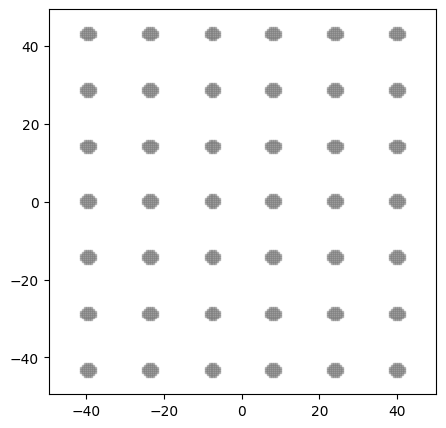

--------------------------------------------------
label: VentHole Chromosome_367: ['TriangleShape_42', 'CornerTransformation_304']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.4664540289461003, phi: 0.5587425220674574, rot_count: 4.0, ]


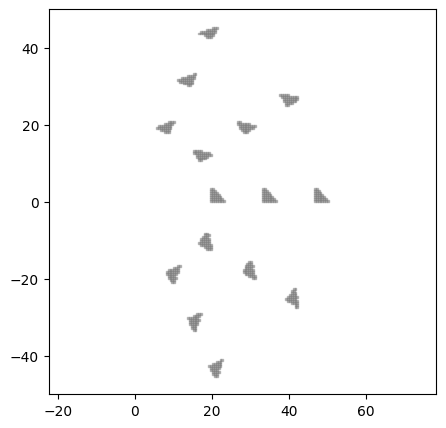

--------------------------------------------------
label: VentHole Chromosome_556: ['TriangleShape_367', 'CornerTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.338635932295716, phi: 0.5326911441693254, rot_count: 4.0, ]


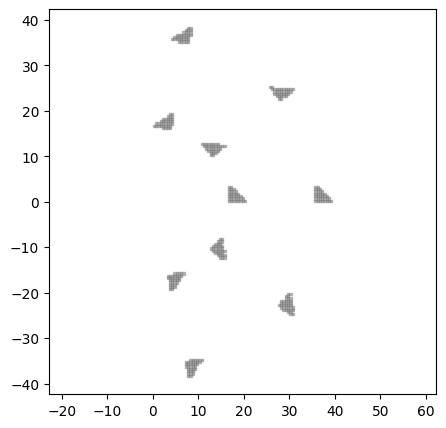

--------------------------------------------------
label: VentHole Chromosome_363: ['CircleShape_167', 'CornerTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.338635932295716, phi: 0.5326911441693254, rot_count: 4.0, ]


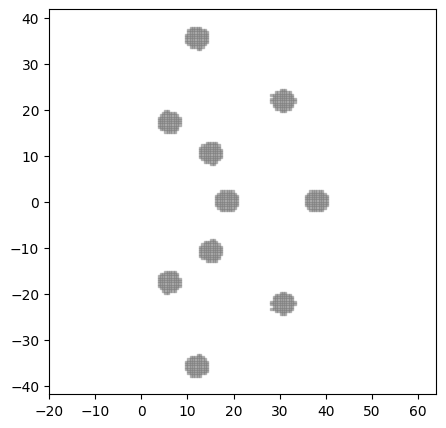

--------------------------------------------------
label: VentHole Chromosome_948: ['RayShape_445', 'CornerTransformation_576']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


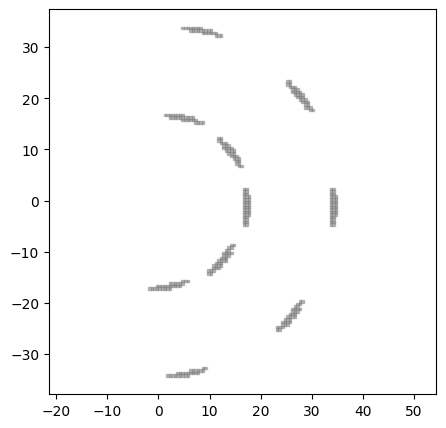

--------------------------------------------------
label: VentHole Chromosome_10: ['DonutShape_948', 'CornerTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 8.780235503775744, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 8.745123640700152, phi: 0.7678887097189364, rot_count: 6.0, ]


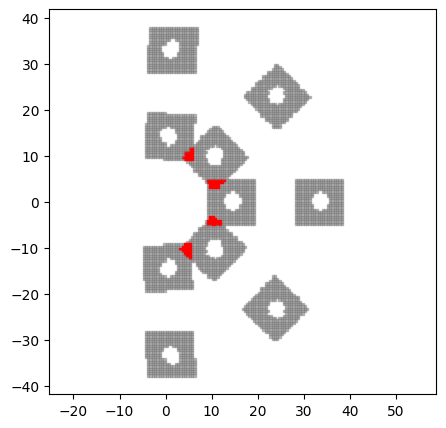

--------------------------------------------------
label: VentHole Chromosome_810: ['WingShape_366', 'CornerTransformation_729']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


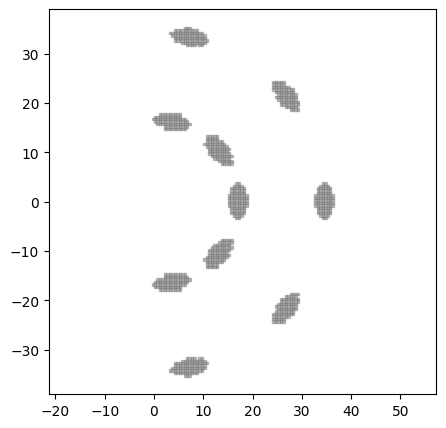

--------------------------------------------------
label: VentHole Chromosome_458: ['DoubleParabolicShape_298', 'GridStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.2593728075358106, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ dx: 6.624524664029363, dy: 6.850813481976112, ]


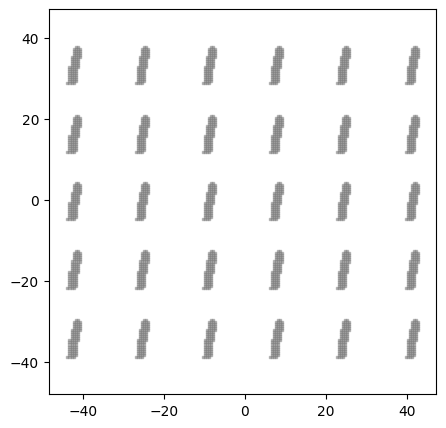

--------------------------------------------------
label: VentHole Chromosome_647: ['TrapezoidShape_823', 'CornerTransformation_11']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.2586335040728227, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


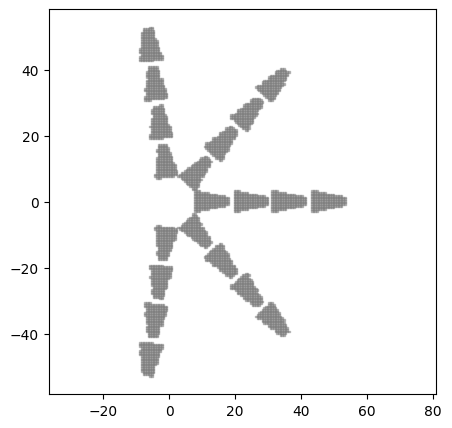

--------------------------------------------------
label: VentHole Chromosome_319: ['DoubleParabolicShape_729', 'GridStrictTransformation_188']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


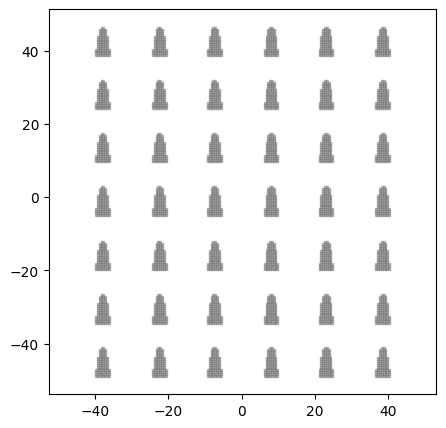

--------------------------------------------------
label: VentHole Chromosome_871: ['TriangleShape_388', 'GridStrictTransformation_920']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


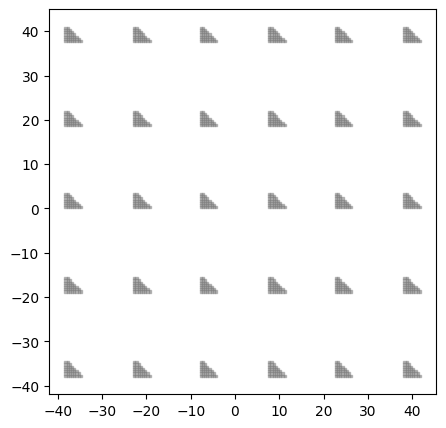

--------------------------------------------------
label: VentHole Chromosome_488: ['RayShape_306', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 0.7943149583733558, phi: 0.7853981633974483, ]


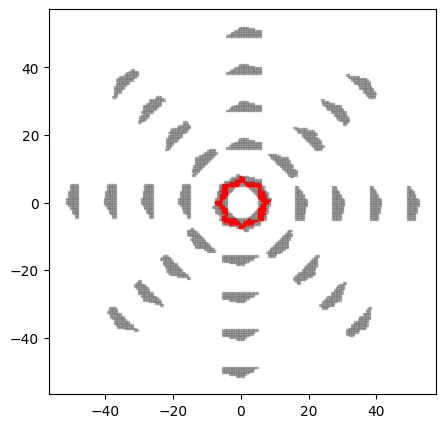

--------------------------------------------------
label: VentHole Chromosome_220: ['TriangleShape_919', 'CornerTransformation_349']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


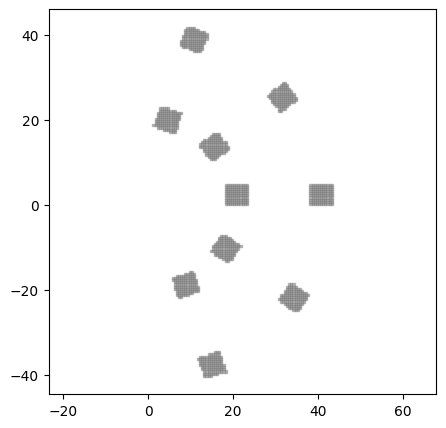

--------------------------------------------------
label: VentHole Chromosome_277: ['DonutShape_712', 'CornerTransformation_220']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 9.83467714163689, phi: 0.5326911441693254, rot_count: 4.0, ]


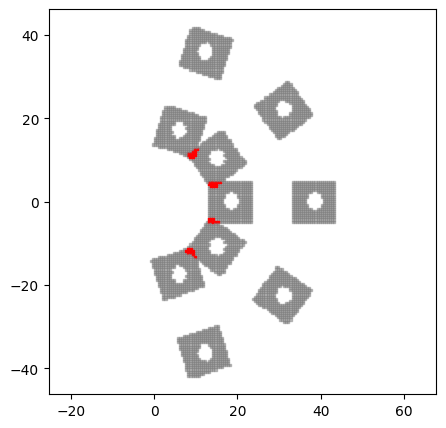

--------------------------------------------------
label: VentHole Chromosome_447: ['DoubleParabolicShape_44', 'CircularStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 3.572072892139567, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


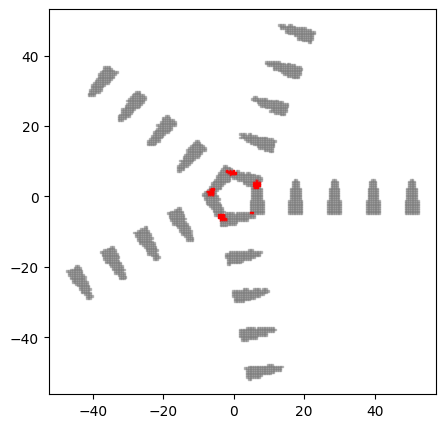

--------------------------------------------------
label: VentHole Chromosome_509: ['DoubleParabolicShape_447', 'CornerTransformation_367']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.1180596791649, upper_coefficient: 2.663958798536516, lower_y-intercept: 3.572072892139567, upper_y-intercept_from_lower_y: 1.296285965612391, lower_x_trans: 4.030535701189375, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.4664540289461003, phi: 0.5587425220674574, rot_count: 4.0, ]


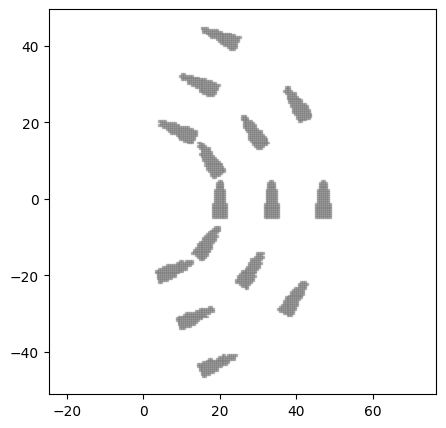

--------------------------------------------------
label: VentHole Chromosome_729: ['DoubleParabolicShape_319', 'GridStrictTransformation_509']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


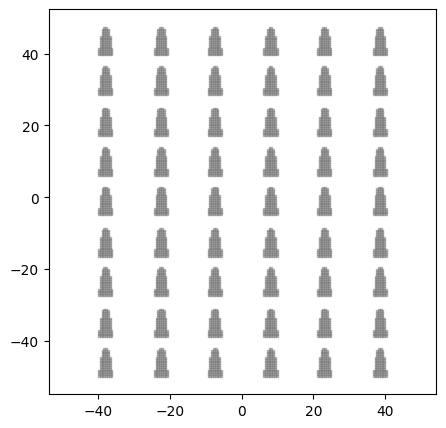

--------------------------------------------------
label: VentHole Chromosome_105: ['TriangleShape_829', 'GridStrictTransformation_729']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.722810248898021, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


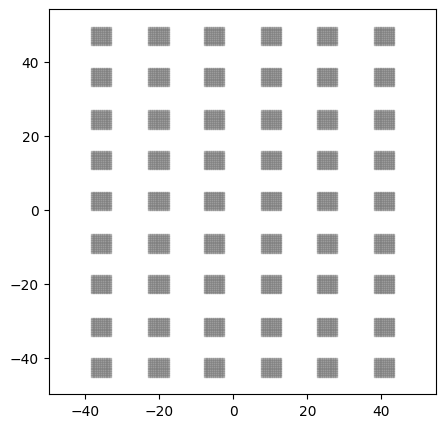

--------------------------------------------------
label: VentHole Chromosome_548: ['DonutShape_329', 'CornerTransformation_310']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 3.4664540289461003, phi: 0.5475971844298017, rot_count: 4.0, ]


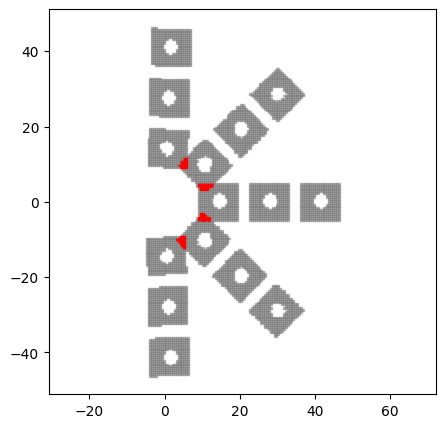

--------------------------------------------------
label: VentHole Chromosome_316: ['DonutShape_548', 'GridStrictTransformation_388']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 6.850813481976112, ]


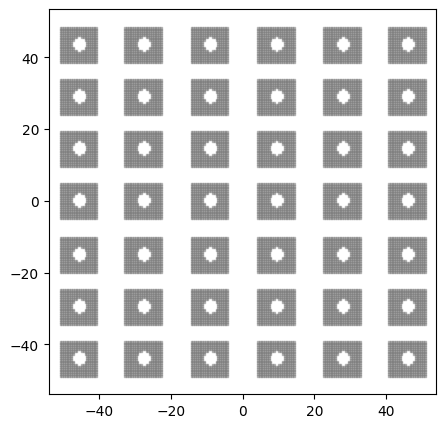

--------------------------------------------------
label: VentHole Chromosome_388: ['WingShape_984', 'GridStrictTransformation_316']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.6702101322494394, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 6.850813481976112, ]


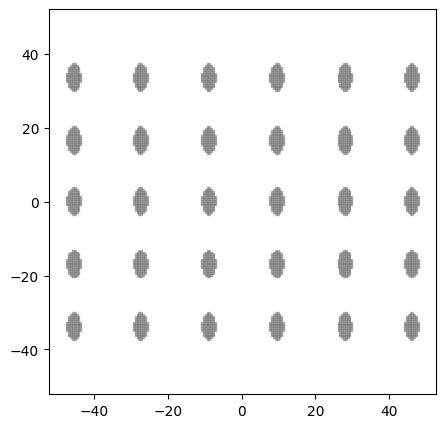

--------------------------------------------------
label: VentHole Chromosome_984: ['HoleShape_692', 'CircularStrictTransformation_499']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


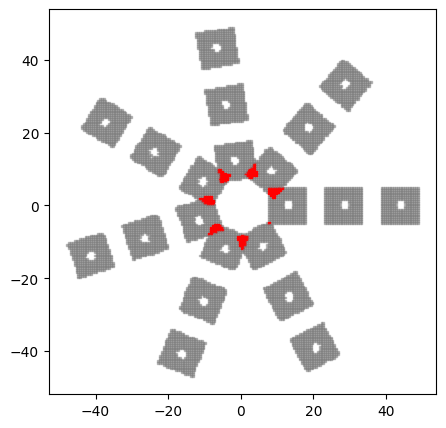

--------------------------------------------------
label: VentHole Chromosome_692: ['HoleShape_984', 'CornerTransformation_15']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.498115386778178, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


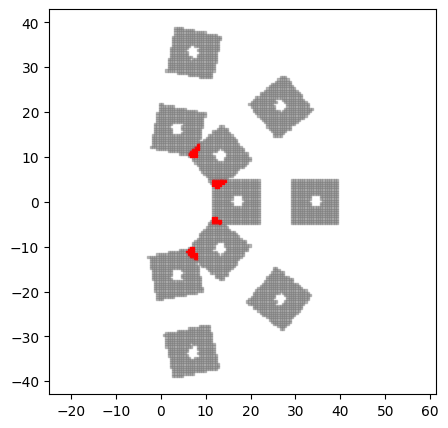

--------------------------------------------------
label: VentHole Chromosome_205: ['TrapezoidShape_355', 'CornerTransformation_692']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


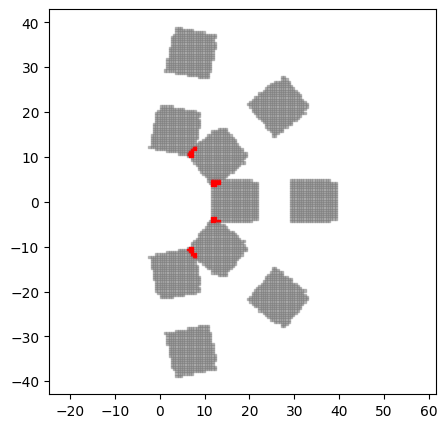

--------------------------------------------------
label: VentHole Chromosome_961: ['TrapezoidShape_205', 'GridStrictTransformation_306']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


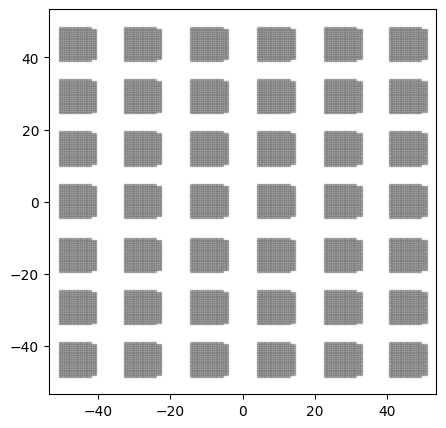

--------------------------------------------------
label: VentHole Chromosome_613: ['TrapezoidShape_205', 'GridStrictTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


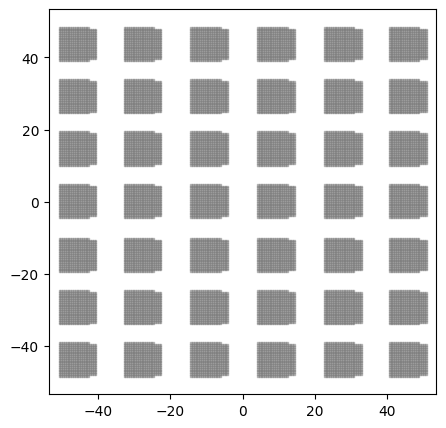

--------------------------------------------------
label: VentHole Chromosome_62: ['TrapezoidShape_613', 'CircularStrictTransformation_366']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


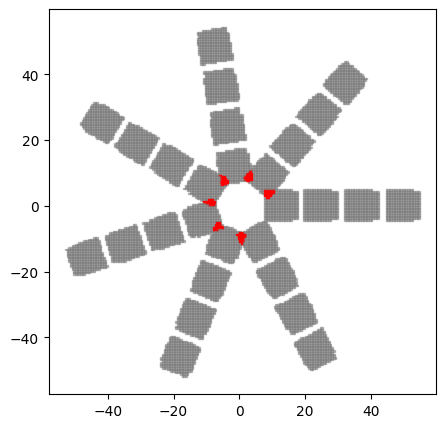

--------------------------------------------------
label: VentHole Chromosome_86: ['TrapezoidShape_298', 'CircularStrictTransformation_62']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


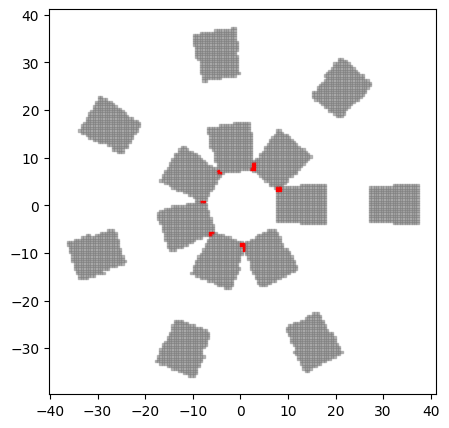

--------------------------------------------------
label: VentHole Chromosome_536: ['DoubleParabolicShape_729', 'CircularStrictTransformation_109']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


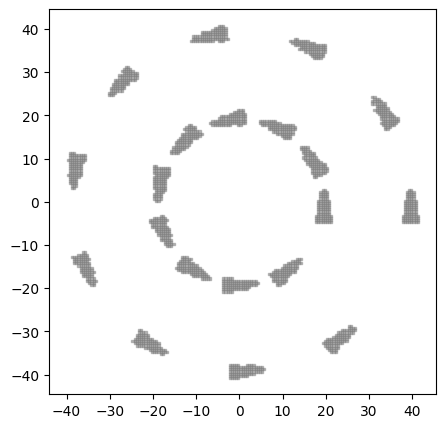

--------------------------------------------------
label: VentHole Chromosome_729: ['DoubleParabolicShape_536', 'CornerTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


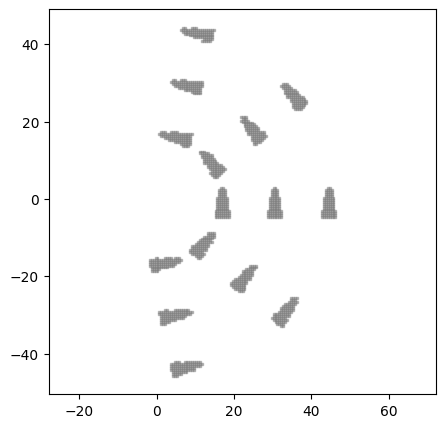

--------------------------------------------------
label: VentHole Chromosome_10: ['DonutShape_367', 'CornerTransformation_729']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


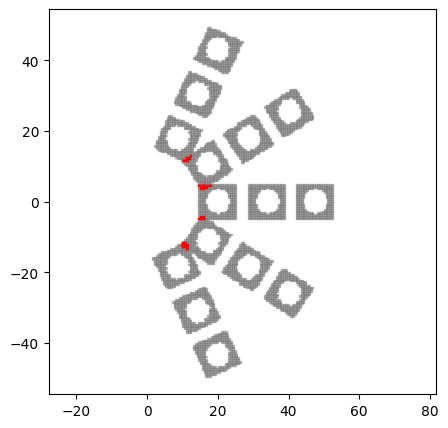

--------------------------------------------------
label: VentHole Chromosome_955: ['DoubleParabolicShape_277', 'GridStrictTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.4174942054915576, upper_coefficient: 1.249673118916605, lower_y-intercept: 2.8390183632154913, upper_y-intercept_from_lower_y: 1.3720732443286665, lower_x_trans: 4.11046742751099, ]
pattern parameter:
parameter_list: [ dx: 6.624524664029363, dy: 6.850813481976112, ]


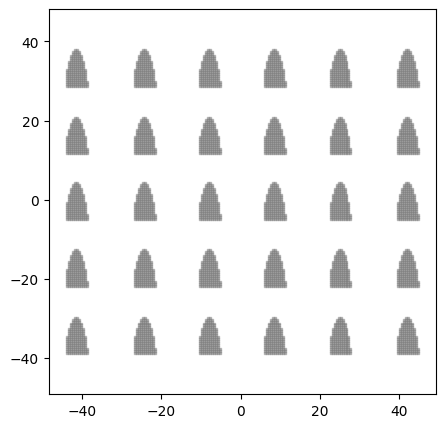

--------------------------------------------------
label: VentHole Chromosome_277: ['DonutShape_928', 'GridStrictTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ dx: 9.449411010547928, dy: 1.3940027386743572, ]


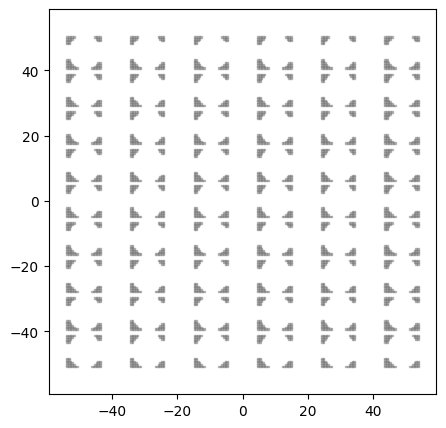

--------------------------------------------------
label: VentHole Chromosome_928: ['DonutShape_277', 'CornerTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 5.576358410476786, r_outer: 8.241937434405388, ]
pattern parameter:
parameter_list: [ di: 13.655511345245689, dx: 8.201841862514968, phi: 0.5260152146445685, rot_count: 2.0, ]


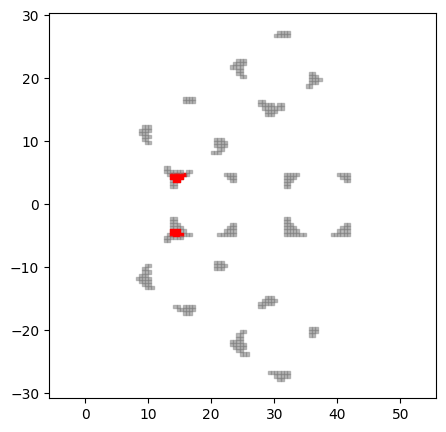

--------------------------------------------------
label: VentHole Chromosome_749: ['RayShape_836', 'CornerTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.3864273081077458, nose_point: 1.6633561681512983, lower_coefficient: 1.2945238092317164, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.945911121840797, ]
pattern parameter:
parameter_list: [ di: 13.655511345245689, dx: 8.201841862514968, phi: 0.5260152146445685, rot_count: 2.0, ]


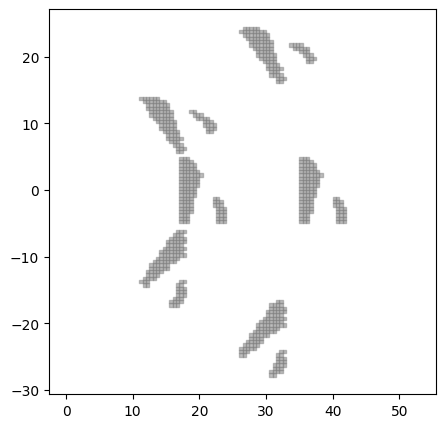

--------------------------------------------------
label: VentHole Chromosome_606: ['RayShape_749', 'GridStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.3864273081077458, nose_point: 1.6633561681512983, lower_coefficient: 1.2945238092317164, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.945911121840797, ]
pattern parameter:
parameter_list: [ dx: 3.8209213763581897, dy: 8.794727031067021, ]


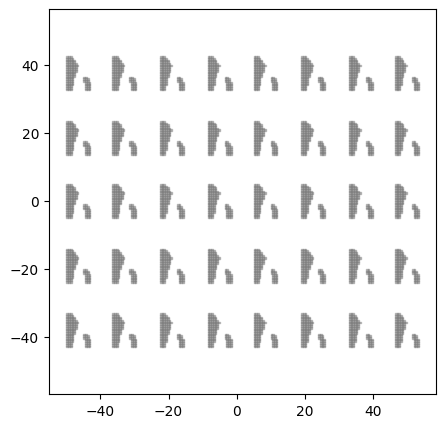

--------------------------------------------------
label: VentHole Chromosome_329: ['TrapezoidShape_929', 'GridStrictTransformation_606']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ dx: 3.8209213763581897, dy: 8.794727031067021, ]


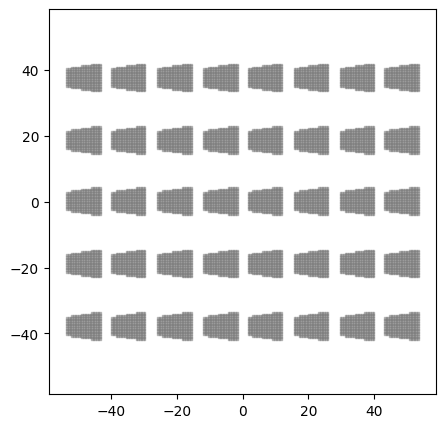

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_329', 'CircularStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


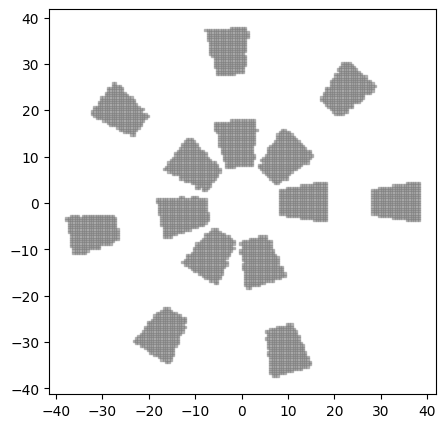

--------------------------------------------------
label: VentHole Chromosome_660: ['DonutShape_536', 'CircularStrictTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.7853981633974483, ]


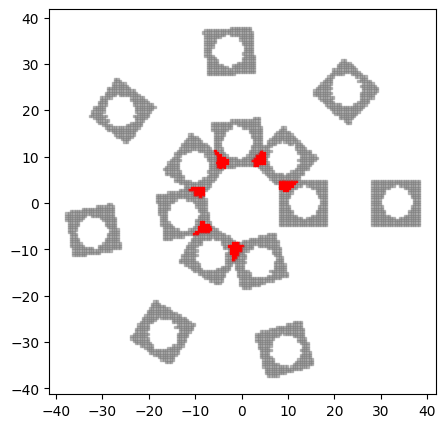

--------------------------------------------------
label: VentHole Chromosome_948: ['TriangleShape_713', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


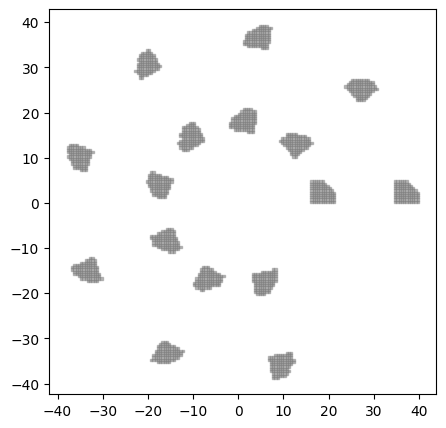

--------------------------------------------------
label: VentHole Chromosome_713: ['TriangleShape_948', 'GridStrictTransformation_548']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ dx: 5.388148083585774, dy: 4.625347881243773, ]


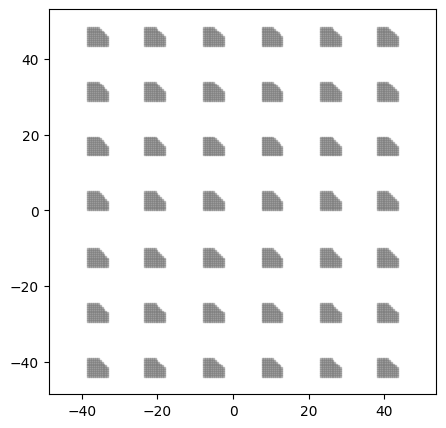

--------------------------------------------------
label: VentHole Chromosome_432: ['HoleShape_649', 'CircularStrictTransformation_791']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 13.089726461453527, dx: 7.500565927872639, phi: 0.7853981633974483, ]


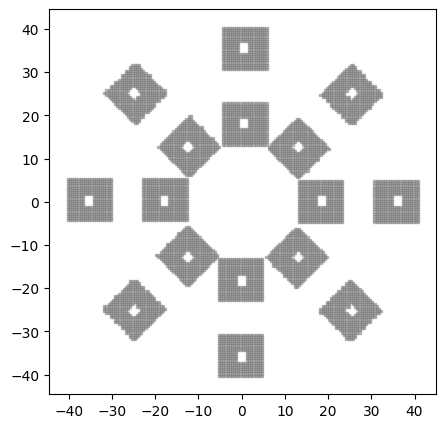

--------------------------------------------------
label: VentHole Chromosome_300: ['DoubleParabolicShape_766', 'CircularStrictTransformation_432']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 13.089726461453527, dx: 7.500565927872639, phi: 0.7853981633974483, ]


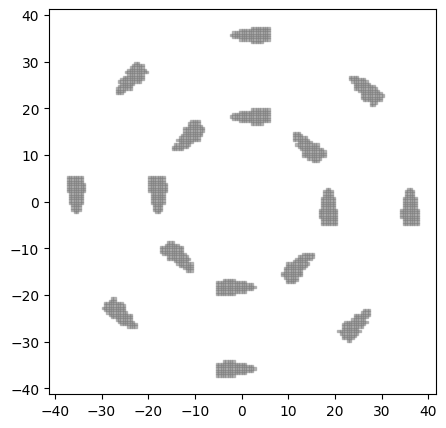

--------------------------------------------------
label: VentHole Chromosome_230: ['DoubleParabolicShape_300', 'CircularStrictTransformation_899']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


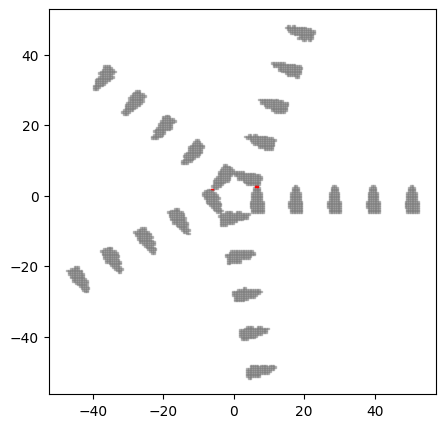

--------------------------------------------------
label: VentHole Chromosome_365: ['TrapezoidShape_600', 'GridStrictTransformation_105']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


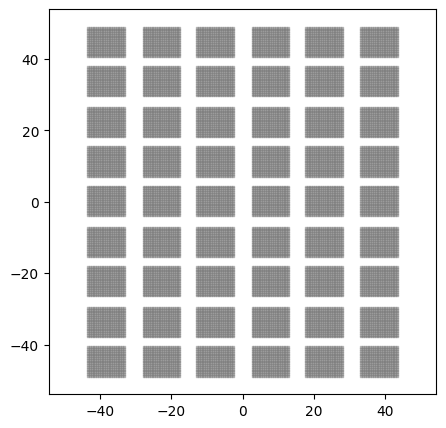

--------------------------------------------------
label: VentHole Chromosome_230: ['CircleShape_531', 'GridStrictTransformation_365']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


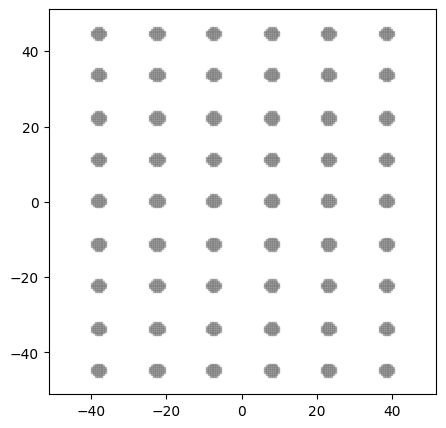

--------------------------------------------------
label: VentHole Chromosome_531: ['CircleShape_230', 'GridStrictTransformation_839']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7762968722627428, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


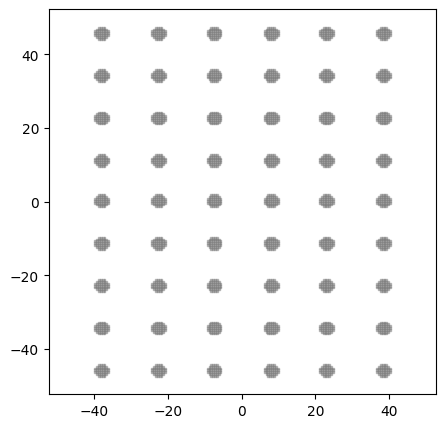

--------------------------------------------------
label: VentHole Chromosome_529: ['CircleShape_126', 'GridStrictTransformation_531']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3597405095053996, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


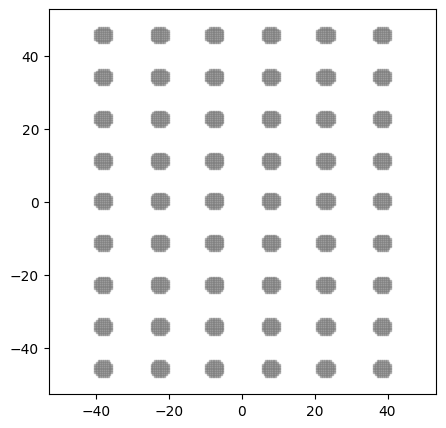

--------------------------------------------------
label: VentHole Chromosome_126: ['CircleShape_529', 'GridStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3597405095053996, ]
pattern parameter:
parameter_list: [ dx: 8.521435006565243, dy: 1.3940027386743572, ]


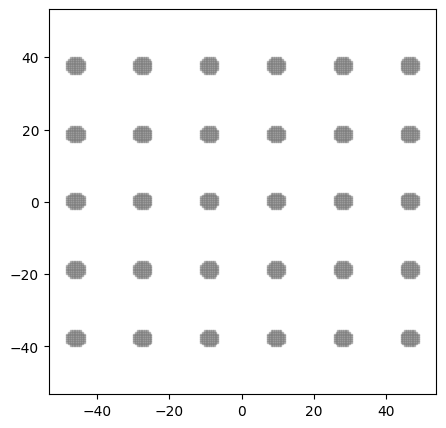

--------------------------------------------------
label: VentHole Chromosome_556: ['DonutShape_884', 'GridStrictTransformation_783']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 9.795259919111736, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 4.625347881243773, ]


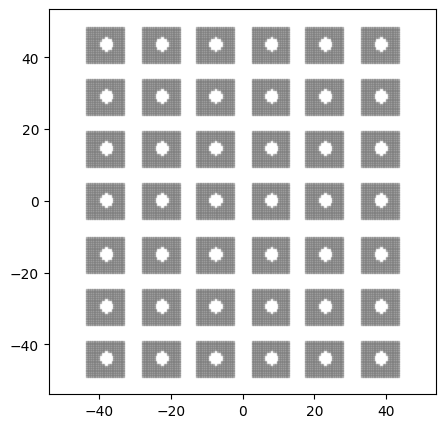

--------------------------------------------------
label: VentHole Chromosome_884: ['CircleShape_363', 'GridStrictTransformation_613']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


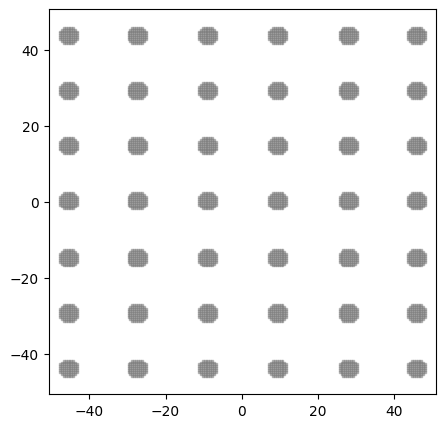

--------------------------------------------------
label: VentHole Chromosome_948: ['WingShape_810', 'CornerTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ di: 9.329276603946518, dx: 7.429882210168095, phi: 0.4782732026857485, rot_count: 2.0, ]


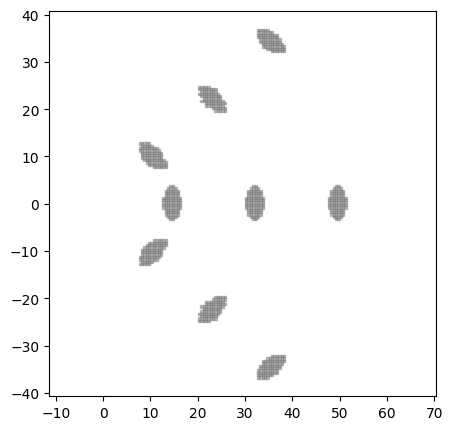

--------------------------------------------------
label: VentHole Chromosome_181: ['WingShape_948', 'CircularStrictTransformation_531']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.538007134989315, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


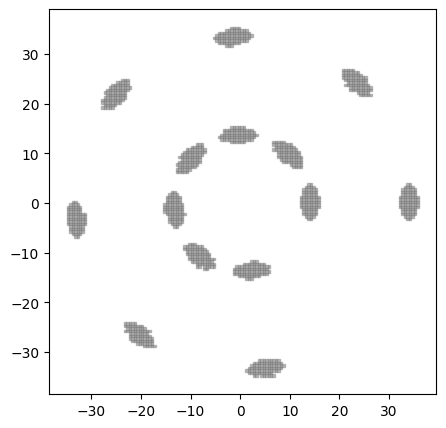

--------------------------------------------------
label: VentHole Chromosome_126: ['TrapezoidShape_7', 'GridStrictTransformation_432']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.502880628557838, dy: 1.3940027386743572, ]


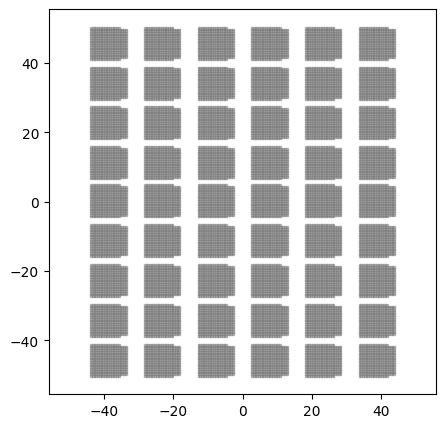

--------------------------------------------------
label: VentHole Chromosome_432: ['WingShape_808', 'CircularStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.895985914328555, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


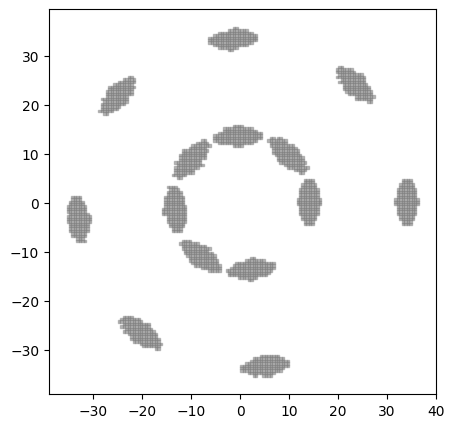

--------------------------------------------------
label: VentHole Chromosome_521: ['CircleShape_531', 'CornerTransformation_751']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.2985740857085455, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


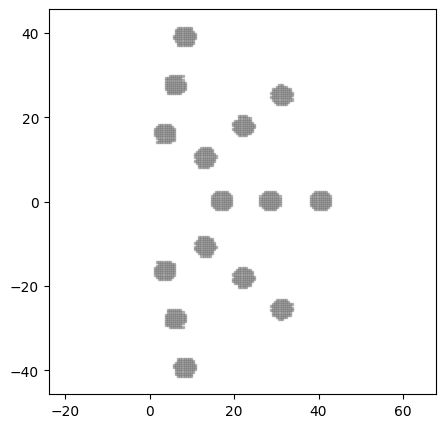

--------------------------------------------------
label: VentHole Chromosome_630: ['DonutShape_660', 'CornerTransformation_521']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


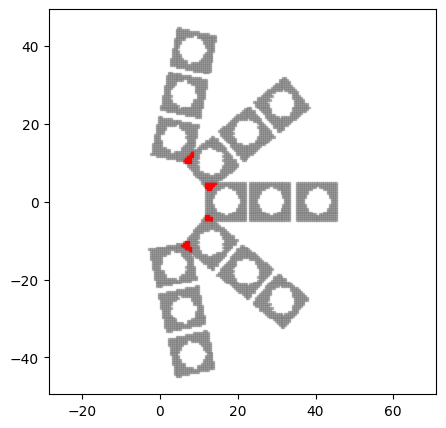

--------------------------------------------------
label: VentHole Chromosome_300: ['RayShape_109', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 13.089726461453527, dx: 7.500565927872639, phi: 0.7853981633974483, ]


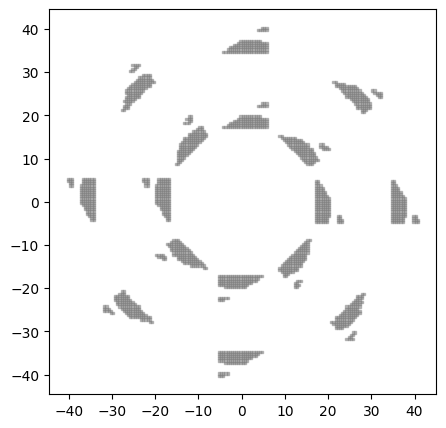

--------------------------------------------------
label: VentHole Chromosome_109: ['HoleShape_367', 'GridStrictTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ dx: 8.473360805396354, dy: 4.999594967018924, ]


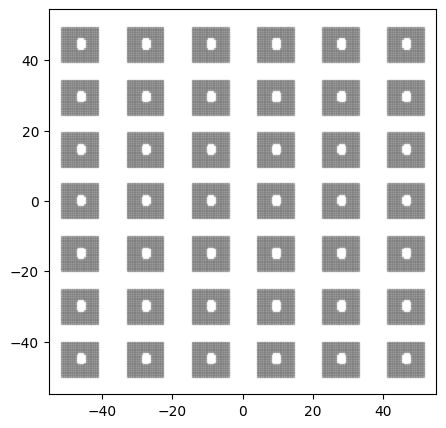

--------------------------------------------------
label: VentHole Chromosome_142: ['HoleShape_109', 'CircularStrictTransformation_489']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.556587748578083, phi: 0.5235987755982988, ]


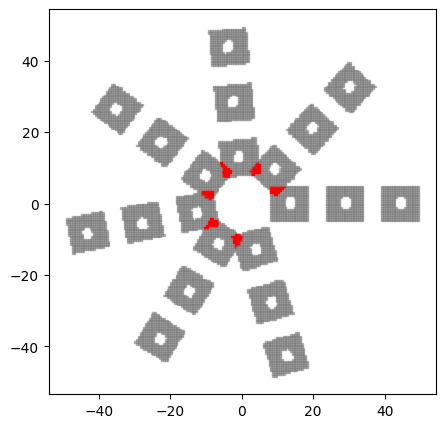

--------------------------------------------------
label: VentHole Chromosome_991: ['TrapezoidShape_62', 'CornerTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 12.63236254093845, dx: 7.429882210168095, phi: 0.5166828267611085, rot_count: 3.0, ]


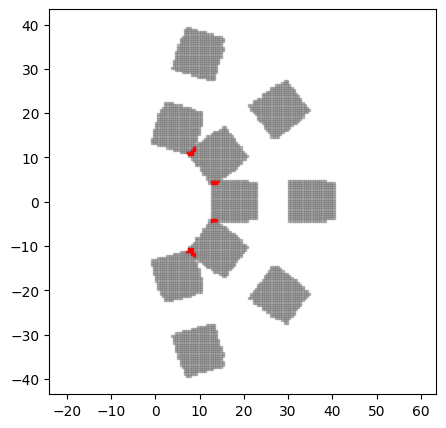

--------------------------------------------------
label: VentHole Chromosome_889: ['TriangleShape_713', 'CircularStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


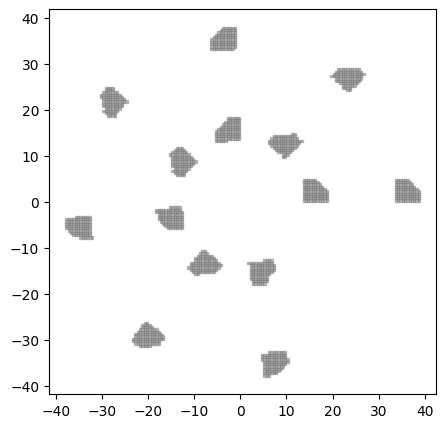

--------------------------------------------------
label: VentHole Chromosome_556: ['TriangleShape_889', 'GridStrictTransformation_971']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


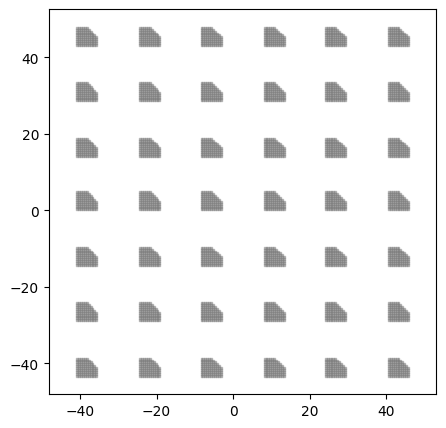

--------------------------------------------------
label: VentHole Chromosome_540: ['DonutShape_630', 'GridStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


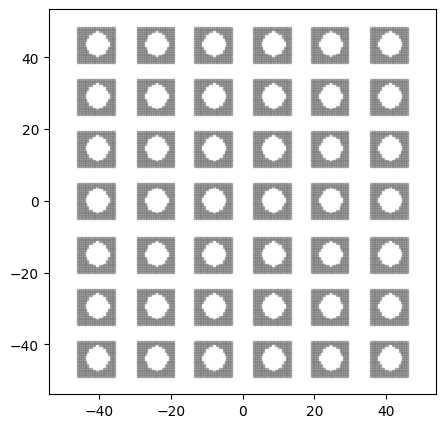

--------------------------------------------------
label: VentHole Chromosome_536: ['DonutShape_540', 'GridStrictTransformation_463']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.603064057995524, r_outer: 7.54232313891155, ]
pattern parameter:
parameter_list: [ dx: 1.8973495203997655, dy: 4.999594967018924, ]


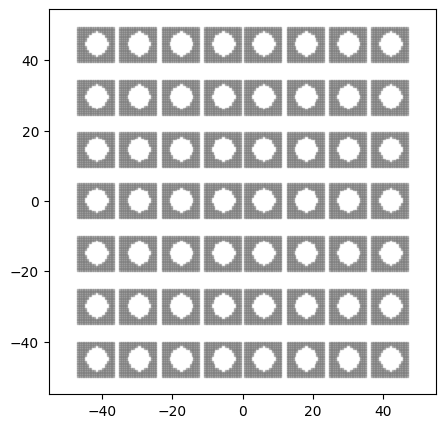

--------------------------------------------------
label: VentHole Chromosome_463: ['TriangleShape_556', 'GridStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 1.8973495203997655, dy: 4.999594967018924, ]


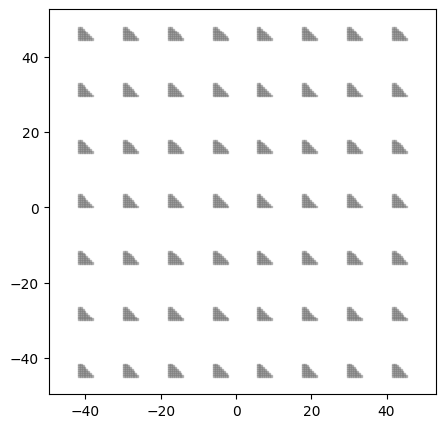

--------------------------------------------------
label: VentHole Chromosome_62: ['TriangleShape_463', 'CornerTransformation_496']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


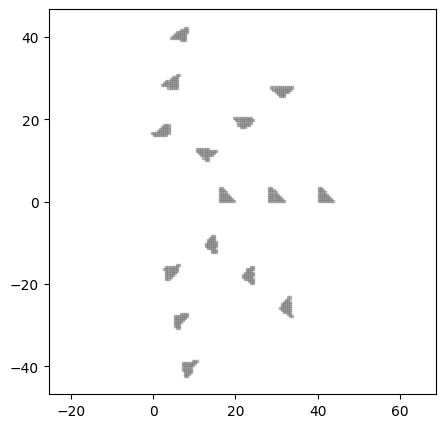

--------------------------------------------------
label: VentHole Chromosome_668: ['TrapezoidShape_496', 'CornerTransformation_829']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.808328061181311, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 13.708230140698722, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


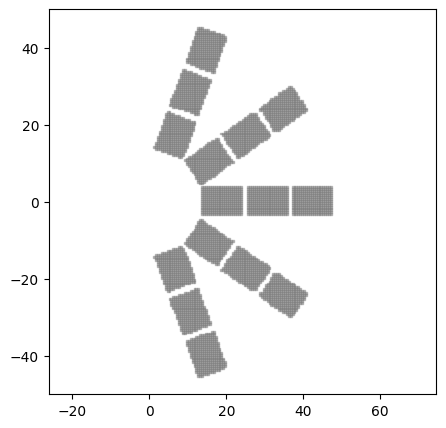

--------------------------------------------------
label: VentHole Chromosome_443: ['TriangleShape_62', 'GridStrictTransformation_251']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 3.3620851867202433, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


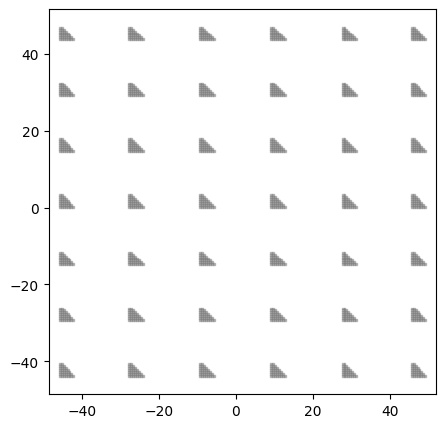

--------------------------------------------------
label: VentHole Chromosome_467: ['DoubleParabolicShape_489', 'GridStrictTransformation_443']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


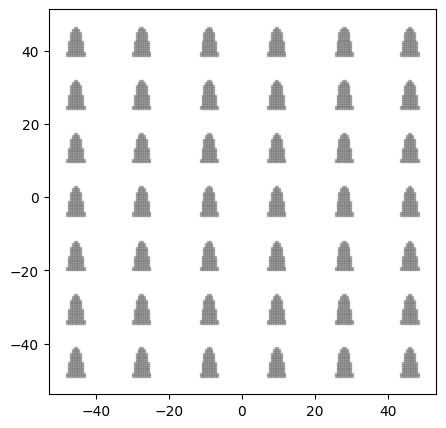

--------------------------------------------------
label: VentHole Chromosome_257: ['DoubleParabolicShape_467', 'CircularStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 9.90251222160351, phi: 0.5235987755982988, ]


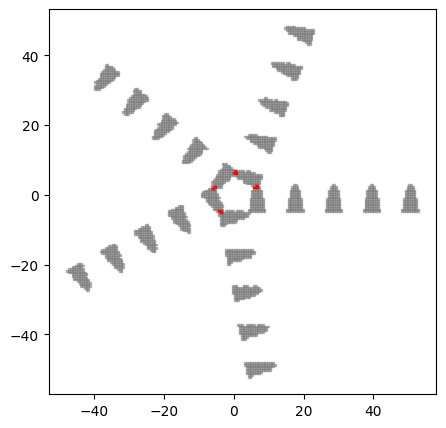

--------------------------------------------------
label: VentHole Chromosome_366: ['TriangleShape_556', 'CircularStrictTransformation_257']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 9.90251222160351, phi: 0.5235987755982988, ]


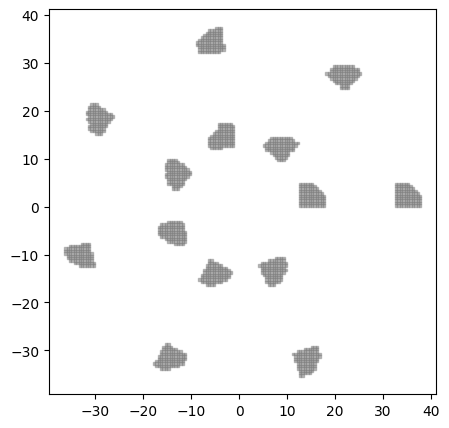

--------------------------------------------------
label: VentHole Chromosome_824: ['TrapezoidShape_961', 'CircularStrictTransformation_488']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 0.7943149583733558, phi: 0.7853981633974483, ]


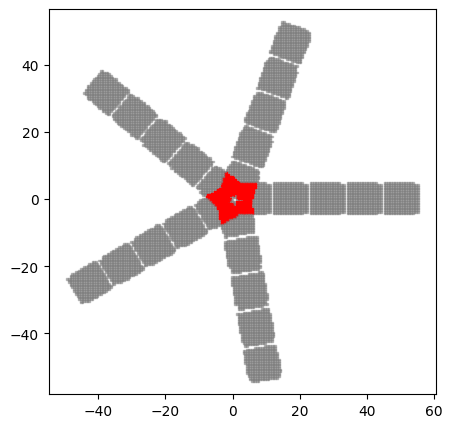

--------------------------------------------------
label: VentHole Chromosome_824: ['TrapezoidShape_824', 'CornerTransformation_630']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.852307069890713, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


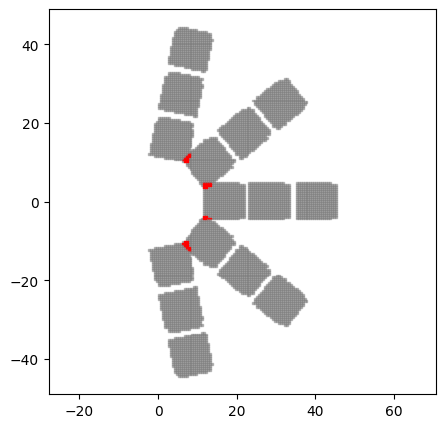

--------------------------------------------------
label: VentHole Chromosome_164: ['DonutShape_706', 'GridStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.30142999997884, r_outer: 7.879177221925768, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


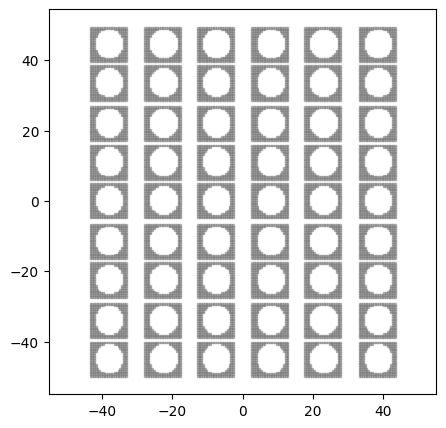

--------------------------------------------------
label: VentHole Chromosome_509: ['RayShape_379', 'GridStrictTransformation_164']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


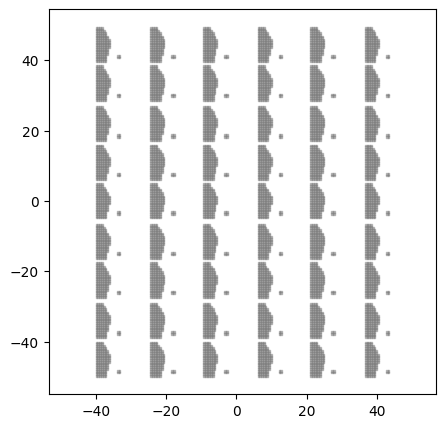

--------------------------------------------------
label: VentHole Chromosome_11: ['RayShape_509', 'GridStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


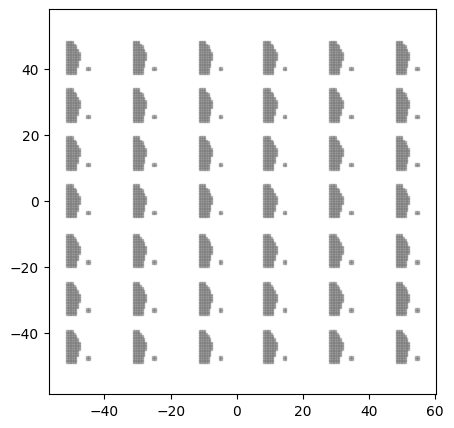

--------------------------------------------------
label: VentHole Chromosome_319: ['DonutShape_10', 'GridStrictTransformation_11']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 9.88983082456521, dy: 4.625347881243773, ]


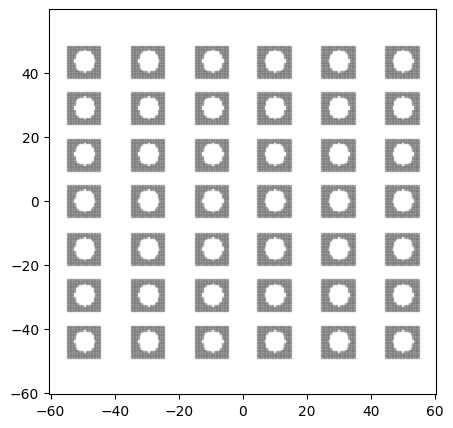

--------------------------------------------------
label: VentHole Chromosome_916: ['DonutShape_319', 'CornerTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


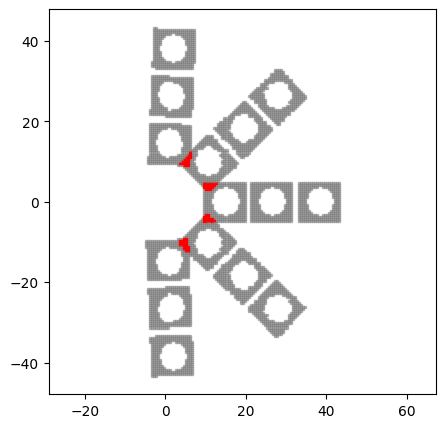

--------------------------------------------------
label: VentHole Chromosome_723: ['TrapezoidShape_467', 'CornerTransformation_205']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


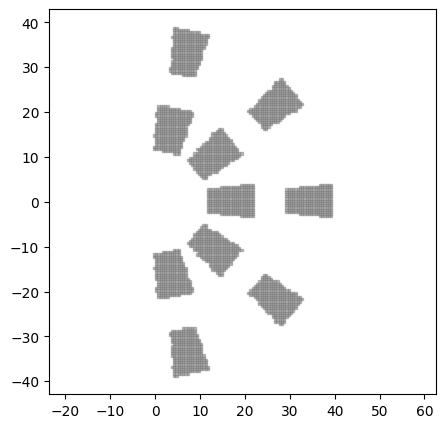

--------------------------------------------------
label: VentHole Chromosome_751: ['CircleShape_749', 'CornerTransformation_723']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 6.0, ]


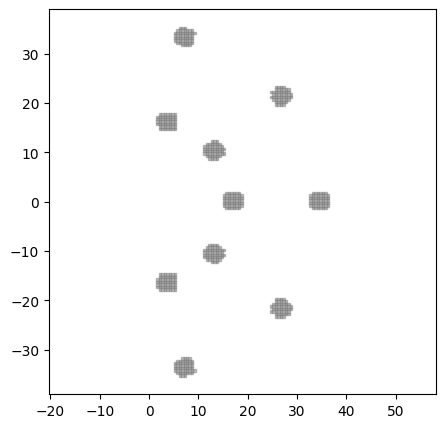

--------------------------------------------------
label: VentHole Chromosome_529: ['CircleShape_751', 'CircularStrictTransformation_889']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


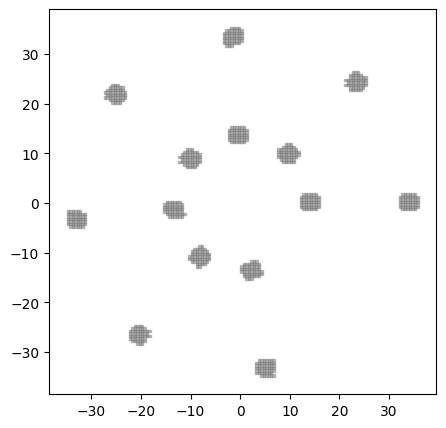

--------------------------------------------------
label: VentHole Chromosome_285: ['TriangleShape_62', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


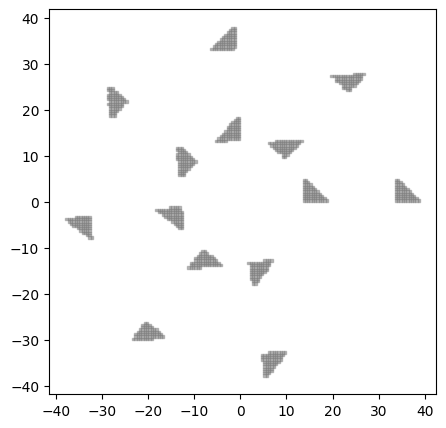

--------------------------------------------------
label: VentHole Chromosome_958: ['TriangleShape_285', 'GridStrictTransformation_282']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 4.806298251837557, ]
pattern parameter:
parameter_list: [ dx: 3.6088963471218243, dy: 4.999594967018924, ]


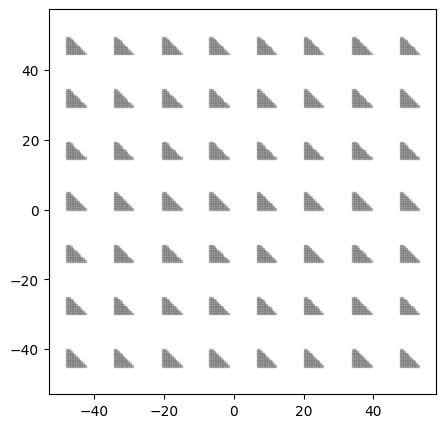

--------------------------------------------------
label: VentHole Chromosome_862: ['TriangleShape_366', 'GridStrictTransformation_958']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ dx: 3.6088963471218243, dy: 4.999594967018924, ]


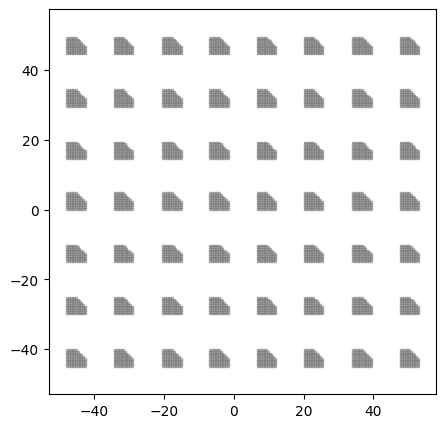

--------------------------------------------------
label: VentHole Chromosome_713: ['TrapezoidShape_126', 'GridStrictTransformation_355']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.911938295491209, dy: 4.484528829467593, ]


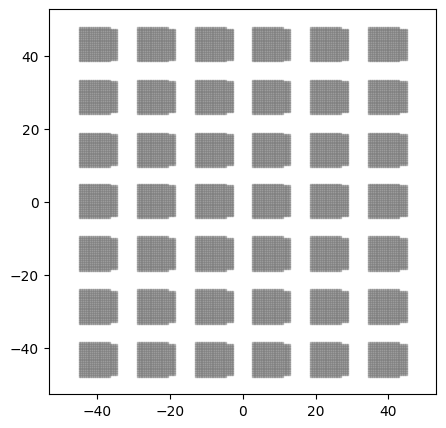

--------------------------------------------------
label: VentHole Chromosome_556: ['RayShape_334', 'GridStrictTransformation_884']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.6917366243017509, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 1.4297278906385007, lower_y-intercept: 1.82440404632599, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


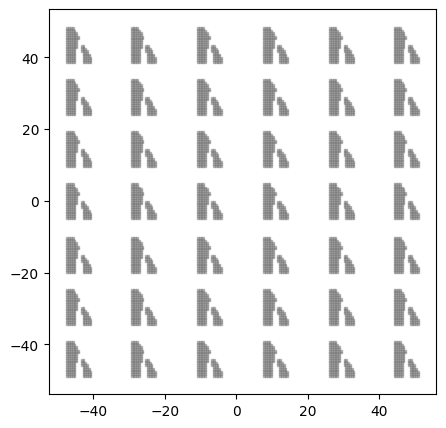

--------------------------------------------------
label: VentHole Chromosome_334: ['RayShape_556', 'CornerTransformation_321']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.6917366243017509, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 1.4297278906385007, lower_y-intercept: 1.82440404632599, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


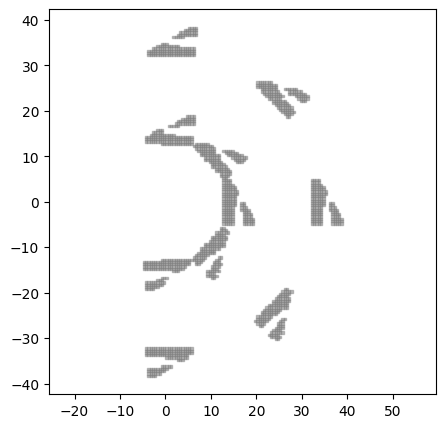

--------------------------------------------------
label: VentHole Chromosome_955: ['HoleShape_432', 'CircularStrictTransformation_536']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.23686478784644, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


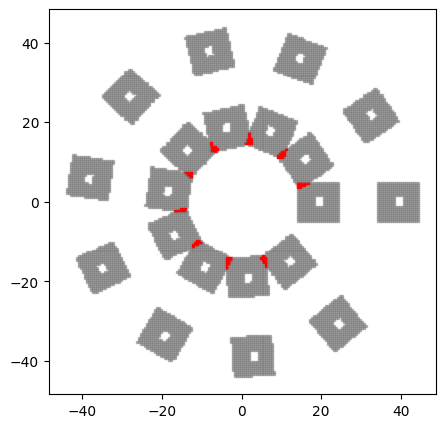

--------------------------------------------------
label: VentHole Chromosome_548: ['TrapezoidShape_942', 'CircularStrictTransformation_955']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 14.111313995920558, dx: 9.90251222160351, phi: 0.5235987755982988, ]


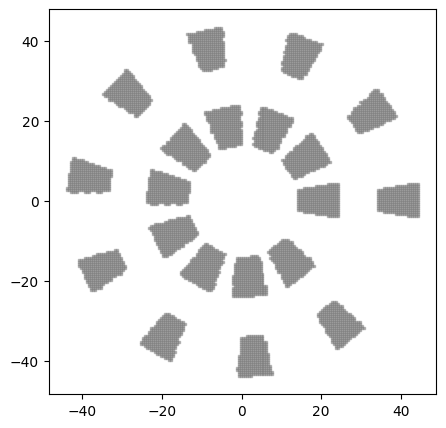

--------------------------------------------------
label: VentHole Chromosome_67: ['TrapezoidShape_713', 'CornerTransformation_514']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.540744726128407, dx: 9.88983082456521, phi: 0.7678887097189364, rot_count: 6.0, ]


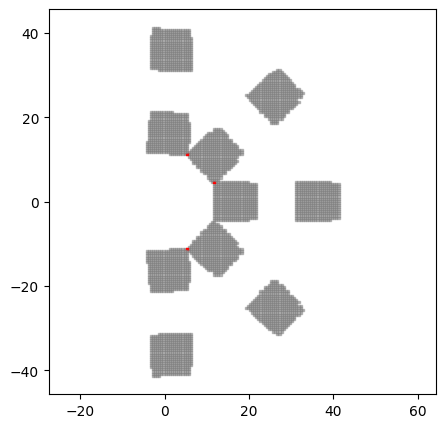

--------------------------------------------------
label: VentHole Chromosome_919: ['HoleShape_889', 'CircularStrictTransformation_317']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.776942860477072, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.7853981633974483, ]


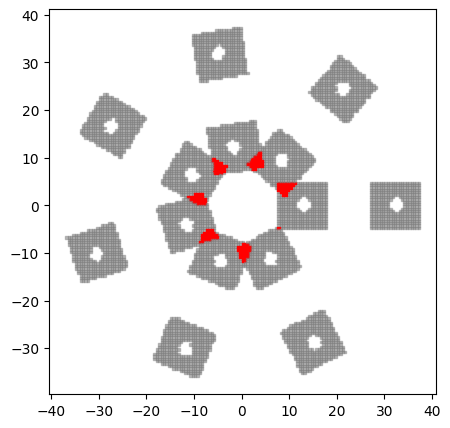

--------------------------------------------------
label: VentHole Chromosome_529: ['TriangleShape_301', 'GridStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 9.912435326111364, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.3940027386743572, ]


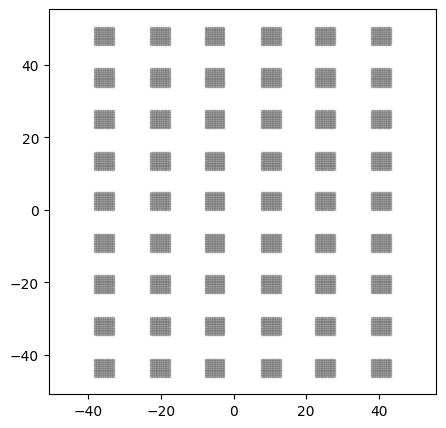

--------------------------------------------------
label: VentHole Chromosome_694: ['RayShape_469', 'CornerTransformation_274']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.7511107218289792, phi: 0.7422463986582669, rot_count: 6.0, ]


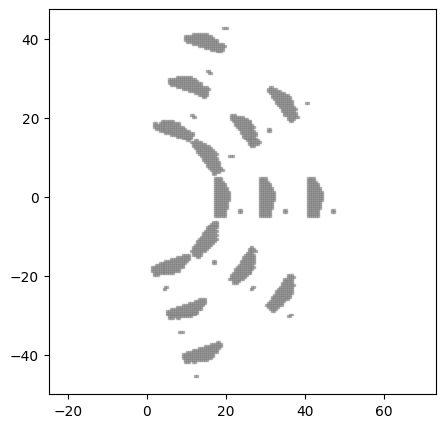

--------------------------------------------------
label: VentHole Chromosome_955: ['DonutShape_277', 'CornerTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.7511107218289792, phi: 0.7422463986582669, rot_count: 6.0, ]


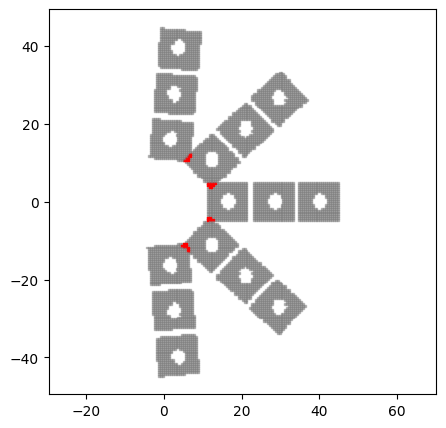

--------------------------------------------------
label: VentHole Chromosome_34: ['DonutShape_955', 'CornerTransformation_334']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


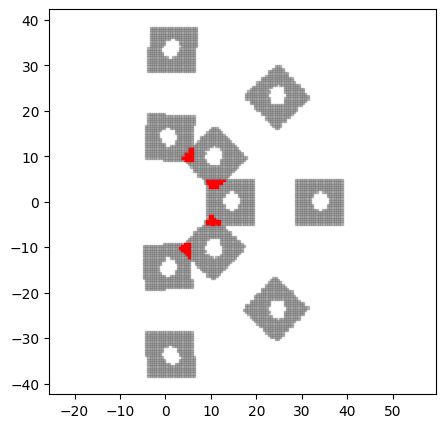

--------------------------------------------------
label: VentHole Chromosome_413: ['TriangleShape_108', 'GridStrictTransformation_540']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 4.625347881243773, ]


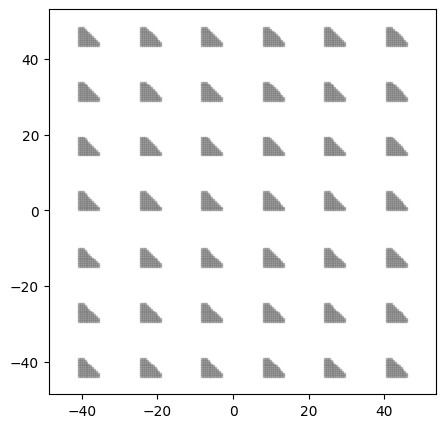

--------------------------------------------------
label: VentHole Chromosome_57: ['HoleShape_783', 'CircularStrictTransformation_332']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.295188182743882, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


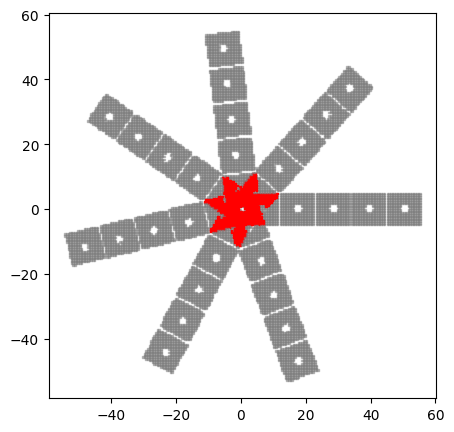

--------------------------------------------------
label: VentHole Chromosome_942: ['DonutShape_188', 'CircularStrictTransformation_57']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 7.929151179510466, dx: 0.7943149583733558, phi: 0.6283185307179586, ]


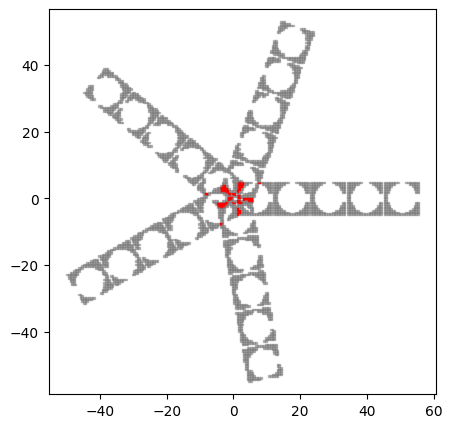

--------------------------------------------------
label: VentHole Chromosome_101: ['DonutShape_942', 'CircularStrictTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 4.629575334324297, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 9.90251222160351, phi: 0.6283185307179586, ]


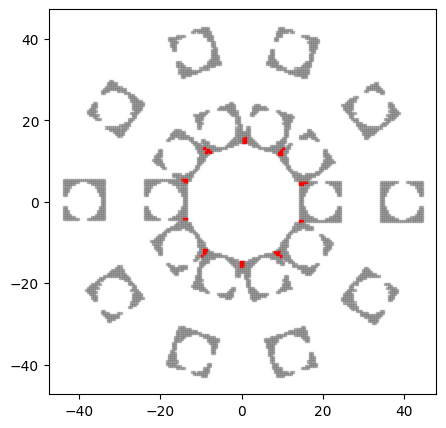

--------------------------------------------------
label: VentHole Chromosome_180: ['TrapezoidShape_723', 'CircularStrictTransformation_101']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 9.90251222160351, phi: 0.6283185307179586, ]


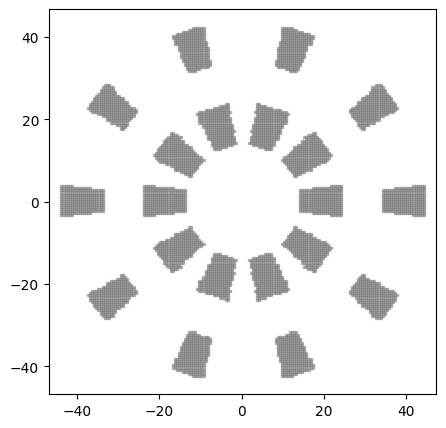

--------------------------------------------------
label: VentHole Chromosome_230: ['TriangleShape_333', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.99947579870443, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


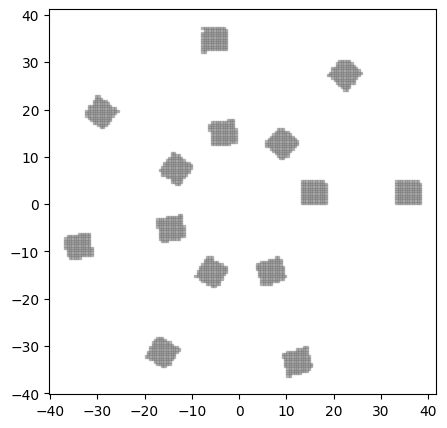

--------------------------------------------------
label: VentHole Chromosome_622: ['TrapezoidShape_180', 'GridStrictTransformation_622']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ dx: 4.164523841830473, dy: 1.4607131800110769, ]


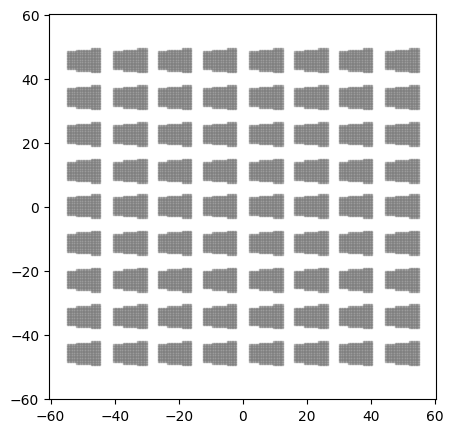

--------------------------------------------------
label: VentHole Chromosome_310: ['TrapezoidShape_622', 'CornerTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.5877628877894474, rot_count: 6.0, ]


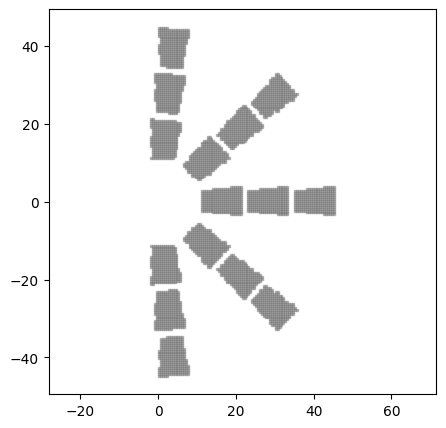

--------------------------------------------------
label: VentHole Chromosome_984: ['DoubleParabolicShape_257', 'CornerTransformation_310']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 1.8626394042569998, phi: 0.5877628877894474, rot_count: 6.0, ]


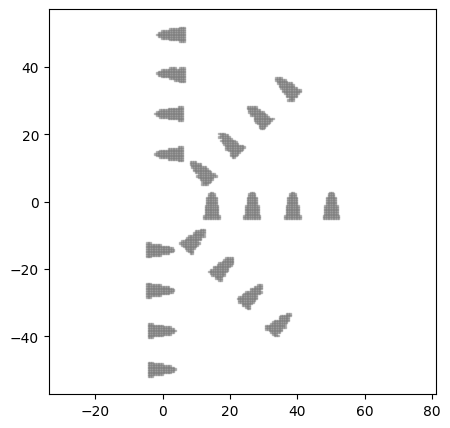

--------------------------------------------------
label: VentHole Chromosome_458: ['DoubleParabolicShape_403', 'CircularStrictTransformation_438']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 14.133212792067125, dx: 7.302266288219605, phi: 0.6981317007977318, ]


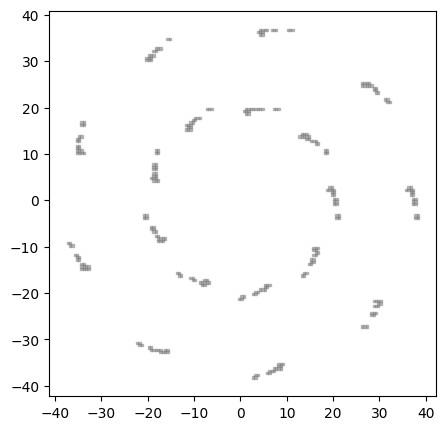

--------------------------------------------------
label: VentHole Chromosome_706: ['CircleShape_529', 'CornerTransformation_34']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


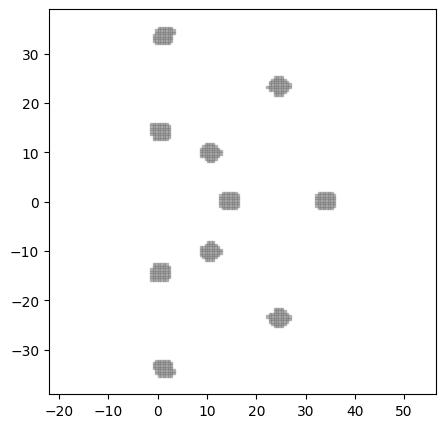

--------------------------------------------------
label: VentHole Chromosome_529: ['CircleShape_706', 'CornerTransformation_310']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.864270036590645, ]
pattern parameter:
parameter_list: [ di: 9.322238818933497, dx: 3.9142584353847534, phi: 0.5877628877894474, rot_count: 6.0, ]


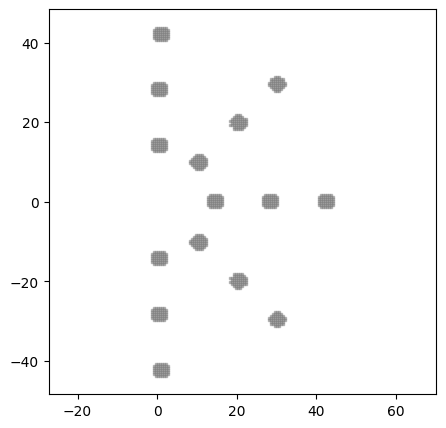

--------------------------------------------------
label: VentHole Chromosome_310: ['TrapezoidShape_310', 'GridStrictTransformation_556']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 3.761983695576873, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


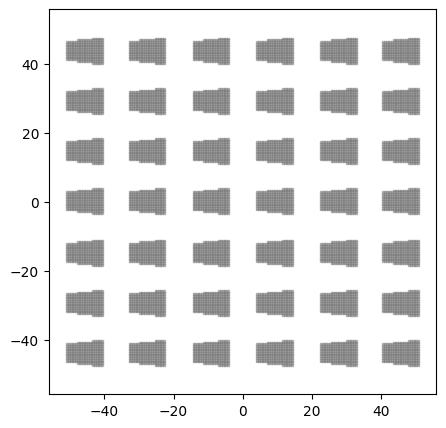

--------------------------------------------------
label: VentHole Chromosome_306: ['WingShape_690', 'GridStrictTransformation_310']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.3442848867734063, ]
pattern parameter:
parameter_list: [ dx: 8.350516066917011, dy: 4.625347881243773, ]


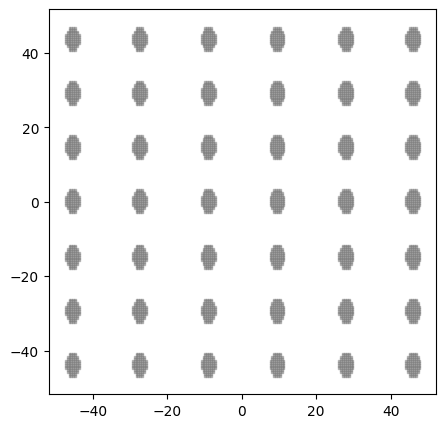

--------------------------------------------------
label: VentHole Chromosome_690: ['RayShape_334', 'CircularStrictTransformation_540']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.6917366243017509, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 1.4297278906385007, lower_y-intercept: 1.82440404632599, ]
pattern parameter:
parameter_list: [ di: 10.601767231754536, dx: 8.145479259950836, phi: 0.483321946706122, ]


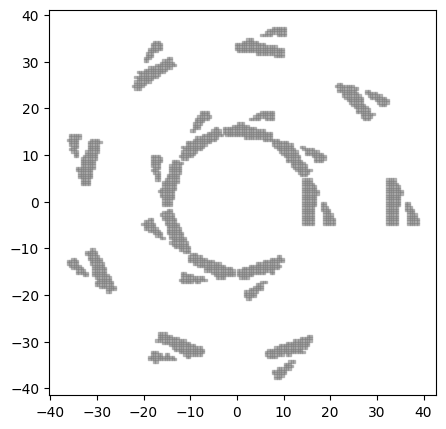

--------------------------------------------------
label: VentHole Chromosome_300: ['RayShape_690', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.6917366243017509, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 1.4297278906385007, lower_y-intercept: 1.82440404632599, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


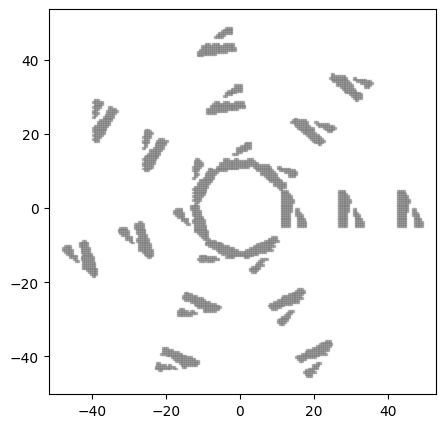

--------------------------------------------------
label: VentHole Chromosome_253: ['RayShape_300', 'CircularStrictTransformation_300']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


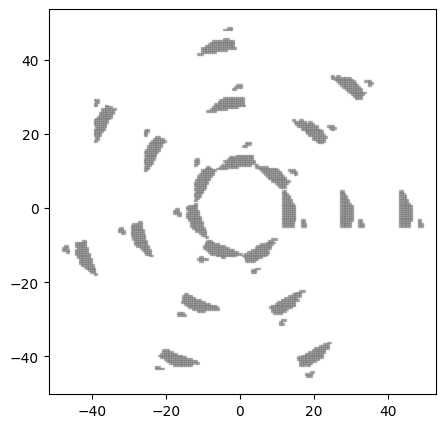

--------------------------------------------------
label: VentHole Chromosome_685: ['RayShape_253', 'CircularStrictTransformation_823']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 3.6634992648930864, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


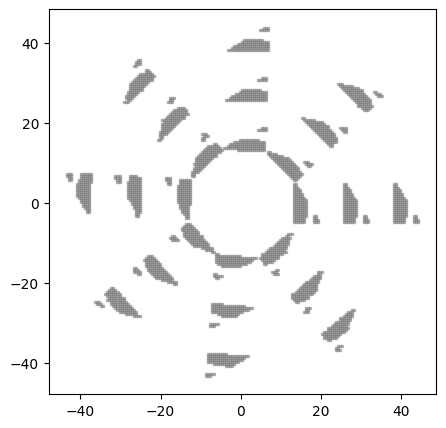

--------------------------------------------------
label: VentHole Chromosome_823: ['TrapezoidShape_109', 'CircularStrictTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 9.464448590191733, dx: 2.377490341532062, phi: 0.6981317007977318, ]


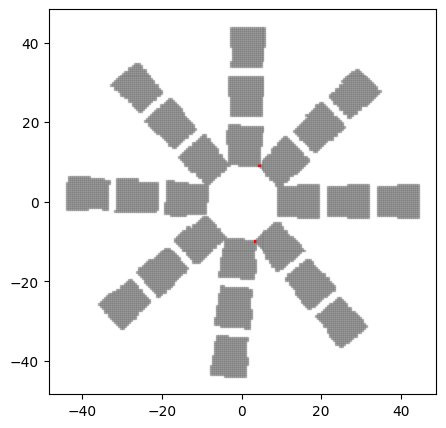

--------------------------------------------------
label: VentHole Chromosome_871: ['TrapezoidShape_823', 'CircularStrictTransformation_948']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 3.607909732906716, k2: 1.2973372020725926, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


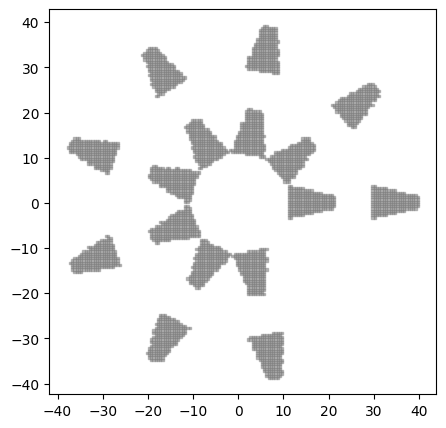

--------------------------------------------------
label: VentHole Chromosome_791: ['DoubleParabolicShape_766', 'CircularStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.9555316046270645, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 11.123313714989534, dx: 8.780057641834707, phi: 0.483321946706122, ]


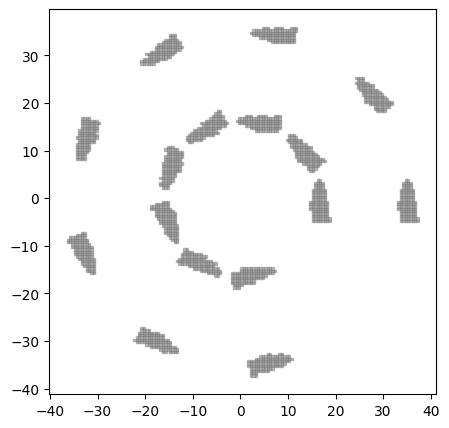

--------------------------------------------------
label: VentHole Chromosome_766: ['RayShape_948', 'GridStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ dx: 6.2250782371457465, dy: 1.3940027386743572, ]


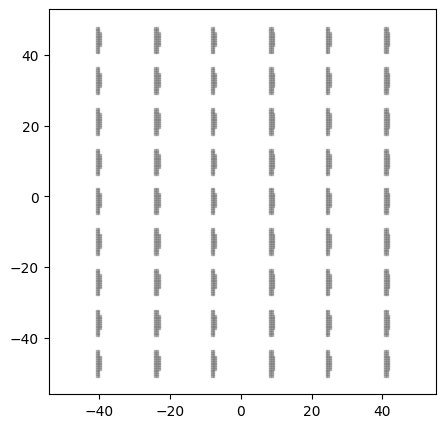

--------------------------------------------------
label: VentHole Chromosome_329: ['RayShape_766', 'CornerTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 2.9738628837484877, nose_point: 1.0235249549719176, lower_coefficient: 3.7888041121603937, lower_x-intercept: 1.579595272254505, lower_y-intercept: 1.278322916397478, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


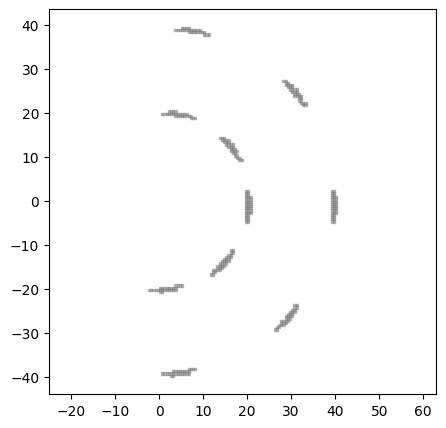

--------------------------------------------------
label: VentHole Chromosome_10: ['DoubleParabolicShape_126', 'CornerTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.3912597872446593, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 14.83903657933377, dx: 9.213707085525087, phi: 0.6101207001580315, rot_count: 6.0, ]


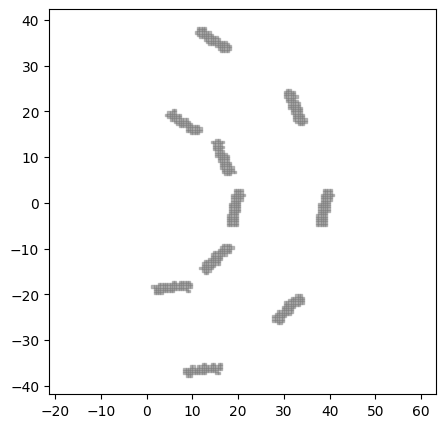

--------------------------------------------------
label: VentHole Chromosome_529: ['HoleShape_363', 'CircularStrictTransformation_285']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


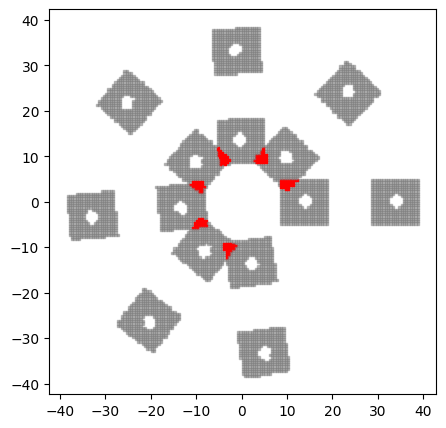

--------------------------------------------------
label: VentHole Chromosome_167: ['HoleShape_529', 'CircularStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.2432759990807556, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


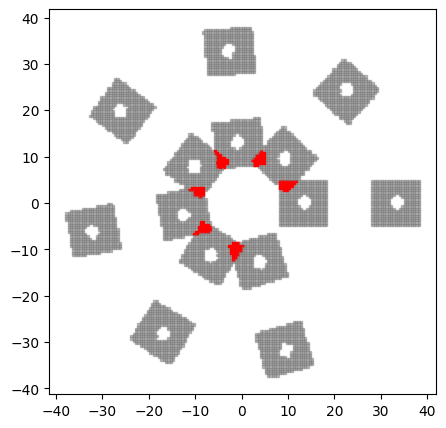

--------------------------------------------------
label: VentHole Chromosome_230: ['DoubleParabolicShape_230', 'CircularStrictTransformation_447']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 0.7943149583733558, phi: 0.483321946706122, ]


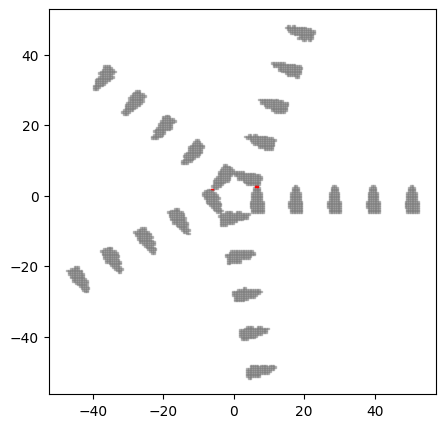

--------------------------------------------------
label: VentHole Chromosome_792: ['RayShape_258', 'GridStrictTransformation_509']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


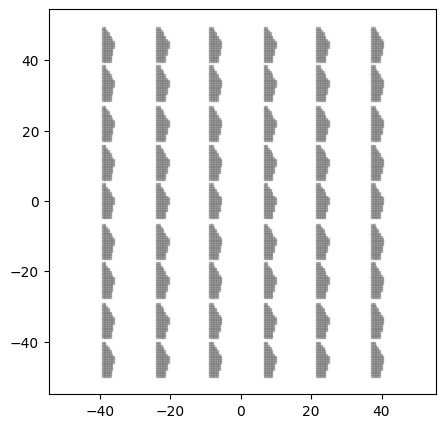

--------------------------------------------------
label: VentHole Chromosome_321: ['TrapezoidShape_889', 'GridStrictTransformation_792']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.800496070887942, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 1.1944947805979598, ]


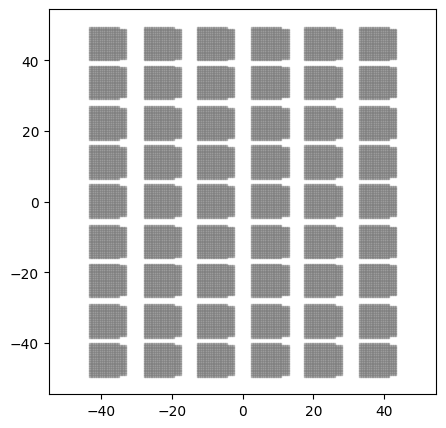

--------------------------------------------------
label: VentHole Chromosome_886: ['DoubleParabolicShape_10', 'CircularStrictTransformation_984']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.569303088924493, upper_coefficient: 1.3912597872446593, lower_y-intercept: 1.341599352735064, upper_y-intercept_from_lower_y: 1.5526344450022393, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


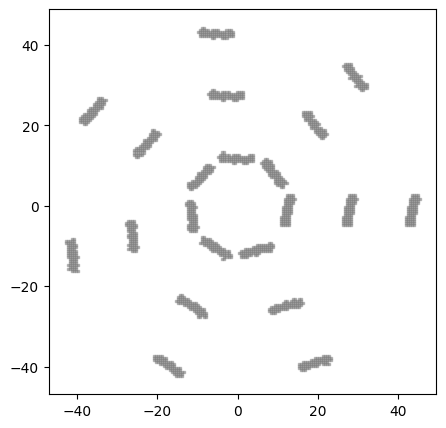

--------------------------------------------------
label: VentHole Chromosome_403: ['WingShape_961', 'CircularStrictTransformation_42']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.5235987755982988, ]


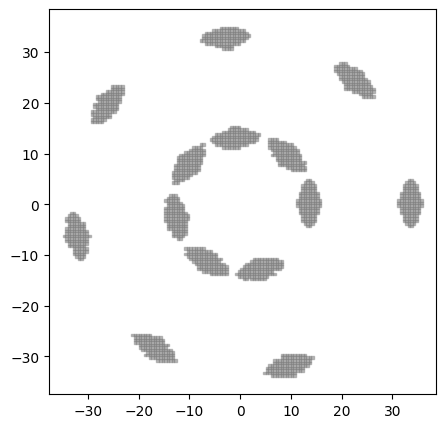

--------------------------------------------------
label: VentHole Chromosome_7: ['WingShape_403', 'CircularStrictTransformation_529']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 4.5735290699067335, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


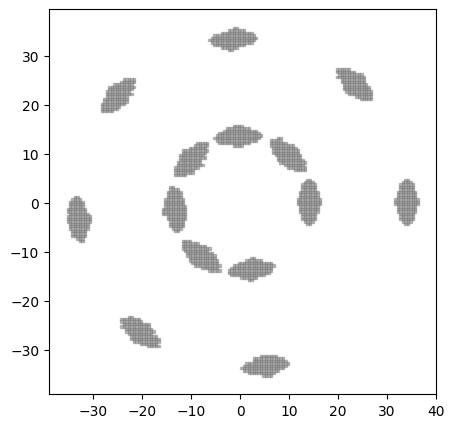

--------------------------------------------------
label: VentHole Chromosome_685: ['TrapezoidShape_67', 'CircularStrictTransformation_251']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.6981317007977318, ]


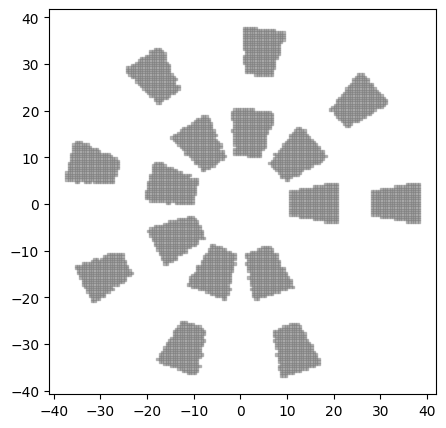

--------------------------------------------------
label: VentHole Chromosome_872: ['DonutShape_916', 'CornerTransformation_243']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 3.6347206434290764, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.7422463986582669, rot_count: 6.0, ]


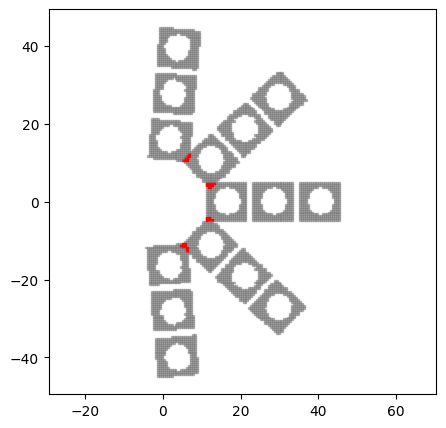

--------------------------------------------------
label: VentHole Chromosome_363: ['HoleShape_142', 'CircularStrictTransformation_928']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 3.5522826137621855, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


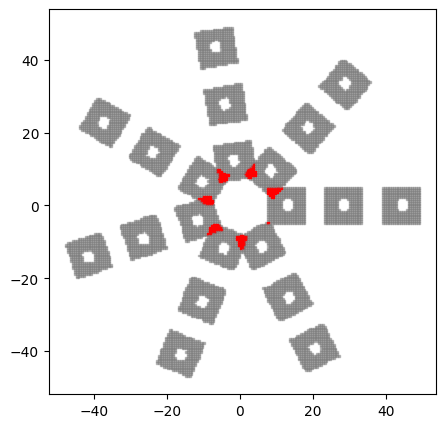

--------------------------------------------------
label: VentHole Chromosome_57: ['HoleShape_57', 'CircularStrictTransformation_886']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.295188182743882, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


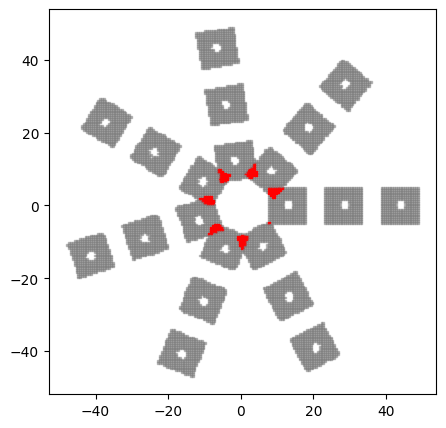

--------------------------------------------------
label: VentHole Chromosome_633: ['DoubleParabolicShape_984', 'CircularStrictTransformation_713']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.069200091746887, upper_coefficient: 1.76394127159739, lower_y-intercept: 1.8231222231502744, upper_y-intercept_from_lower_y: 1.112496978820286, lower_x_trans: 3.88641001055208, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 5.807728062127912, phi: 0.5235987755982988, ]


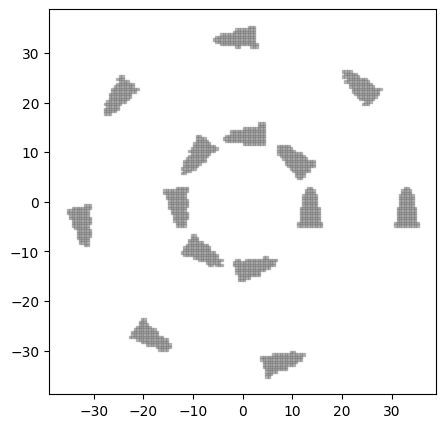

--------------------------------------------------
label: VentHole Chromosome_633: ['TriangleShape_862', 'GridStrictTransformation_871']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


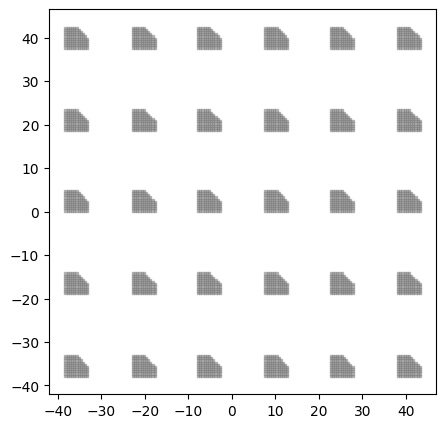

--------------------------------------------------
label: VentHole Chromosome_101: ['DonutShape_713', 'GridStrictTransformation_633']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ dx: 5.2589464355026765, dy: 8.794727031067021, ]


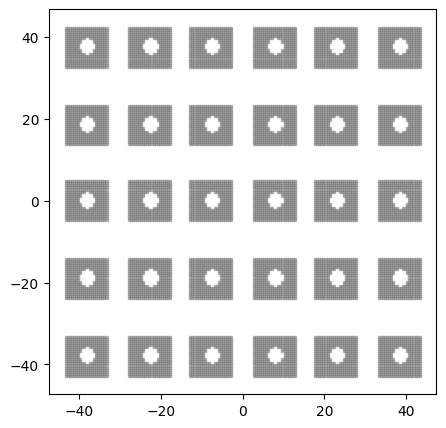

--------------------------------------------------
label: VentHole Chromosome_458: ['DonutShape_101', 'CornerTransformation_329']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.214340587219804, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


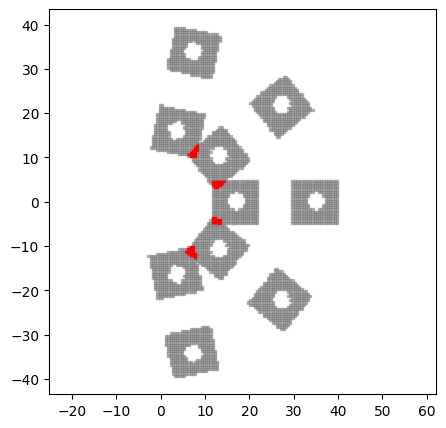

--------------------------------------------------
label: VentHole Chromosome_514: ['CircleShape_349', 'CornerTransformation_458']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ di: 11.576457536263685, dx: 8.19370072551294, phi: 0.6101207001580315, rot_count: 6.0, ]


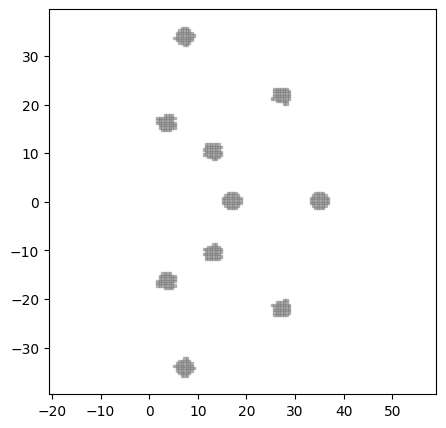

--------------------------------------------------
label: VentHole Chromosome_712: ['CircleShape_514', 'CircularStrictTransformation_7']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 1.7192843463733238, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


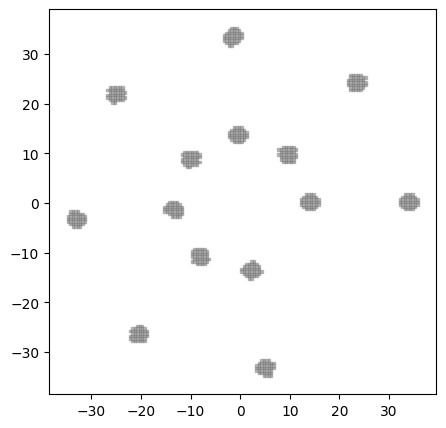

--------------------------------------------------
label: VentHole Chromosome_531: ['RayShape_792', 'CircularStrictTransformation_712']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.638365684431113, dx: 9.90251222160351, phi: 0.5235987755982988, ]


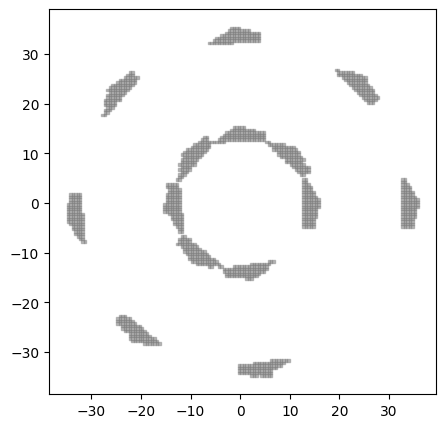

--------------------------------------------------
label: VentHole Chromosome_332: ['RayShape_531', 'CornerTransformation_685']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.649158106202405, nose_point: 1.8137458611489234, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


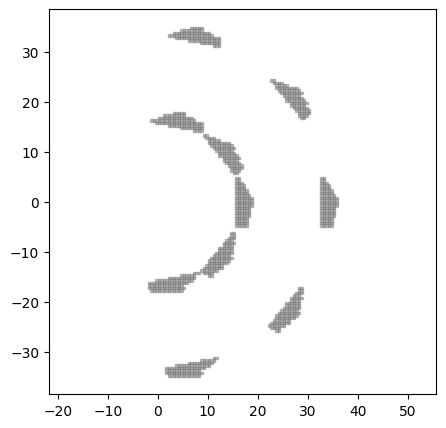

--------------------------------------------------
label: VentHole Chromosome_459: ['RayShape_823', 'CornerTransformation_961']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.2207485994128058, nose_point: 2.158357177151938, lower_coefficient: 3.469280488062669, lower_x-intercept: 2.566421021739363, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.429882210168095, phi: 0.4098912790616371, rot_count: 6.0, ]


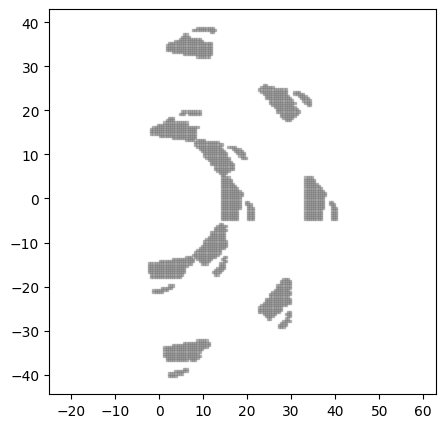

--------------------------------------------------
label: VentHole Chromosome_712: ['DonutShape_34', 'CornerTransformation_916']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r_inner: 2.132800656432673, r_outer: 7.2421695834494635, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 1.8626394042569998, phi: 0.6101207001580315, rot_count: 6.0, ]


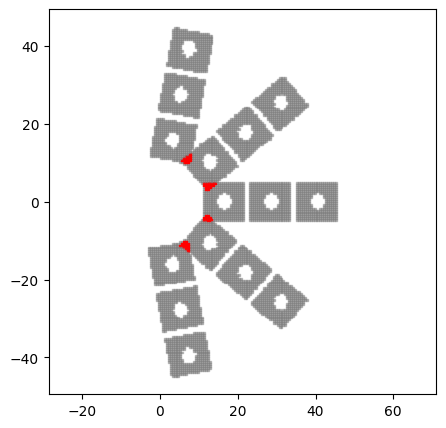

--------------------------------------------------
label: VentHole Chromosome_251: ['TriangleShape_413', 'CornerTransformation_647']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 5.34790823273727, ]
pattern parameter:
parameter_list: [ di: 11.281147264285838, dx: 7.572009543843525, phi: 0.4785459301078606, rot_count: 4.0, ]


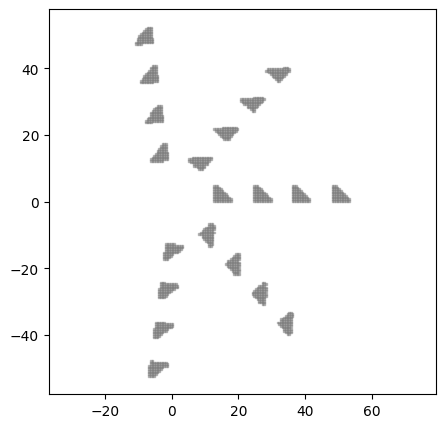

--------------------------------------------------
label: VentHole Chromosome_96: ['TriangleShape_415', 'CircularStrictTransformation_167']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.371250985532132, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


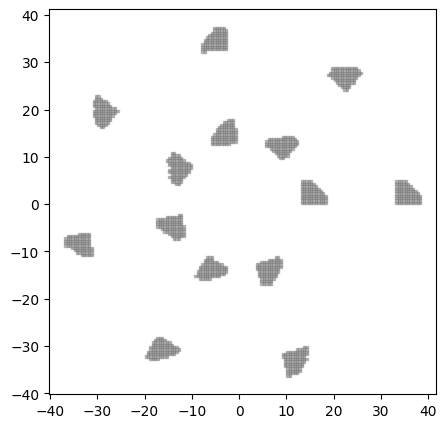

--------------------------------------------------
label: VentHole Chromosome_230: ['RayShape_694', 'CircularStrictTransformation_96']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ upper_slope: 1.625477200478641, nose_point: 2.5454359458711506, lower_coefficient: 1.705854175089564, lower_x-intercept: 2.6743380315124203, lower_y-intercept: 1.3125239701706586, ]
pattern parameter:
parameter_list: [ di: 8.164761350872213, dx: 9.90251222160351, phi: 0.483321946706122, ]


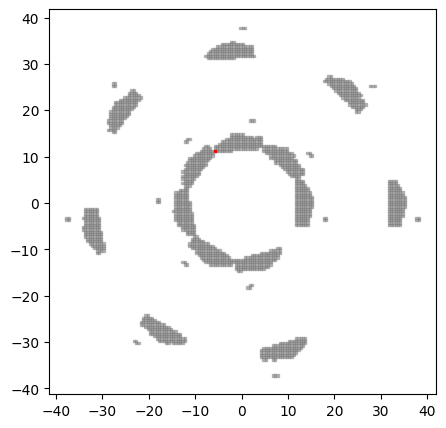

--------------------------------------------------
label: VentHole Chromosome_849: ['TrapezoidShape_783', 'CornerTransformation_694']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 4.4570456725841625, k2: 4.420932845641118, ]
pattern parameter:
parameter_list: [ di: 11.616212757610864, dx: 0.9323115409400118, phi: 0.4443368011847215, rot_count: 3.0, ]


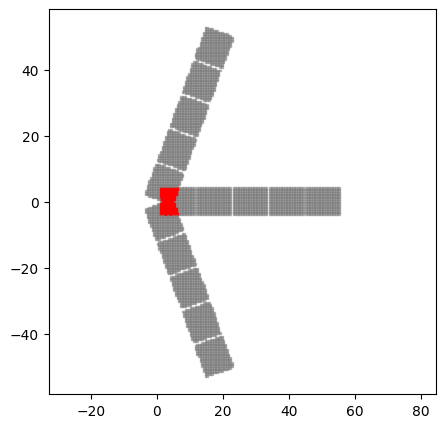

--------------------------------------------------
label: VentHole Chromosome_862: ['WingShape_62', 'GridStrictTransformation_862']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ c: 3.570113403765629, ]
pattern parameter:
parameter_list: [ dx: 3.6088963471218243, dy: 4.999594967018924, ]


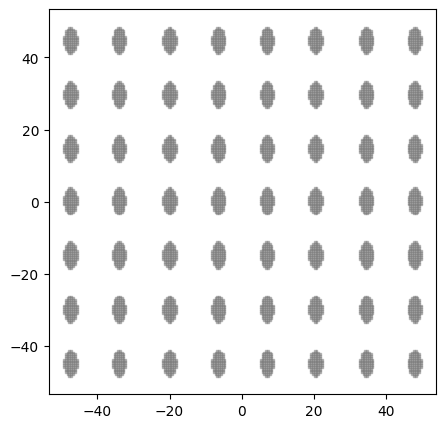

--------------------------------------------------
label: VentHole Chromosome_458: ['TriangleShape_633', 'CircularStrictTransformation_142']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


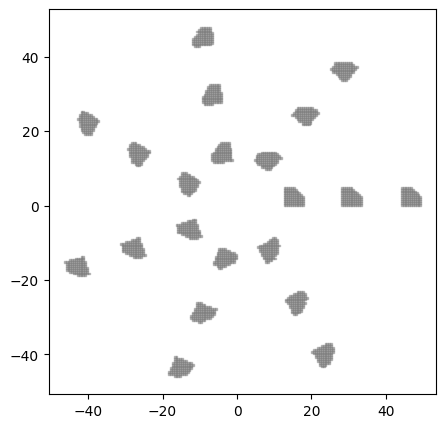

--------------------------------------------------
label: VentHole Chromosome_713: ['TriangleShape_458', 'CornerTransformation_824']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 6.959646016227117, ]
pattern parameter:
parameter_list: [ di: 11.568512380465853, dx: 1.7511107218289792, phi: 0.4616516566182173, rot_count: 4.0, ]


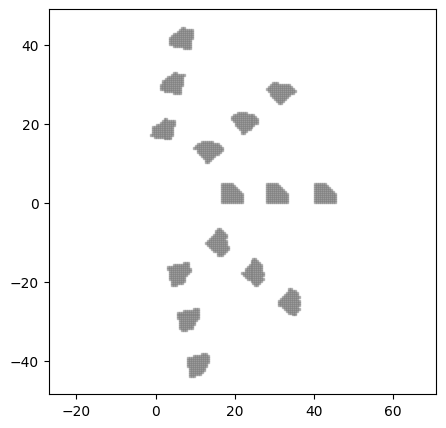

--------------------------------------------------
label: VentHole Chromosome_942: ['TriangleShape_230', 'CircularStrictTransformation_253']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ l: 8.99947579870443, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.483321946706122, ]


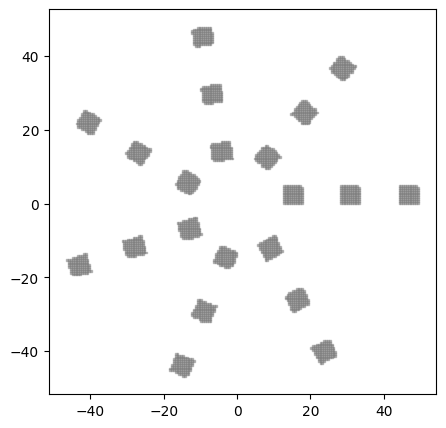

--------------------------------------------------
label: VentHole Chromosome_16: ['DoubleParabolicShape_694', 'CornerTransformation_706']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 9.47612718353039, dx: 9.349486438174468, phi: 0.7678887097189364, rot_count: 6.0, ]


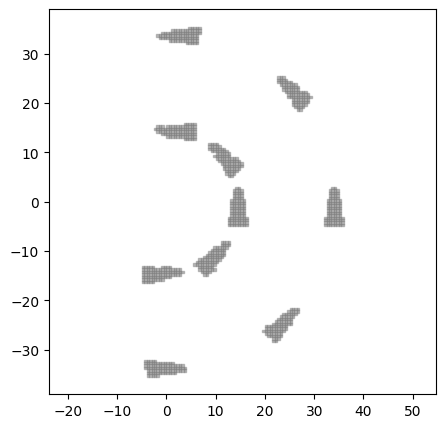

--------------------------------------------------
label: VentHole Chromosome_647: ['DoubleParabolicShape_16', 'CircularStrictTransformation_230']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.270110496197524, upper_coefficient: 2.671042623489667, lower_y-intercept: 1.791476075580635, upper_y-intercept_from_lower_y: 1.0639283613485475, lower_x_trans: -4.398208140704783, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


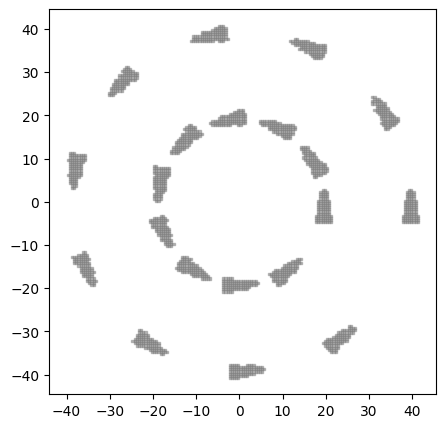

--------------------------------------------------
label: VentHole Chromosome_101: ['TrapezoidShape_548', 'CircularStrictTransformation_647']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 9.90251222160351, phi: 0.5235987755982988, ]


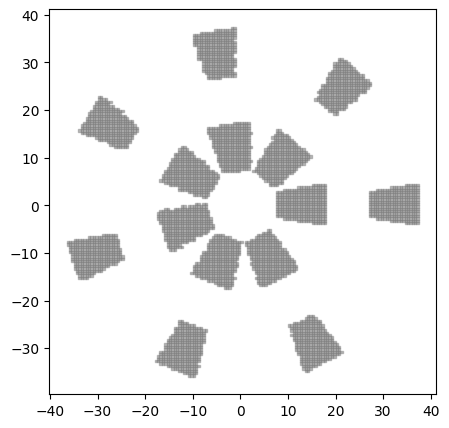

--------------------------------------------------
label: VentHole Chromosome_942: ['TrapezoidShape_101', 'CornerTransformation_10']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ k1: 2.7423489630017763, k2: 4.520911647173876, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


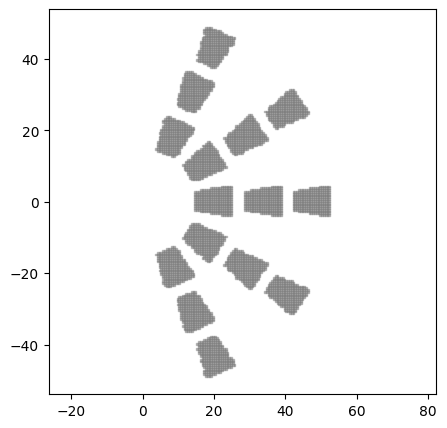

--------------------------------------------------
label: VentHole Chromosome_576: ['DoubleParabolicShape_230', 'CornerTransformation_942']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 1.1770223094136554, upper_coefficient: 1.9789475428519203, lower_y-intercept: 1.0696430976031004, upper_y-intercept_from_lower_y: 1.8118302626276273, lower_x_trans: 3.50242653838545, ]
pattern parameter:
parameter_list: [ di: 14.998432248278537, dx: 3.732898269017173, phi: 0.4098912790616371, rot_count: 4.0, ]


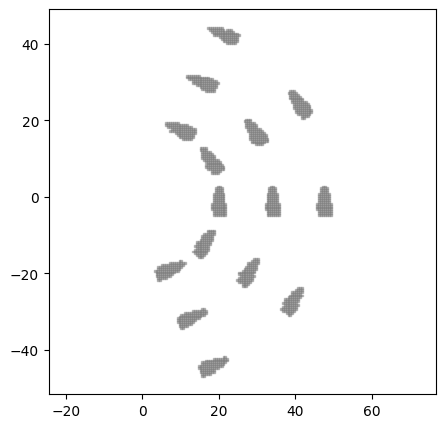

--------------------------------------------------
label: VentHole Chromosome_146: ['HoleShape_443', 'CornerTransformation_146']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ hole_r: 2.928452016437537, ]
pattern parameter:
parameter_list: [ di: 14.093844146049733, dx: 4.272319043781942, phi: 0.33016364912189383, rot_count: 3.0, ]


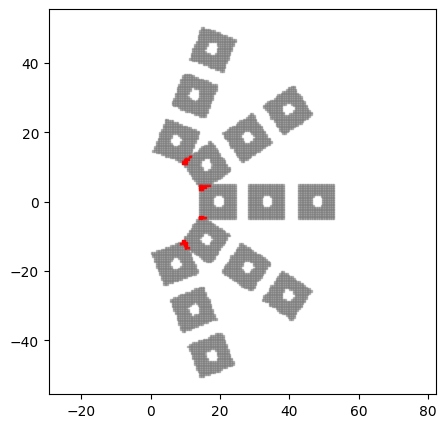

--------------------------------------------------
label: VentHole Chromosome_606: ['DoubleParabolicShape_942', 'CircularStrictTransformation_363']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 7.508180636637174, dx: 5.807728062127912, phi: 0.5235987755982988, ]


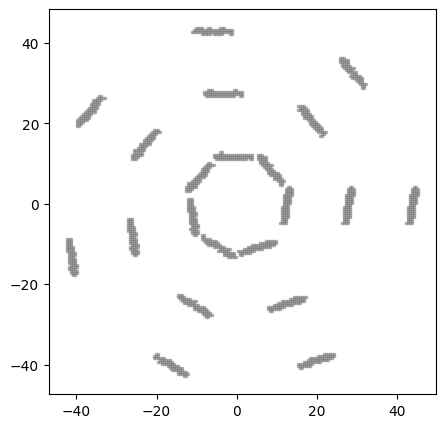

--------------------------------------------------
label: VentHole Chromosome_765: ['DoubleParabolicShape_606', 'CornerTransformation_126']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ lower_coefficient: 2.256014858676372, upper_coefficient: 2.2561929471286133, lower_y-intercept: 2.4681629731500903, upper_y-intercept_from_lower_y: 1.878995318820031, lower_x_trans: -1.1426920002635677, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 7.835428350814954, phi: 0.6877684637074144, rot_count: 4.0, ]


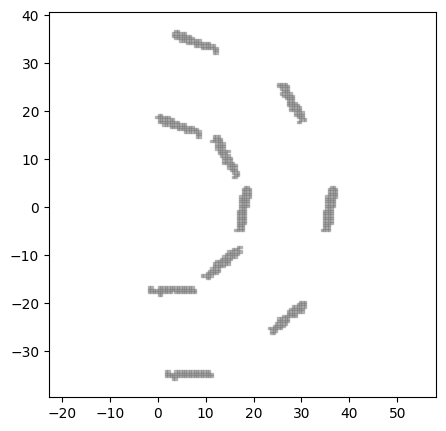

--------------------------------------------------
label: VentHole Chromosome_16: ['CircleShape_884', 'CornerTransformation_765']
predict: None
biased_fitness: 0.0, fitness: 0.0
shape parameter:
parameter_list: [ r: 2.3592749626543132, ]
pattern parameter:
parameter_list: [ di: 13.225693190378534, dx: 7.835428350814954, phi: 0.6877684637074144, rot_count: 4.0, ]


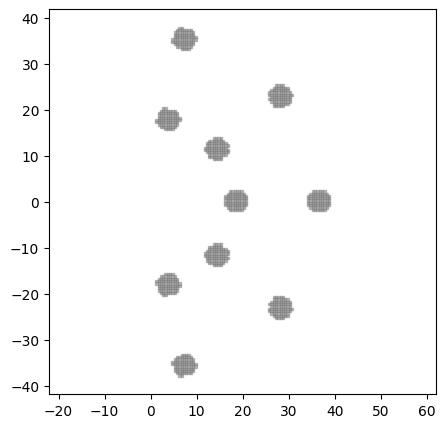

In [4]:
from src.grid.visualize_points import visualize_points


for pop in suite.unique_population:
    print("-" * 50)
    print(f"label: {pop.label}")
    print(f"predict: {pop.fitness_pure_result}")
    print(f"biased_fitness: {pop.biased_fitness}, fitness: {pop.fitness}")

    shape, pattern = pop.gene_tuple
    print("shape parameter:")
    shape.print_parameter_info()
    print("pattern parameter:")
    pattern.print_parameter_info()

    visualize_points(
        pop.pattern.pattern_matrix,
        pop.pattern.pattern_unit.grid.k,
        fig_size=(5, 5),
    )